## Closed Loop Detection

In [1]:
def is_closed_loop(binary_image, row, col):
    stack = [(row, col)]
    directions = [(0, 1), (0, -1), (1, 0), (-1, 0)]  # Right, Left, Down, Up

    while stack:
        x, y = stack.pop()

        if binary_image[x][y] == 0:
            return False

        binary_image[x][y] = 0  # Mark as visited

        for dx, dy in directions:
            nx, ny = x + dx, y + dy

            if 0 <= nx < len(binary_image) and 0 <= ny < len(binary_image[0]) and binary_image[nx][ny] == 1:
                stack.append((nx, ny))

    return True

def has_closed_loop(binary_image):
    for i in range(len(binary_image)):
        for j in range(len(binary_image[0])):
            if binary_image[i][j] == 1 and not is_closed_loop(binary_image, i, j):
                return False

    return True


In [2]:
def count_elements(binary_image, k, b):
    left_1_count = 0  # Number of '1' in the left part
    left_0_count = 0  # Number of '0' in the left part
    right_1_count = 0  # Number of '1' in the right part
    right_0_count = 0  # Number of '0' in the right part

    # x_mid /= (0 - b) / k  # Calculate the x-coordinate of the line intersection

    for y in range(28):  # Iterate over the rows of the matrix
        for x in range(28):  # Iterate over the columns of the matrix
            if x < (y-b)/k:  # Left part
                if binary_image[y][x] == 1:
                    left_1_count += 1
                else:
                    left_0_count += 1
            else:  # Right part
                if binary_image[y][x] == 1:
                    right_1_count += 1
                else:
                    right_0_count += 1

    return left_1_count, left_0_count, right_1_count, right_0_count





In [3]:
def calculate_circumference(binary_image):
    rows, cols = binary_image.shape
    circumference = 0

    for i in range(rows):
        for j in range(cols):
            if binary_image[i, j] == 1:
                # Check if the current pixel is on the boundary
                if (i == 0 or i == rows - 1 or j == 0 or j == cols - 1 or
                    binary_image[i-1, j] == 0 or binary_image[i+1, j] == 0 or
                    binary_image[i, j-1] == 0 or binary_image[i, j+1] == 0):
                    
                    circumference += 1

    return circumference


In [4]:
def get_line_points(x1, y1, x2, y2):
    points = []
    dx = abs(x2 - x1)
    dy = abs(y2 - y1)
    sx = 1 if x1 < x2 else -1
    sy = 1 if y1 < y2 else -1
    err = dx - dy

    while True:
        points.append((y1, x1))

        if x1 == x2 and y1 == y2:
            break

        e2 = 2 * err
        if e2 > -dy:
            err -= dy
            x1 += sx
        if e2 < dx:
            err += dx
            y1 += sy

    return points


In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Define a function to find the longest line with endpoints on the contour and visualize the results
def find_longest_line(image_array):
    # Find contours in the binary image
    contours, _ = cv2.findContours(image_array, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter out contours that intersect with "0" regions
    filtered_contours = contours;
    # Calculate the length of each contour
    contour_lengths = [cv2.arcLength(cnt, True) for cnt in filtered_contours]

    # Find the index of the contour with the longest length
    longest_contour_index = np.argmax(contour_lengths)
    longest_contour = filtered_contours[longest_contour_index]

    # Initialize variables to store the longest line
    longest_line_length = 0
    longest_line_coords = None

    # Iterate through the points on the contour
    for i in range(len(longest_contour)-1,0,-1):
        for j in range(i,0,-1):
            # Get the endpoints of the line segment
            x1, y1 = longest_contour[i][0]
            x2, y2 = longest_contour[j][0]
            

#             intersected_zeros = np.sum(image_array[min(y1, y2):max(y1, y2)+1, min(x1, x2):max(x1, x2)+1] == 0)
#             intersected_pos = np.sum(image_array[min(y1, y2)+1:max(y1, y2)+1+1, min(x1, x2):max(x1, x2)+1] == 0)
            # Check if the number of intersected "0" regions is less than or equal to 1
            intersected_zeros=0
            for cord in get_line_points(x1,y1,x2,y2):
                if image_array[cord]==0:
                    intersected_zeros = intersected_zeros+1;
            intersected_pos=0
            # print(intersected_zeros)
            # print('<',x1,y1,'>',x2,y2, intersected_zeros)
            if intersected_zeros > 3 or intersected_pos > 3:
                continue

#             # Check if the line passes through any "0" region
#             if np.any(image_array[min(y1, y2):max(y1, y2)+1, min(x1, x2):max(x1, x2)+1] == 0):
#                 continue

            # Calculate the length of the line segment
            line_length = np.sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)
            # print(line_length)

            # Update the longest line if necessary
            if line_length > longest_line_length:
                longest_line_length = line_length
                longest_line_coords = ((x1, y1), (x2, y2))

    # # Visualize the binary image, the longest line, and the contour
    plt.imshow(image_array, cmap='gray')
    plt.plot([longest_line_coords[0][0], longest_line_coords[1][0]], [longest_line_coords[0][1], longest_line_coords[1][1]], color='red', linewidth=2)
    plt.plot(longest_contour[:, 0, 0], longest_contour[:, 0, 1], color='blue', linewidth=2)
    plt.title("Binary Image with Longest Line and Contour")
    plt.show()
    
    # Return the longest line coordinates and length
    return longest_line_coords[0][0], longest_line_coords[1][0], longest_line_coords[0][1], longest_line_coords[1][1], longest_line_length;

In [6]:
import numpy as np
import math

def point_in_ones_region(x, y, image_array):
    return 1 <= x < image_array.shape[1]-1 and 1 <= y < image_array.shape[0]-1 and (image_array[y, x] == 1 or image_array[y-1, x] == 1 or image_array[y+1, x] == 1 or image_array[y, x-1] == 1 or image_array[y, x+1] == 1)

def find_longest_line_segment(image_array, k, b):
    start_y_longest = -1
    y_min = 0
    y_max = image_array.shape[0] - 1
    longest_segment_length = 0
    current_segment_length = 0
    start_y = None

    for y in range(y_min, y_max + 1):
        x = int((y - b) / k)  # Calculate x-coordinate using x = (y - b) / k
        print(x,y)

        if point_in_ones_region(x, y, image_array):
            if start_y is None:
                start_y = y
            current_segment_length += 1
        else:
            if current_segment_length > longest_segment_length:
                longest_segment_length = current_segment_length
                start_y_longest = start_y
            current_segment_length = 0
            start_y = None

    if current_segment_length > longest_segment_length:
        longest_segment_length = current_segment_length
        start_y_longest = start_y

    return start_y_longest, start_y_longest + longest_segment_length - 1




In [7]:
def convert_matrix(matrix):
    # Create a new matrix of the same size
    converted_matrix = [[False for _ in row] for row in matrix]

    # Iterate over each element in the matrix
    for i in range(len(matrix)):
        for j in range(len(matrix[i])):
            # Replace 0 with False and 1 with True
            if matrix[i][j] == 1:
                converted_matrix[i][j] = True

    return converted_matrix


In [8]:
import numpy as np
from PIL import Image
from skimage.transform import hough_line, hough_line_peaks
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage.measurements import center_of_mass
from scipy.spatial.distance import cdist
def r3(number):
    return round(number,3)

def batch_feature_extraction(image_array):

    # Threshold the image to convert it to binary
#     threshold = 128
#     binary_image = binary_image.point(lambda x: 0 if x < threshold else 255, mode='1')

#     # Convert the binary image to a NumPy array
#     image_array = np.array(binary_image)
    threshold = 0.3
    image_array[image_array <= threshold] = 0
    image_array[image_array > threshold] = 1
    # print(image_array)
    sum_pixels = np.sum(image_array)
    num_black_pixels = np.sum(image_array == 0)
    num_size = sum_pixels/ (sum_pixels + num_black_pixels);
    print("Size of the number",num_size)

    ex_array = image_array.copy()
    closed_loop = has_closed_loop(ex_array)
    print("Has closed loop:", closed_loop)  # Output: True

    # Apply Hough Line Transform
    h, theta, d = hough_line(image_array)

    # Find the peaks (lines) in the Hough space
    peaks = hough_line_peaks(h, theta, d)

    # Calculate the length of each line and find the longest one
    longest_line_length = 0
    longest_line_coords = None

    for _, angle, dist in zip(*peaks):
        # Convert angle and distance to Cartesian coordinates
        slope = -1 / np.tan(angle)
        intercept = dist / np.sin(angle)
        x0 = 0
        y0 = intercept
        x1 = image_array.shape[1]
        y1 = slope * x1 + intercept

        # Calculate the length of the line
        line_length = np.sqrt((x1 - x0) ** 2 + (y1 - y0) ** 2)

        # Update the longest line if necessary
        if line_length > longest_line_length:
            longest_line_length = line_length
            longest_line_coords = ((x0, y0), (x1, y1))

    # Plot the binary image
    plt.imshow(image_array, cmap='gray')

    # Plot the longest line
    (x0, y0), (x1, y1) = longest_line_coords
    plt.plot([x0, x1], [y0, y1], color='red', linewidth=2)
    print("----------------Circumference-------------")
    circum = calculate_circumference(image_array)
    print("Circumference:", circum)

    print("----------------Aggregations---------------")
    # Calculate centroid (center of mass) of the binary matrix
    centroid = center_of_mass(image_array)


    print("Centroid:", centroid)
    # Find the indices of ones in the binary matrix
    ones_indices = np.argwhere(image_array == 1)

    # Calculate the distances between ones and the centroid
    distances = cdist(ones_indices, [centroid])

    # Compute the average distance
    average_distance = np.mean(distances)

    print("Aggregation:", average_distance)
    # Compute the variance of the distances
    variance_distance = np.var(distances)

    print("Variance of Distance to Centroid:", variance_distance)

    # Set plot limits to the image dimensions
    plt.xlim(0, image_array.shape[1])
    plt.ylim(image_array.shape[0], 0)
    k=(y1-y0)/(x1-x0)
    b=y0-k*x0
    print("----------------Dominant Line---------------")
    print("k/b of dominant line",k,b)
    x_0,x_1  = (find_longest_line_segment(image_array, k, b))
    print(image_array)
    # Example usage
    binary_image = np.array(image_array, dtype=np.uint8) * 255
    x_0,x_1  = (find_longest_line(binary_image))
    y_0  =1/k*(x_0-b);
    y_1 = 1/k*(x_1-b);
    # longest_line_length = 1/math.sqrt(1+k*k)*(x_1-x_0)


    left_1, left_0, right_1, right_0 = count_elements(image_array, k, b)
    print("----------------symmetry---------------")
    print("Number of '1' in the left part:", left_1)
    print("Number of '0' in the left part:", left_0)
    print("Number of '1' in the right part:", right_1)
    print("Number of '0' in the right part:", right_0)

    print("----------------Longest Line Length---------------")
    print("Endpoint 1:", (x_0, y_0))
    print("Endpoint 2:", (x_1, y_1))

    print("Length:", longest_line_length)
    # plt.plot([y_0, y_1], [x_0, x_1], color='blue', linewidth=3)

    # Show the plot
    plt.show()
    # return r3(num_size),closed_loop, r3(circum), r3(average_distance), r3(variance_distance), r3(k), r3(right_1/left_1), r3(longest_line_length);


In [9]:
import numpy as np
from PIL import Image
from skimage.transform import hough_line, hough_line_peaks
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage.measurements import center_of_mass
from scipy.spatial.distance import cdist
def r3(number):
    return round(number,3)

def batch_feature_extraction(image_array, pred_prob):

    # Threshold the image to convert it to binary
#     threshold = 128
#     binary_image = binary_image.point(lambda x: 0 if x < threshold else 255, mode='1')

#     # Convert the binary image to a NumPy array
#     image_array = np.array(binary_image)
    threshold = 0.3
    image_array[image_array <= threshold] = 0
    image_array[image_array > threshold] = 1
    # print(image_array)
    sum_pixels = np.sum(image_array)
    num_black_pixels = np.sum(image_array == 0)
    num_size = sum_pixels/ (sum_pixels + num_black_pixels);
    print("Size of the number",num_size)

    ex_array = image_array.copy()
    closed_loop = has_closed_loop(ex_array)
    print("Has closed loop:", closed_loop)  # Output: True


    plt.imshow(image_array, cmap='gray')

    # Plot the longest line
    binary_image = np.array(image_array, dtype=np.uint8) * 255
    x0, x1, y0, y1, longest_line_length = find_longest_line(binary_image)
    # (x0, y0), (x1, y1) = longest_line_coords
    plt.plot([x0, x1], [y0, y1], color='red', linewidth=2)
    print("----------------Circumference-------------")
    circum = calculate_circumference(image_array)
    print("Circumference:", circum)

    print("----------------Aggregations---------------")
    # Calculate centroid (center of mass) of the binary matrix
    centroid = center_of_mass(image_array)


    print("Centroid:", centroid)
    # Find the indices of ones in the binary matrix
    ones_indices = np.argwhere(image_array == 1)

    # Calculate the distances between ones and the centroid
    distances = cdist(ones_indices, [centroid])

    # Compute the average distance
    average_distance = np.mean(distances)
    variance_distance = np.var(distances)

    print("Aggregation:", average_distance)


    print("Variance of Distance to Centroid:", variance_distance)

    # Set plot limits to the image dimensions
    plt.xlim(0, image_array.shape[1])
    plt.ylim(image_array.shape[0], 0)
    k=1/(y1-y0)*(x1-x0)
    b=x0-k*y0
    print("----------------Dominant Line---------------")
    print("k/b of dominant line",k,b)

    # Example usage
    binary_image = np.array(image_array, dtype=np.uint8) * 255

    # longest_line_length = 1/math.sqrt(1+k*k)*(x_1-x_0)


    left_1, left_0, right_1, right_0 = count_elements(image_array, k, b)
    print("----------------symmetry---------------")
    print("Number of '1' in the left part:", left_1)
    print("Number of '0' in the left part:", left_0)
    print("Number of '1' in the right part:", right_1)
    print("Number of '0' in the right part:", right_0)

    print("----------------Longest Line Length---------------")
    print("Endpoint 1:", (x0, y0))
    print("Endpoint 2:", (x1, y1))

    print("Length:", longest_line_length)
    # plt.plot([y_0, y_1], [x_0, x_1], color='blue', linewidth=3)

    # Show the plot
    plt.show()
    return r3(circum), r3(num_size),closed_loop, r3(average_distance), r3(variance_distance), r3(k), r3(right_1/left_1), r3(longest_line_length);


In [10]:
import numpy as np
from PIL import Image
from skimage.transform import hough_line, hough_line_peaks
import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage.measurements import center_of_mass
from scipy.spatial.distance import cdist
def r3(number):
    return round(number,3)

def concise_feature_extraction(image_array, pred_prob, is_nine):

    # Threshold the image to convert it to binary
#     threshold = 128
#     binary_image = binary_image.point(lambda x: 0 if x < threshold else 255, mode='1')

#     # Convert the binary image to a NumPy array
#     image_array = np.array(binary_image)
    threshold = 0.3
    image_array[image_array <= threshold] = 0
    image_array[image_array > threshold] = 1
    sum_pixels = np.sum(image_array)
    num_black_pixels = np.sum(image_array == 0)
    num_size = sum_pixels/ (sum_pixels + num_black_pixels);

    ex_array = image_array.copy()
    closed_loop = has_closed_loop(ex_array)
    # plt.imshow(image_array, cmap='gray')

    # Plot the longest line
    binary_image = np.array(image_array, dtype=np.uint8) * 255
    x0, x1, y0, y1, longest_line_length = find_longest_line(binary_image)
    # (x0, y0), (x1, y1) = longest_line_coords
    # plt.plot([x0, x1], [y0, y1], color='red', linewidth=2)
    circum = calculate_circumference(image_array)

    # Calculate centroid (center of mass) of the binary matrix
    centroid = center_of_mass(image_array)


   # Find the indices of ones in the binary matrix
    ones_indices = np.argwhere(image_array == 1)

    # Calculate the distances between ones and the centroid
    distances = cdist(ones_indices, [centroid])

    # Compute the average distance
    average_distance = np.mean(distances)
    variance_distance = np.var(distances)

    # Set plot limits to the image dimensions
    plt.xlim(0, image_array.shape[1])
    plt.ylim(image_array.shape[0], 0)
    k=1/(y1-y0)*(x1-x0)
    b=x0-k*y0

    # Example usage
    binary_image = np.array(image_array, dtype=np.uint8) * 255
    left_1, left_0, right_1, right_0 = count_elements(image_array, k, b)

    # longest_line_length = 1/math.sqrt(1+k*k)*(x_1-x_0)

    return r3(pred_prob), r3(circum), r3(num_size),closed_loop, r3(average_distance), r3(variance_distance), r3(k), r3(b), r3(right_1),r3(left_1), r3(longest_line_length), is_nine;


In [11]:
import numpy as np
import pandas as pd
# Find the indices of test images with digit "1"
num = 9
digit_ones_indices = [i for i, label in enumerate(y_test) if (label[num] == 1 and  predictions[i][9]0.9) ]

print(digit_ones_indices)
# Output the probability predictions and images for digit "1"
for index in digit_ones_indices:
    prediction = predictions[index]
    image = x_test[index].reshape(28, 28)
    pred_prob = prediction[9]
    print(f'Prediction probability for digit 9: {pred_prob:.4f}')
    # plt.imshow(image, cmap='gray')
    # plt.axis('off')
    # plt.show()
    binary_image = image
    print(concise_feature_extraction(binary_image,pred_prob, (label[9] == 1) ))


NameError: name 'y_test' is not defined

In [21]:
df.to_csv('df5.csv')

Prediction probability for digit 9: 0.9994


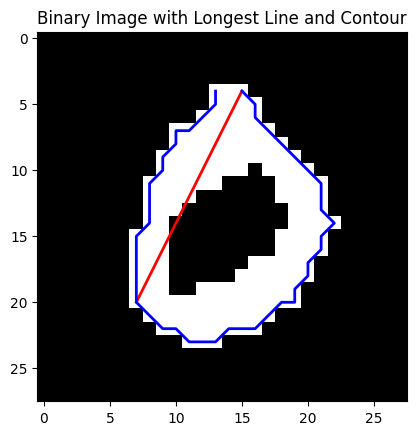

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


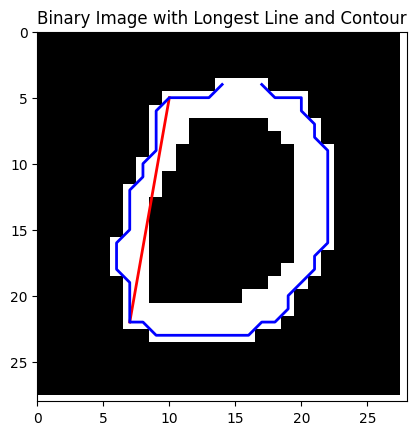

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


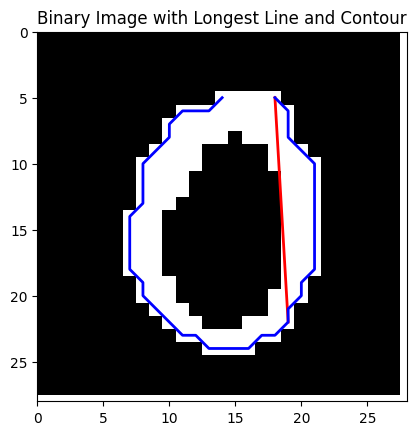

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


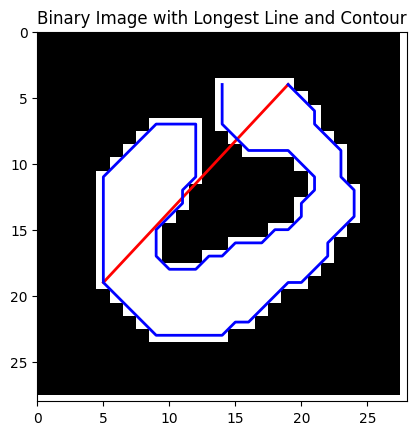

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


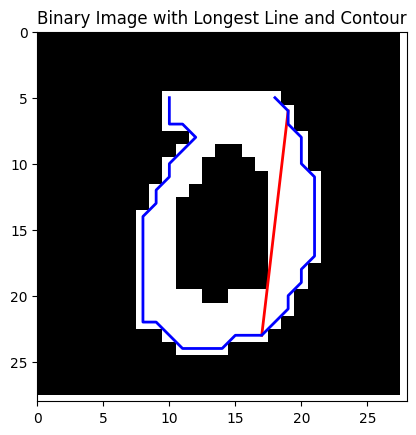

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


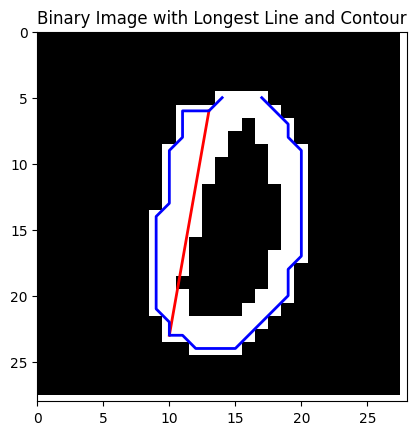

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


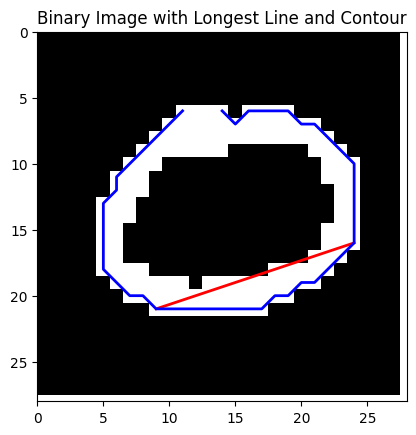

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


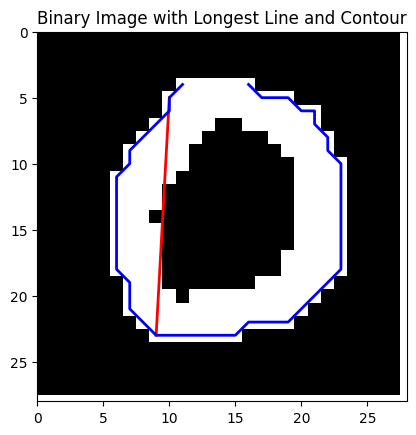

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


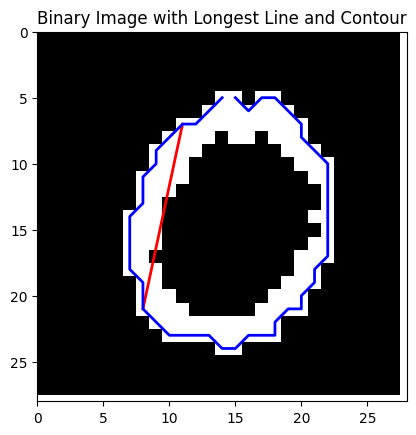

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9720


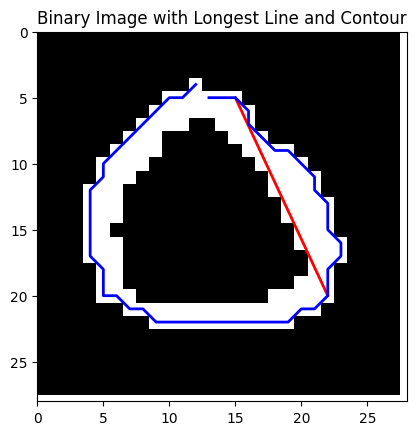

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


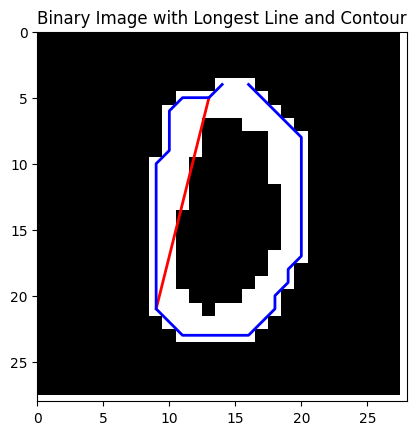

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


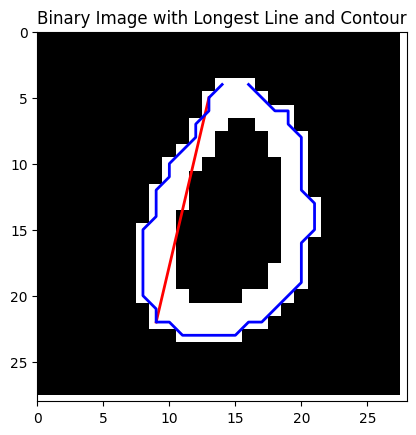

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9965


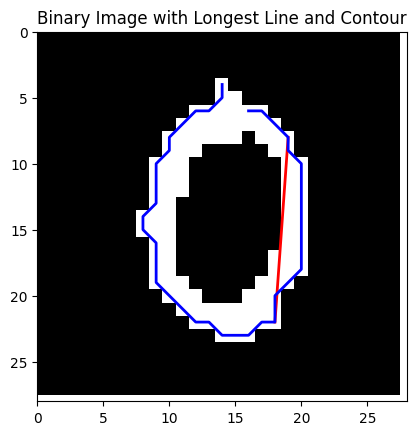

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


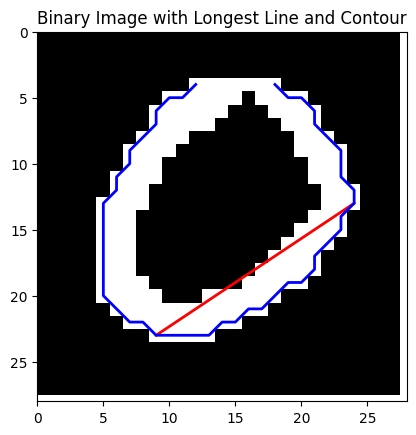

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


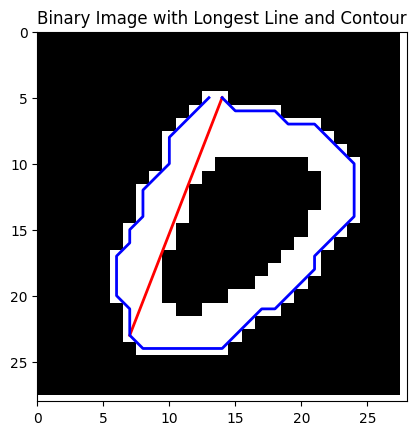

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


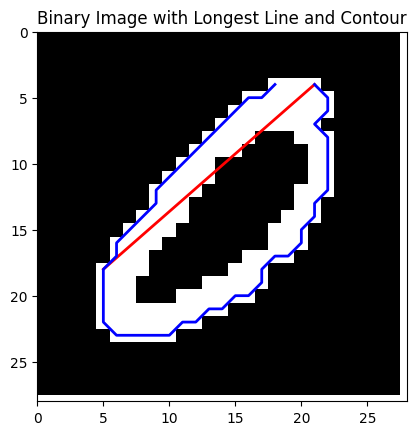

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


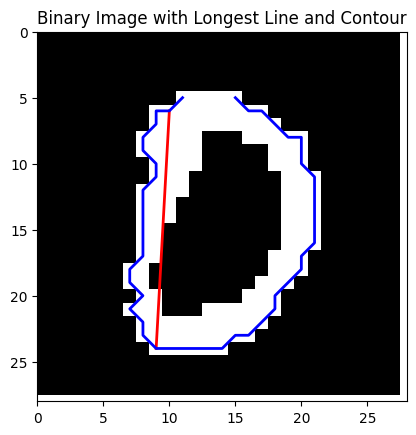

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


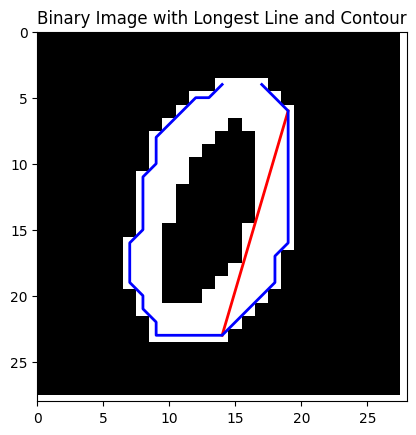

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


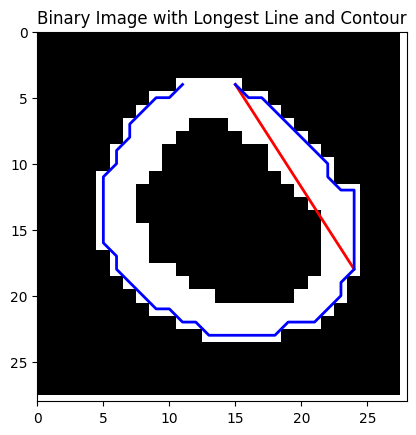

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9968


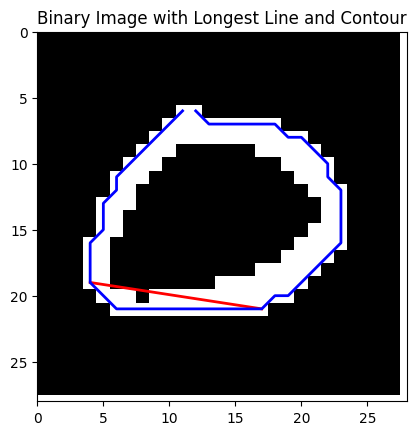

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9913


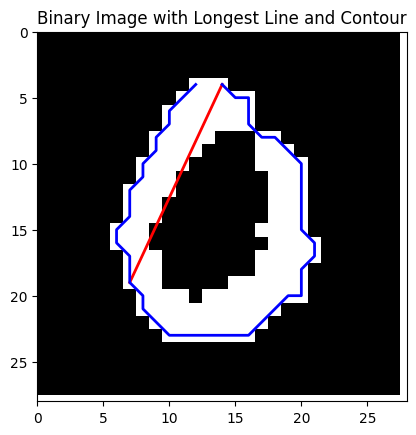

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9972


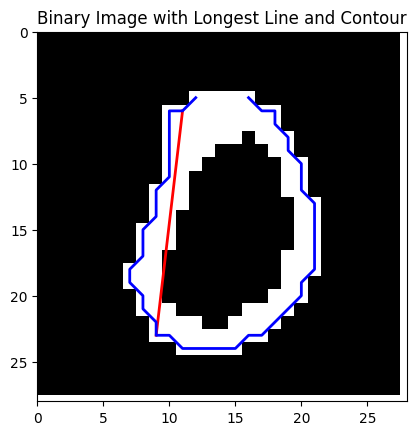

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


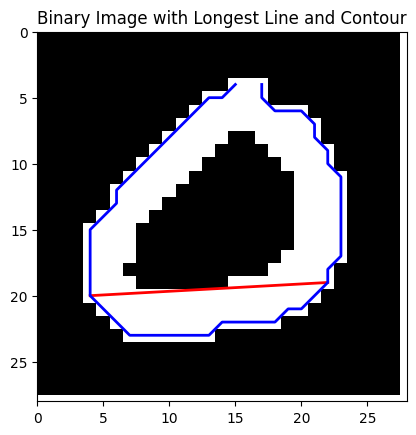

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9923


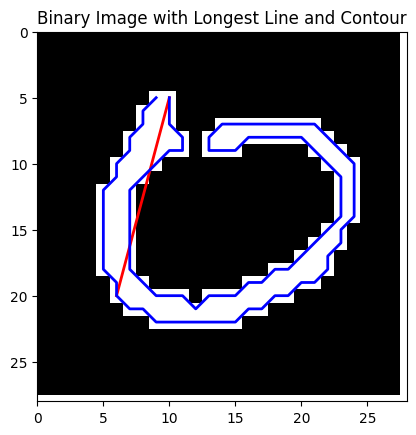

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9830


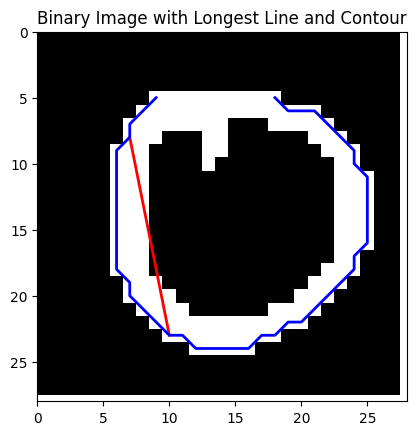

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


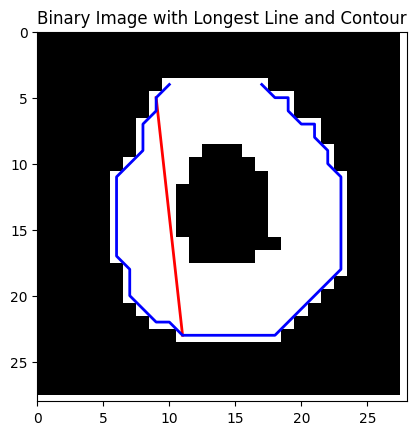

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


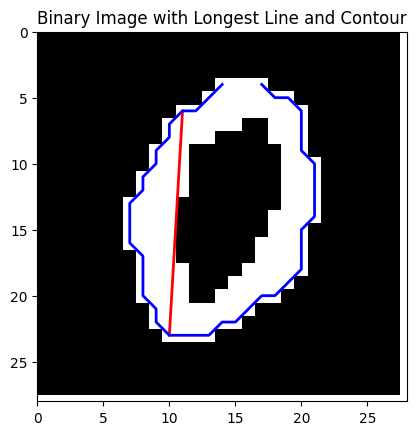

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


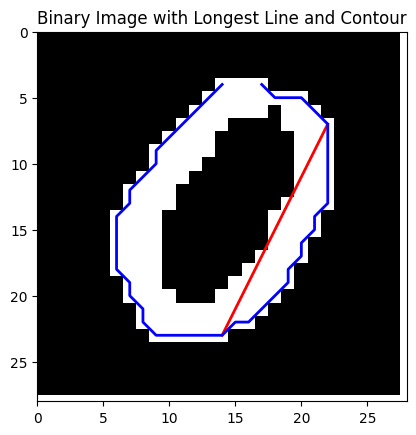

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


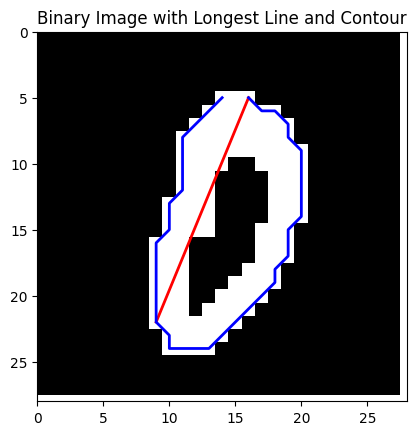

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


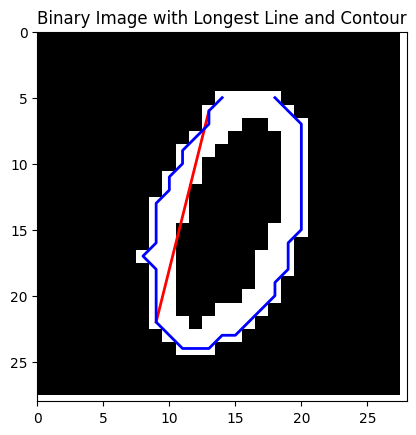

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9855


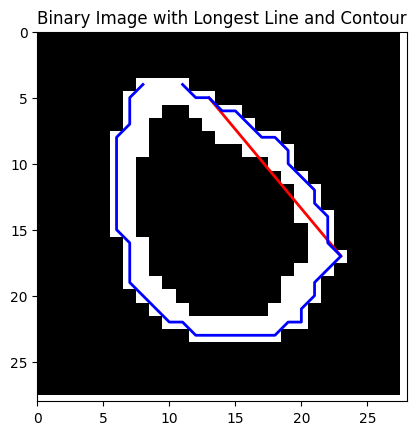

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9871


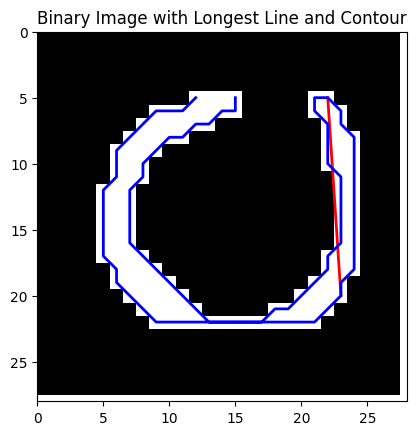

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


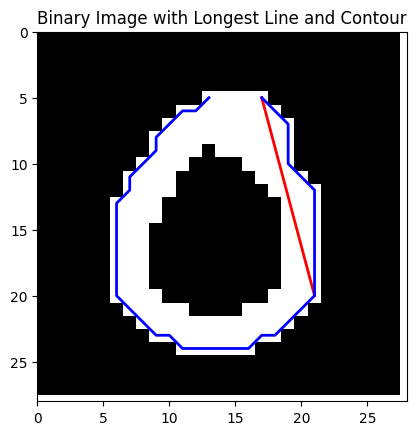

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


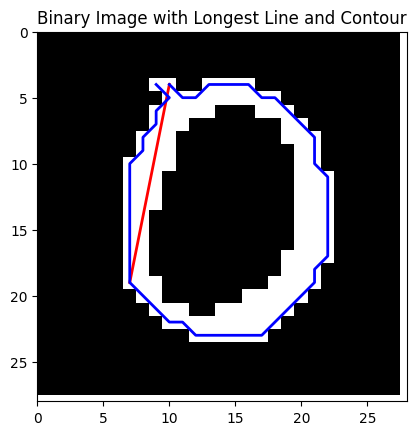

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


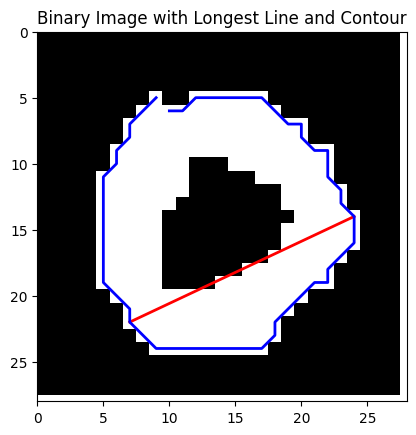

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9953


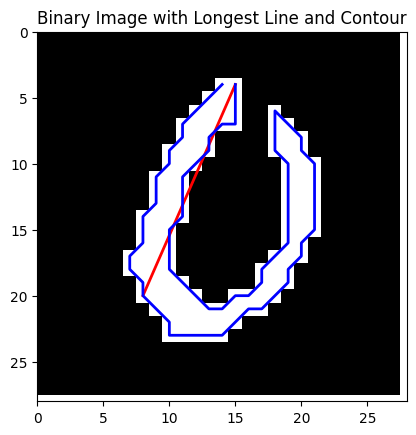

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9722


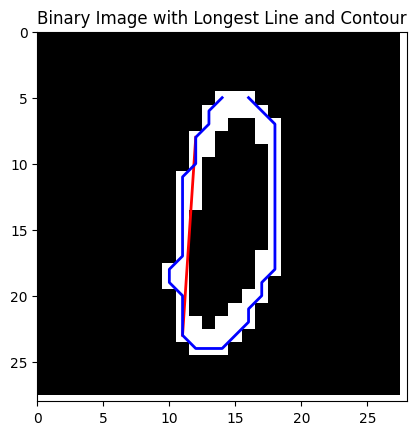

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


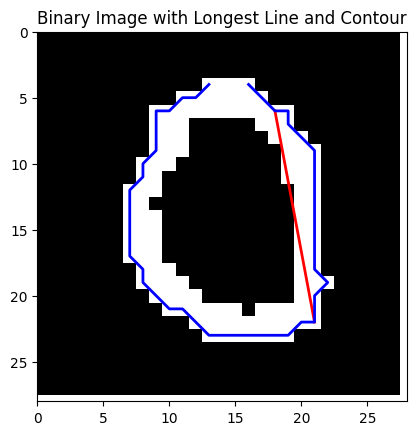

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9950


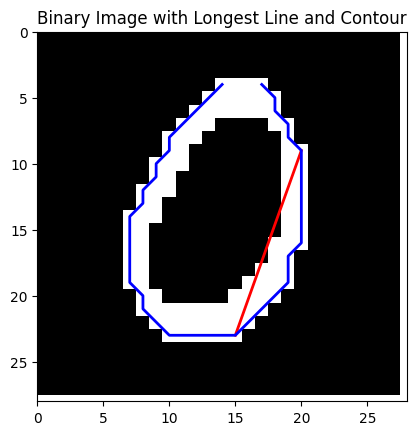

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9398


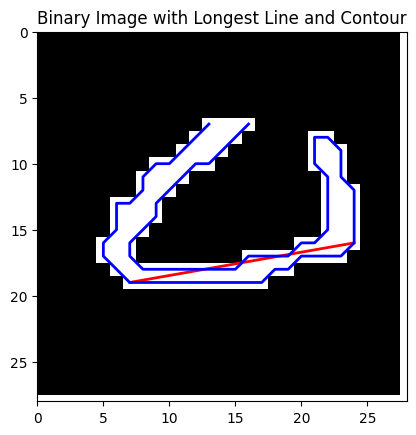

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9910


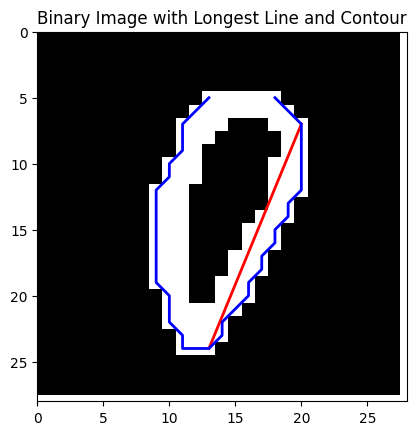

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


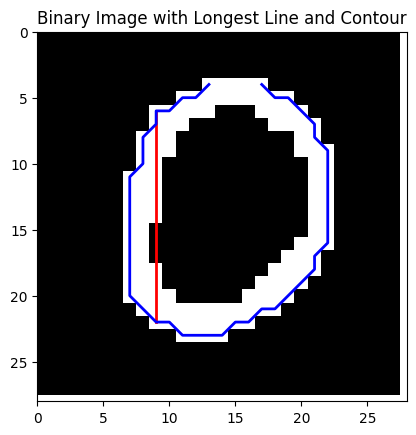

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9607


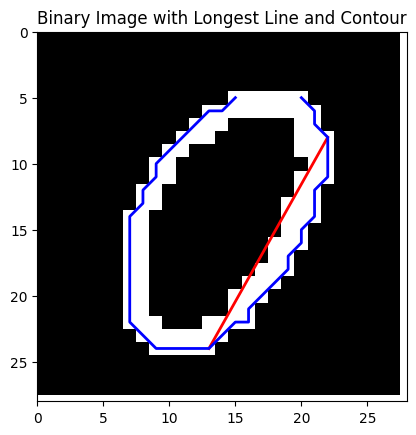

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


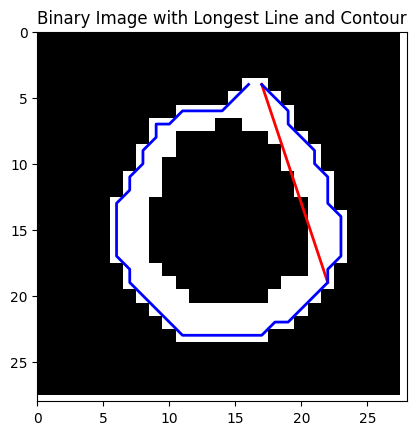

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9916


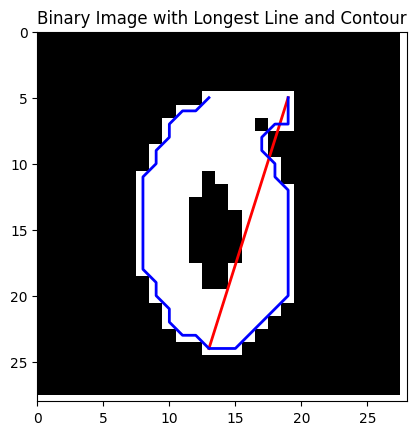

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


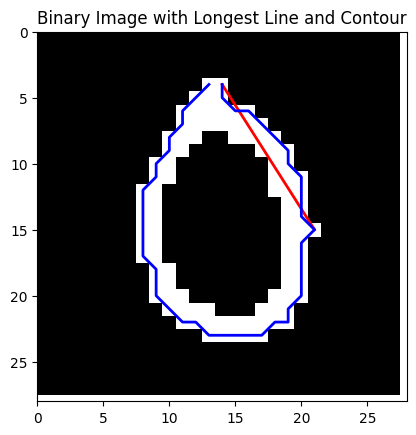

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9692


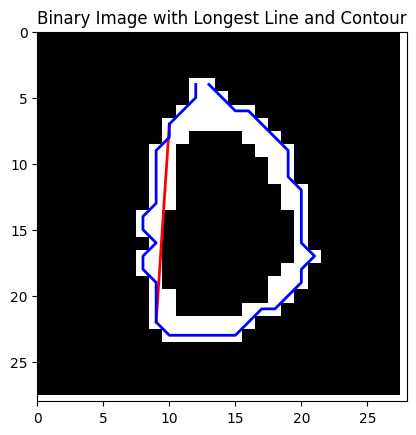

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


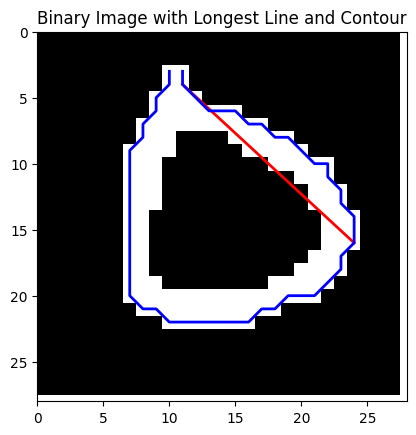

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


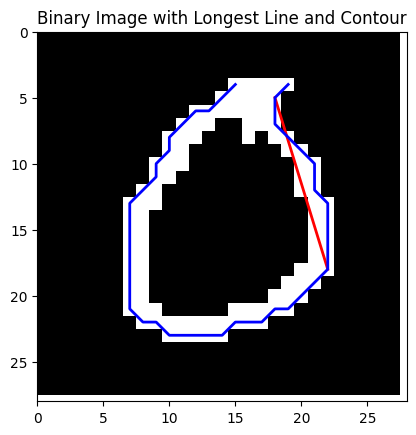

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


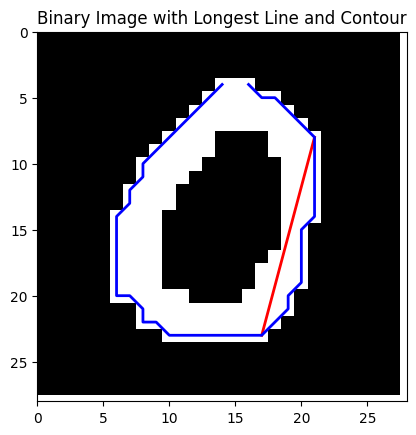

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9935


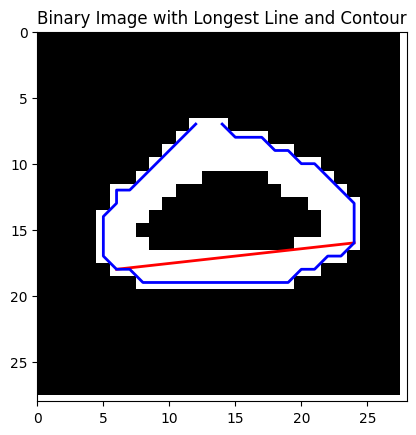

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9901


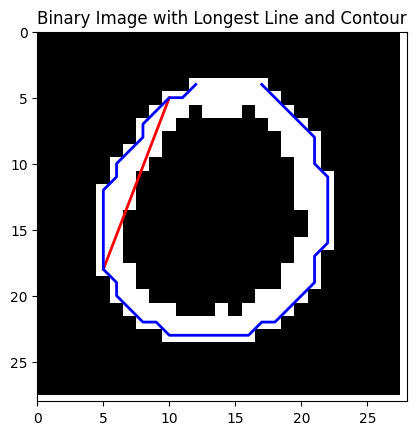

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


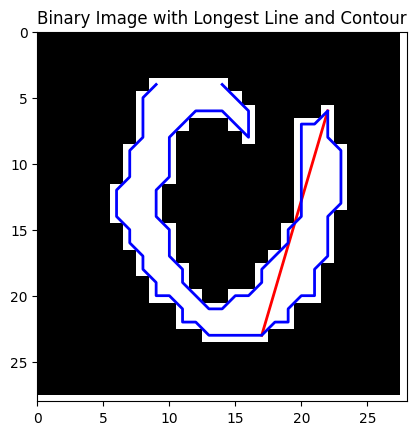

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9980


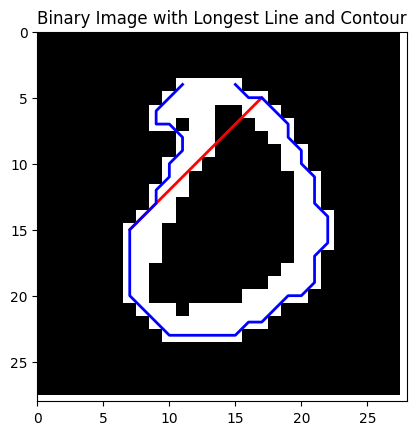

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9952


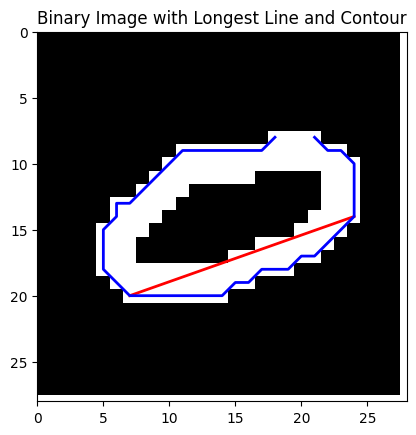

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


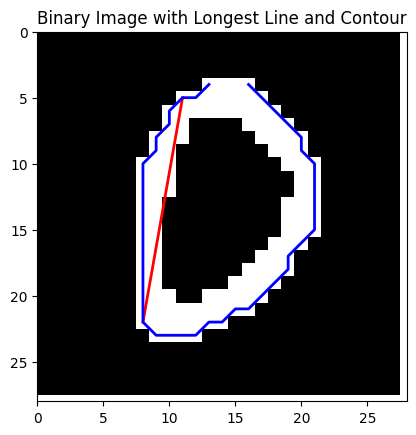

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


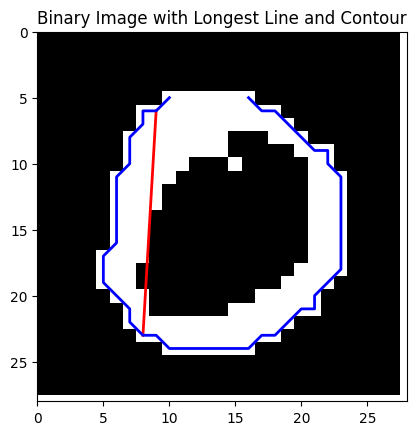

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


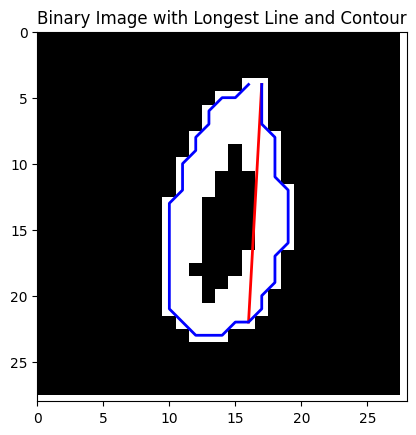

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


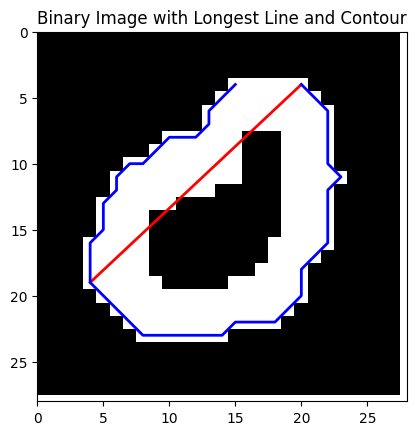

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9880


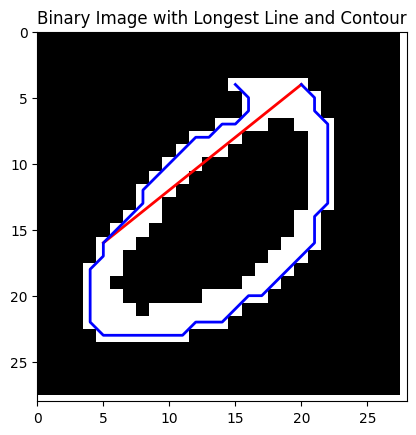

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9611


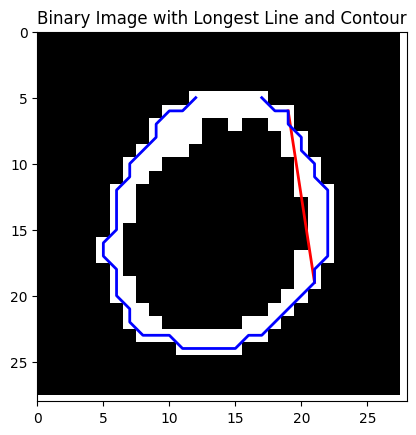

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


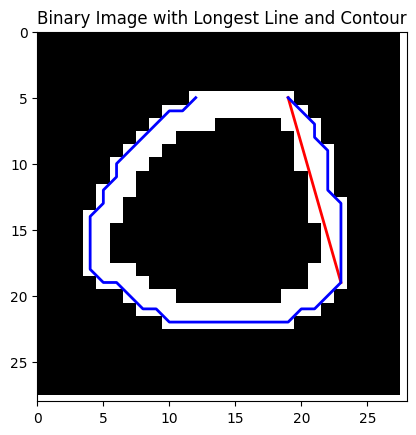

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9666


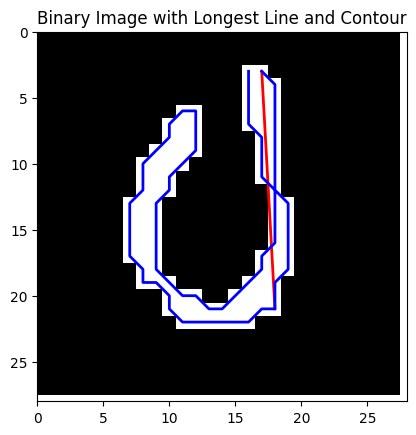

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


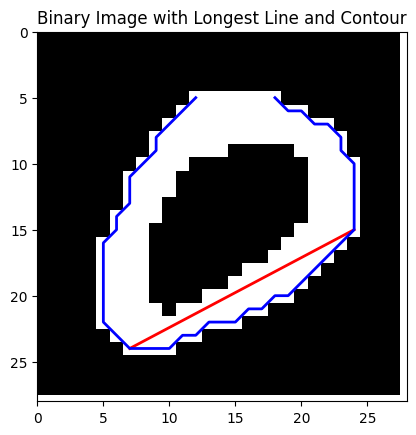

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9959


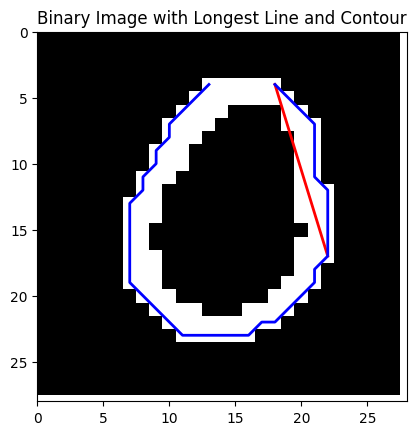

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9860


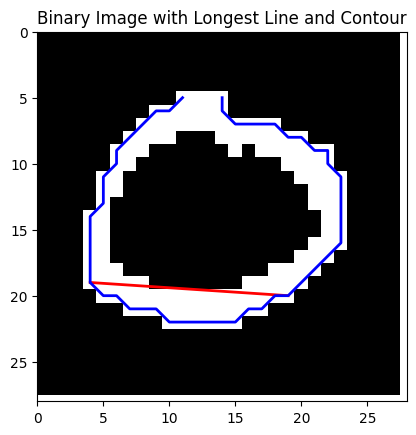

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


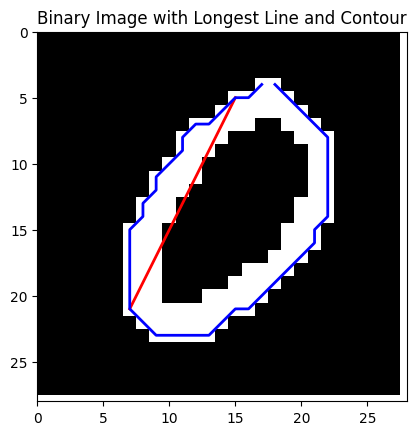

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9938


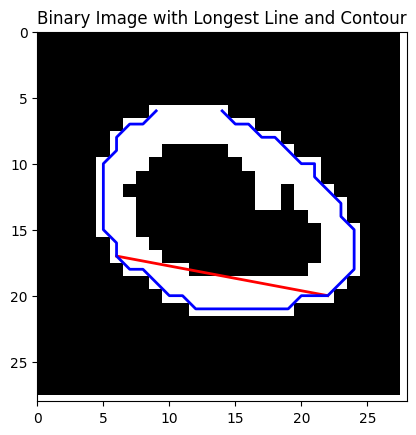

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9884


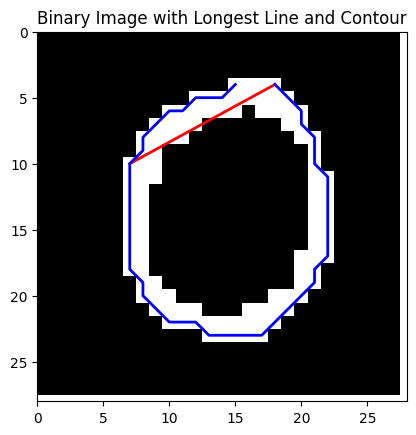

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


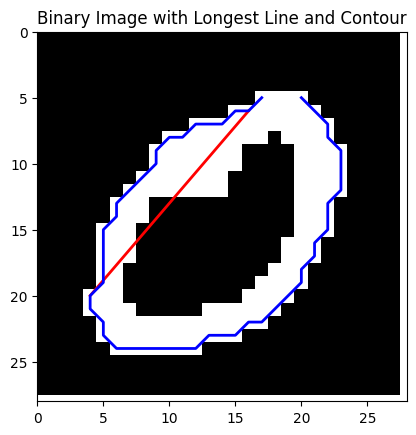

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


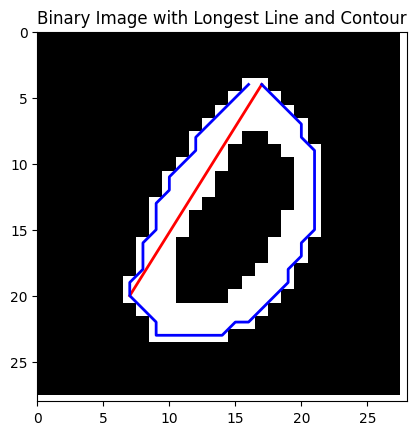

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


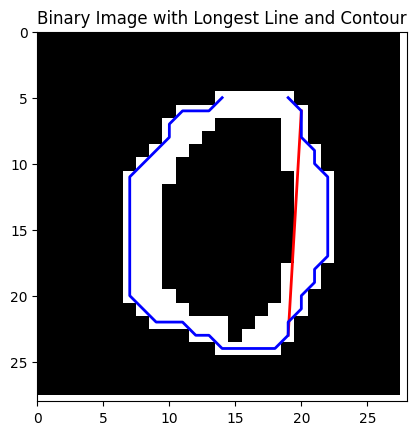

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


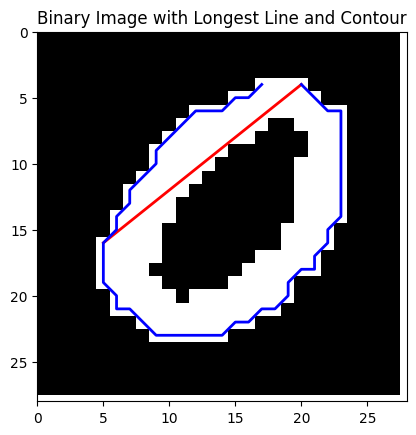

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9942


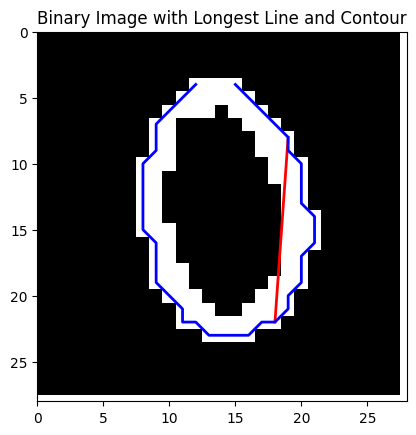

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9657


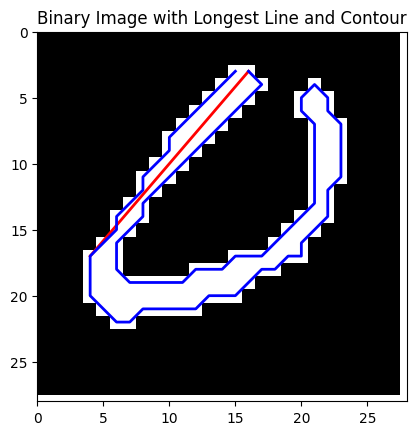

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9905


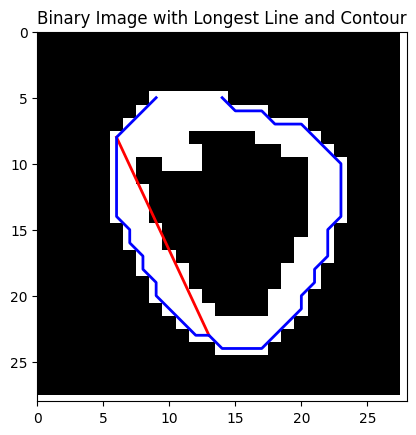

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9686


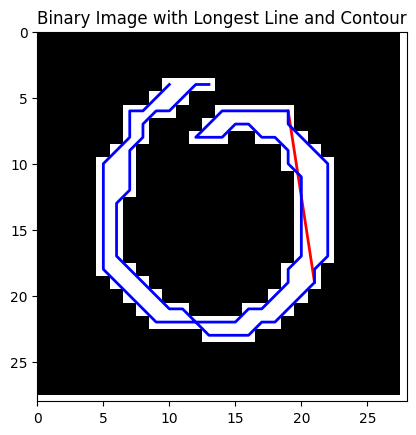

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


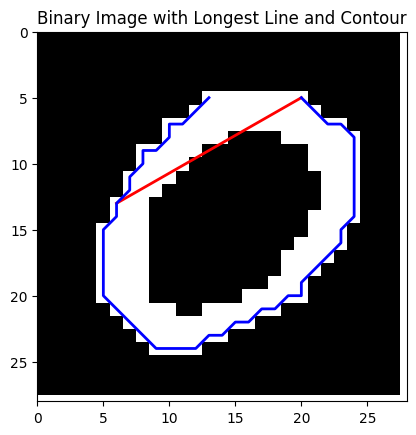

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


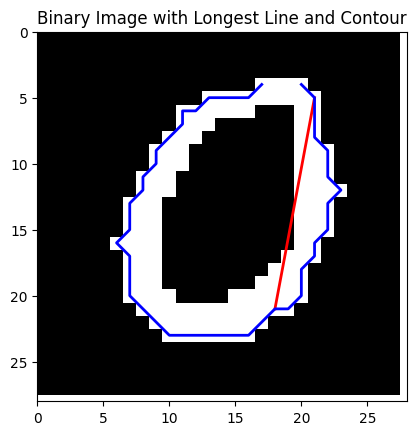

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


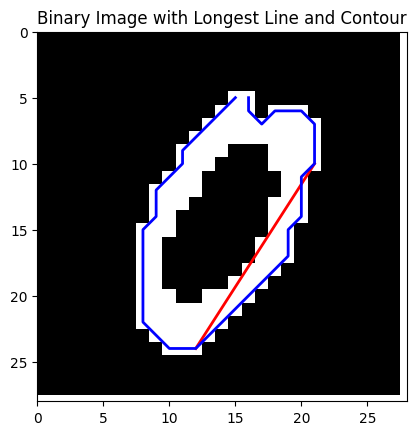

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


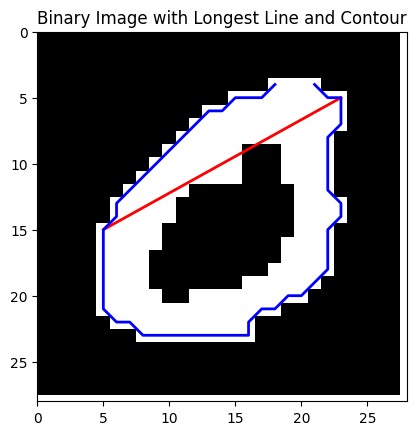

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


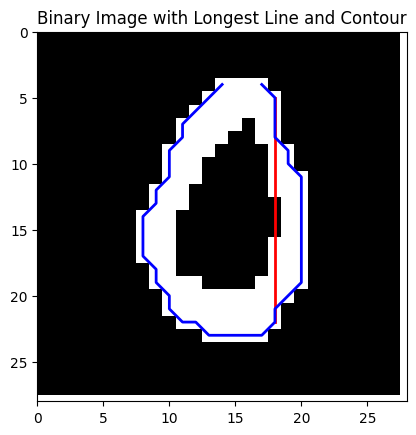

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9950


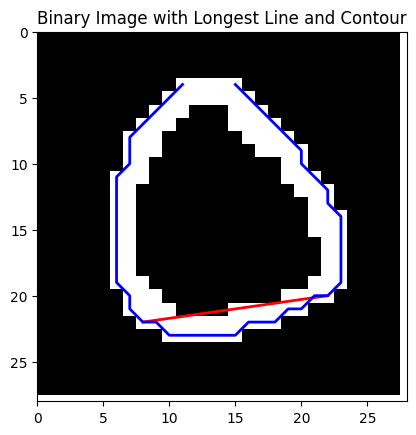

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9903


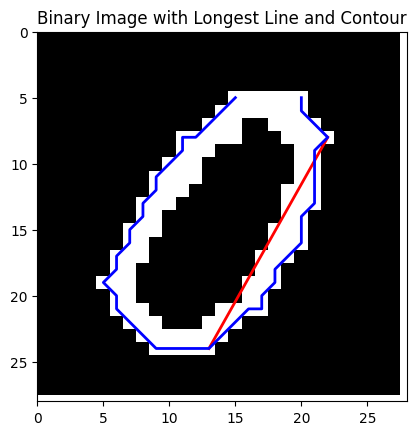

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


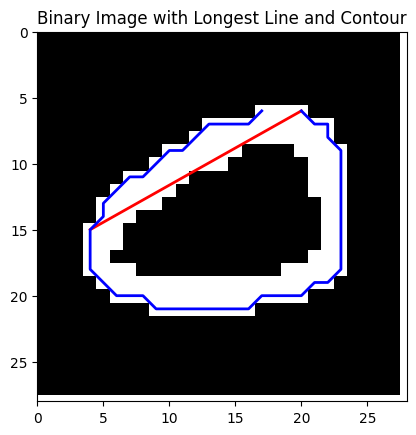

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


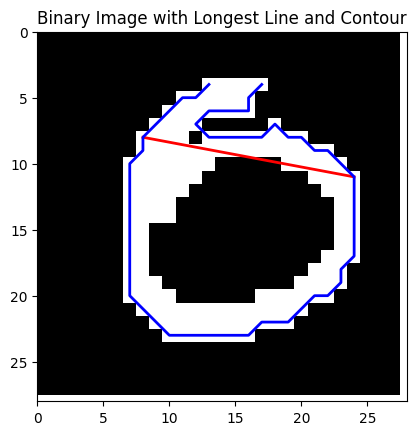

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


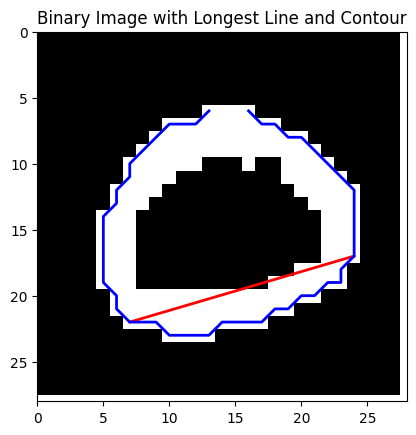

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


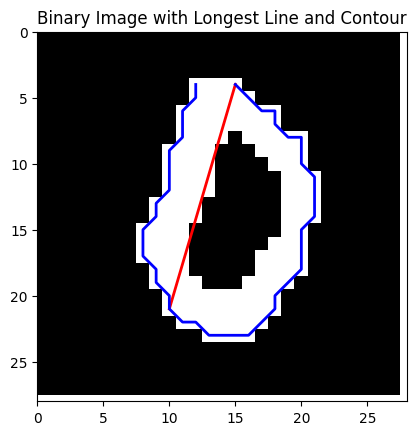

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


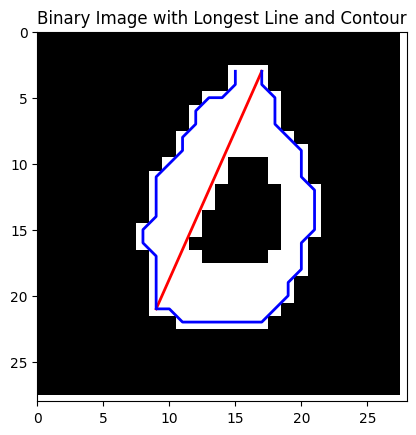

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


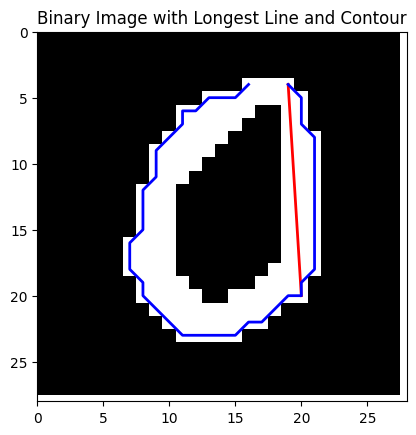

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9925


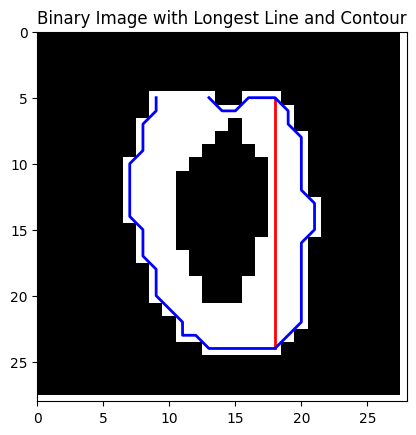

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9969


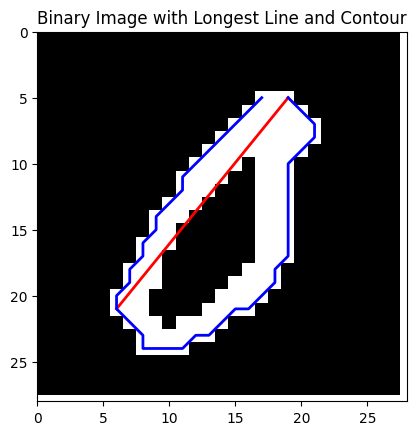

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


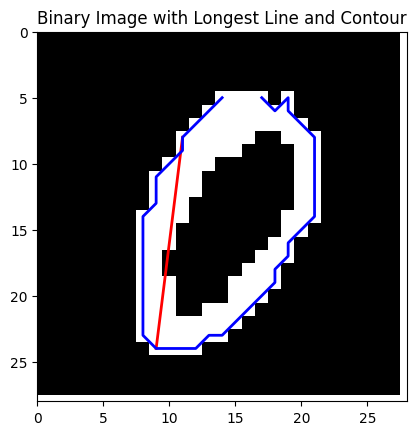

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


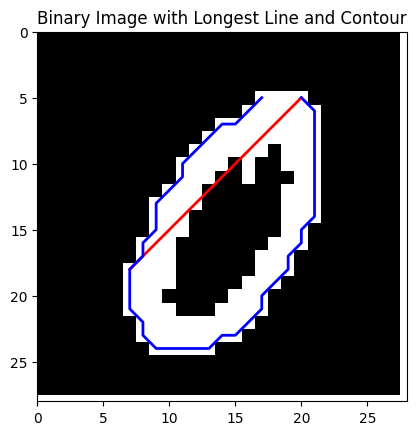

Prediction probability for digit 9: 0.9994


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


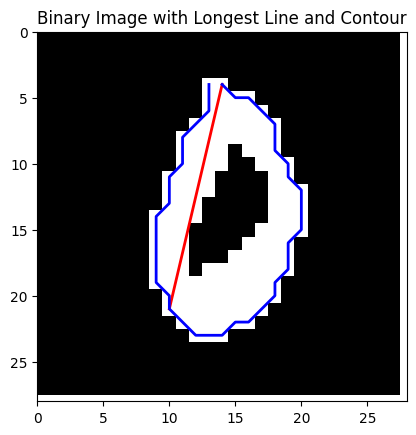

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


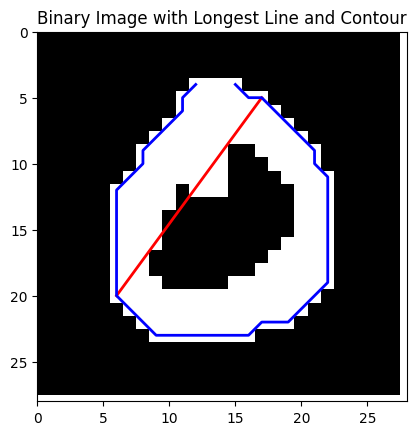

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


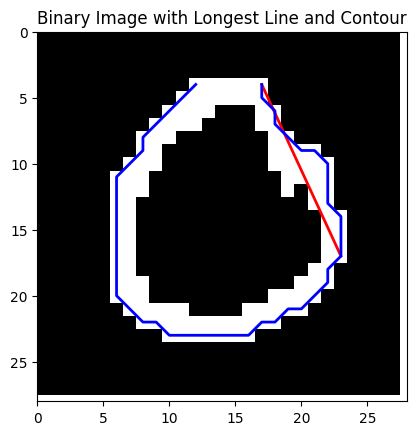

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9879


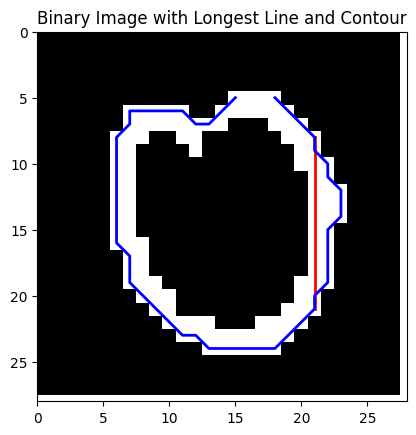

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


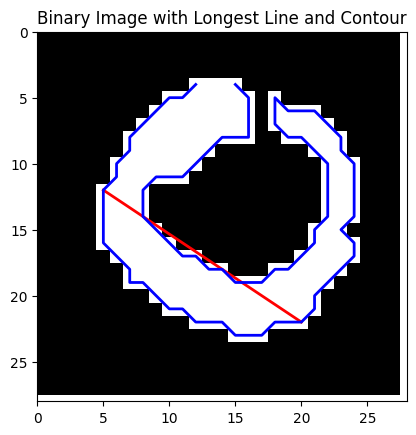

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9916


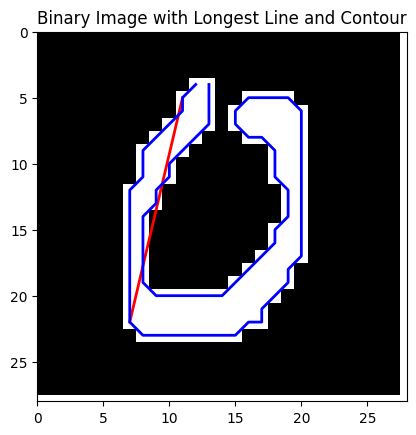

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.999     75     0.200       False             6.567   
1       1.000     97     0.176       False             8.065   
2       0.999     86     0.171       False             7.216   
3       1.000     84     0.290       False             7.337   
4       0.998     84     0.202       False             7.018   
..        ...    ...       ...         ...               ...   
95      1.000     85     0.250       False             7.268   
96      0.999     99     0.156       False             8.289   
97      0.988    100     0.152       False             8.460   
98      0.997     90     0.255       False             7.777   
99      0.992     86     0.180       False             7.336   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               2.213 -0.500  17.000     111     46               17.889   
1               1.478 -0.176  10.882      99     39               17.263   
2  

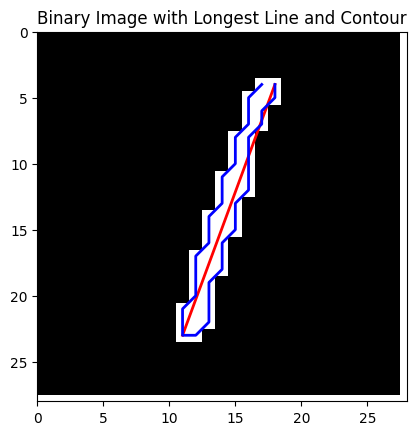

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


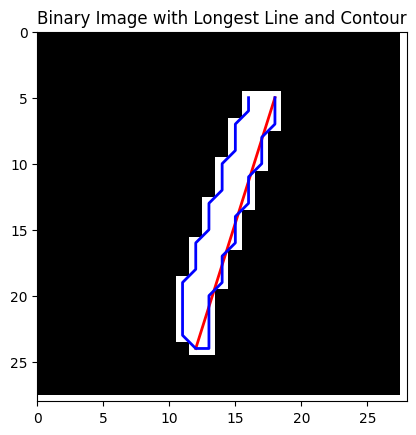

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


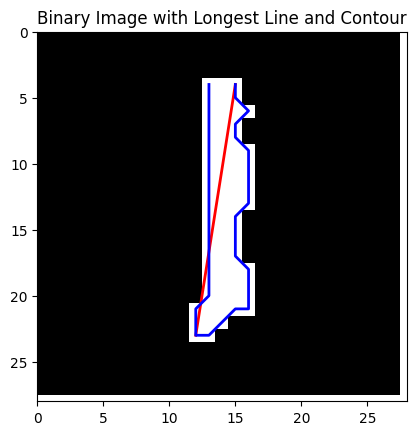

Prediction probability for digit 9: 0.9858


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


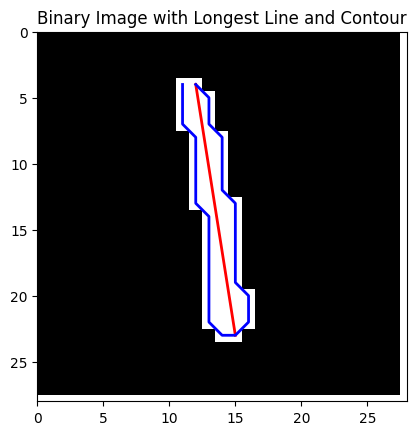

Prediction probability for digit 9: 0.9931


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


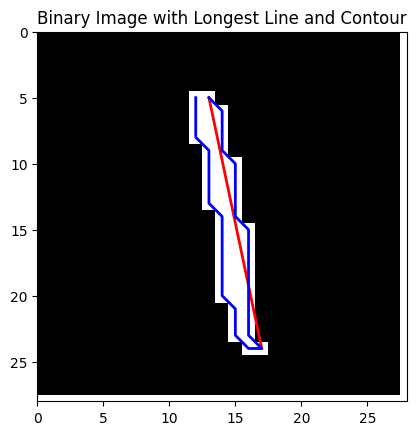

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


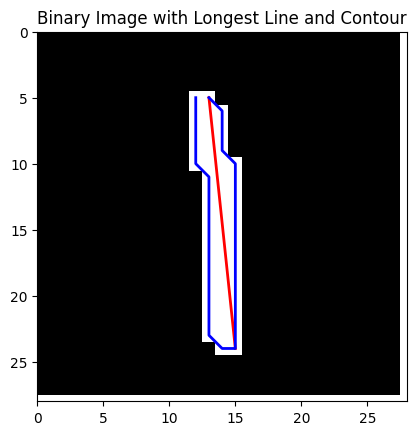

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


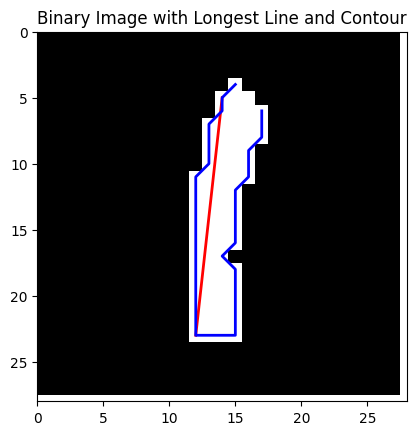

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9905


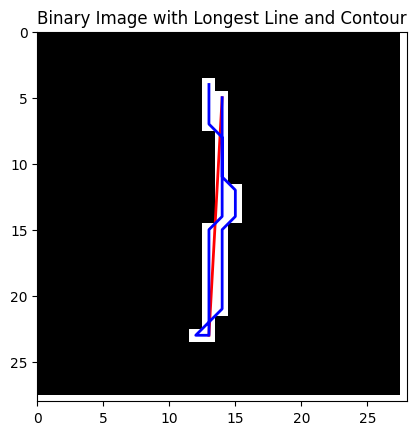

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9922


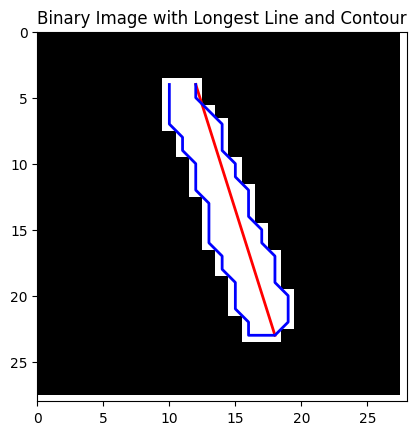

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9973


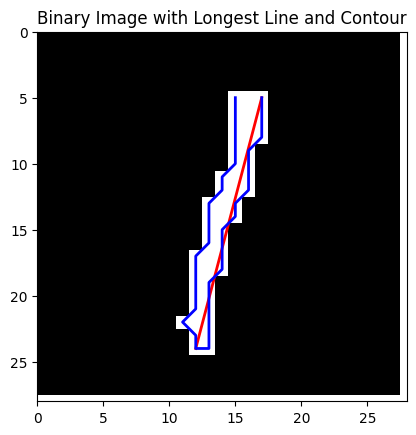

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9964


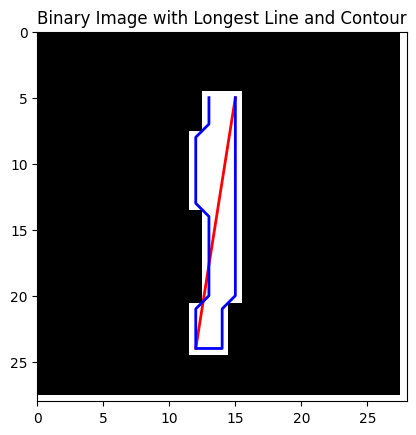

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


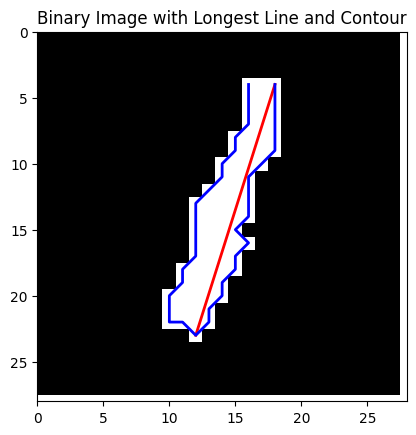

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9959


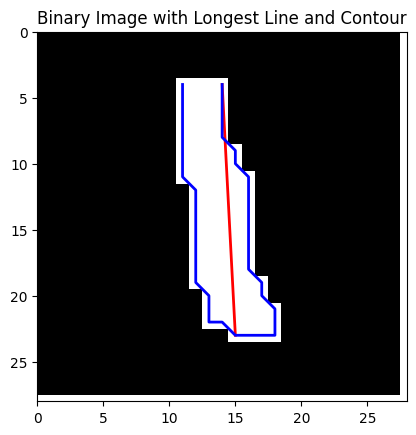

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9137


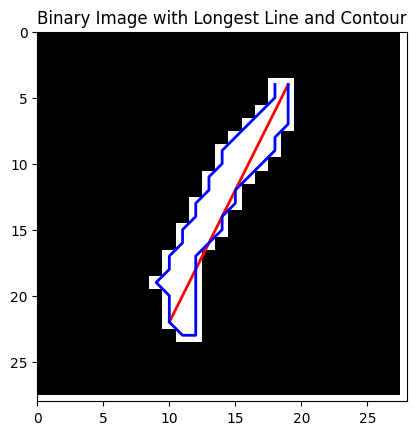

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


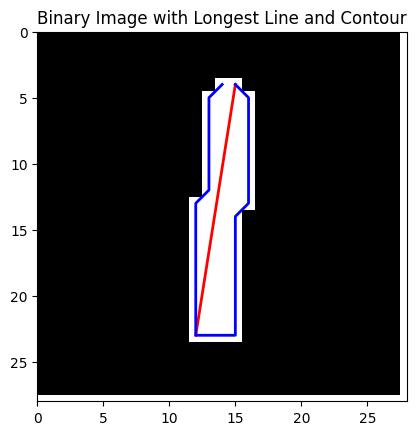

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9936


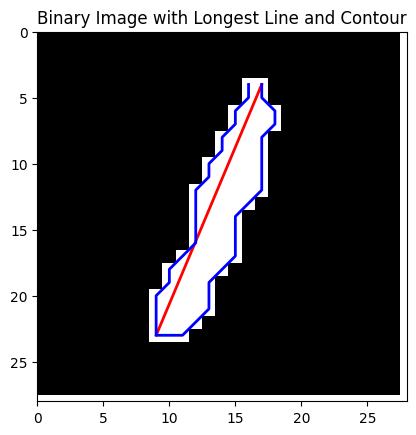

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9986


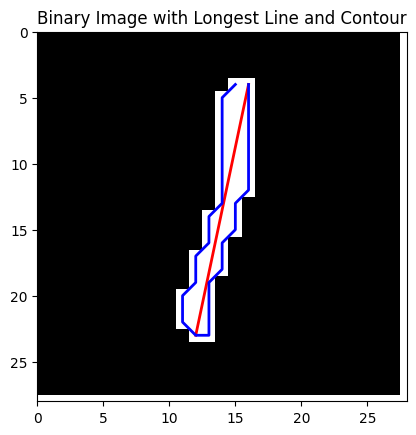

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9962


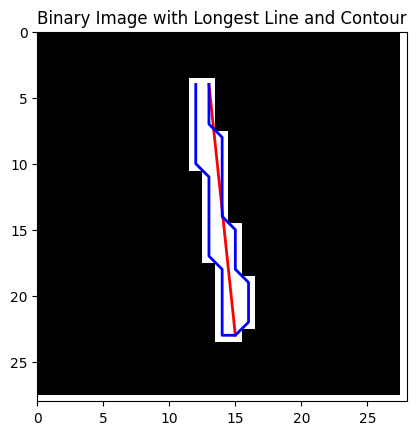

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


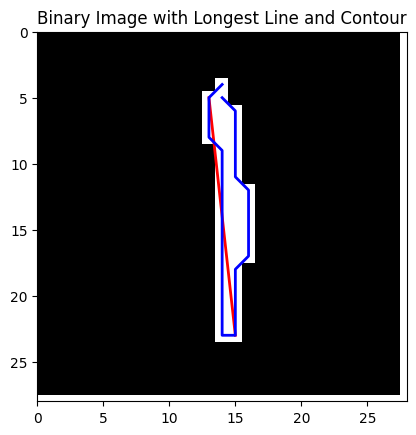

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


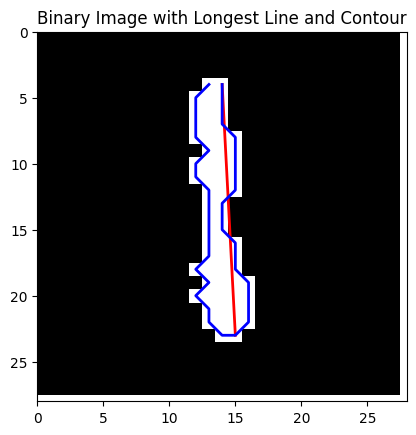

Prediction probability for digit 9: 0.9969


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


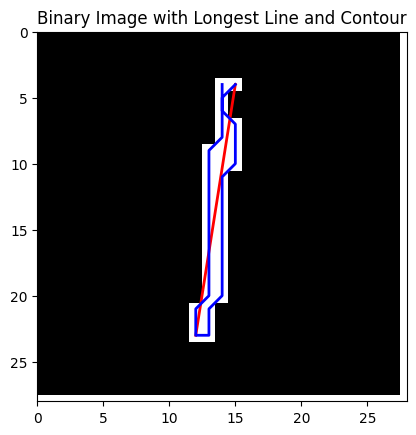

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


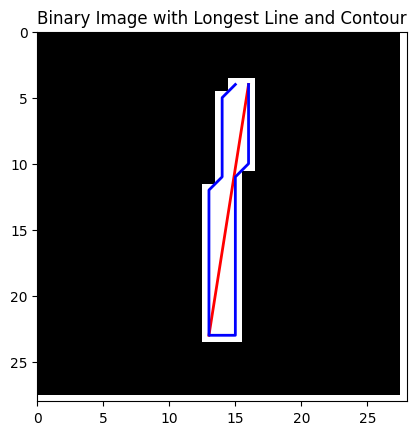

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


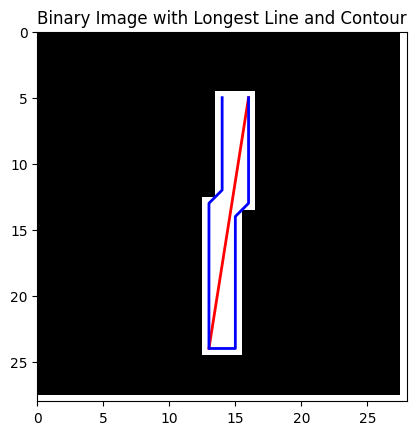

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9535


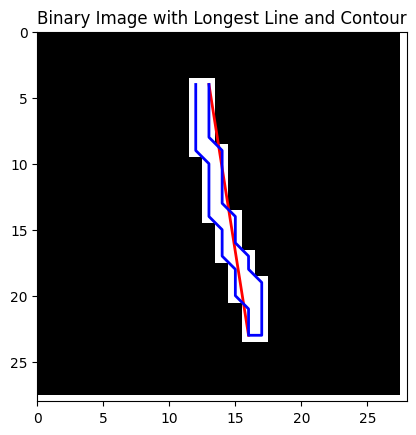

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9968


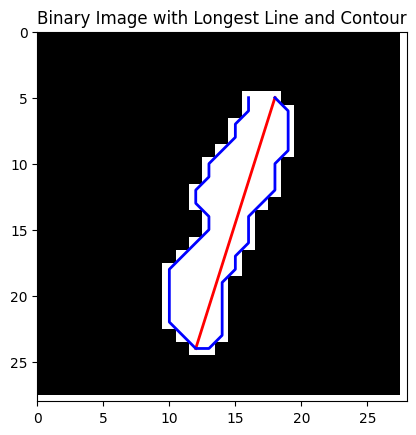

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9810


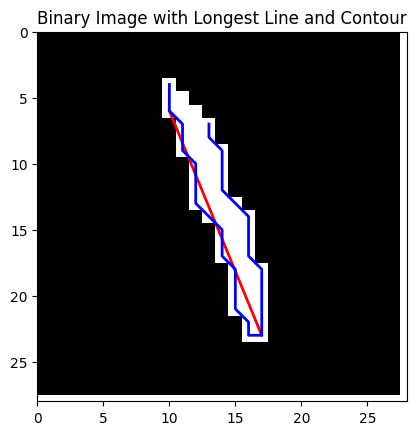

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


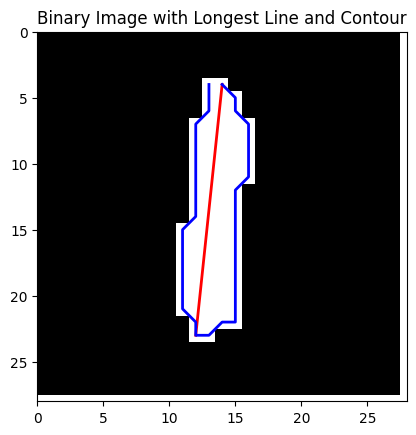

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


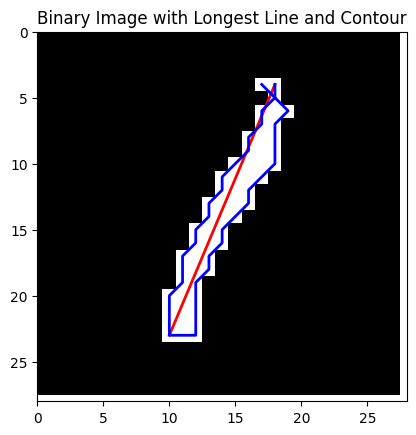

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


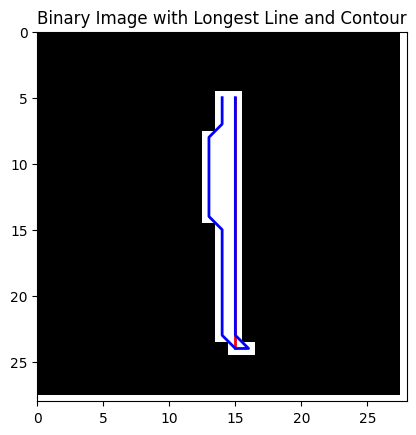

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


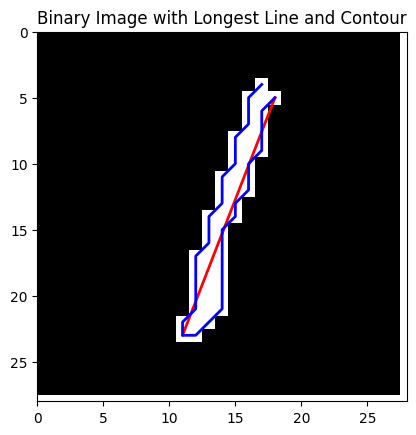

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9822


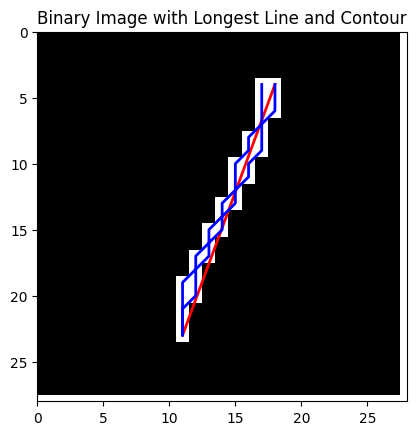

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


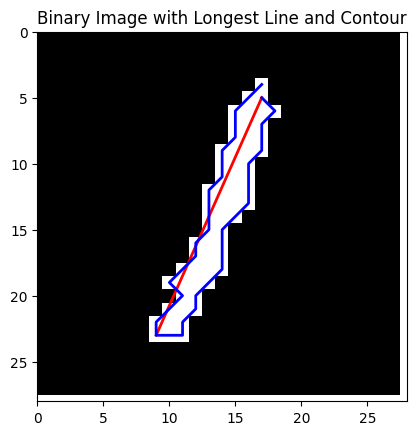

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


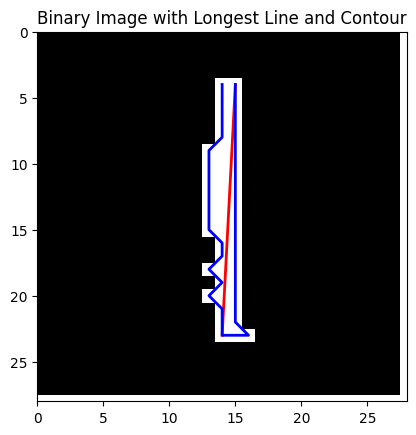

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9675


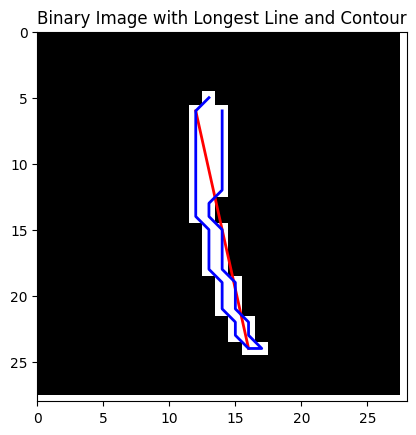

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


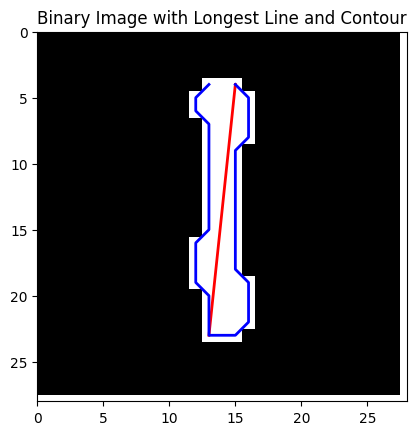

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


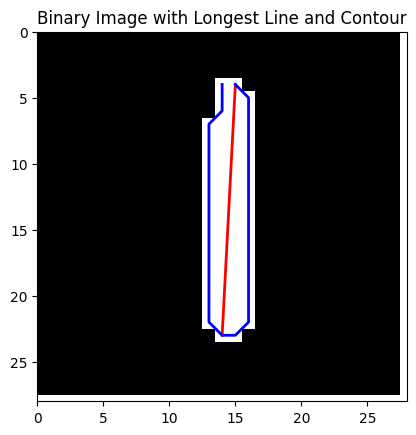

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


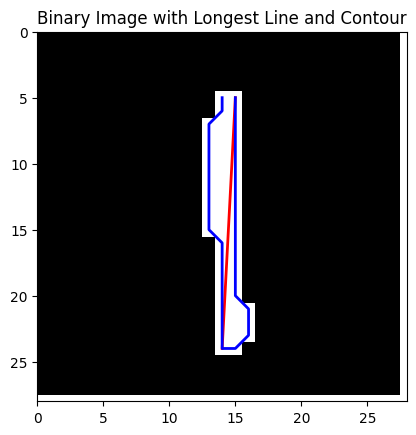

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


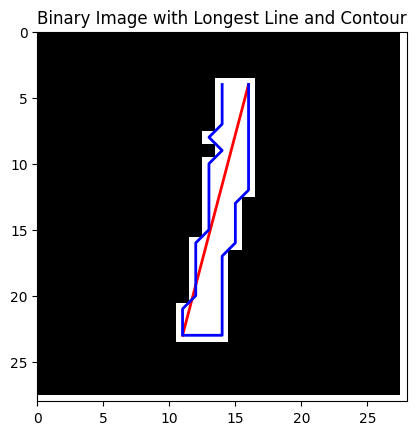

Prediction probability for digit 9: 0.9993


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


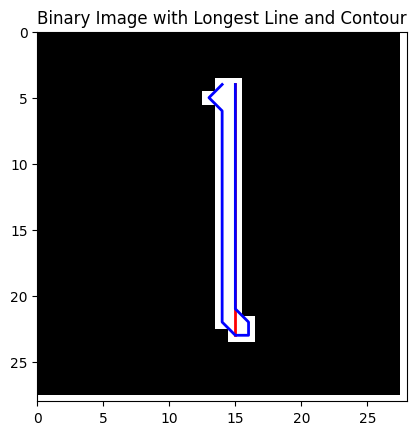

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9874


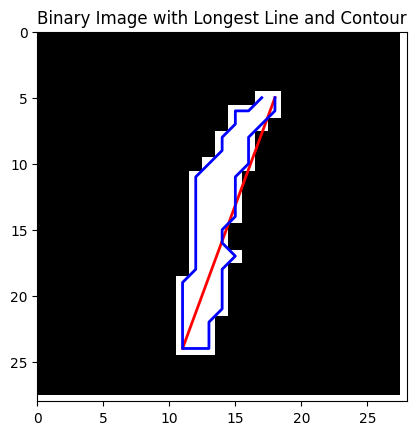

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


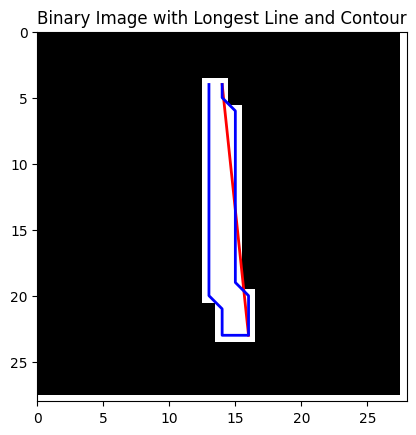

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


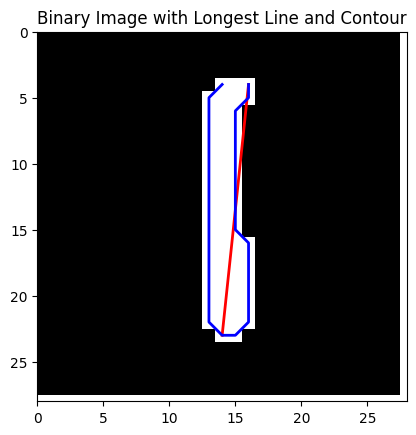

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


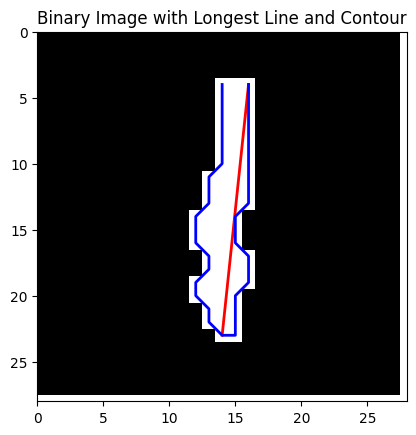

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


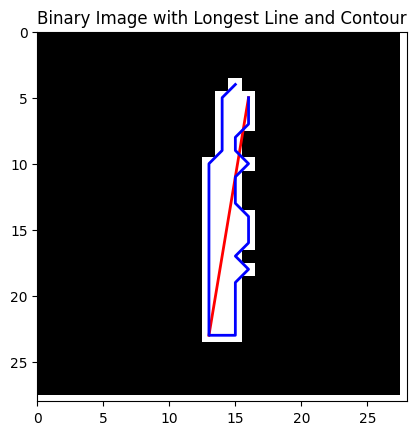

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


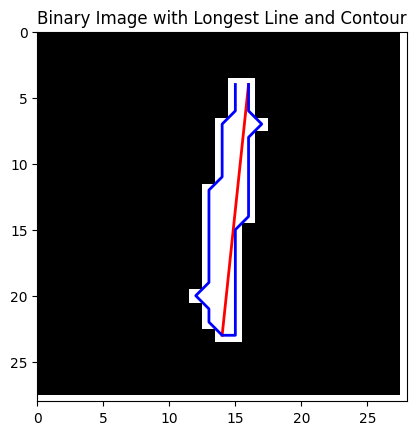

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


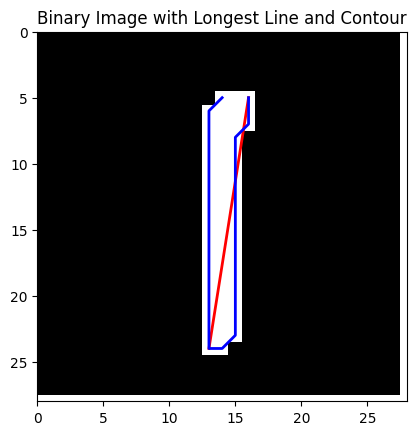

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


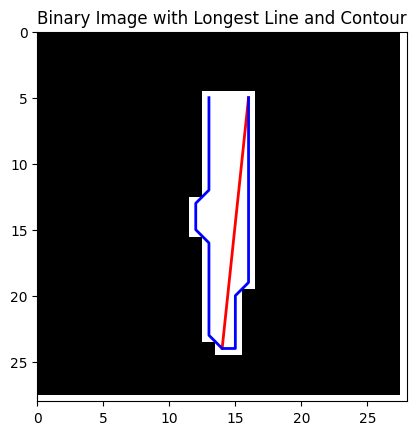

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9967


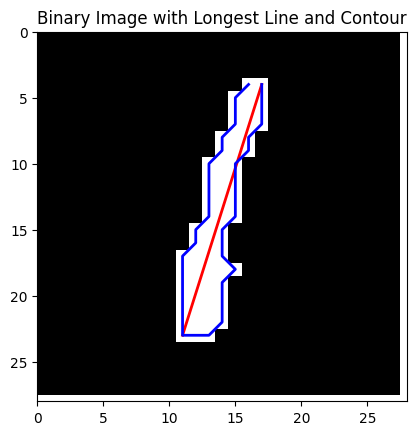

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


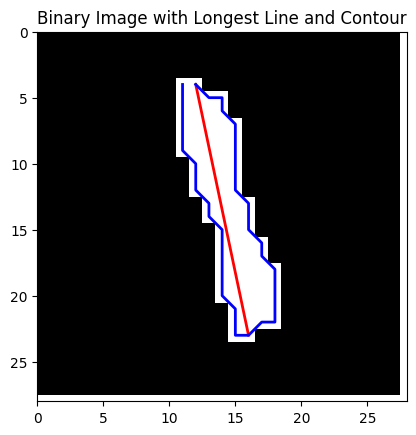

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


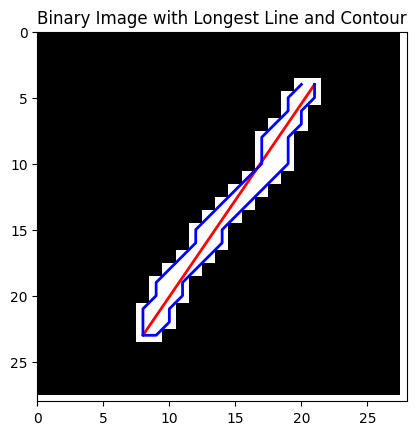

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9794


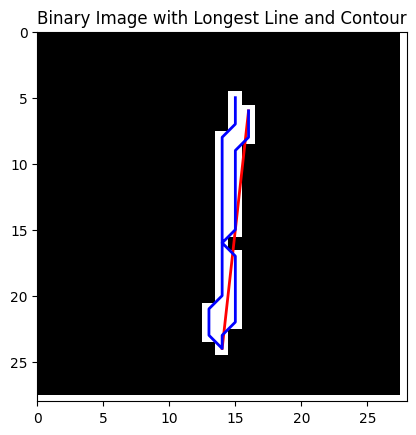

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9957


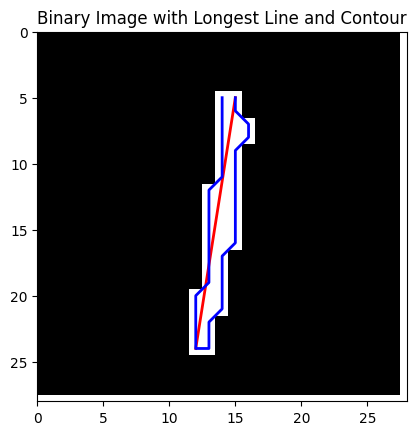

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


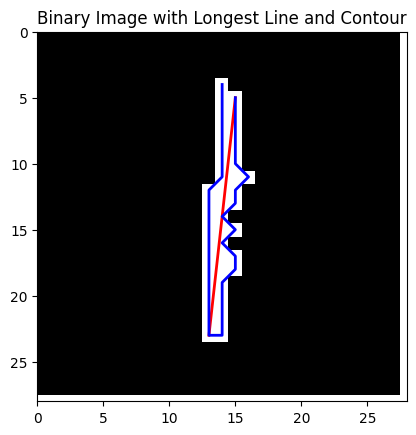

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


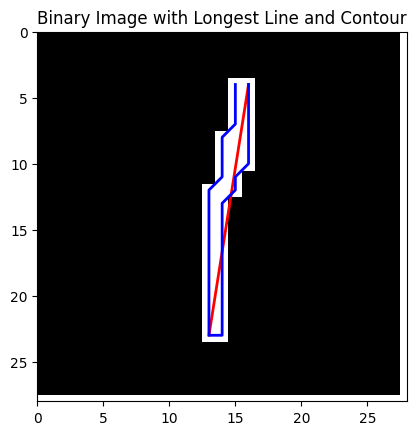

Prediction probability for digit 9: 0.9995


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


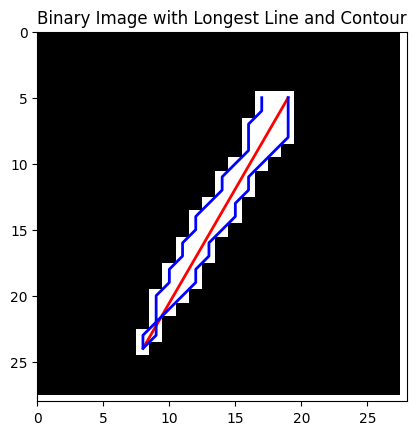

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


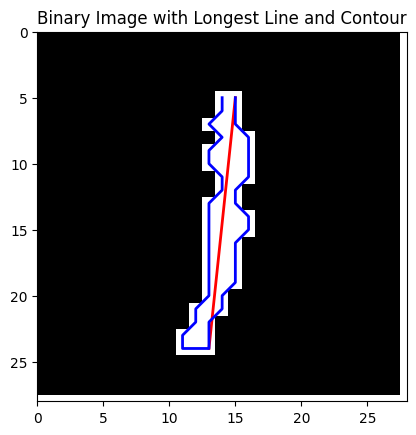

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9972


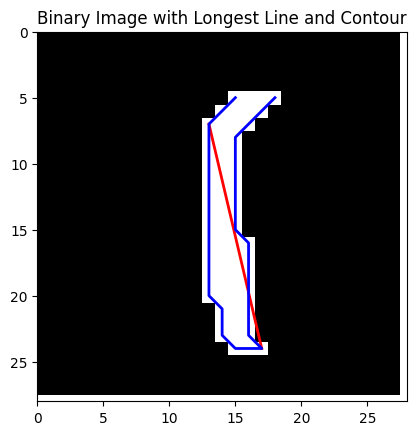

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9977


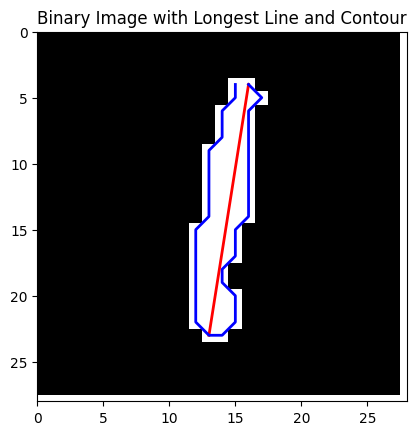

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


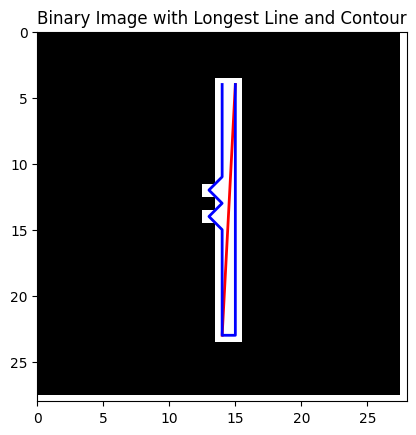

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


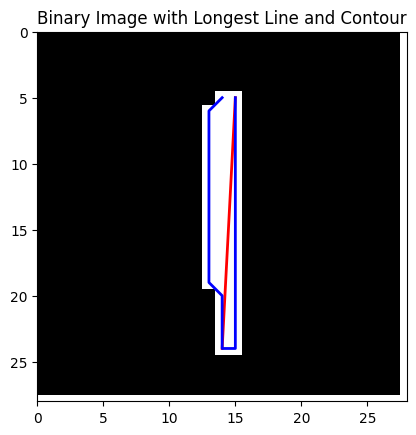

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9962


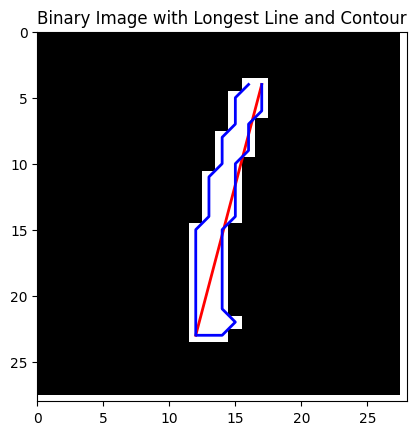

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


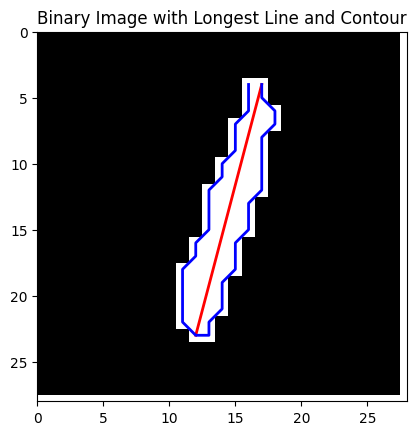

Prediction probability for digit 9: 0.9941


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


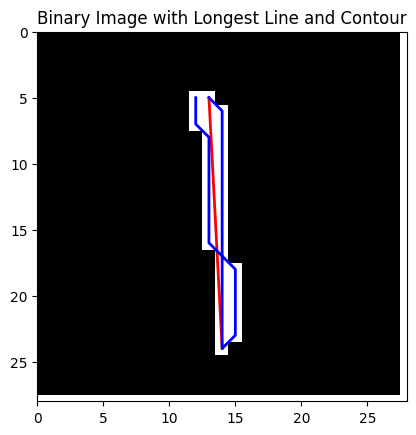

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


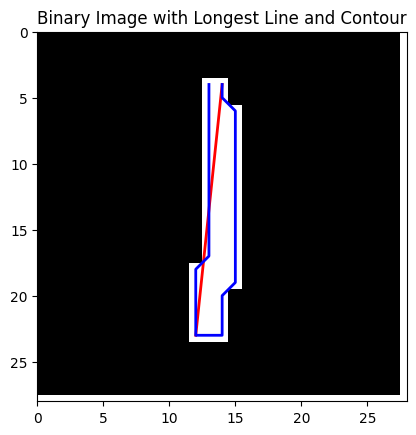

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


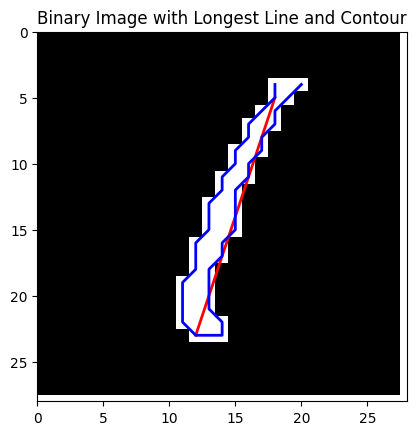

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9971


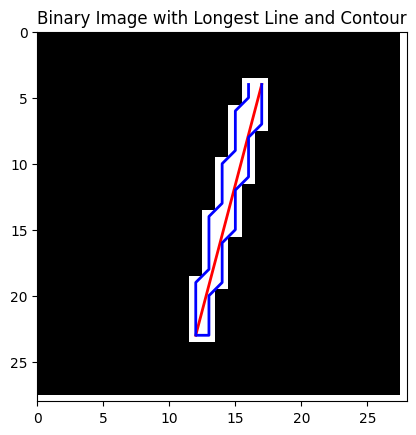

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9892


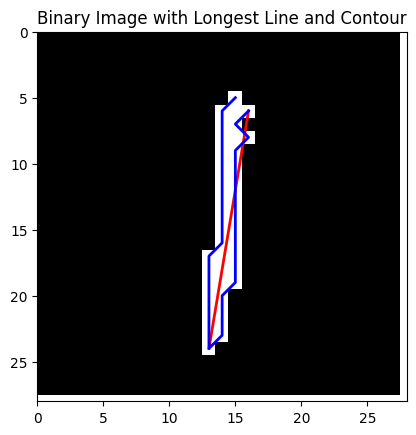

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9946


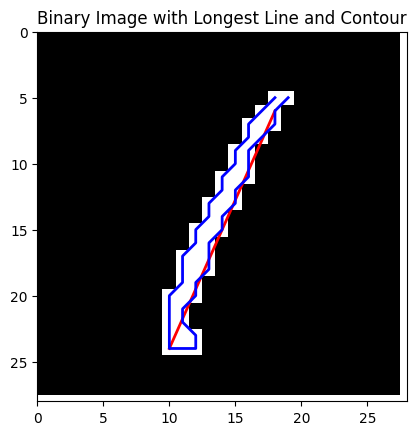

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9953


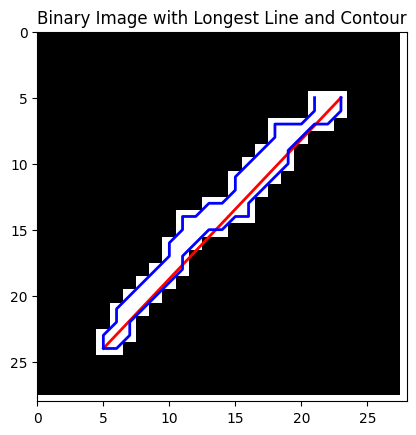

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


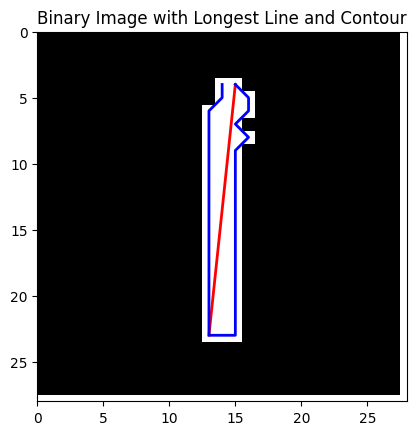

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


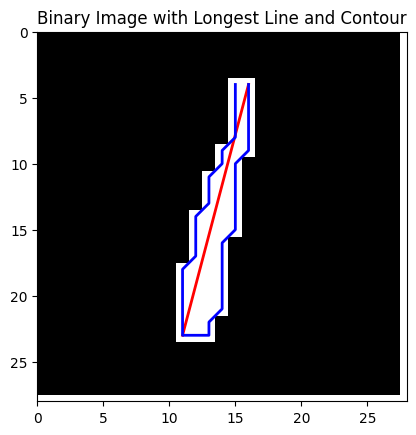

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


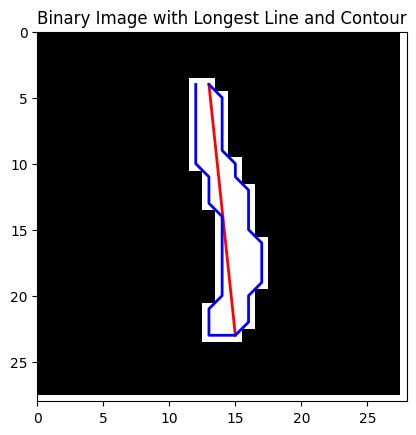

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9960


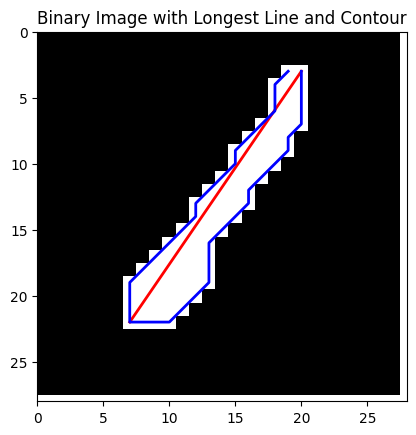

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


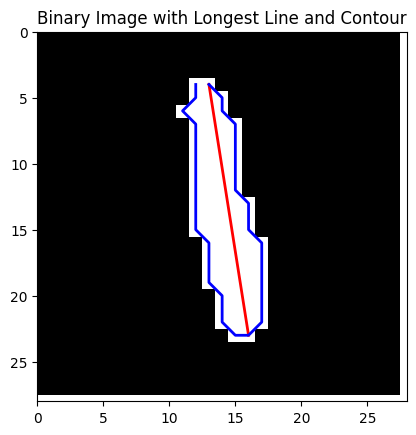

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


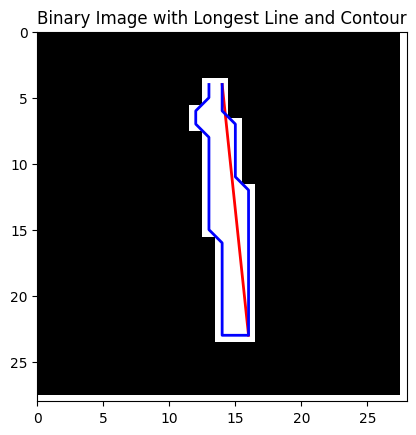

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


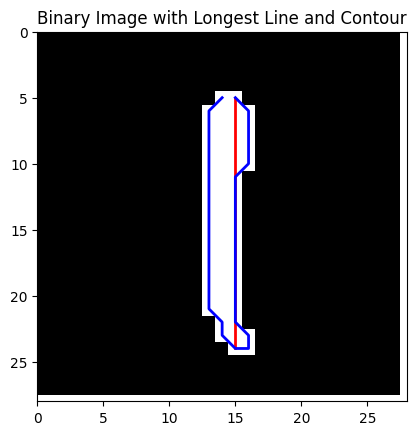

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


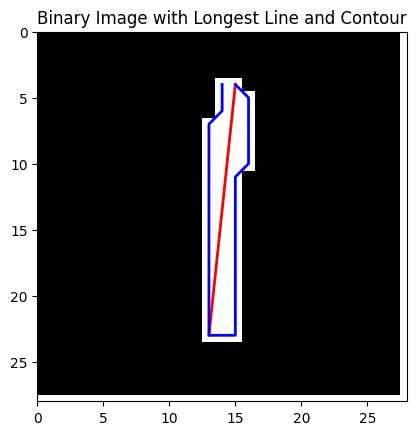

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9981


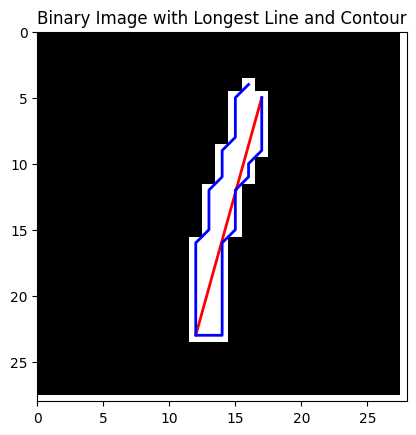

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


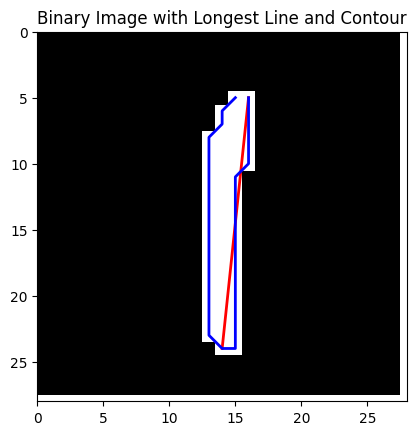

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


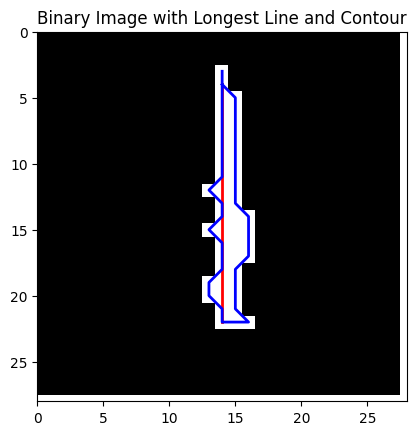

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


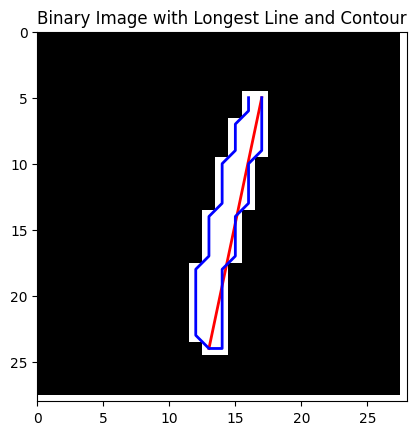

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


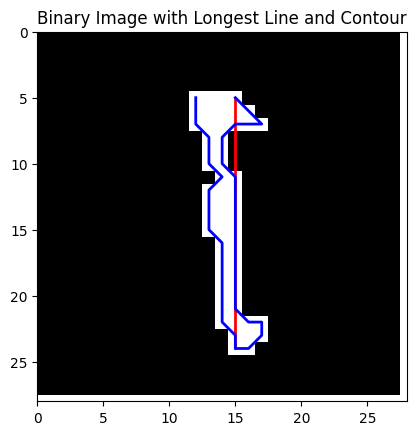

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9931


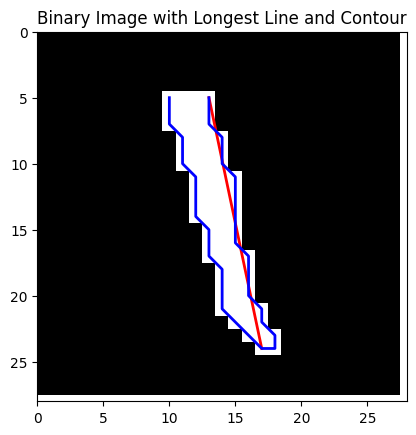

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9612


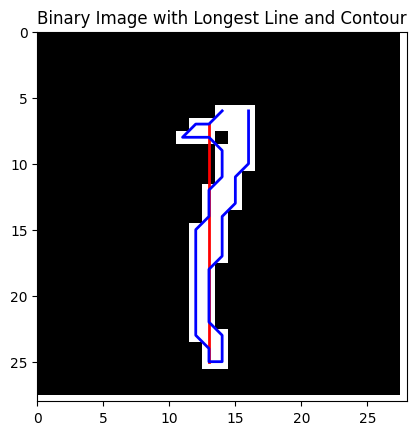

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9973


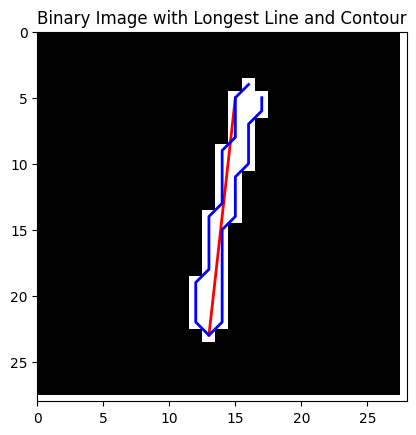

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


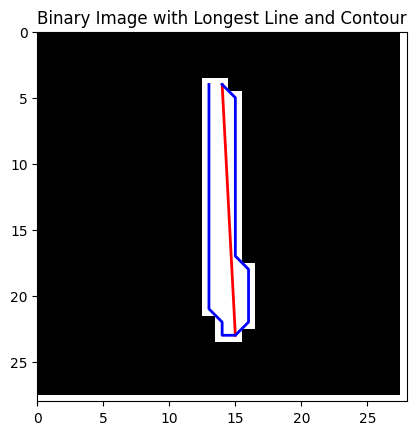

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


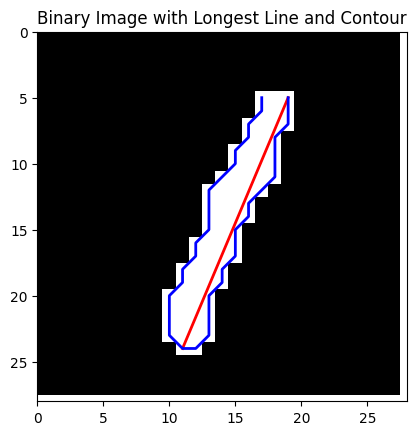

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


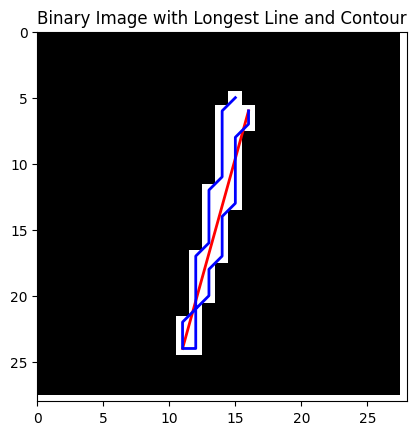

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9980


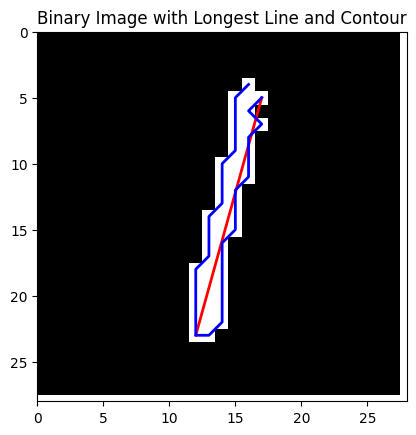

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


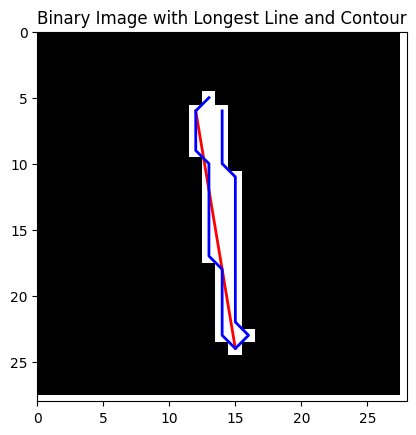

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9940


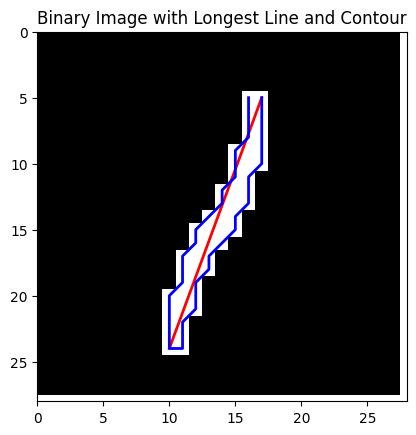

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


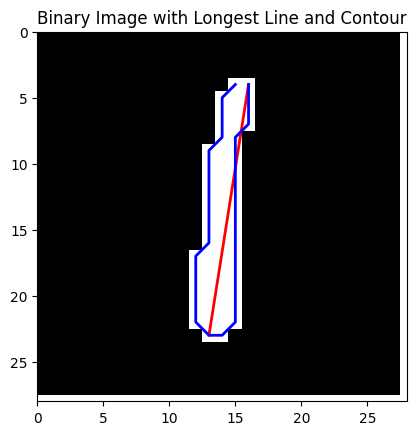

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


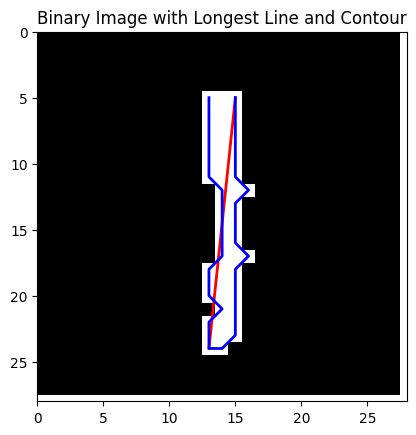

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


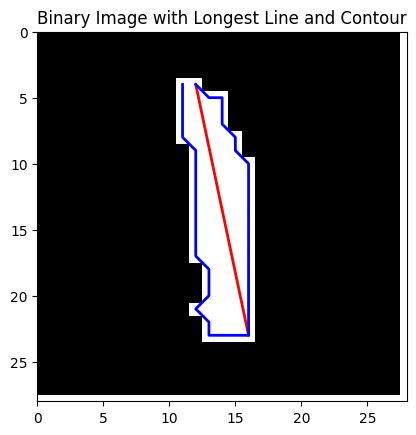

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


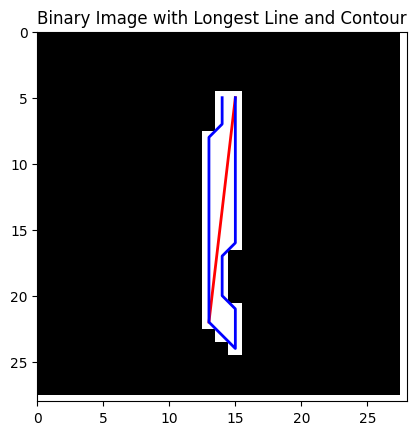

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9950


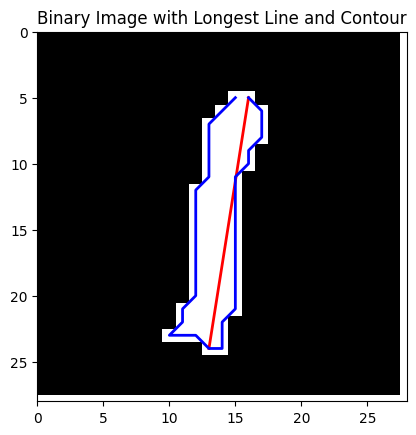

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9924


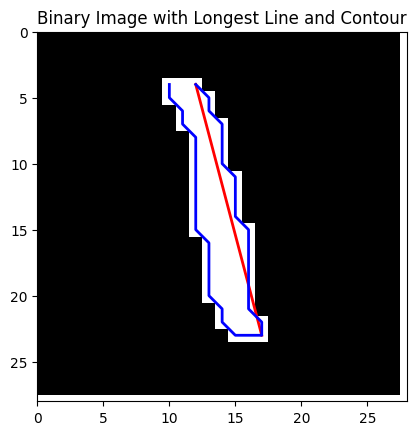

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9947


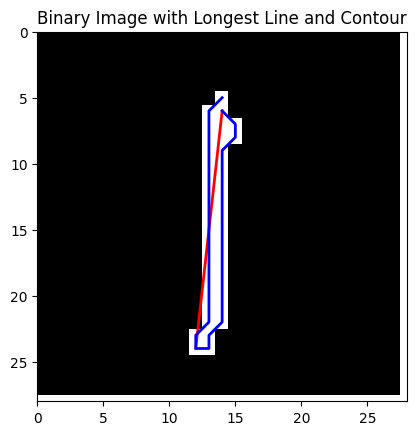

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


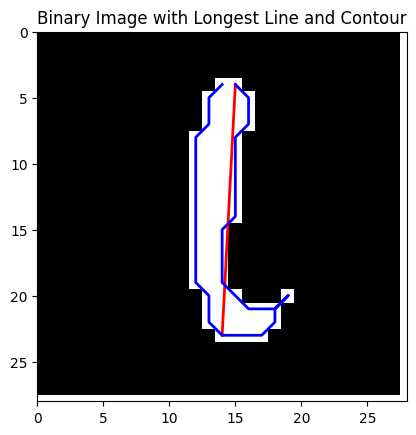

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9965


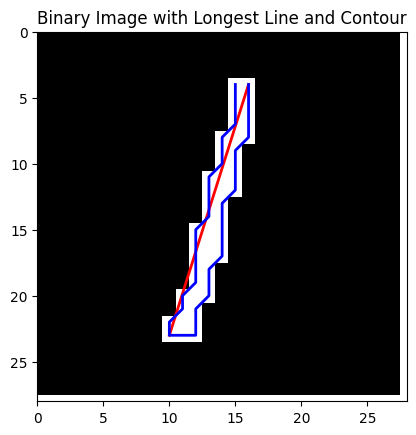

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.996     40     0.062       False             5.166   
1       0.999     41     0.082       False             5.201   
2       1.000     42     0.089       False             5.069   
3       0.986     40     0.079       False             5.098   
4       0.993     40     0.068       False             4.938   
..        ...    ...       ...         ...               ...   
95      0.995     42     0.101       False             5.165   
96      0.992     42     0.094       False             5.079   
97      0.995     39     0.052       False             5.046   
98      0.999     45     0.098       False             5.428   
99      0.997     41     0.062       False             5.139   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               8.811 -0.368  19.474      24     25               20.248   
1               7.950 -0.316  19.579      29     35               19.925   
2  

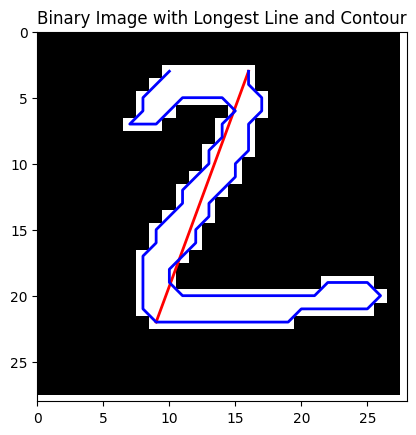

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


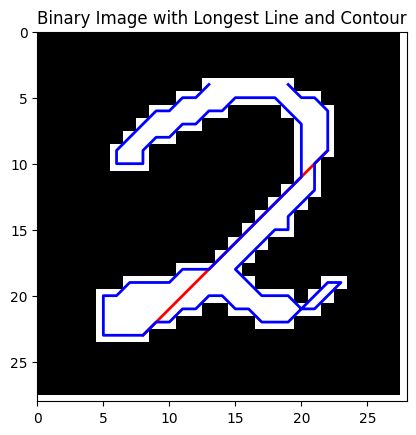

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9880


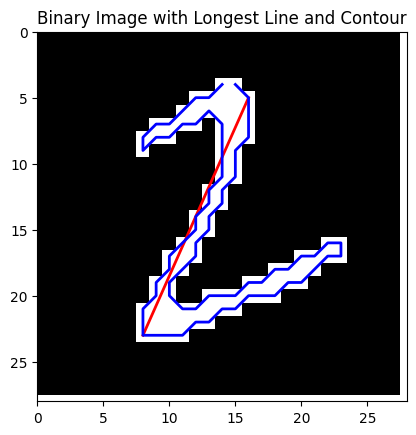

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9973


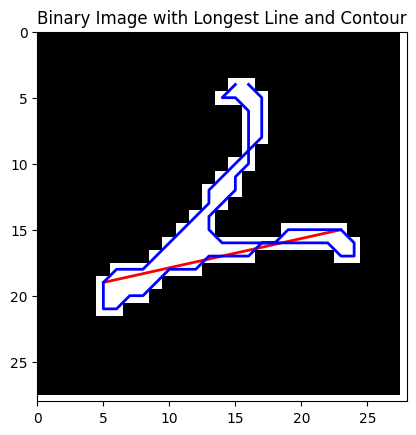

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9879


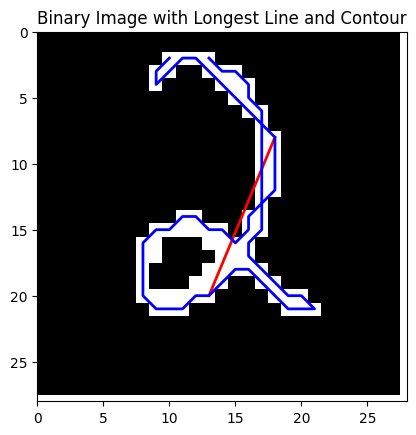

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


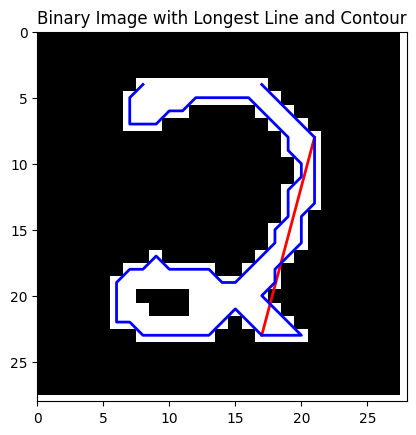

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


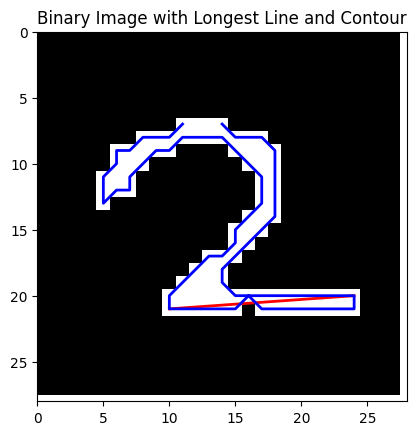

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


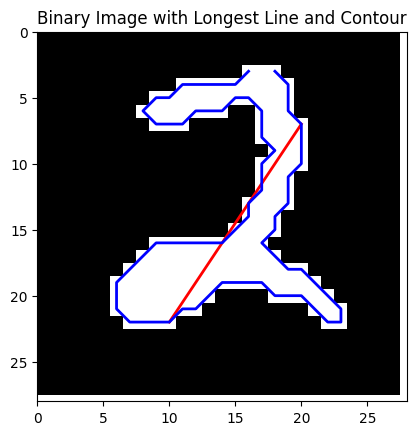

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


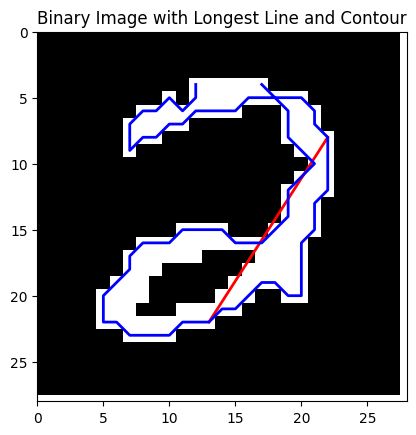

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9952


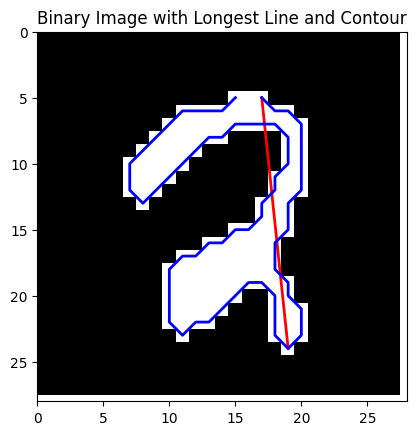

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


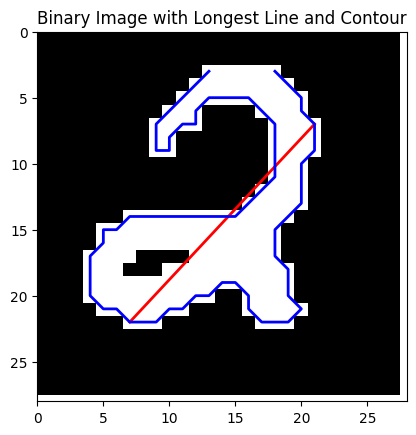

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


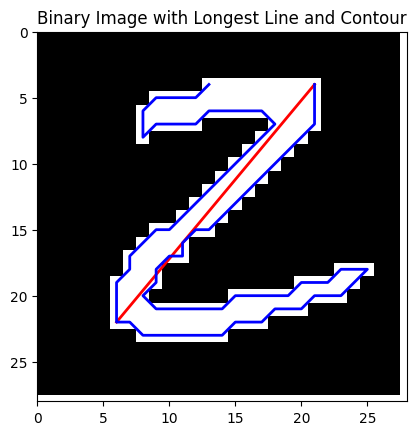

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


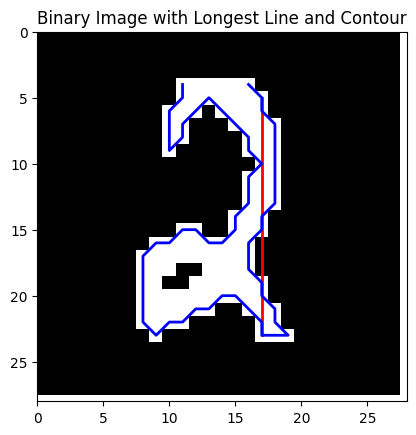

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


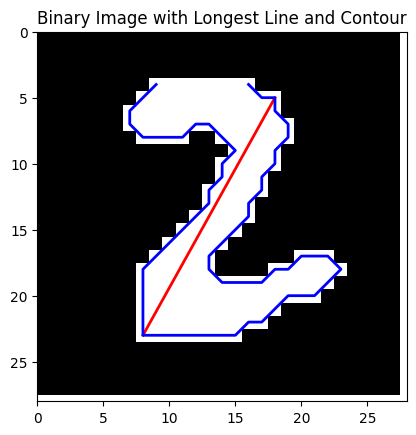

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


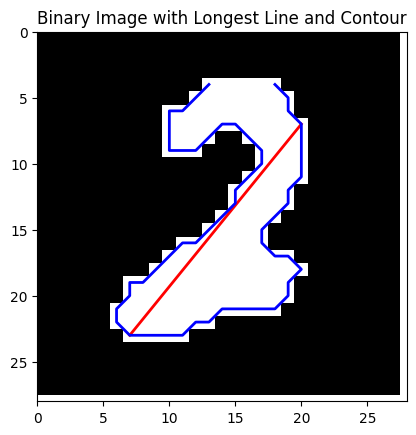

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


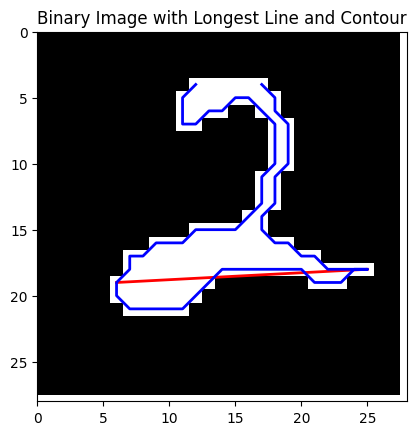

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9956


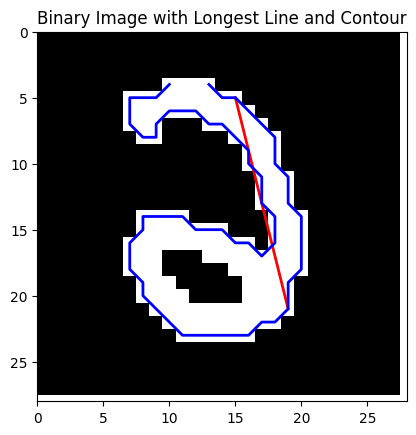

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


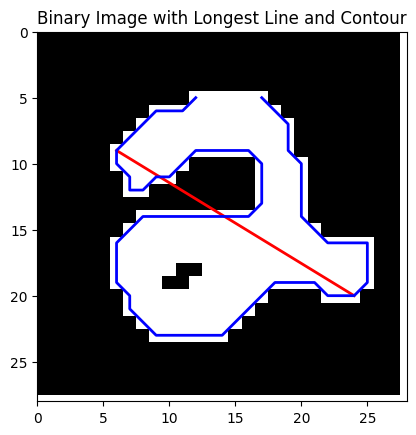

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9694


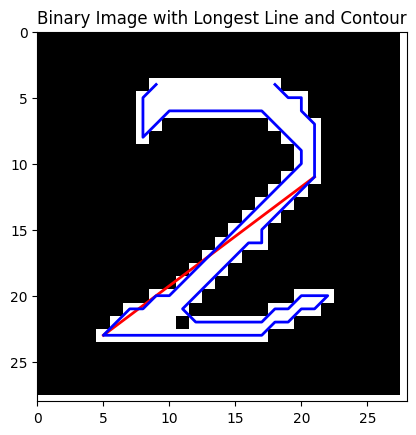

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


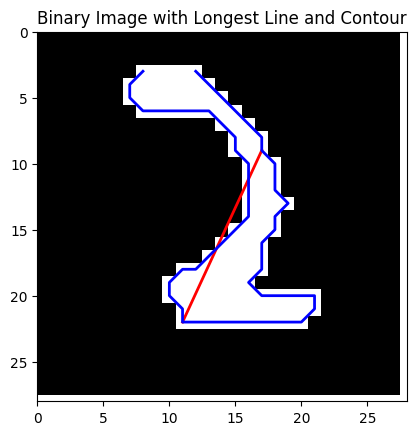

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9973


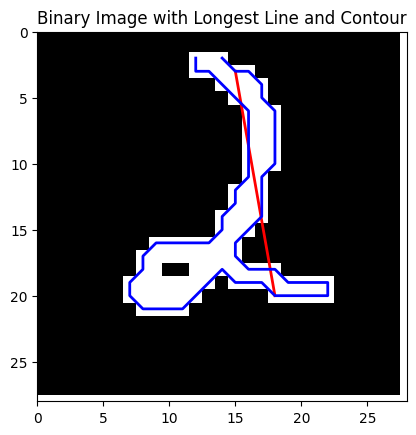

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9730


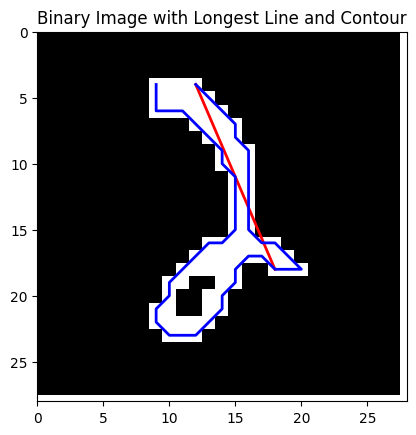

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9971


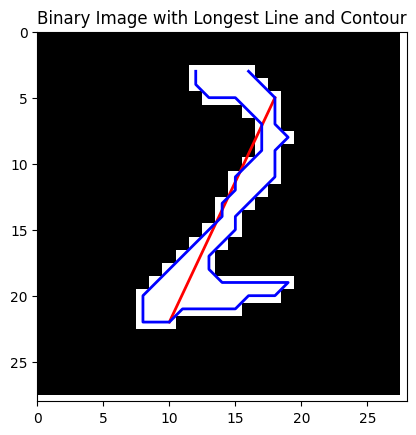

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9962


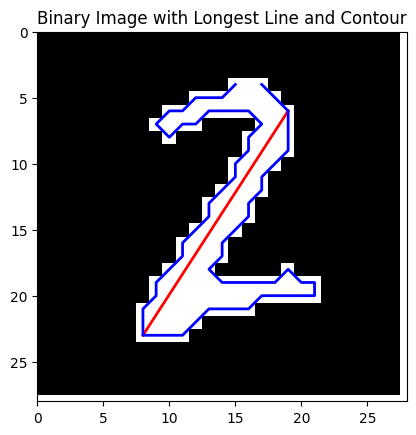

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


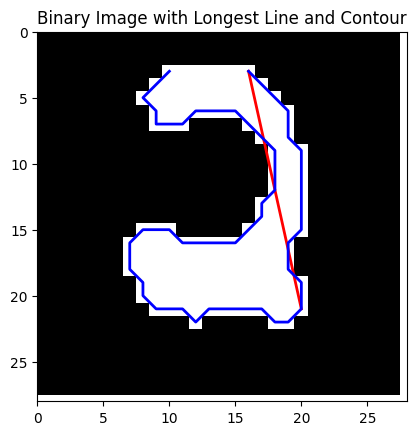

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


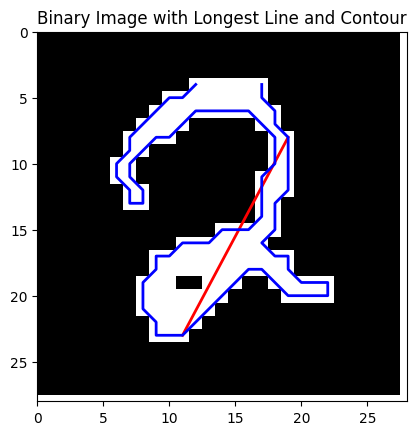

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


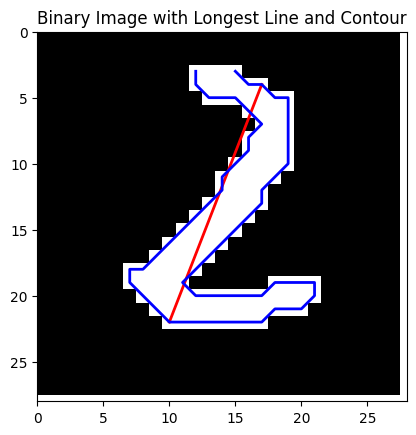

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


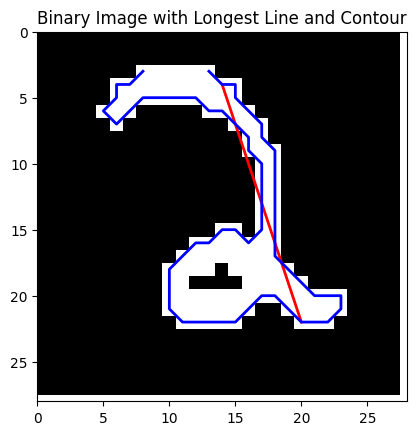

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9938


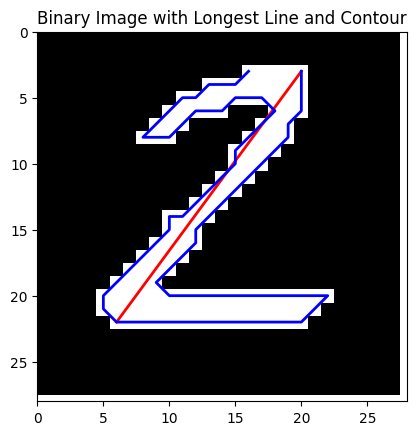

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


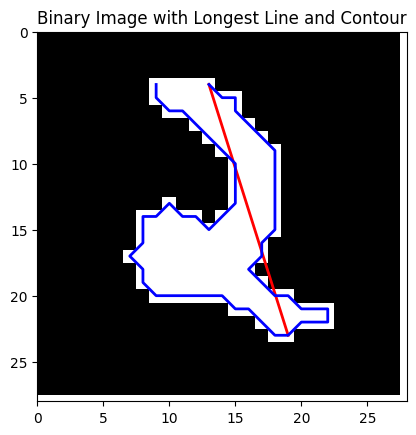

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


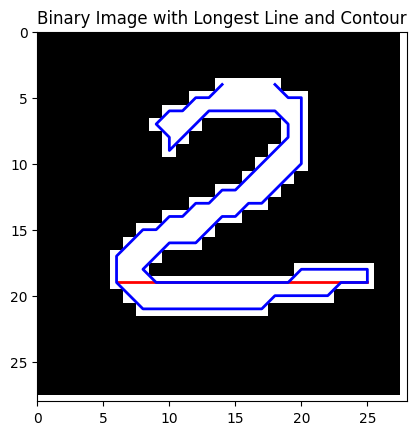

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3407666934.py:54: RuntimeWarning: divide by zero encountered in int_scalars
  k=1/(y1-y0)*(x1-x0)
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9391


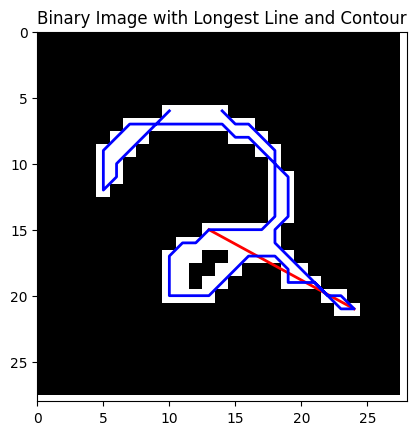

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


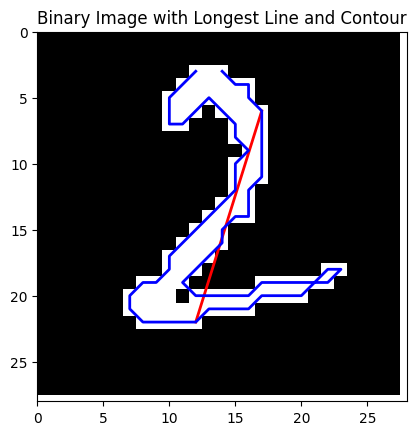

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9878


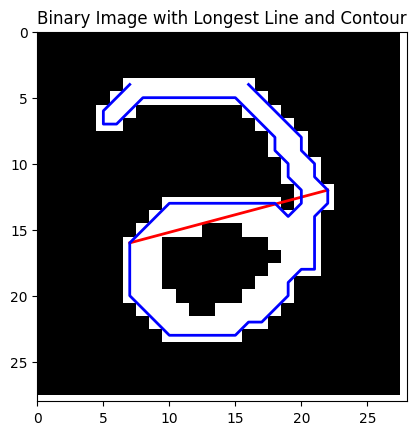

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9705


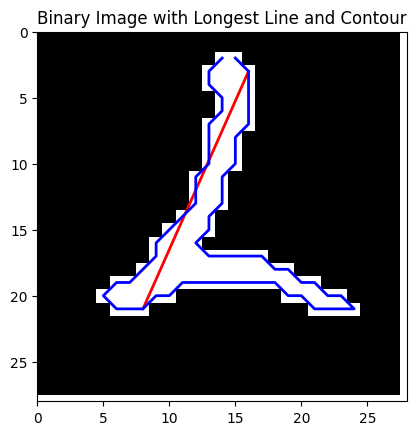

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9962


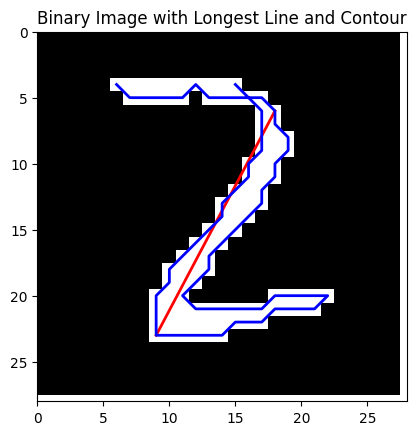

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9783


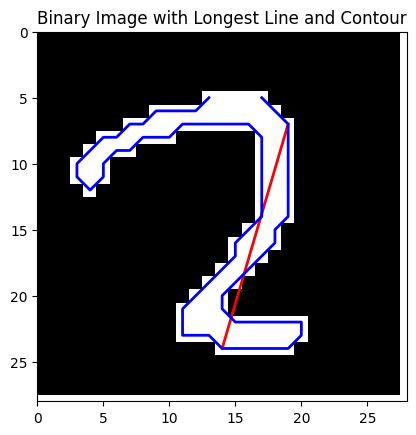

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9945


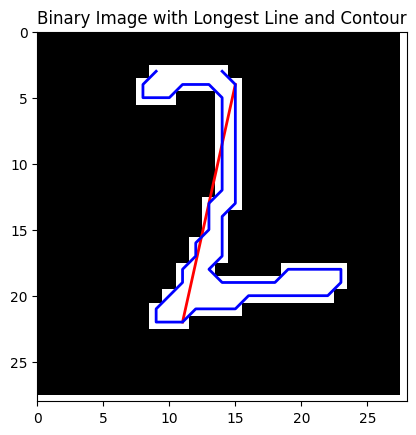

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9981


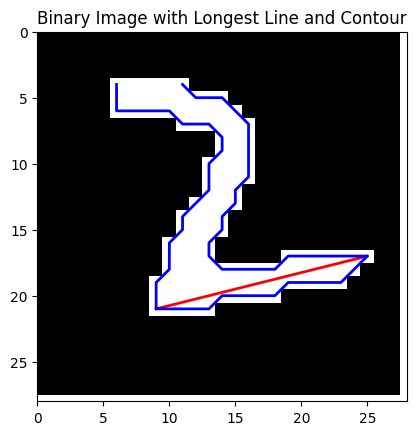

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9826


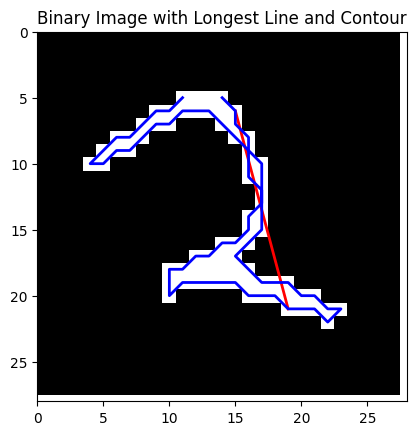

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


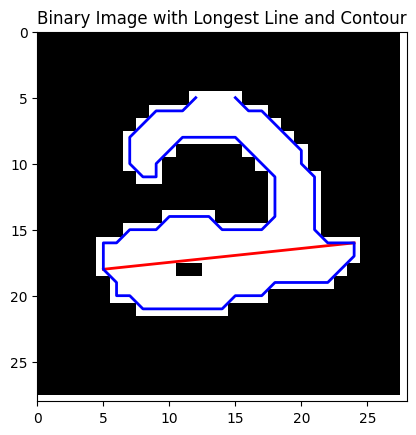

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


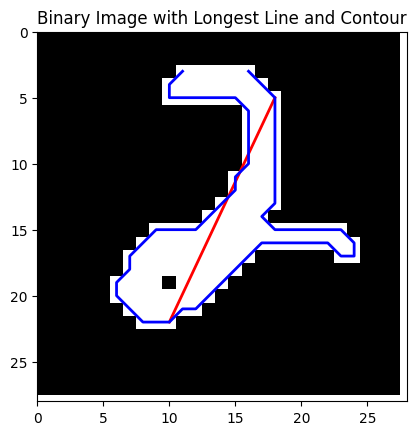

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9959


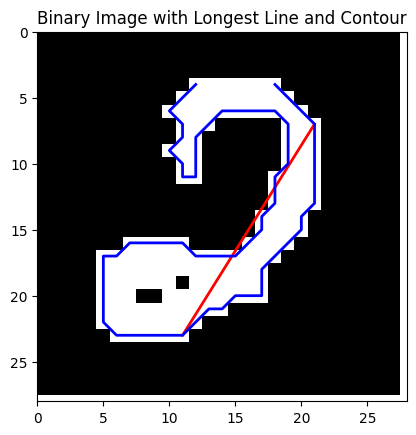

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9753


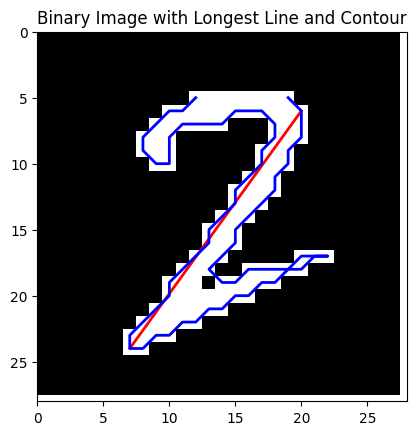

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


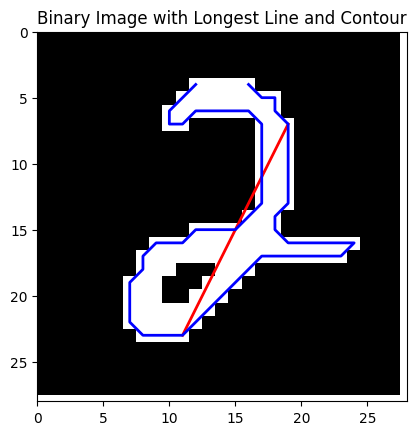

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9930


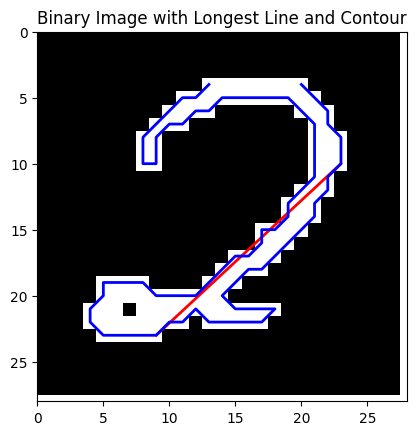

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


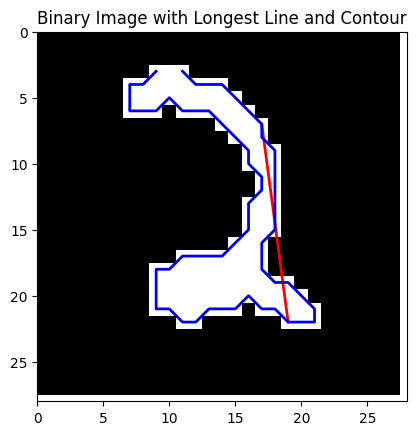

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9001


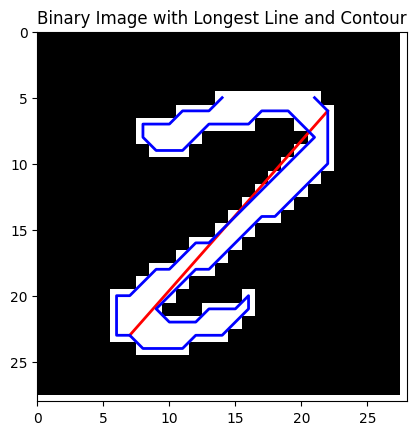

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9869


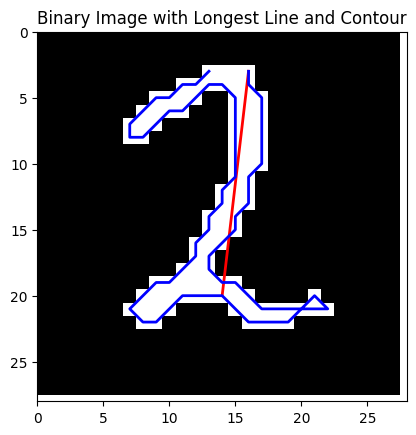

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


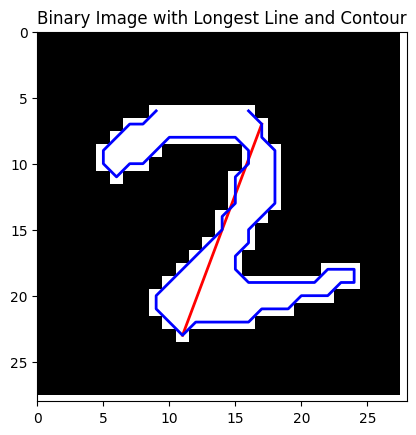

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


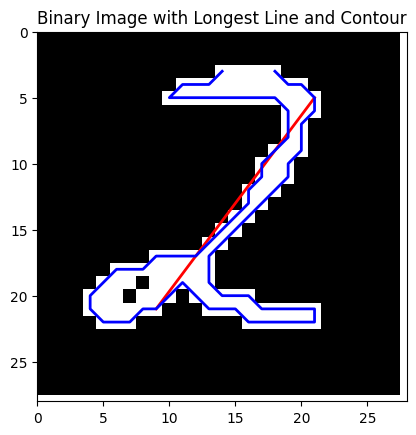

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


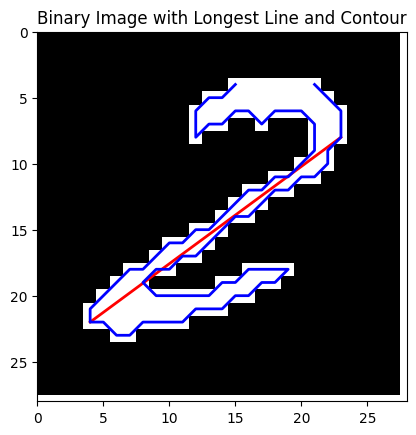

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


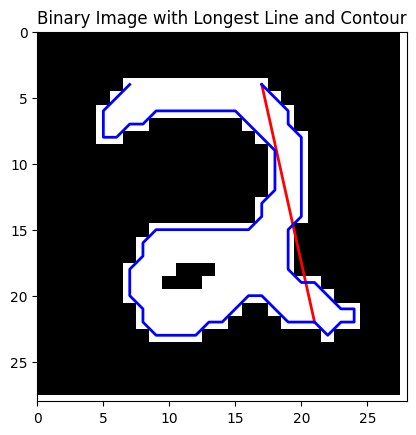

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


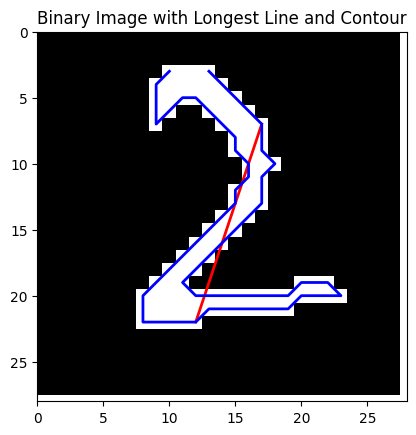

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


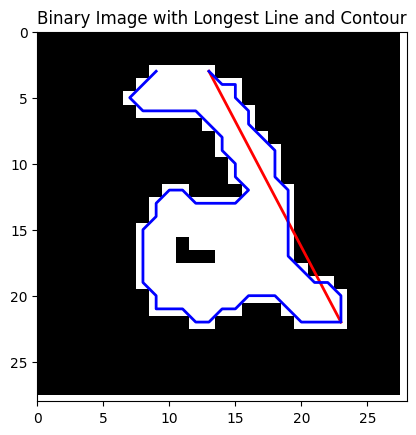

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9549


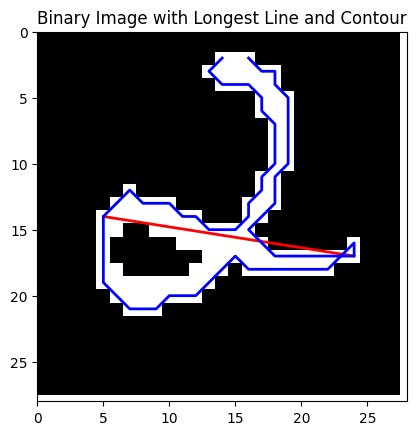

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9521


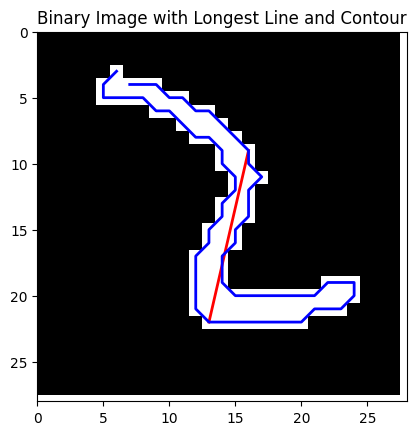

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


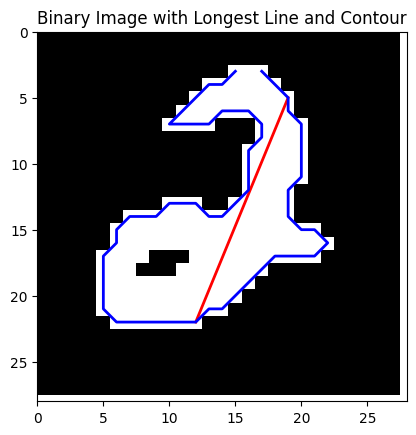

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9620


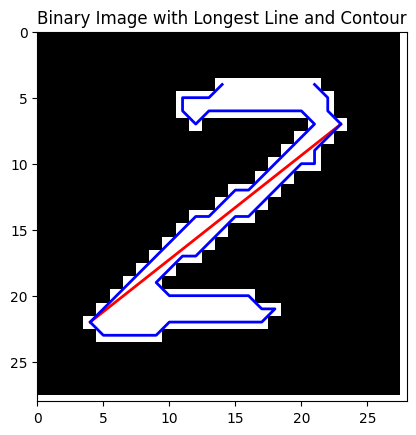

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


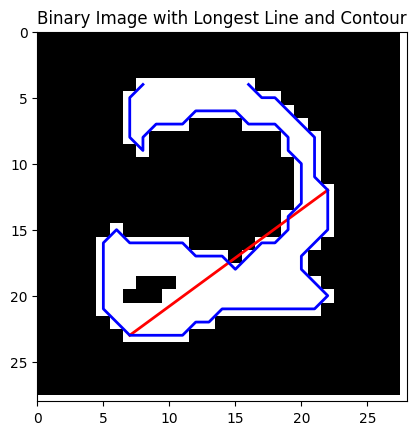

Prediction probability for digit 9: 0.9945


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


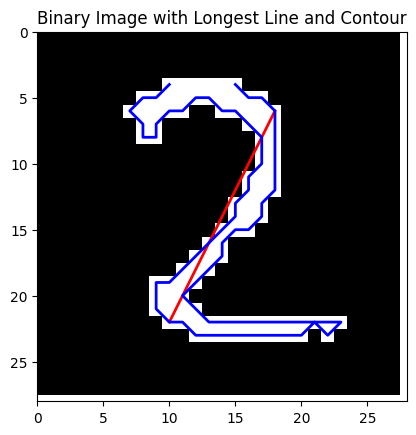

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


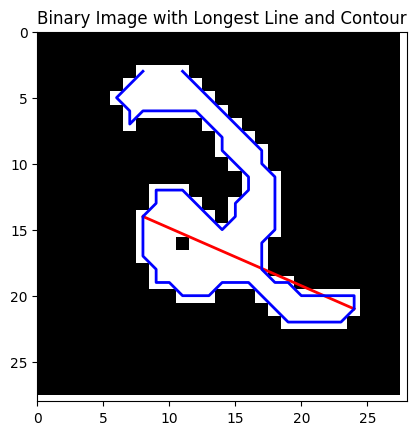

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9853


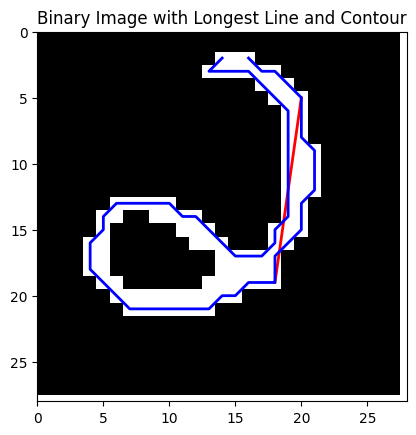

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


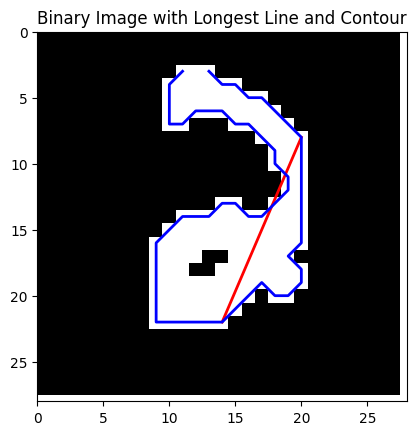

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


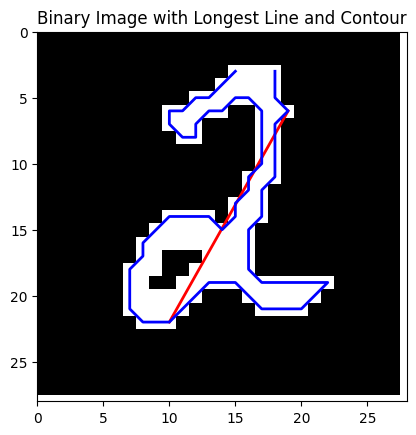

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9892


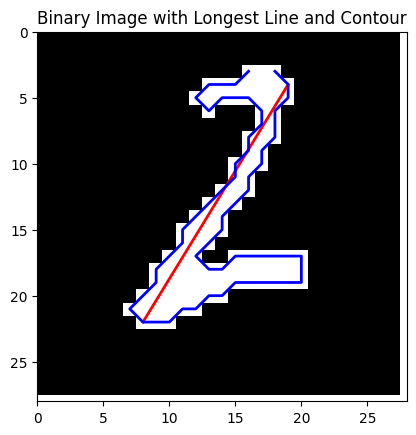

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


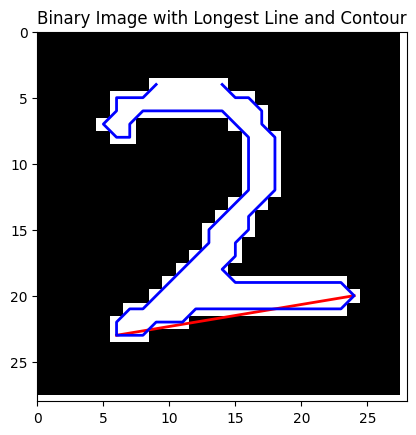

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9718


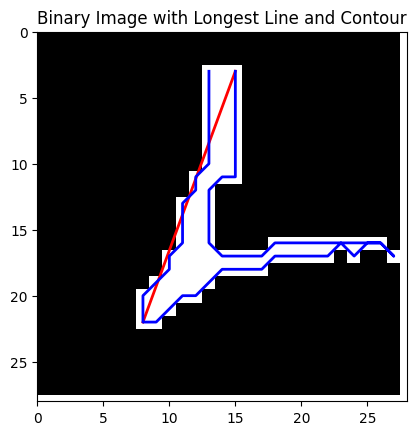

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


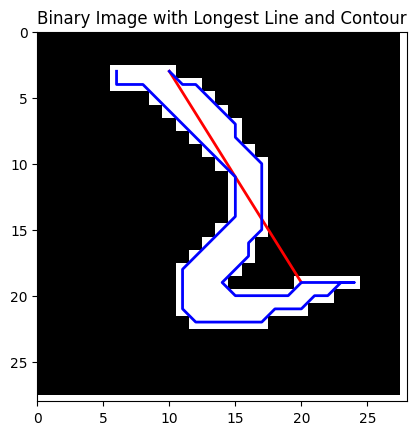

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


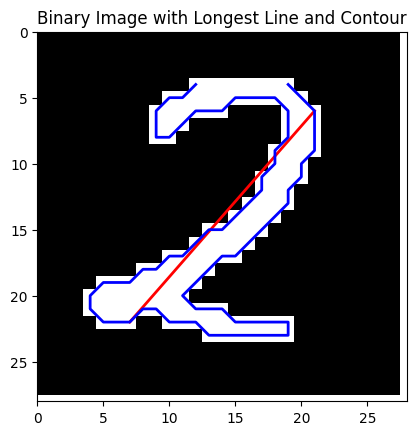

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


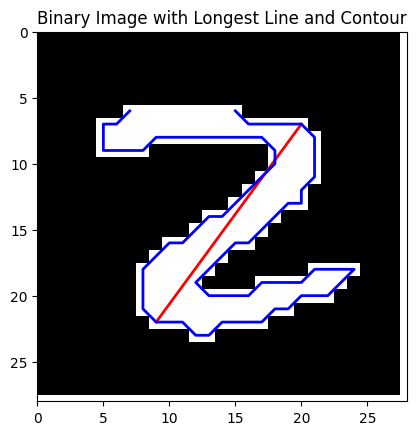

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9900


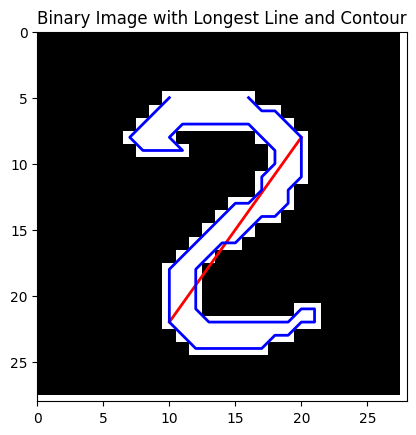

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


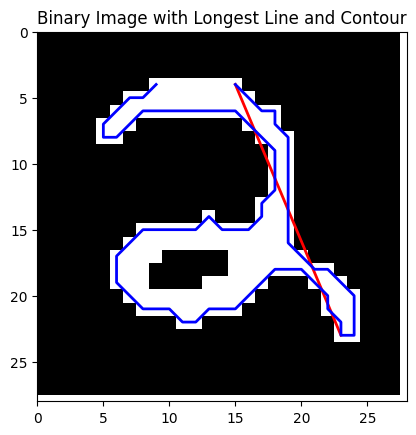

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9856


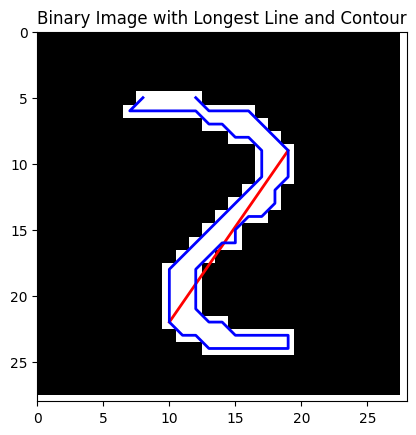

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


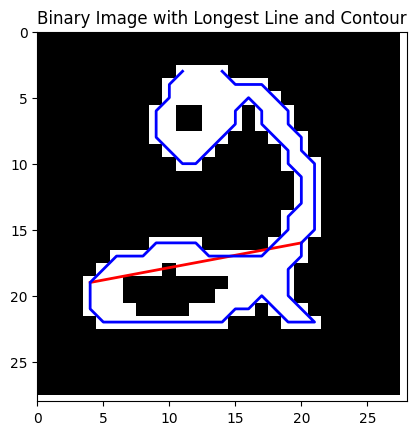

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9929


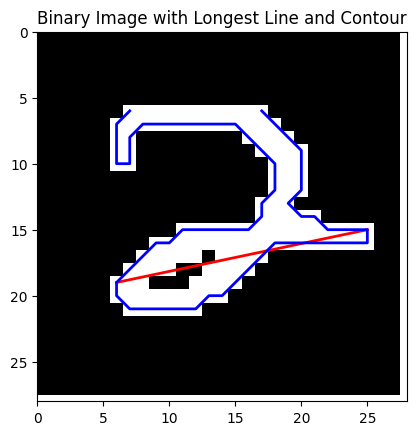

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


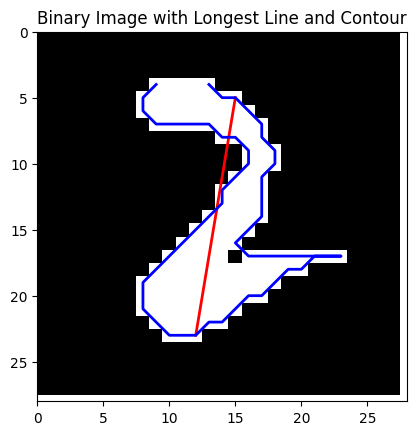

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


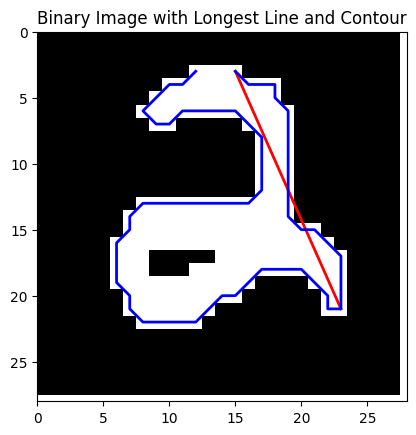

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


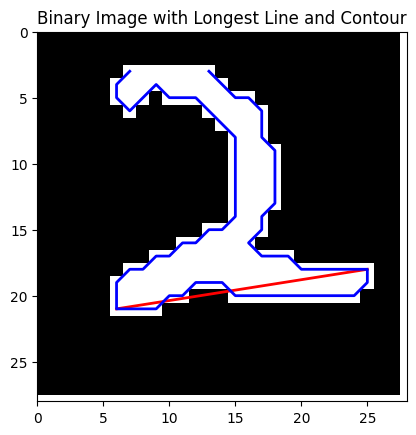

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


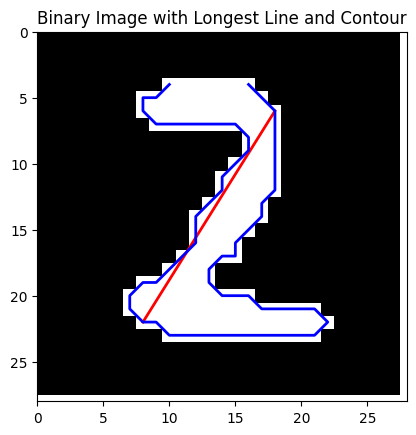

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


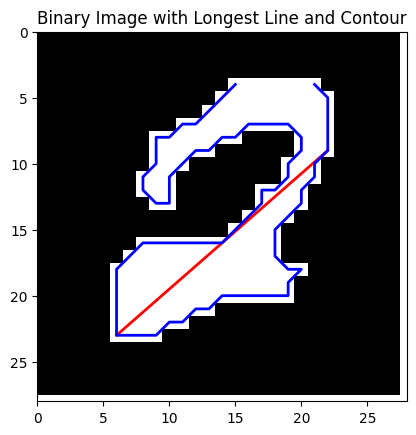

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9846


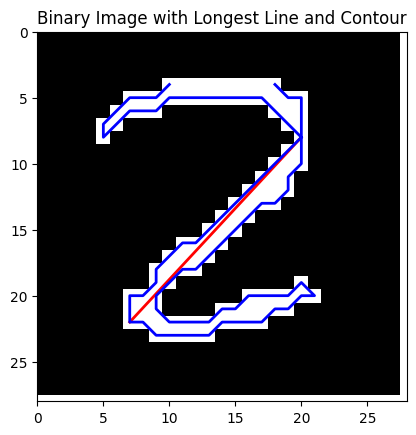

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9540


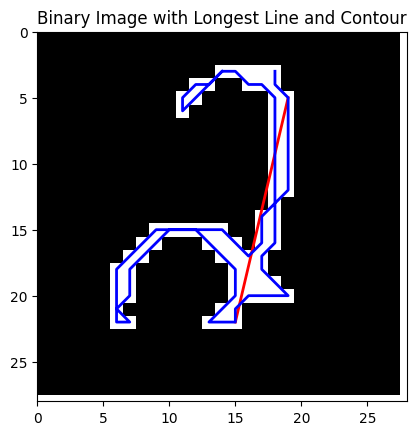

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9908


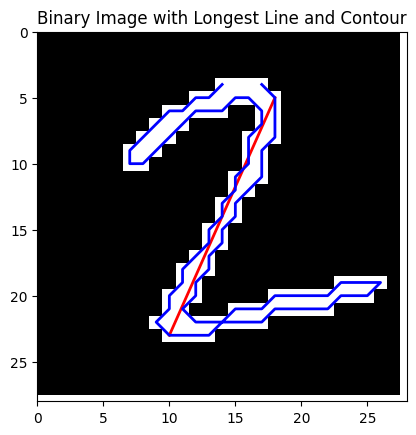

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


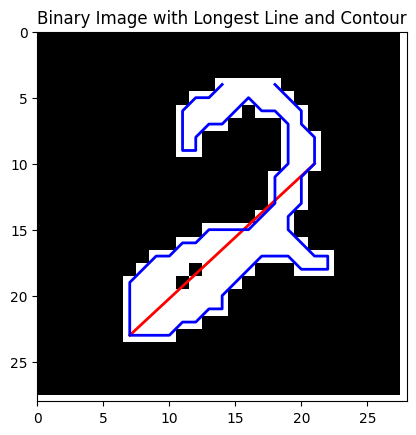

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


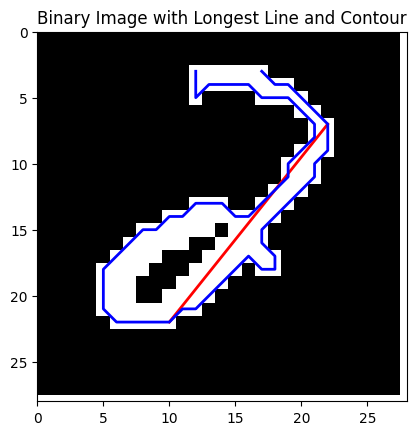

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


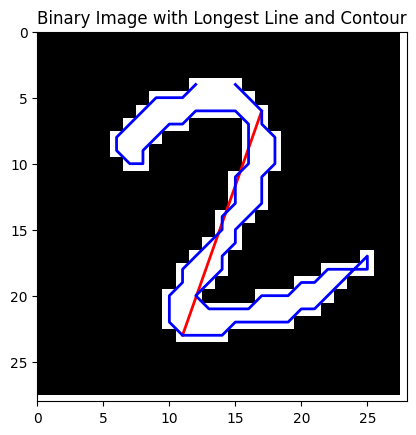

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


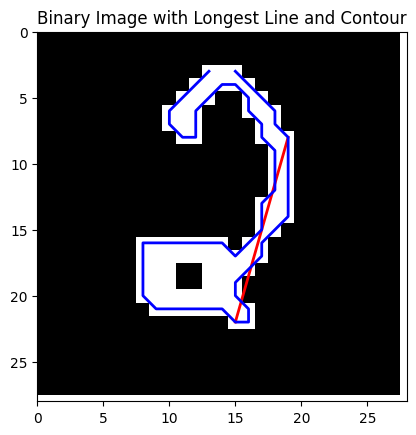

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


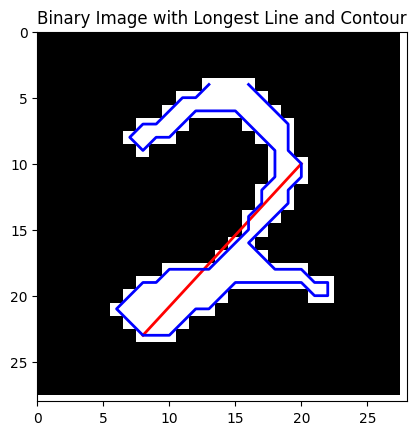

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9931


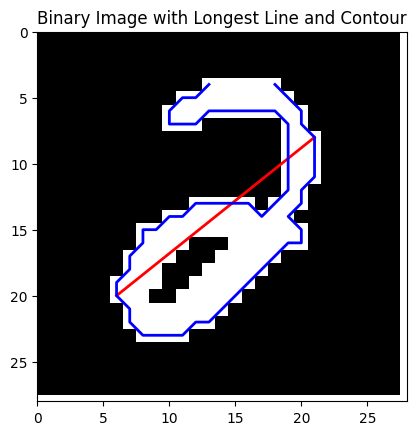

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


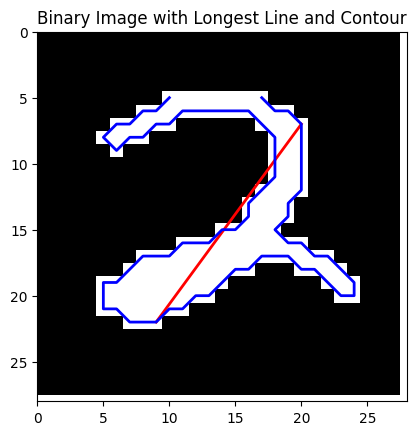

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


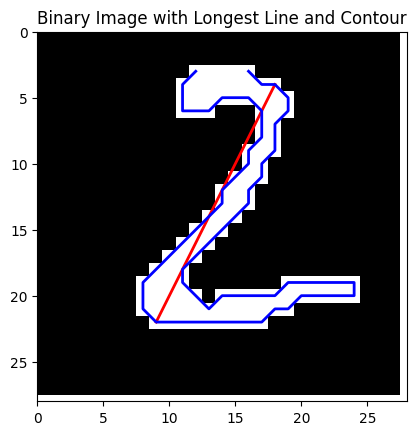

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


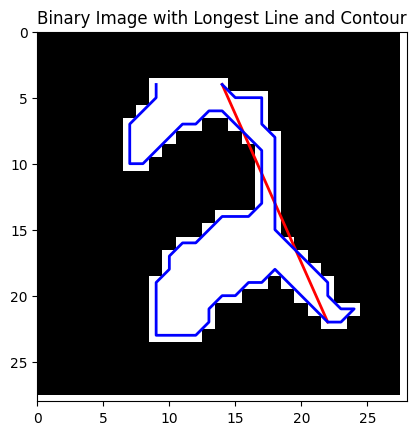

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


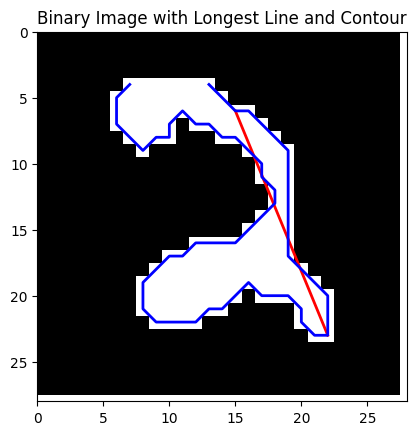

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


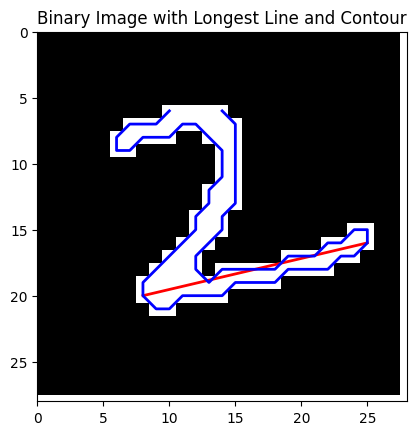

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


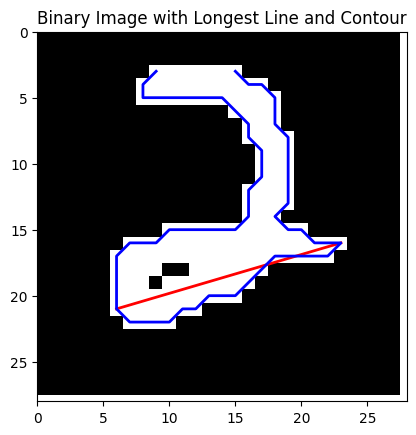

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9949


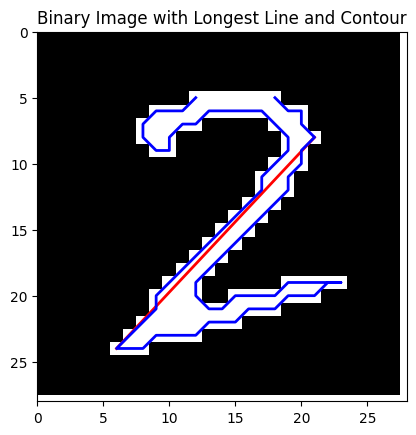

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9792


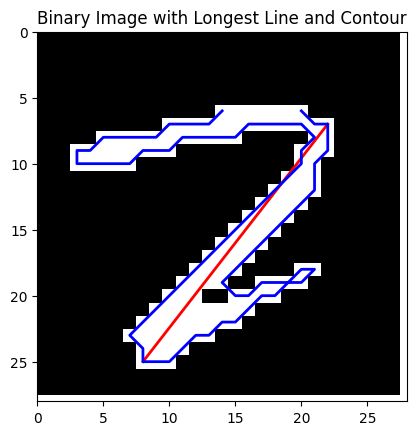

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9921


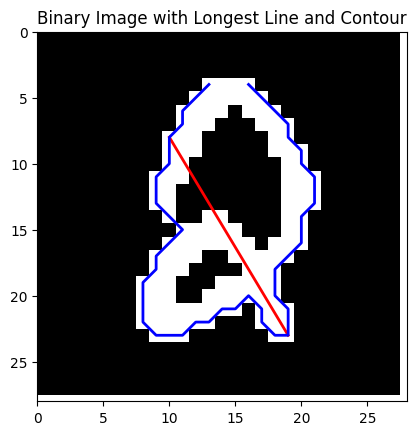

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9934


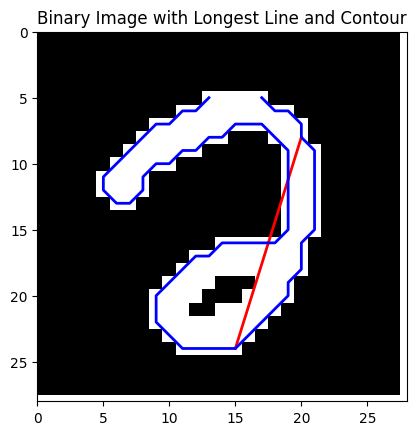

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.997     83     0.168       False             7.566   
1       0.998     92     0.175       False             7.946   
2       0.988     75     0.116       False             6.737   
3       0.997     60     0.096       False             5.984   
4       0.988     74     0.101       False             6.475   
..        ...    ...       ...         ...               ...   
95      1.000     79     0.185       False             6.767   
96      0.995     82     0.140       False             7.162   
97      0.979     90     0.165       False             7.356   
98      0.992     91     0.170       False             6.432   
99      0.993     84     0.189       False             7.057   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               8.195 -0.368  17.105      77     55               20.248   
1               5.613 -1.000  31.000      60     77               19.799   
2  

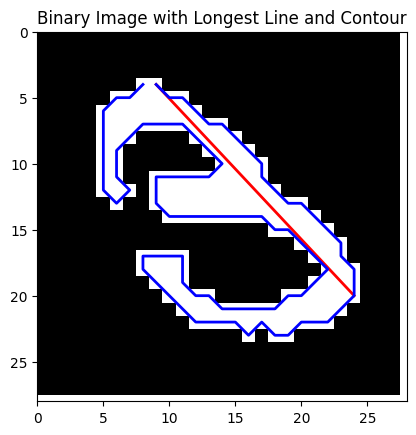

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


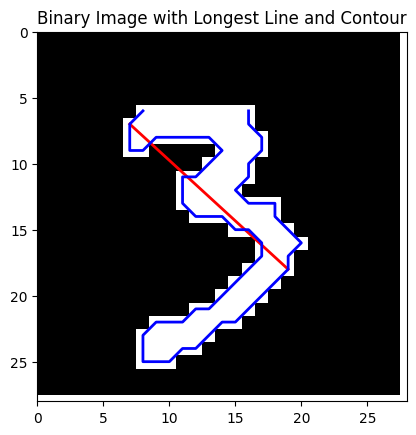

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


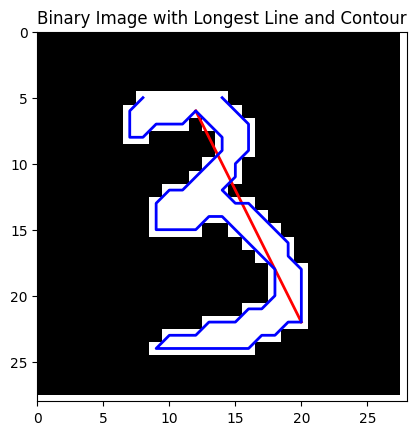

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9961


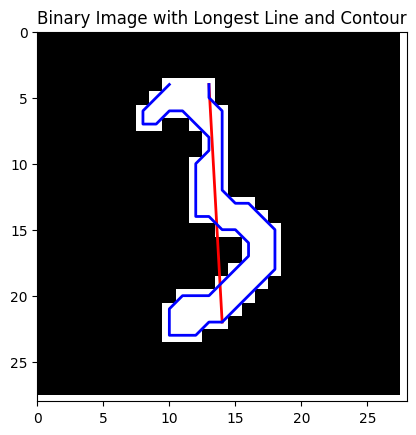

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


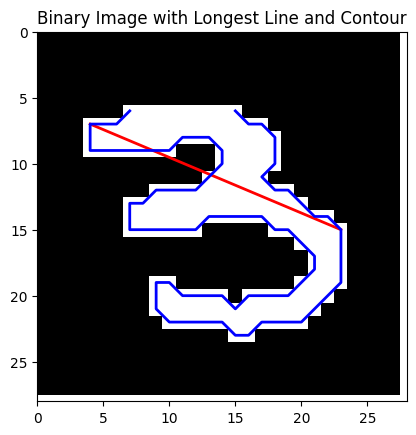

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9292


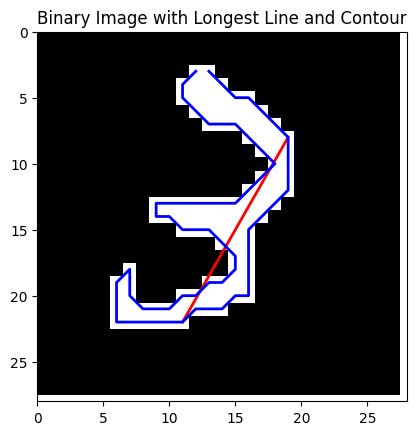

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9986


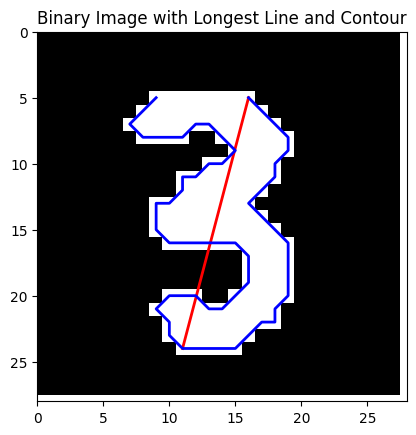

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9931


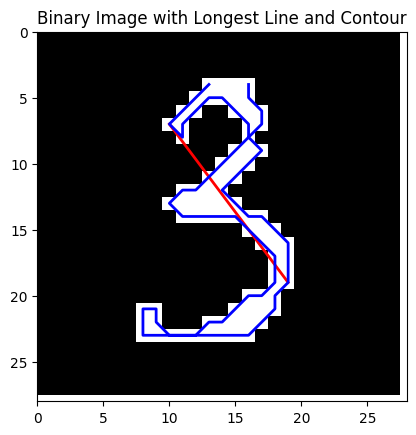

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9248


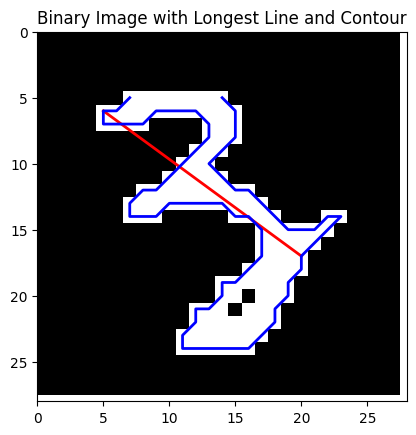

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9929


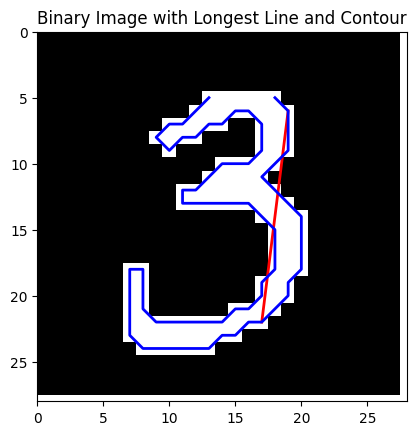

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


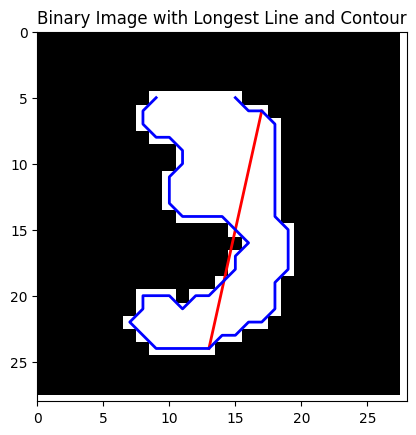

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


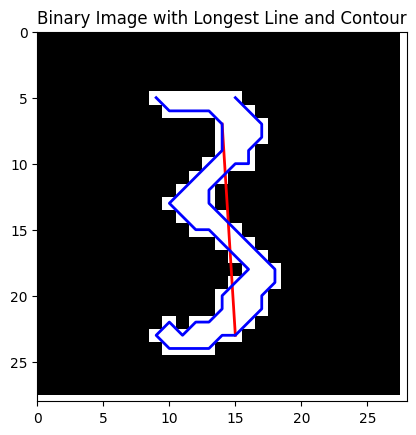

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9923


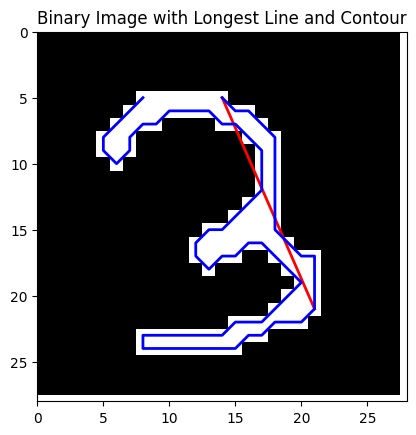

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9679


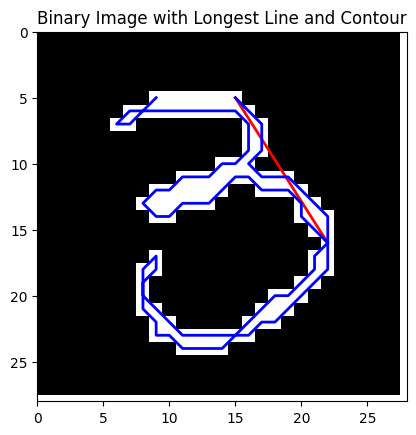

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9981


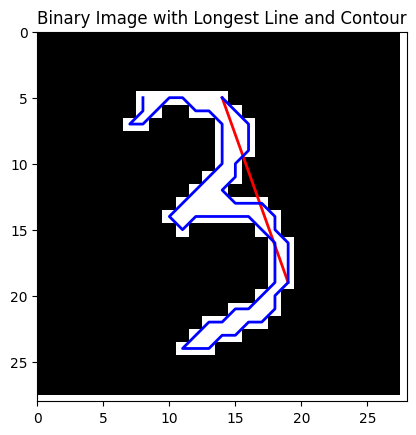

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


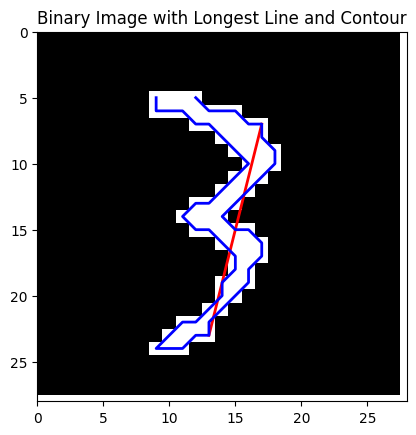

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


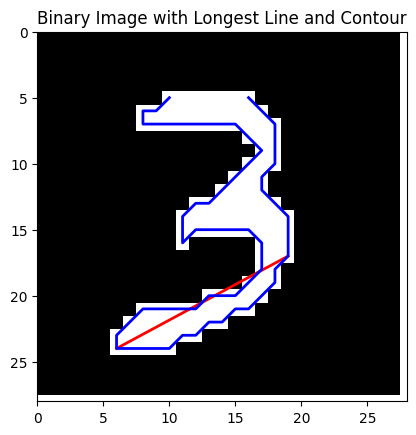

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9943


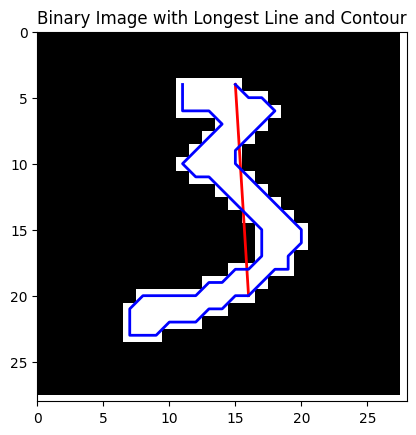

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9789


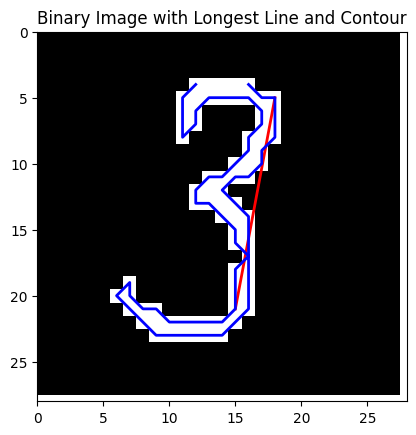

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9238


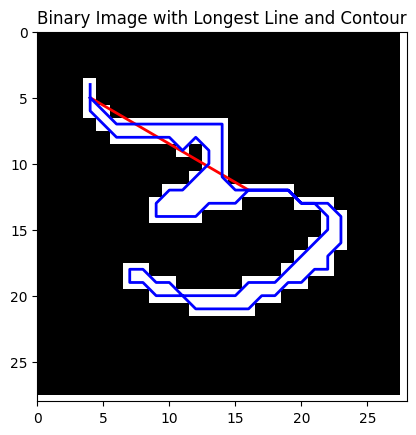

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


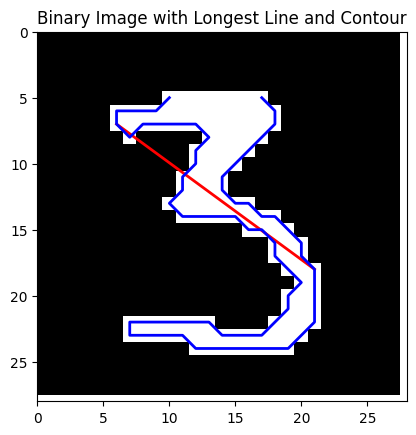

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


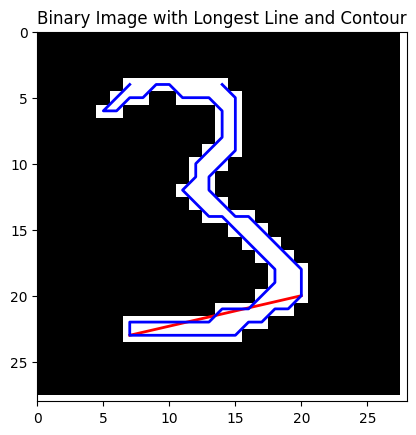

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9969


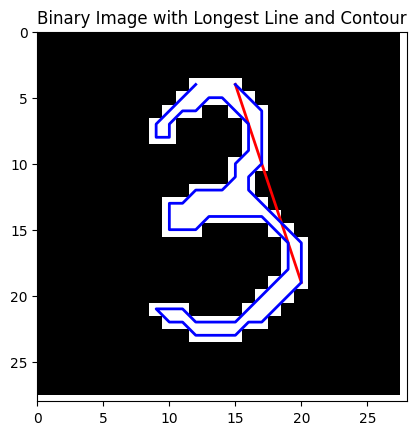

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9791


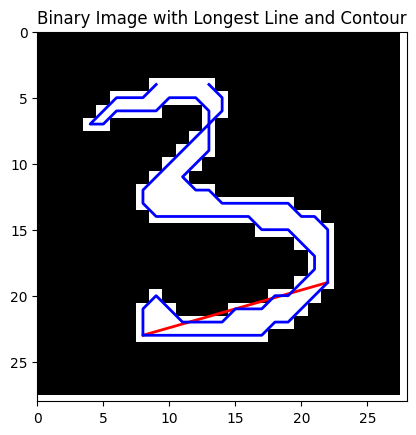

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9966


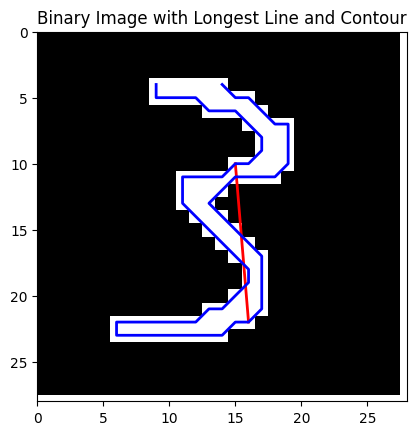

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


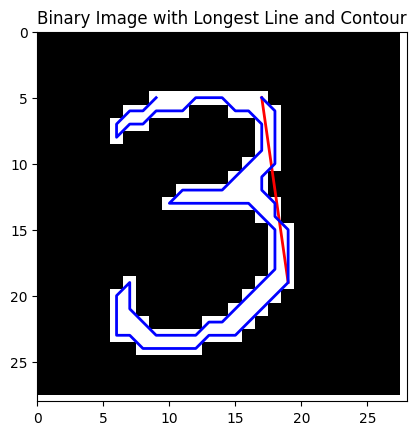

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9146


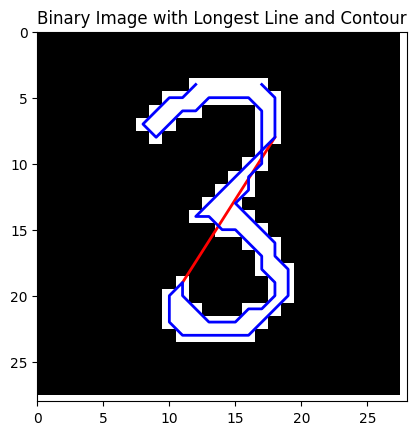

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


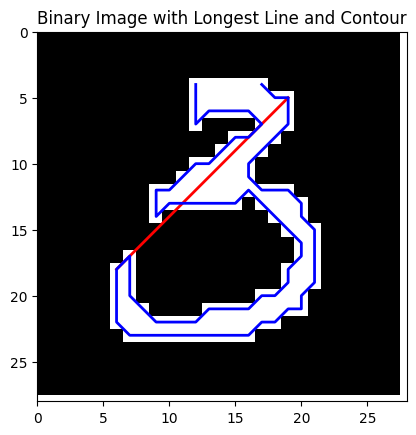

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9428


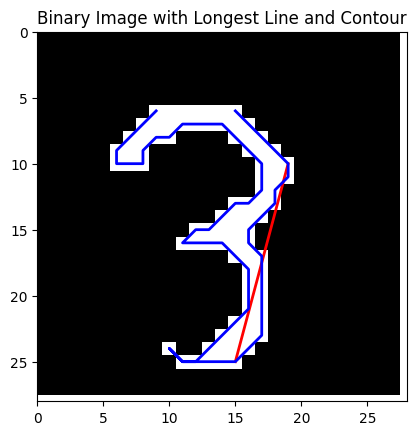

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


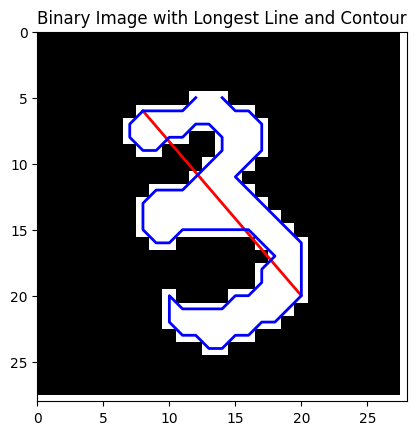

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9961


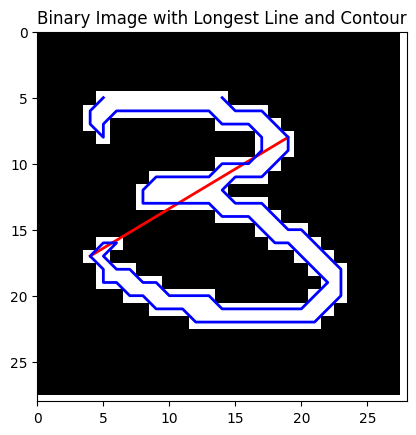

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9963


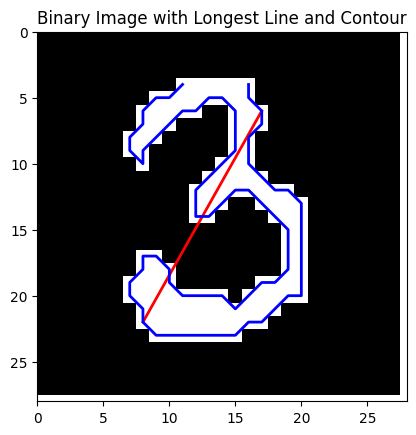

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


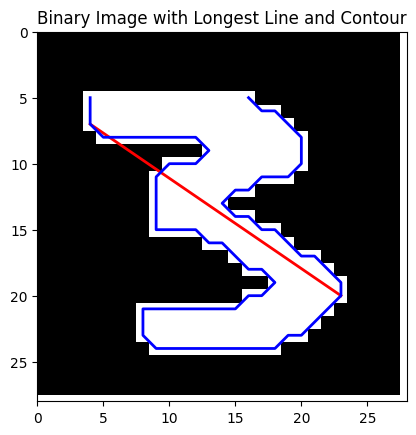

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


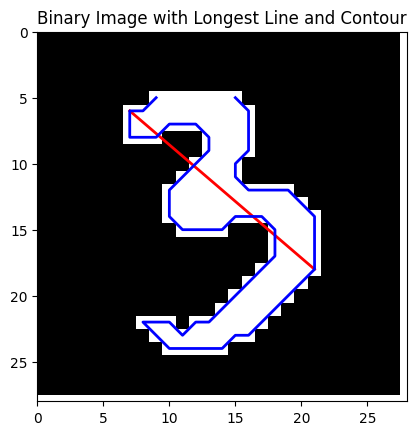

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9659


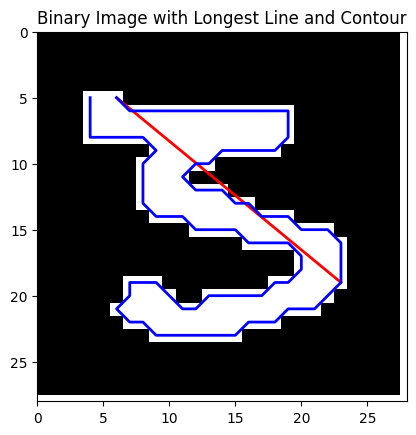

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9900


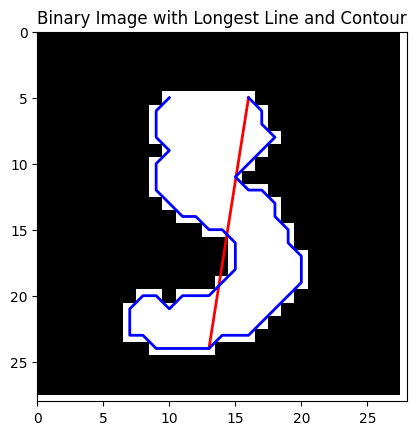

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


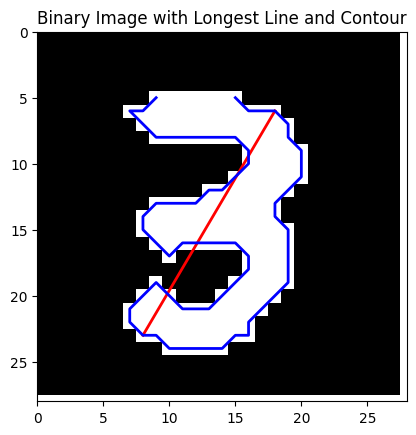

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9968


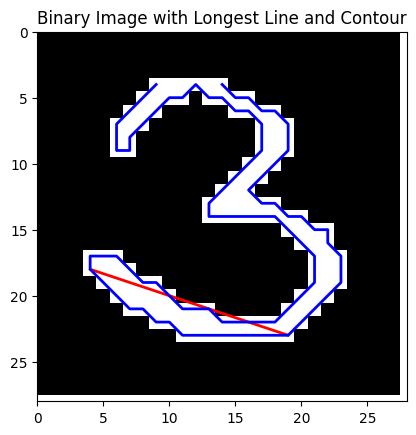

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


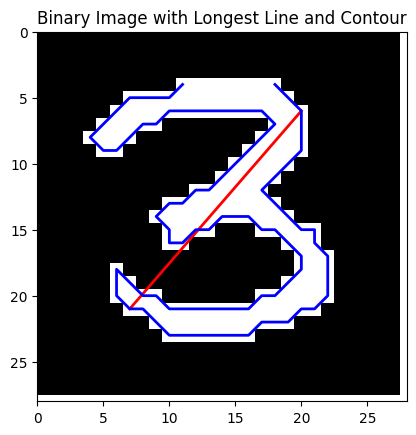

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


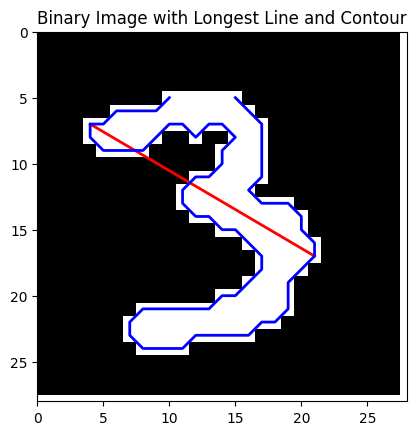

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9964


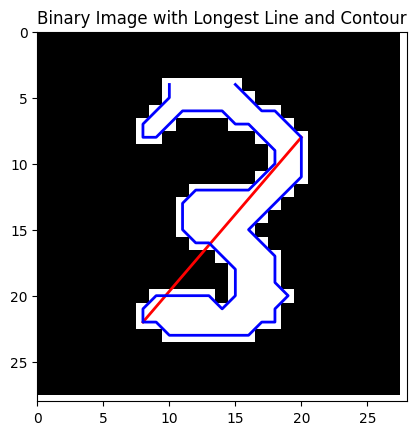

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9921


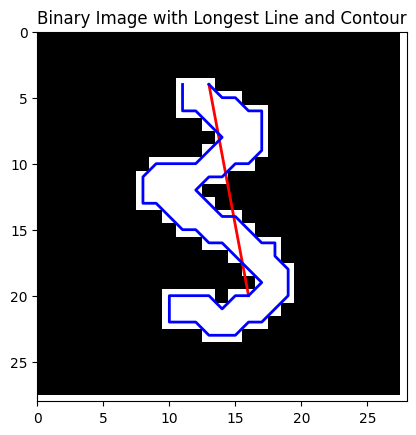

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


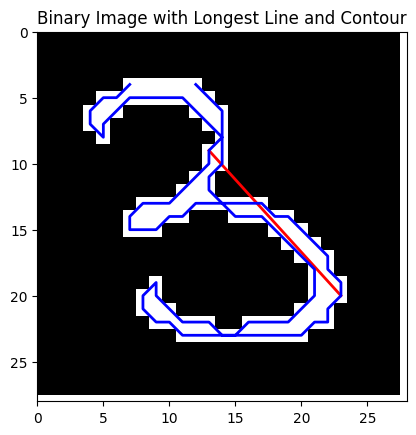

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


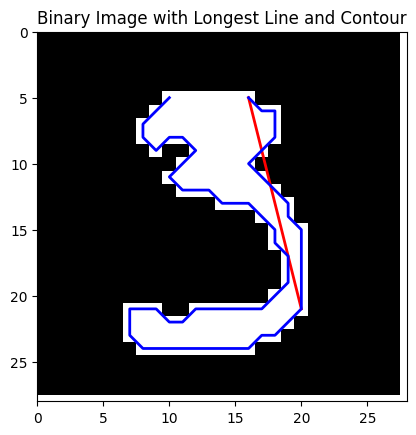

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


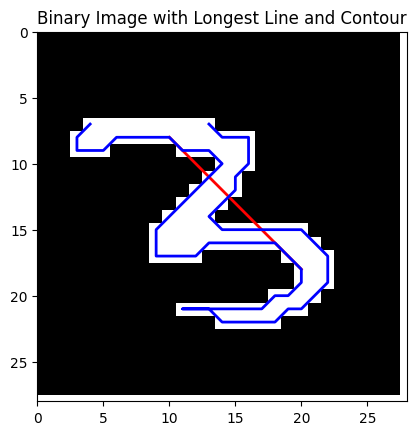

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9421


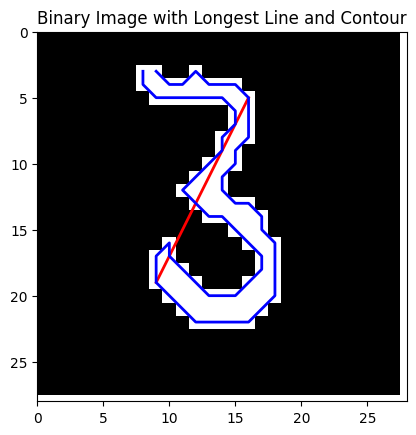

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


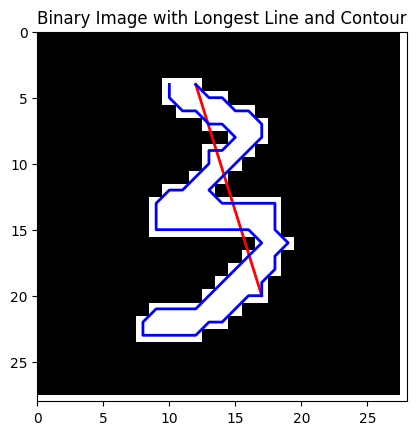

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9624


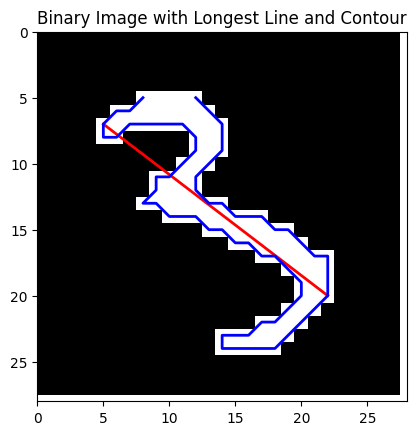

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


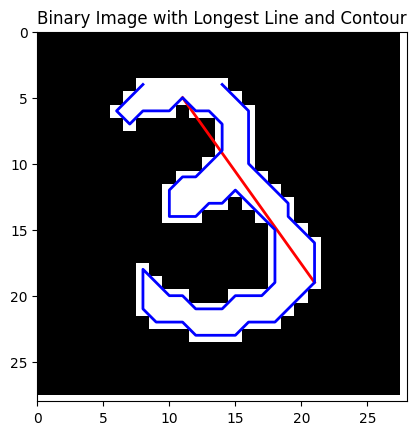

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9908


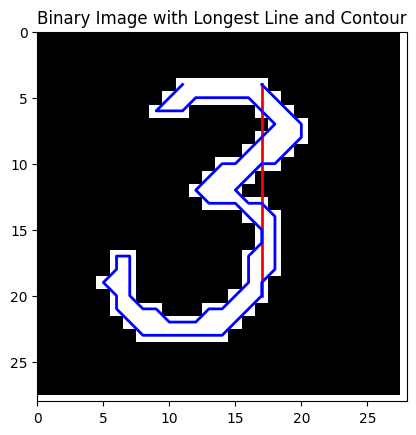

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


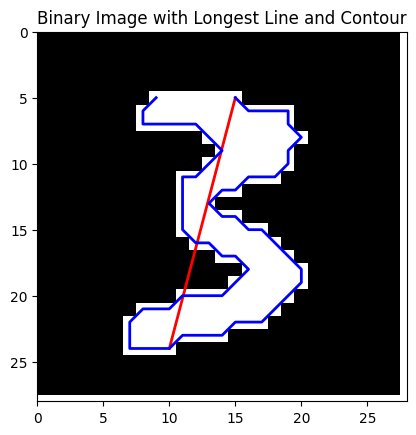

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


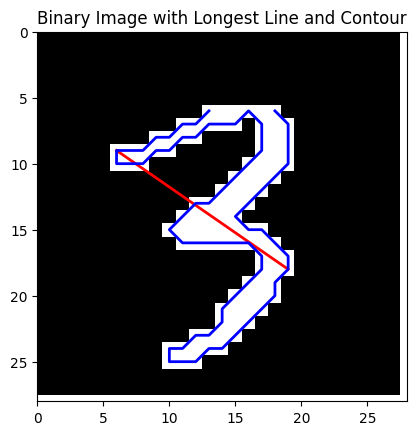

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


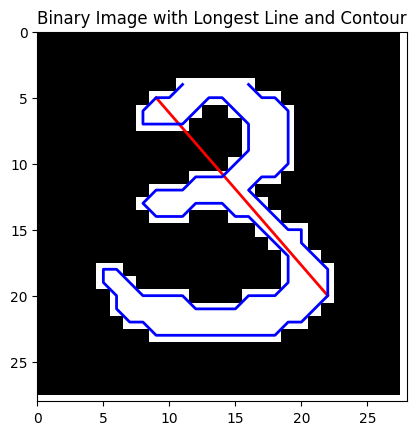

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


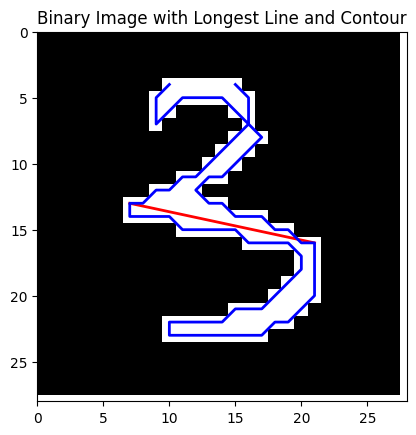

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9545


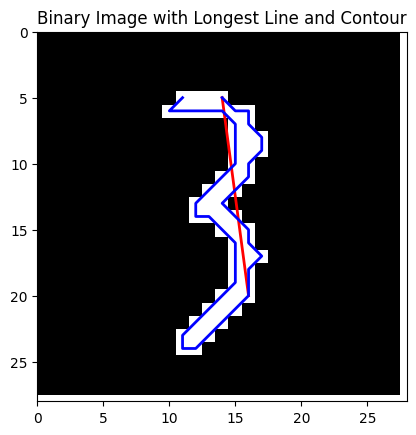

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9809


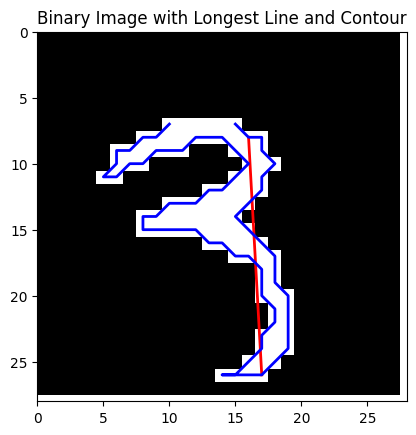

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


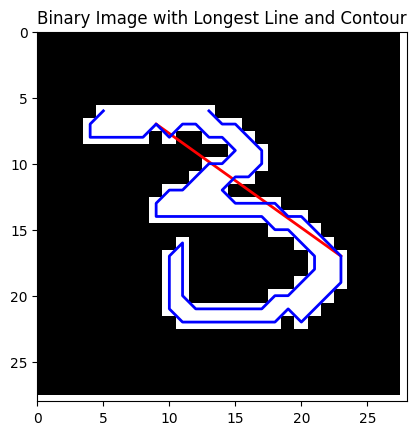

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


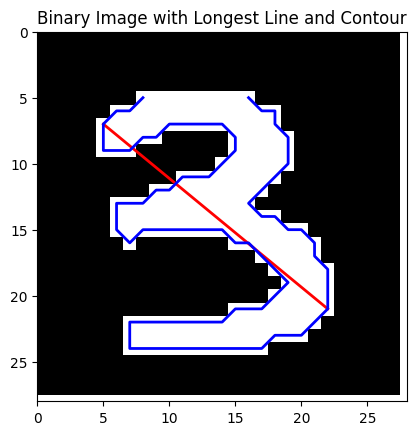

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


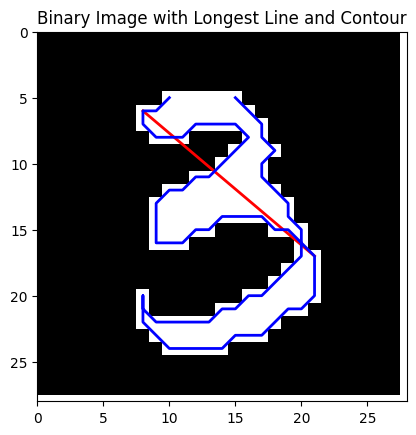

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9909


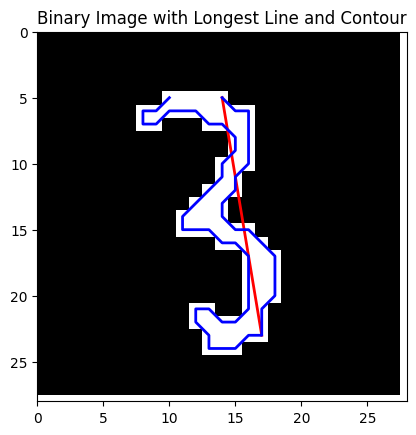

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


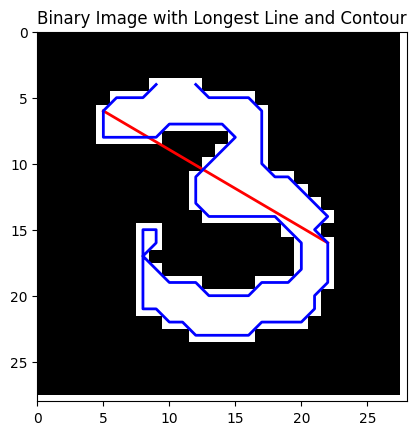

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9696


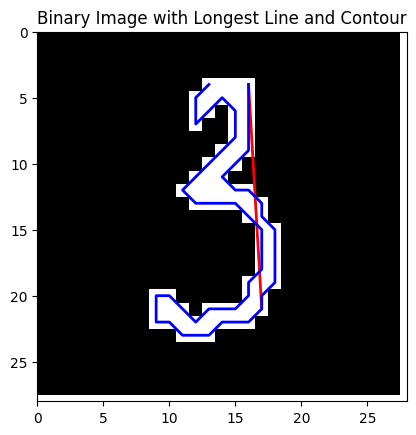

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


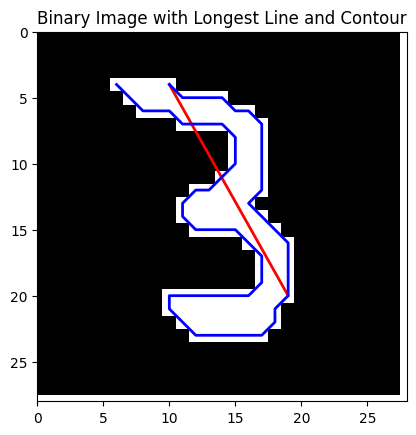

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9951


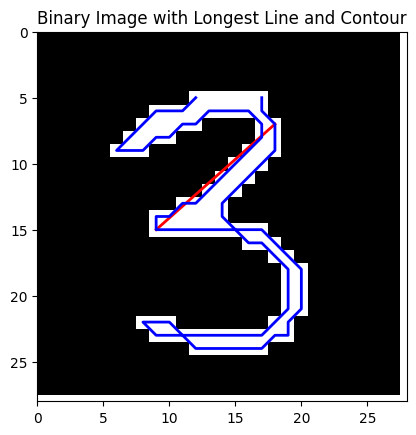

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9873


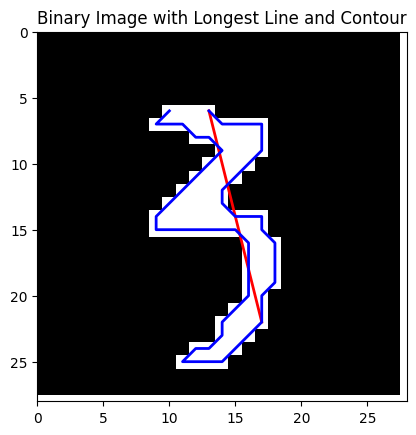

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9804


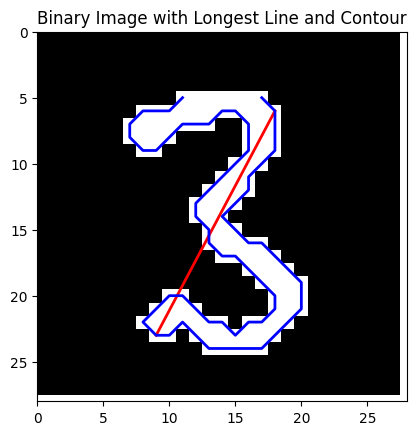

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


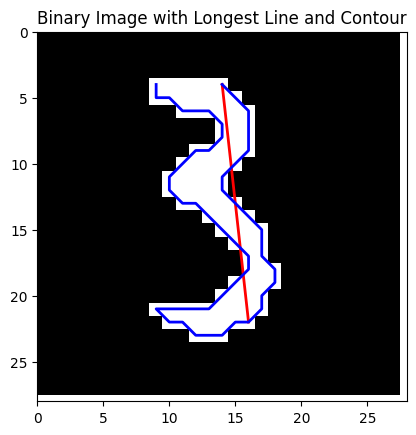

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


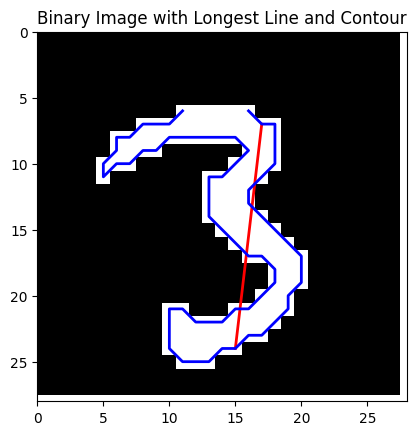

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


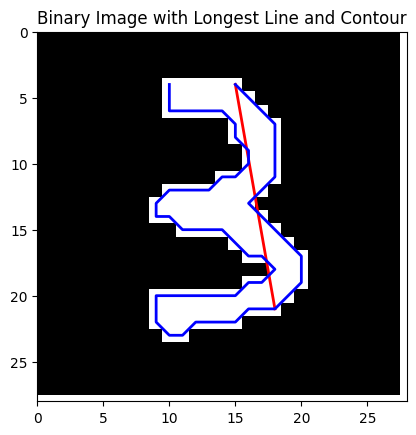

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9971


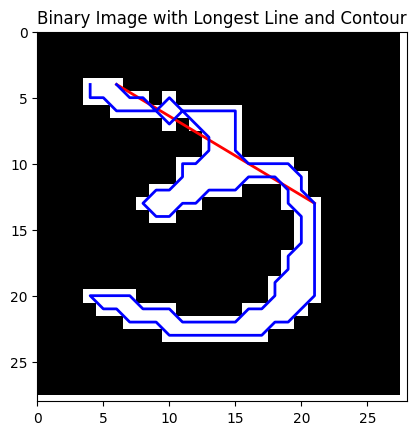

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


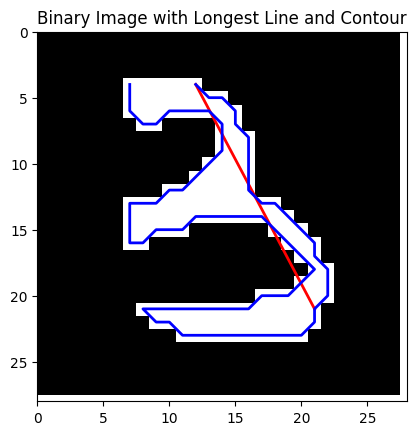

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


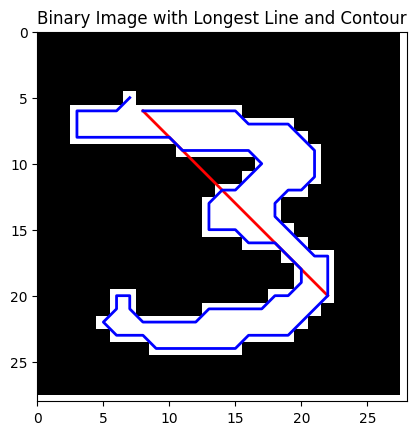

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9634


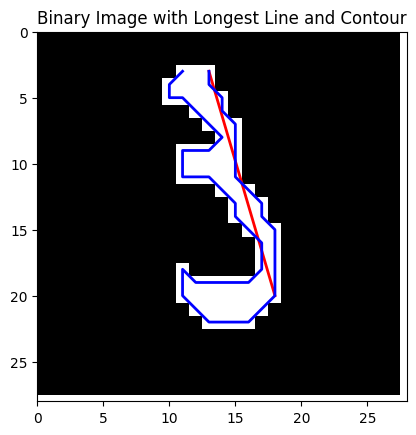

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


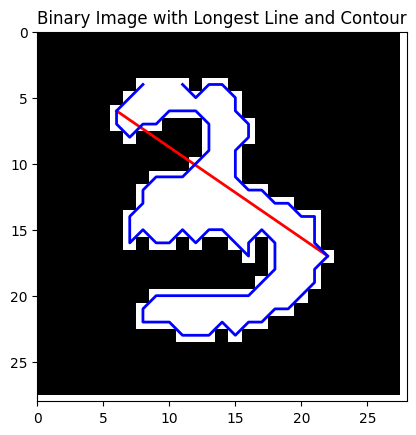

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


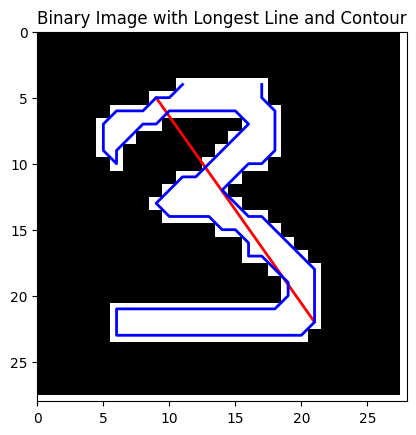

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


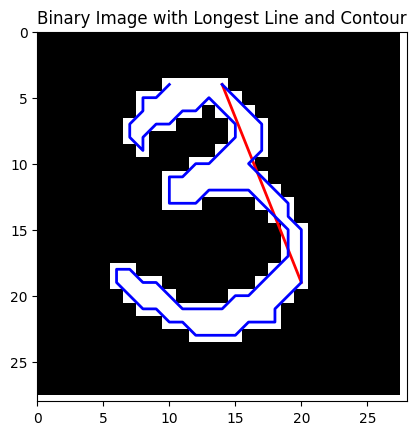

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


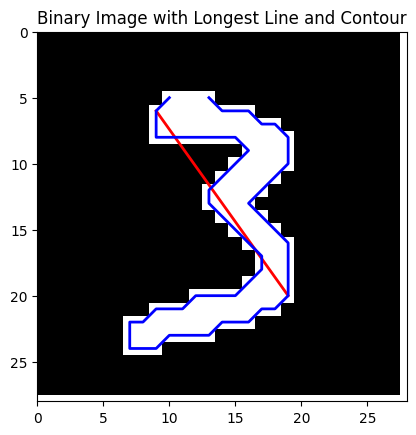

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


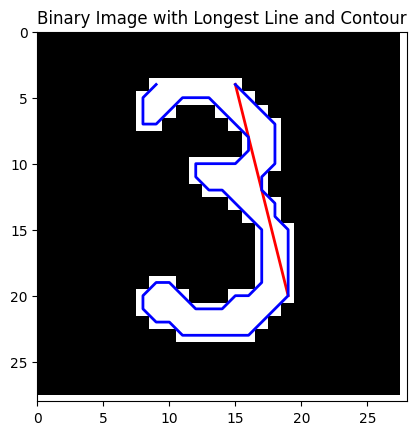

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


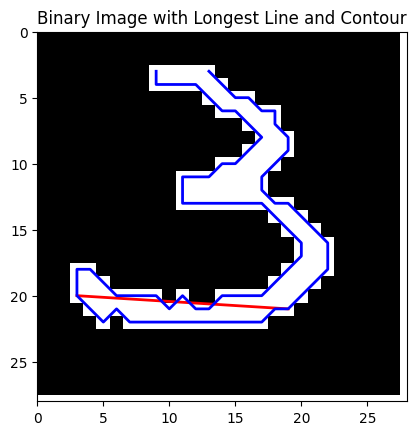

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


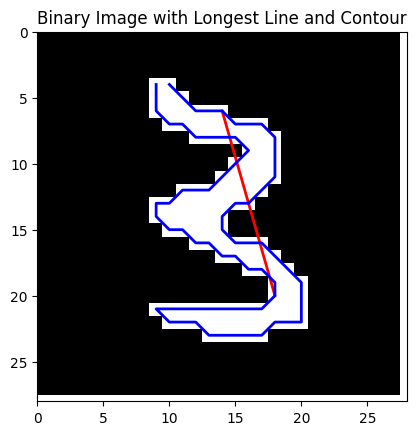

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9913


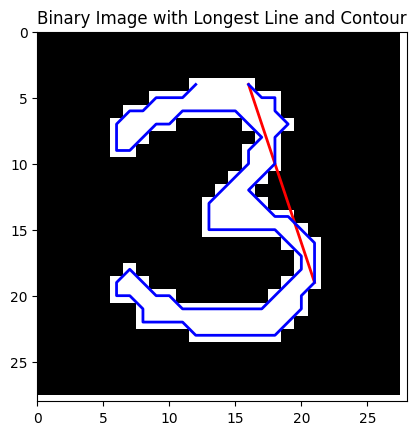

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


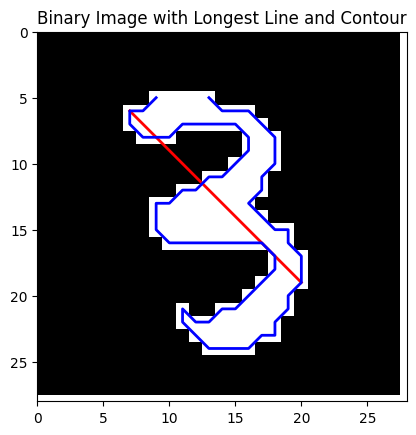

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


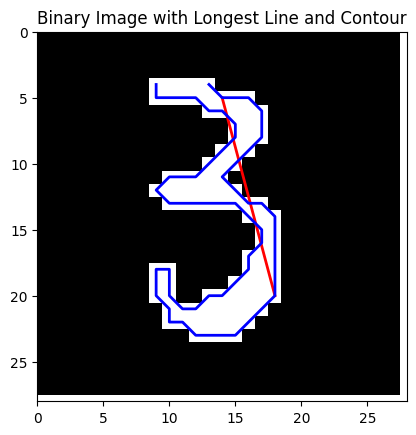

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9141


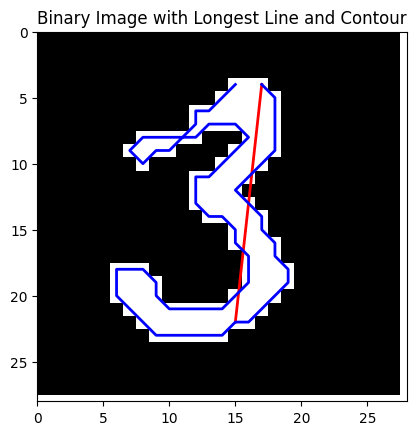

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


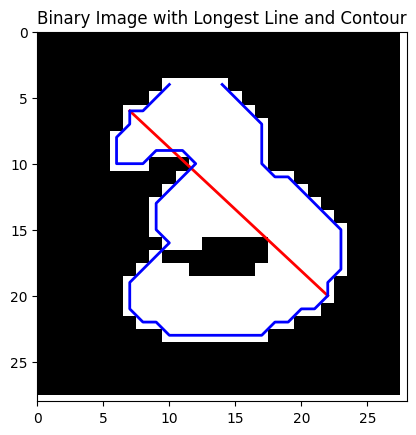

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


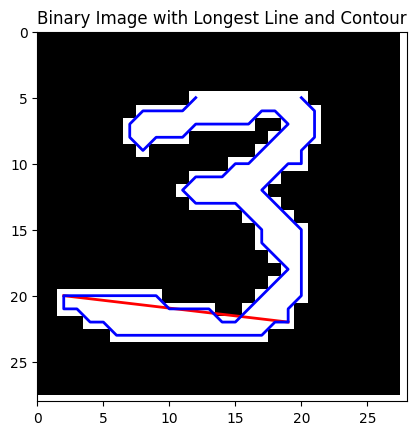

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


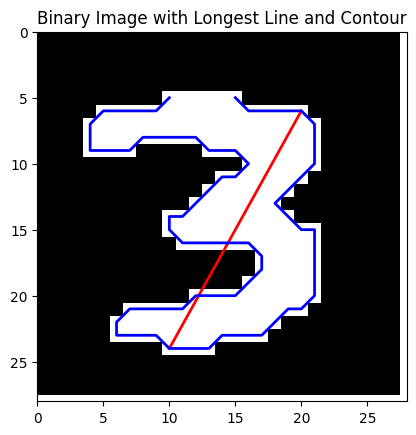

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


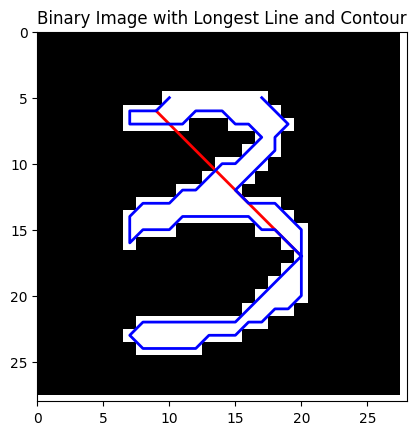

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9974


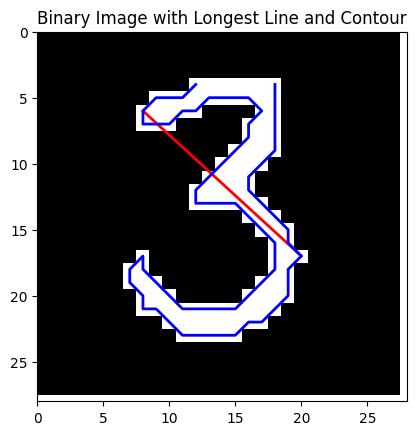

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


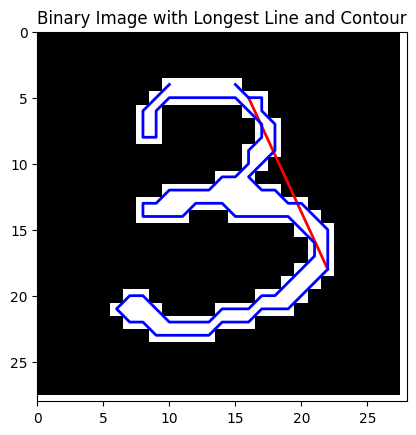

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9935


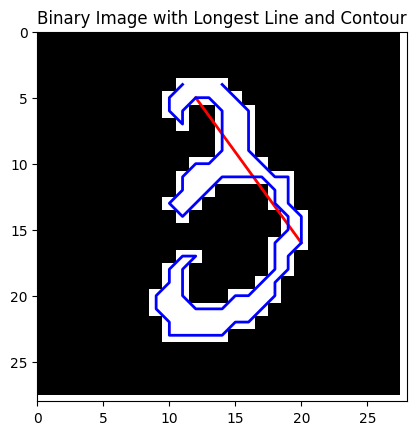

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9630


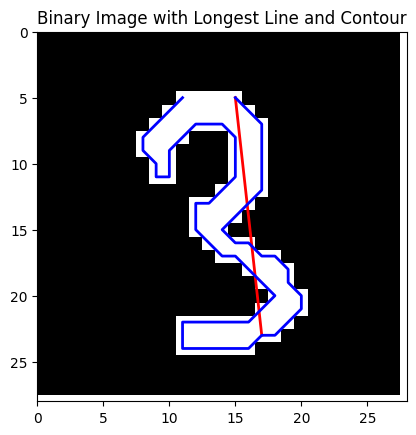

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


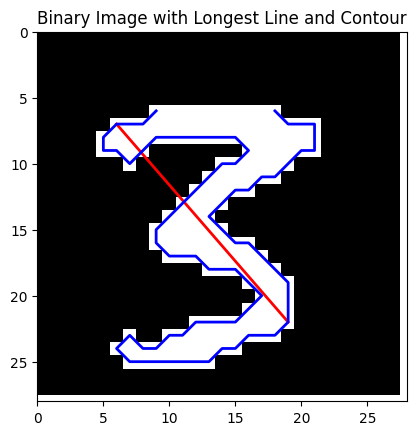

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


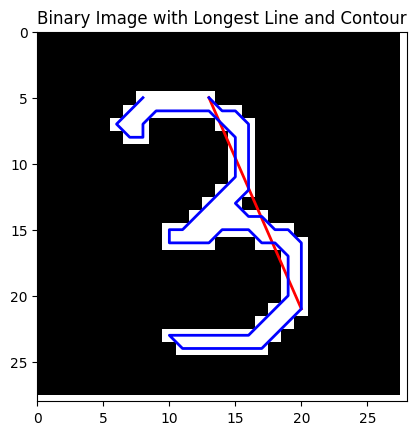

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9920


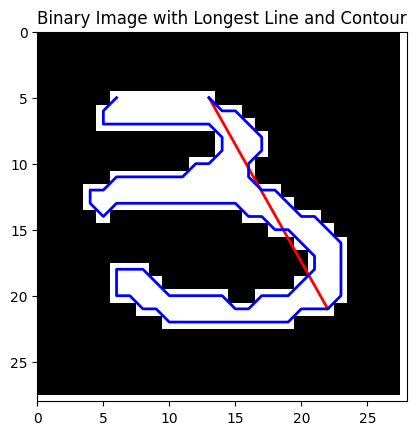

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


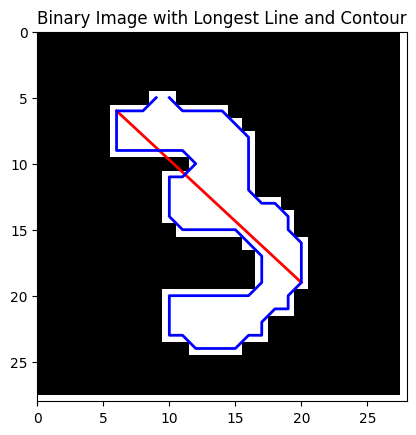

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9868


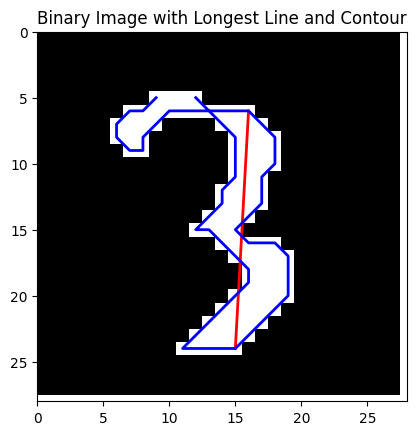

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9126


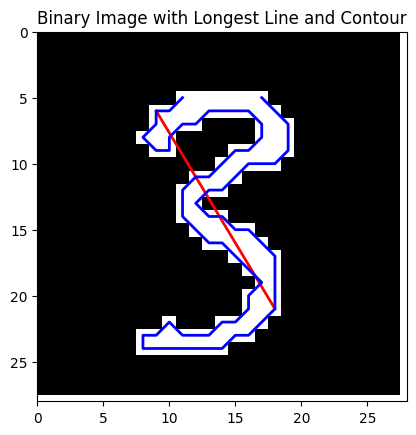

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


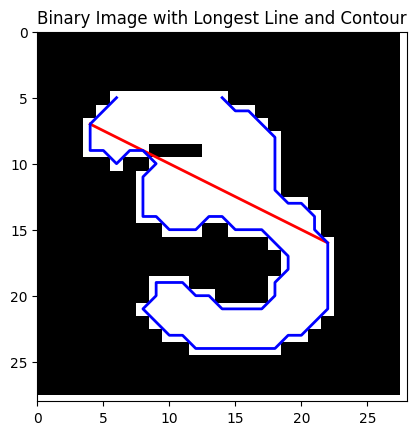

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9538


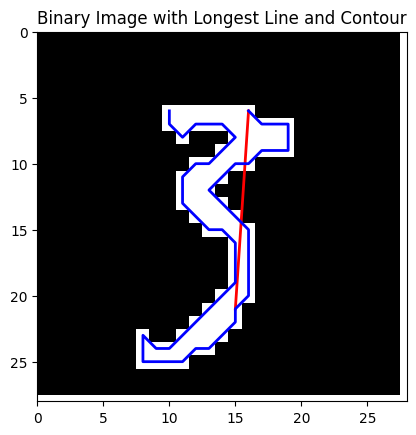

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.915     95     0.205       False             6.982   
1       1.000     66     0.148       False             6.239   
2       1.000     73     0.148       False             6.499   
3       0.996     53     0.107       False             5.820   
4       1.000     92     0.214       False             6.612   
..        ...    ...       ...         ...               ...   
95      1.000     67     0.188       False             6.106   
96      0.987     61     0.129       False             6.274   
97      0.913     77     0.130       False             6.482   
98      1.000     86     0.265       False             6.927   
99      0.954     62     0.110       False             6.222   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               8.328  0.938   5.250     125     36               21.932   
1               7.151  1.091  -0.636      73     43               16.279   
2  

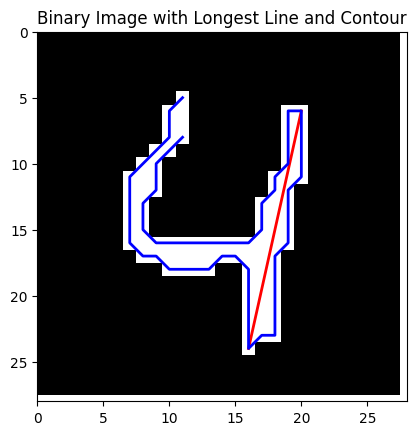

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9747


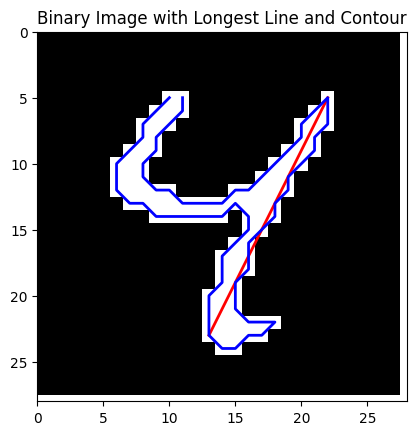

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


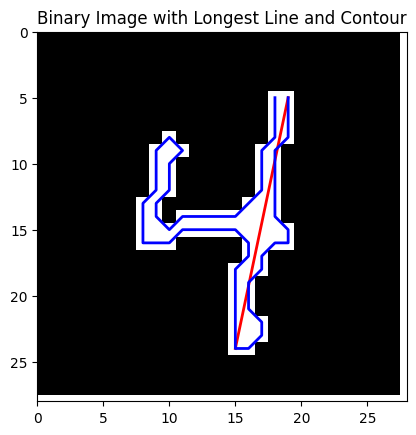

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9893


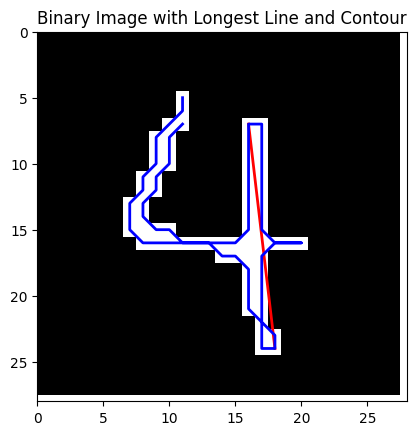

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


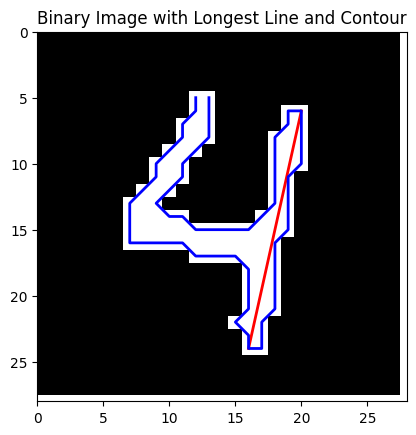

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9502


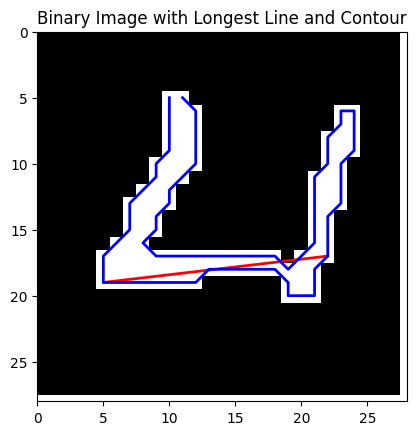

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


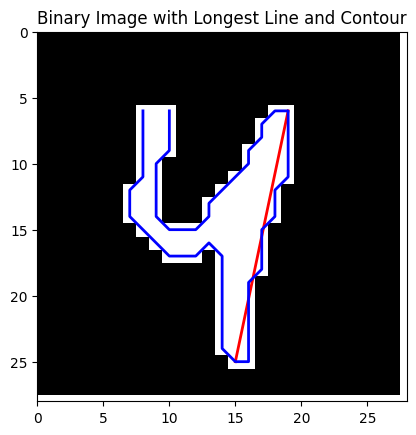

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


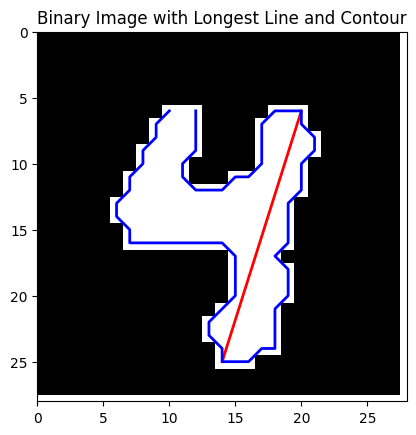

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


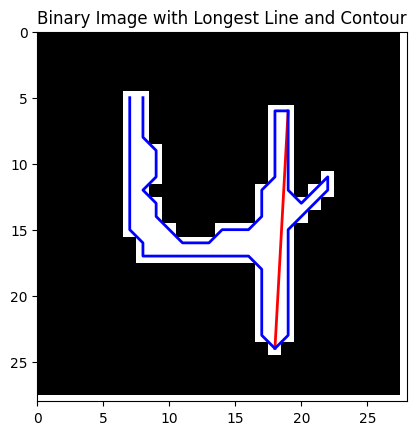

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


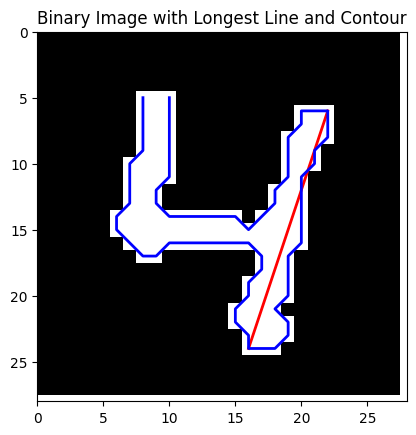

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9885


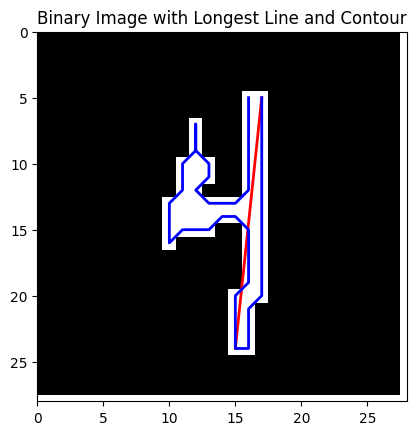

Prediction probability for digit 9: 0.9995


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


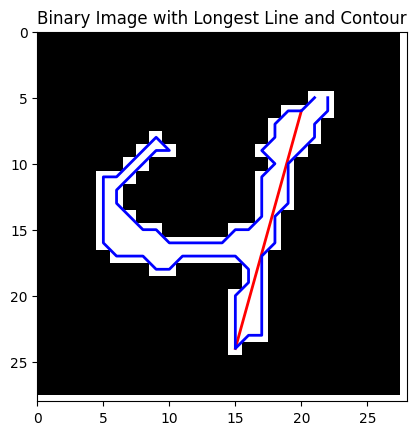

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


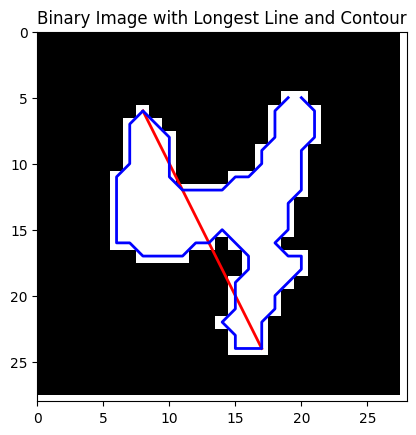

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9981


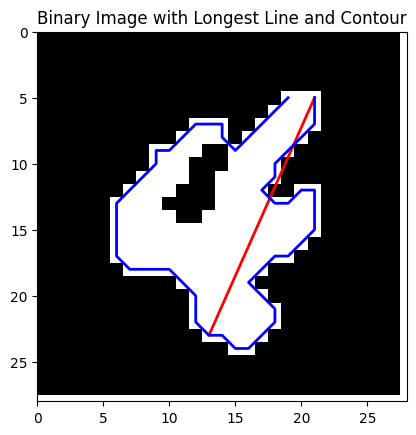

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


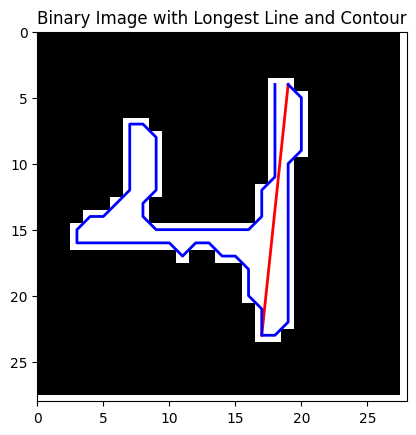

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


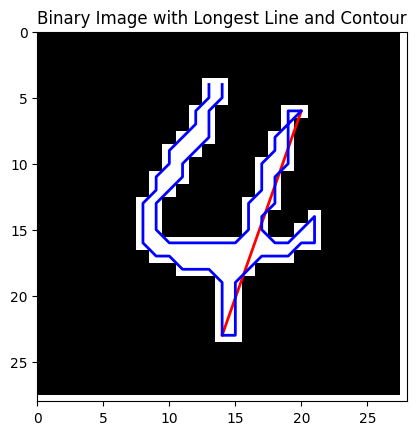

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


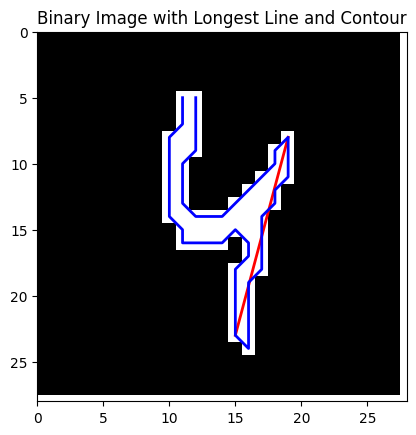

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


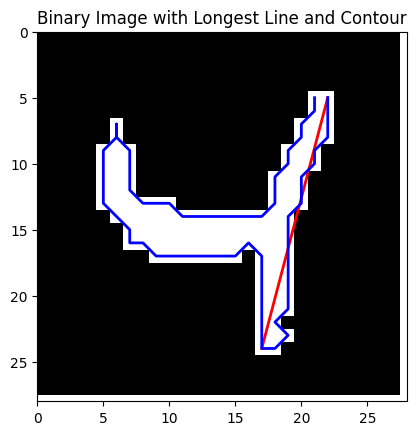

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


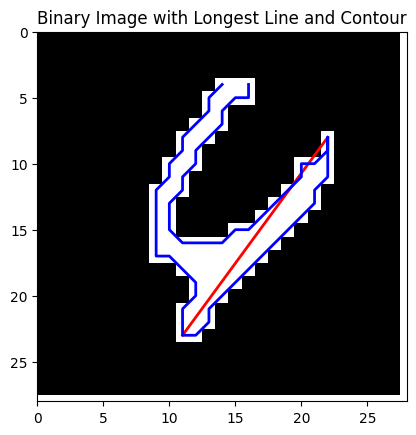

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9942


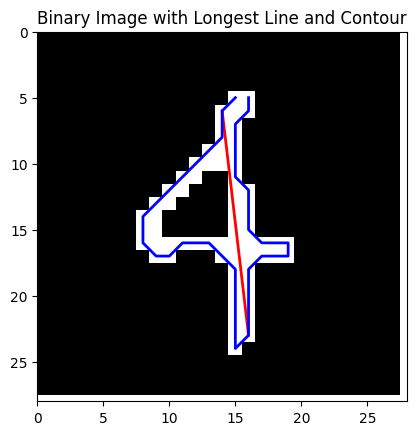

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


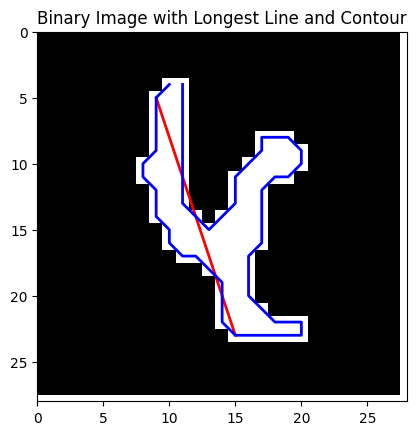

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


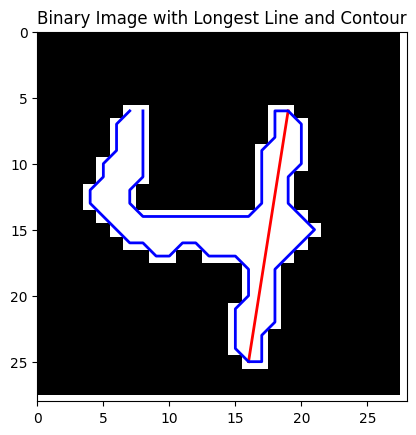

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9893


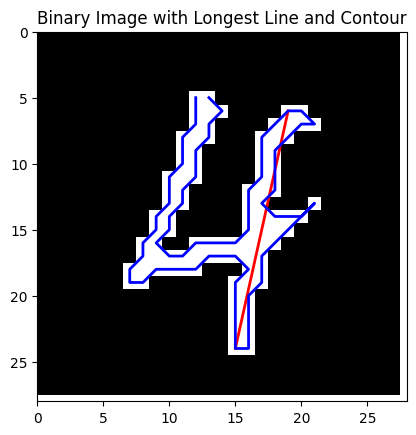

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


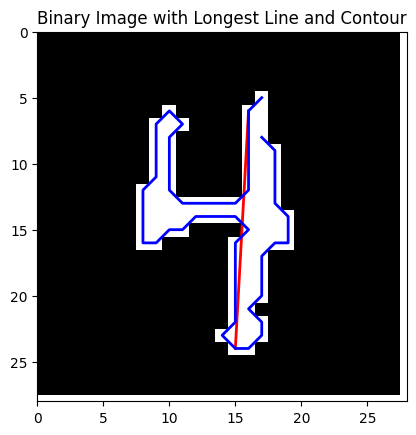

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


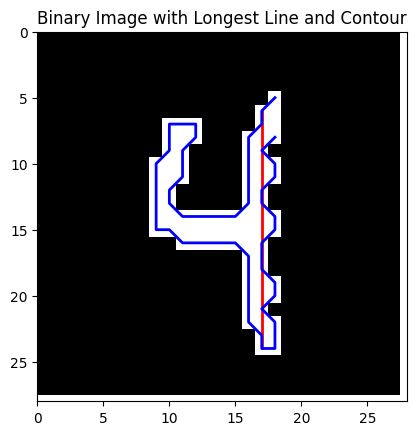

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


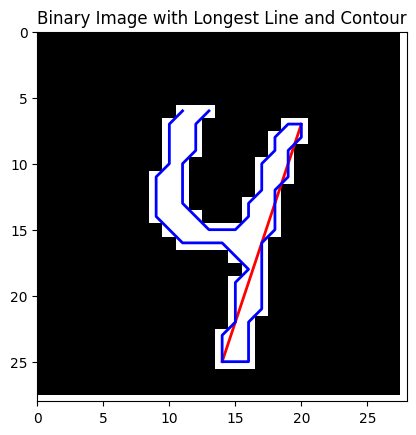

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9834


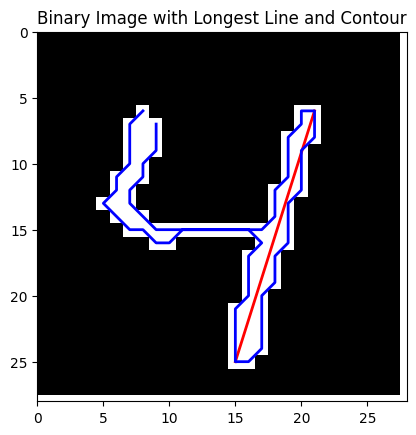

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9835


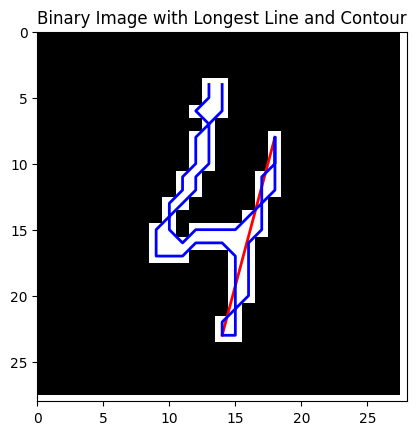

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


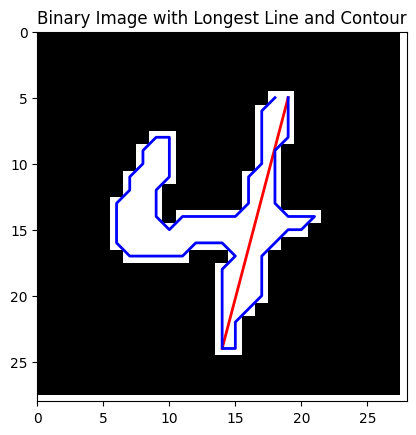

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


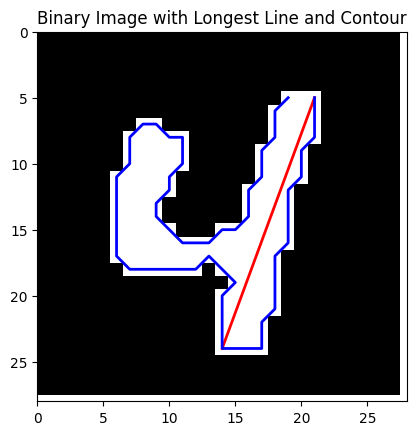

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9867


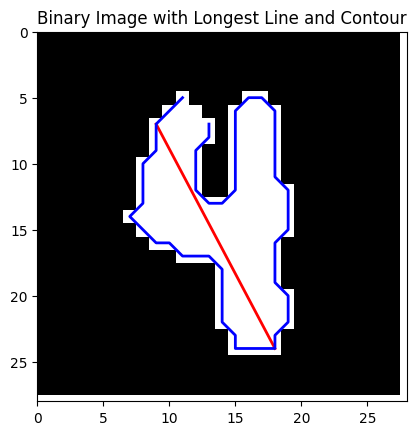

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9869


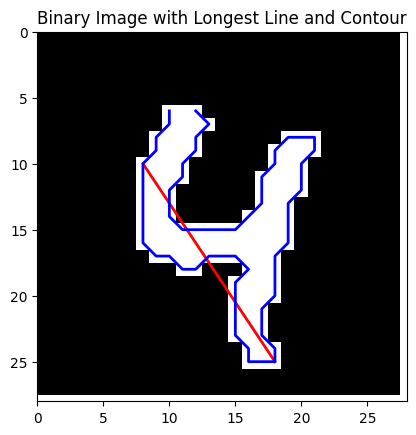

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


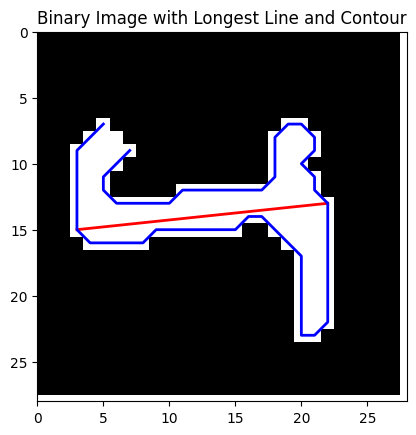

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


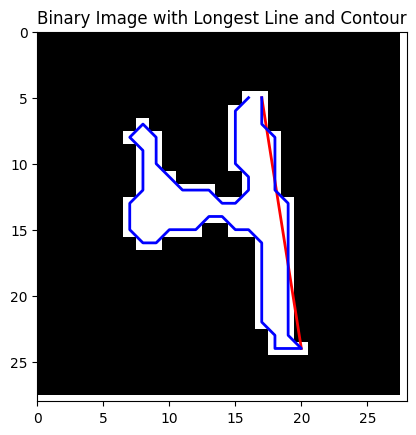

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9951


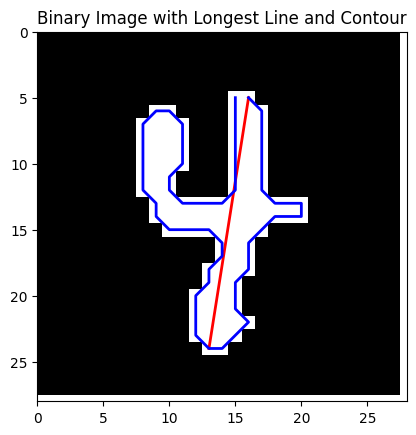

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9937


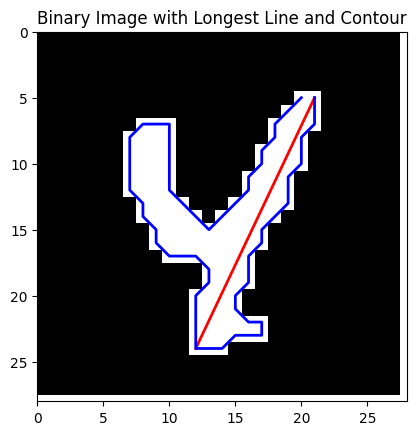

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


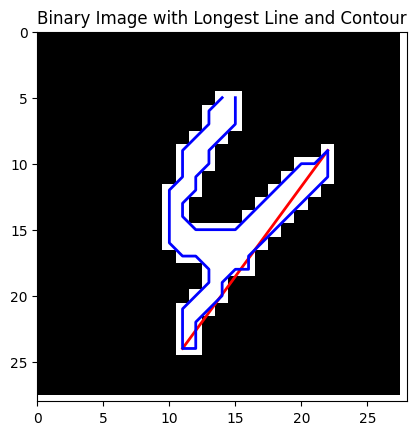

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


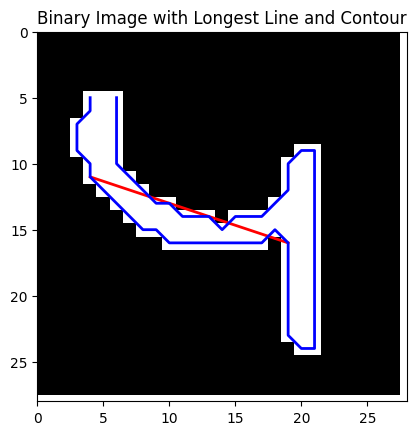

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9770


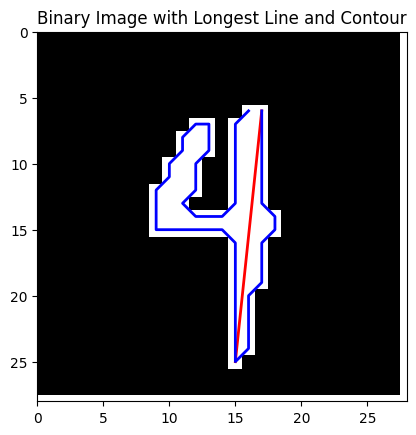

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


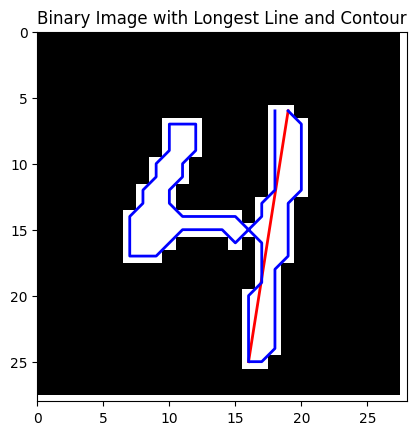

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


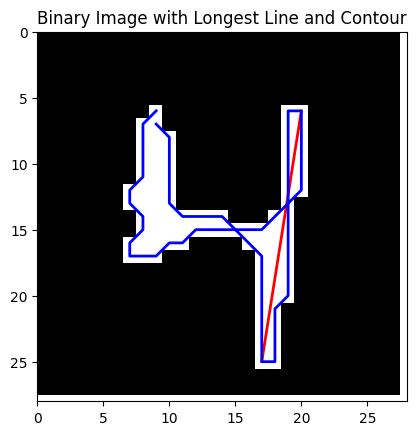

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


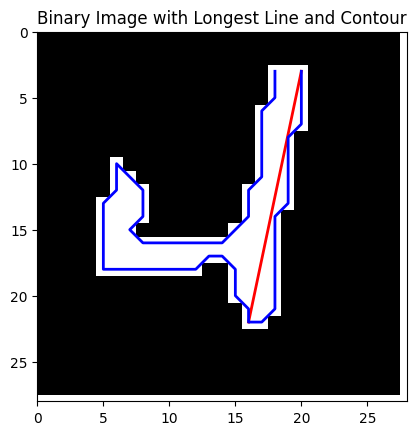

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


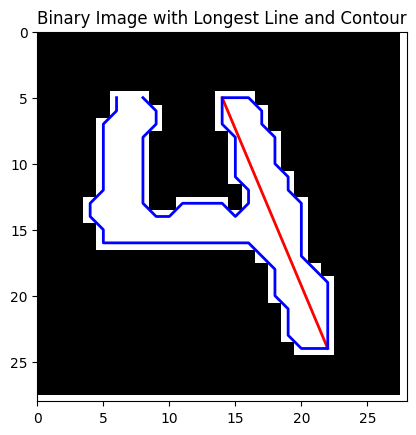

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9045


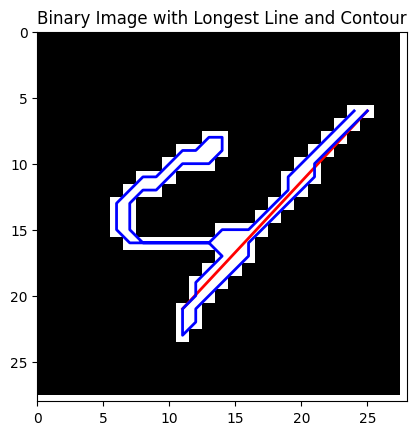

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9870


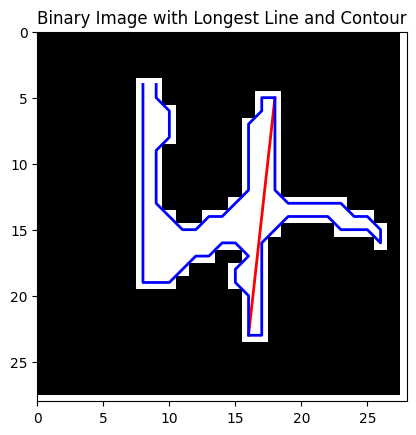

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9910


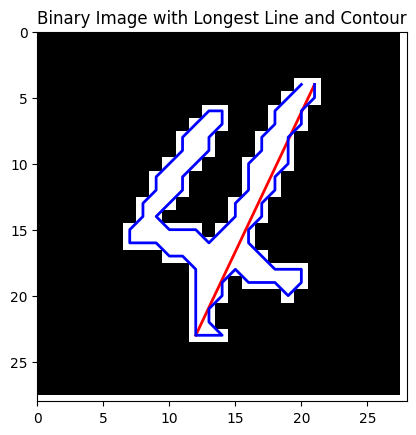

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9275


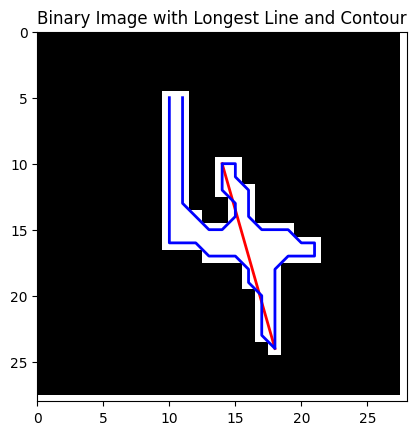

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


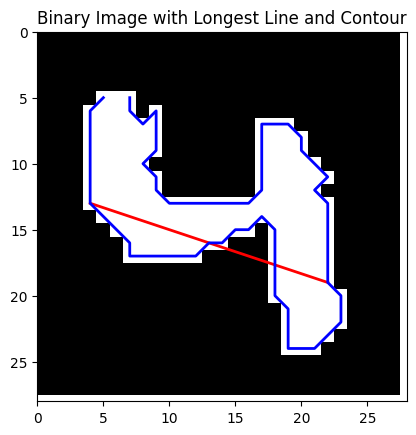

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


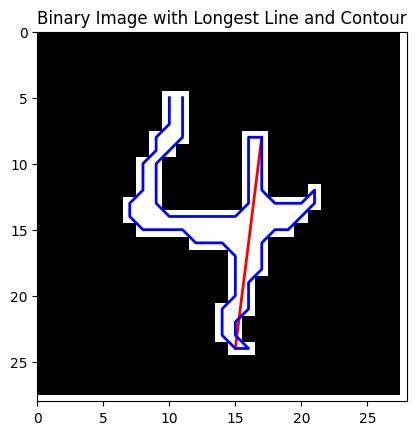

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9977


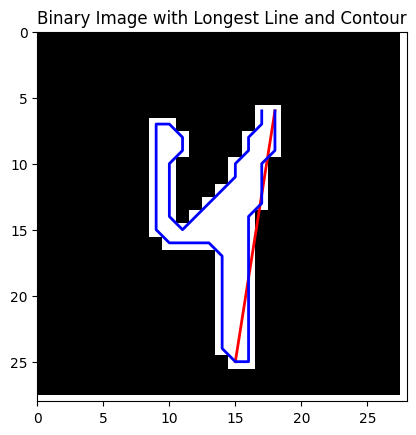

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9861


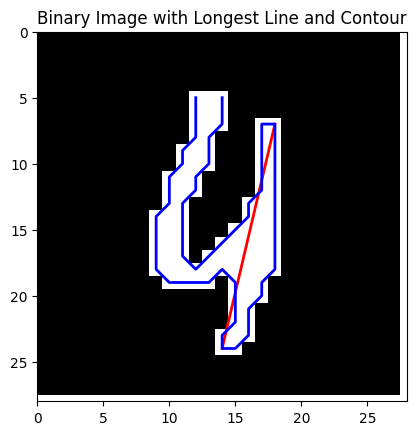

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


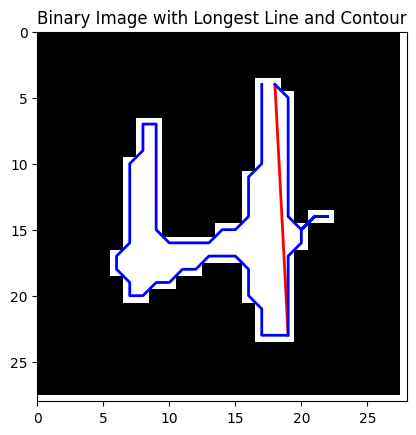

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


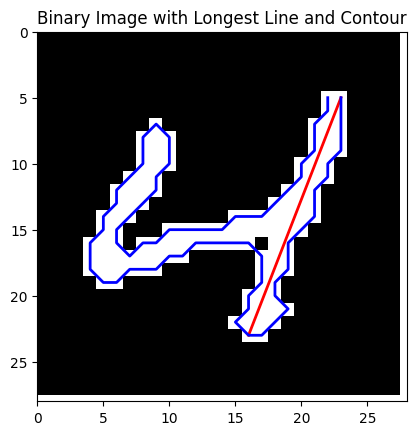

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


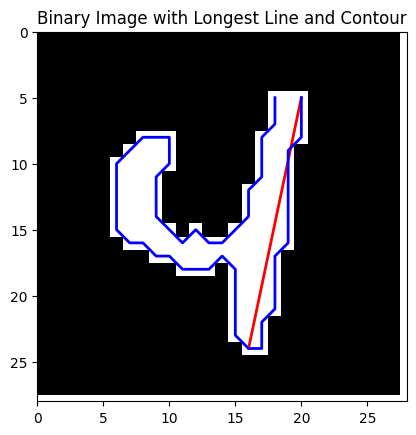

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


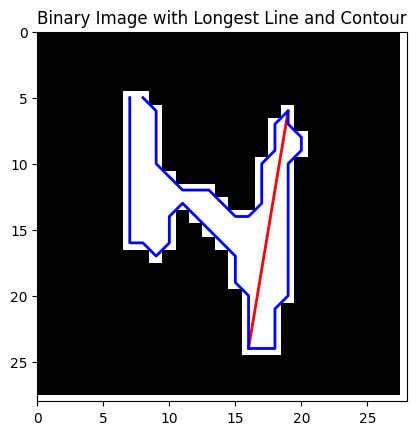

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9878


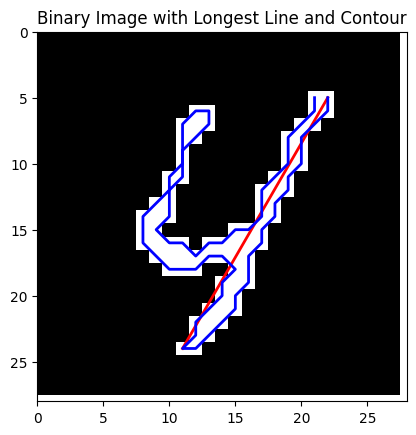

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


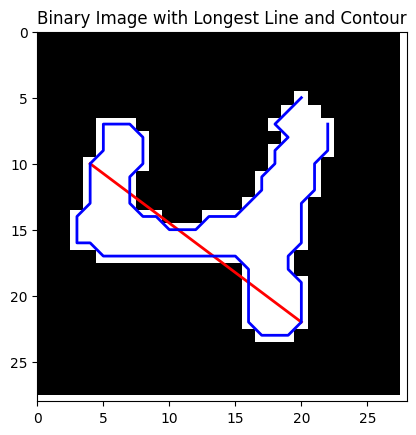

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9639


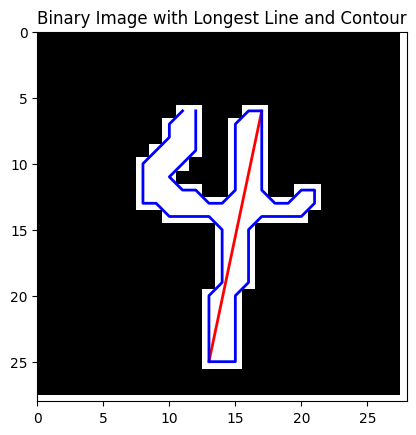

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


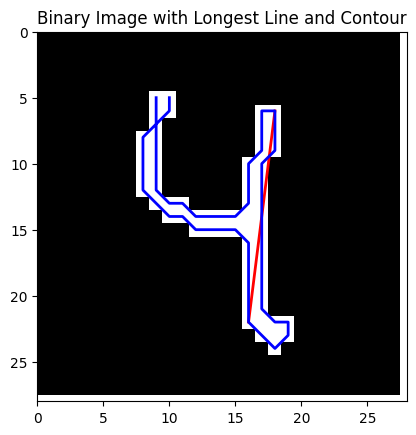

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9942


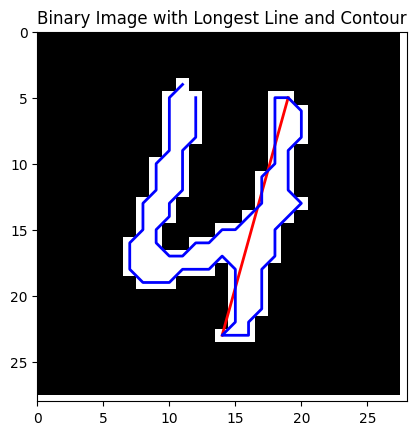

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


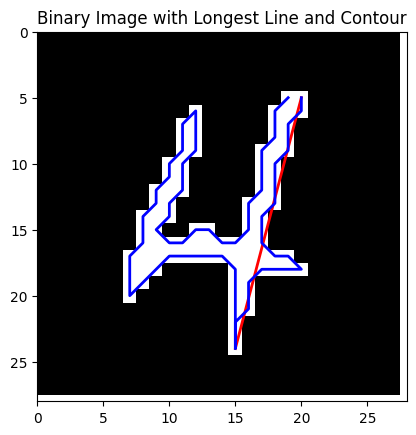

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


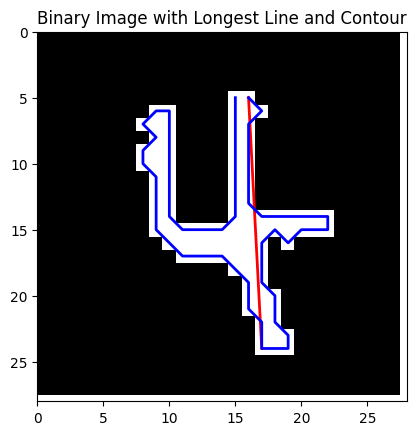

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


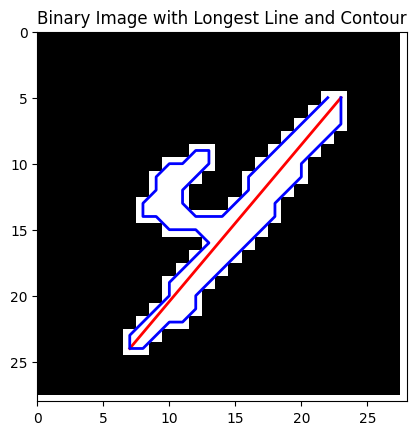

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9360


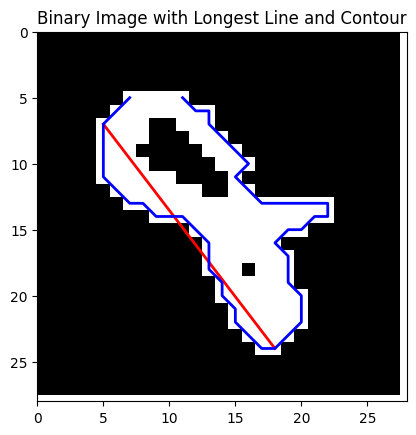

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


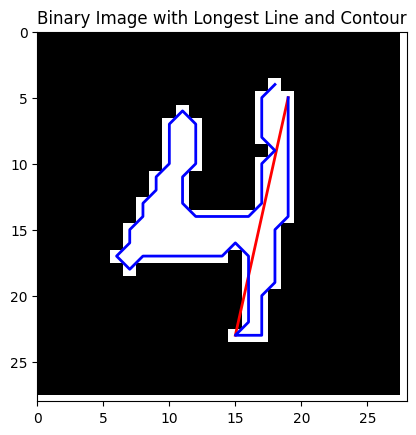

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


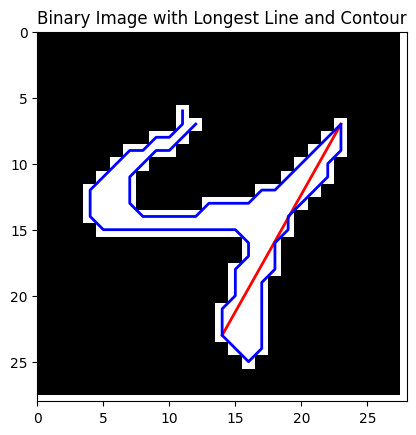

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9919


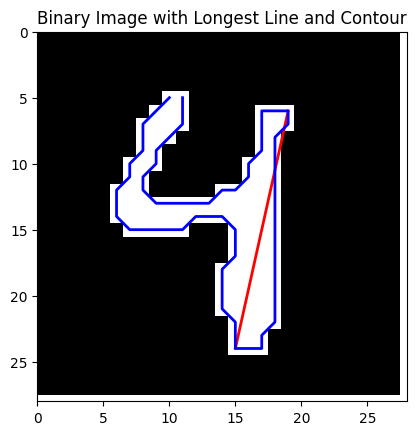

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9940


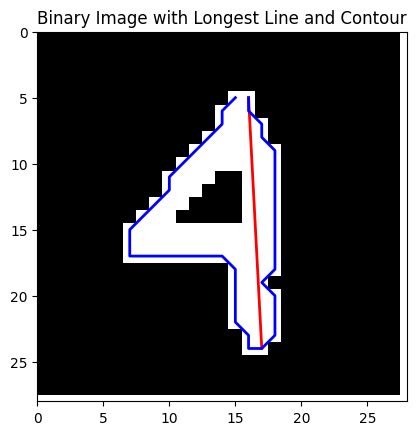

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


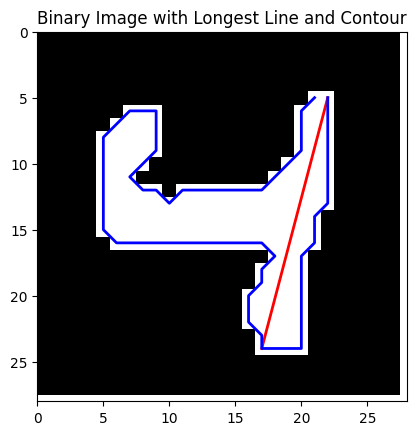

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


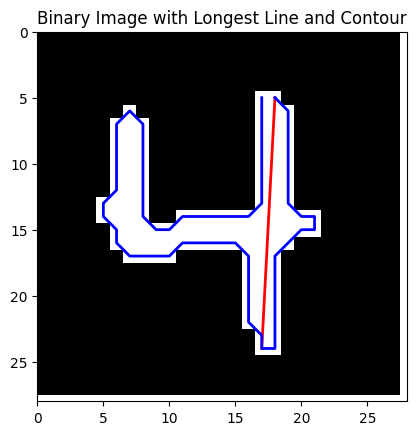

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


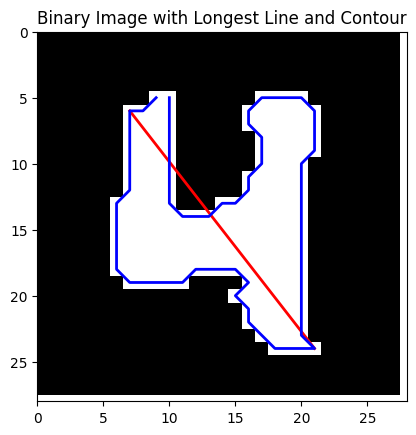

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9882


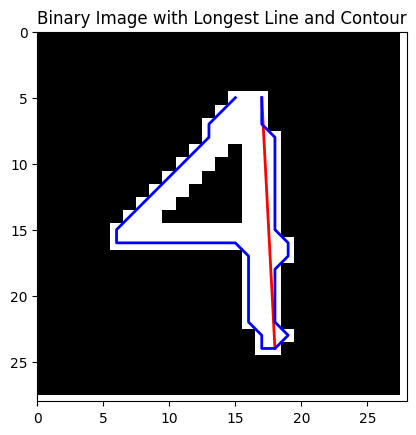

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


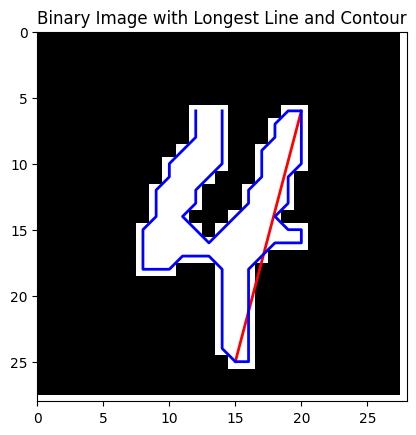

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9967


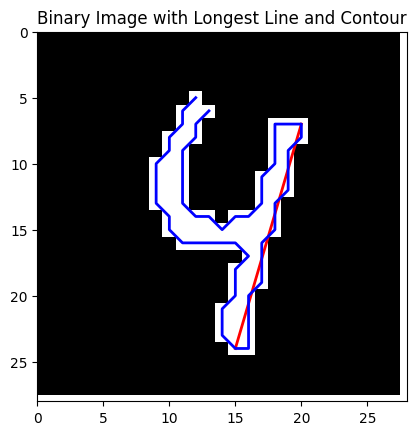

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


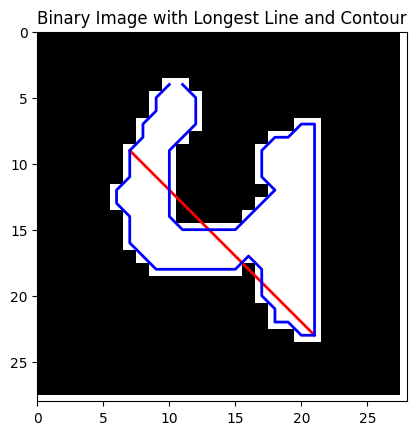

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


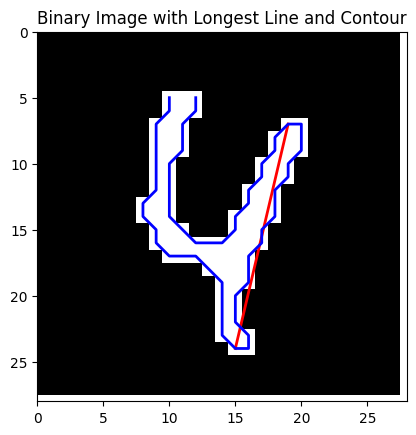

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


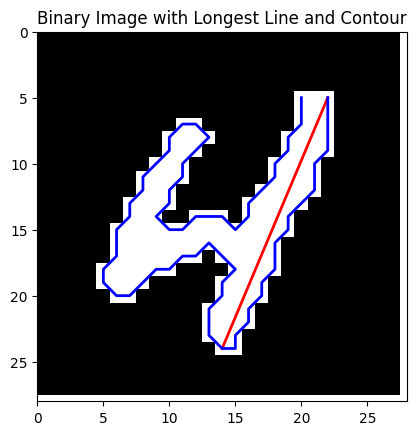

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9569


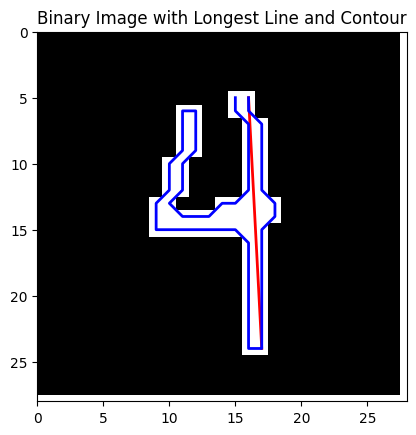

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


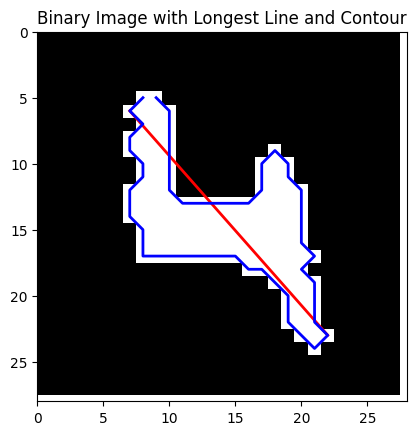

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


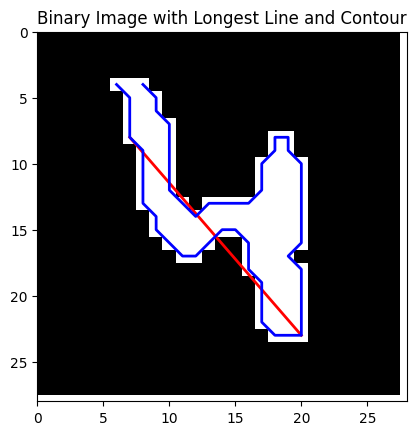

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9836


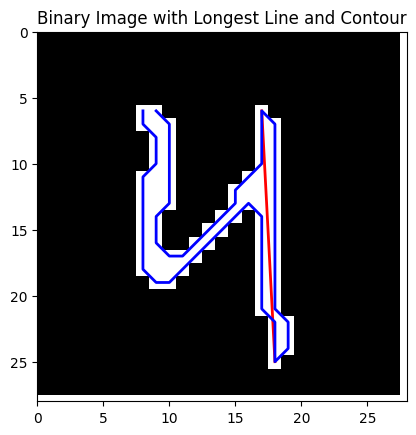

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


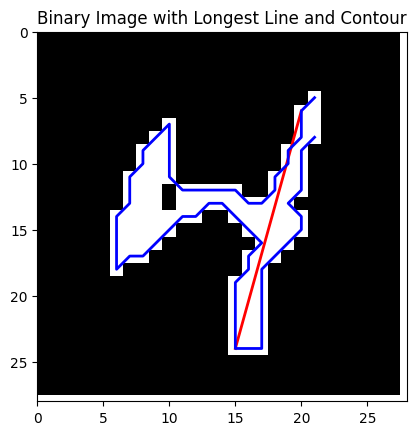

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


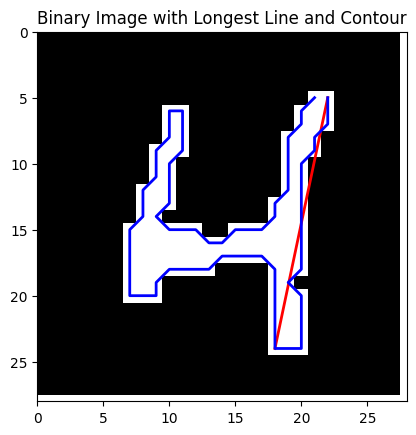

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9765


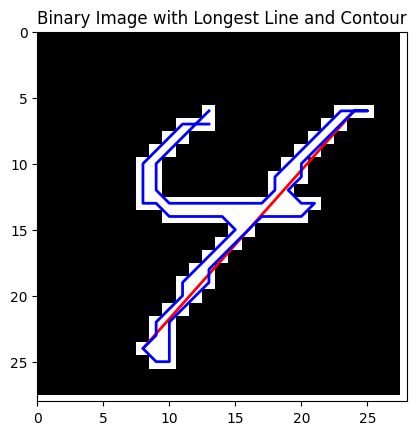

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9487


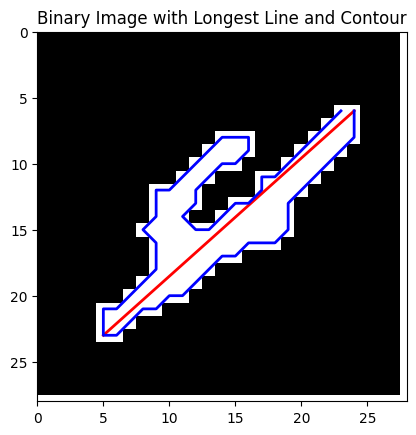

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


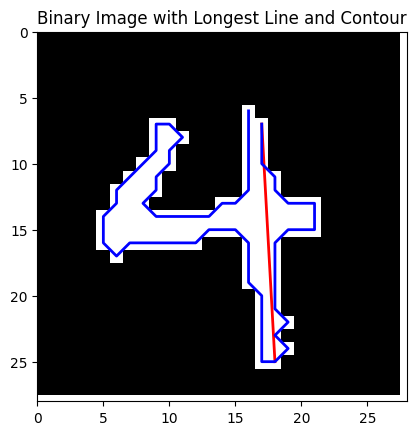

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


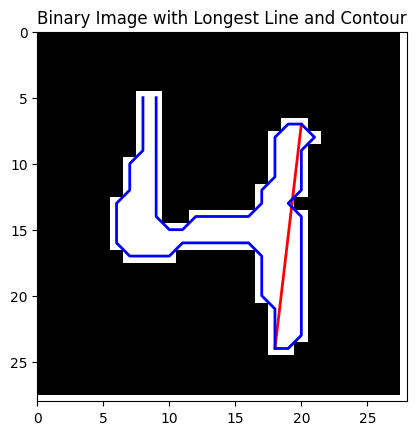

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9801


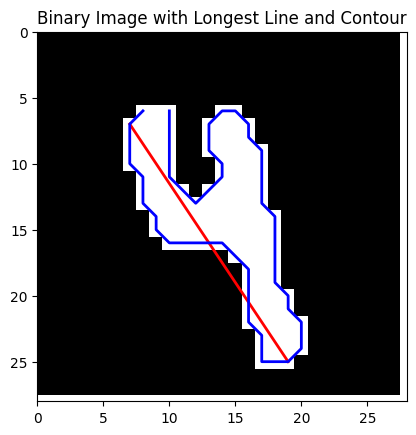

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


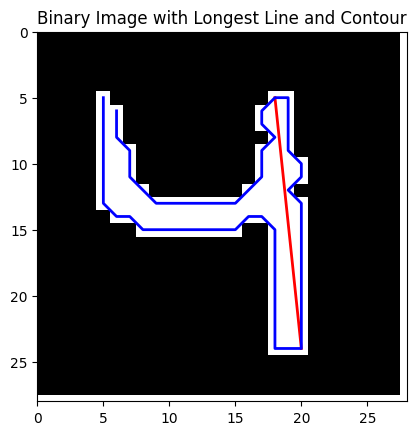

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9813


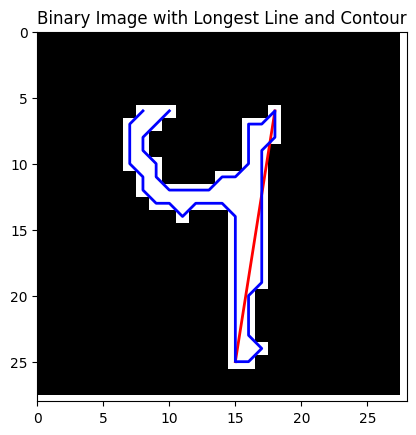

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


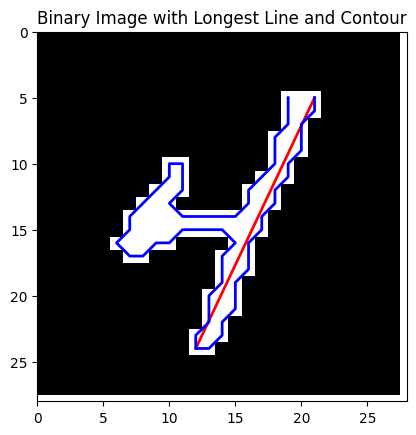

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


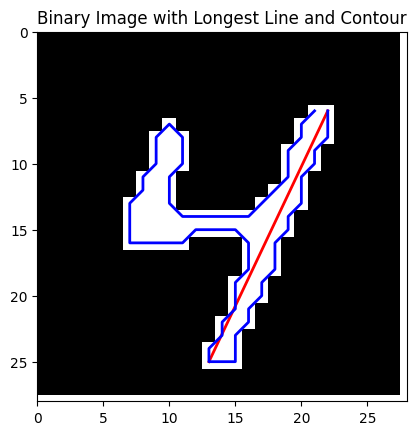

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


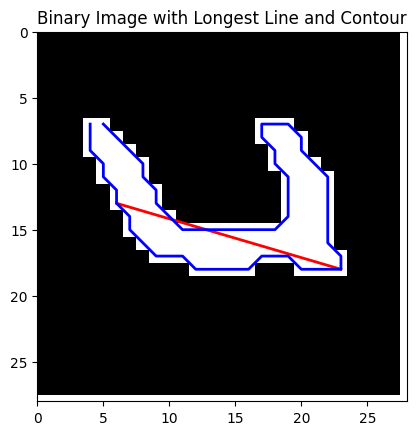

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9707


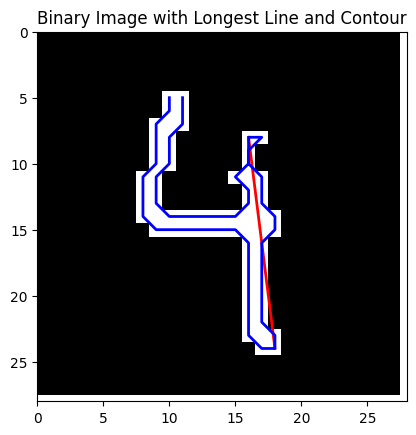

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


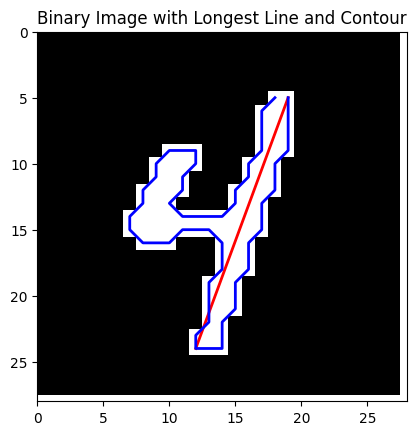

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


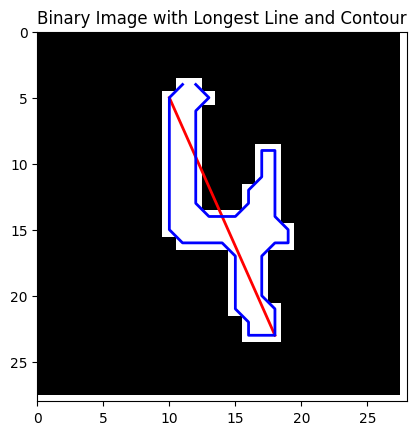

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9972


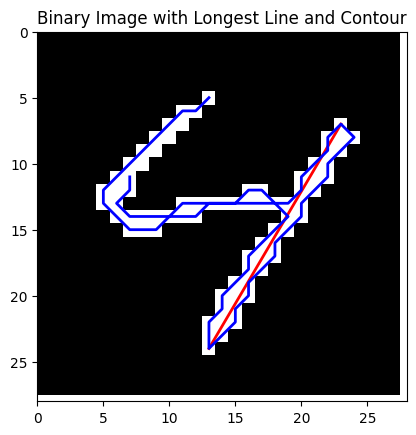

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


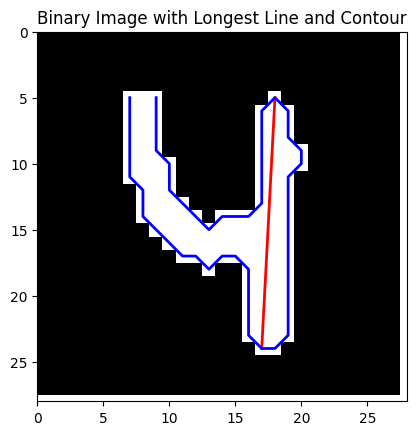

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


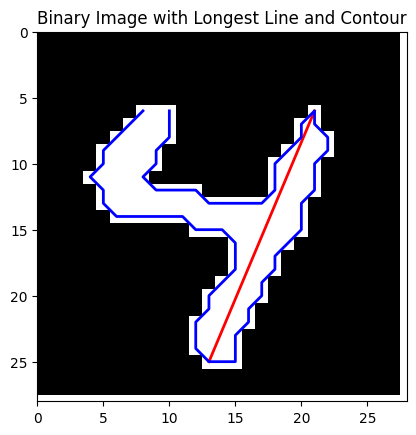

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9945


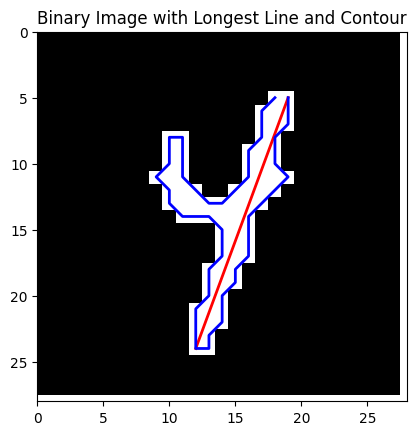

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.953     74     0.120       False             5.971   
1       0.975     72     0.125       False             6.235   
2       1.000     67     0.101       False             5.280   
3       0.989     66     0.089       False             5.568   
4       1.000     71     0.131       False             5.714   
..        ...    ...       ...         ...               ...   
95      0.999     58     0.117       False             5.089   
96      0.997     71     0.098       False             6.444   
97      1.000     67     0.159       False             5.953   
98      1.000     70     0.177       False             6.378   
99      0.995     54     0.098       False             4.975   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               4.626 -0.222  21.333      19     75               18.439   
1               7.609 -0.500  24.500      26     72               20.125   
2  

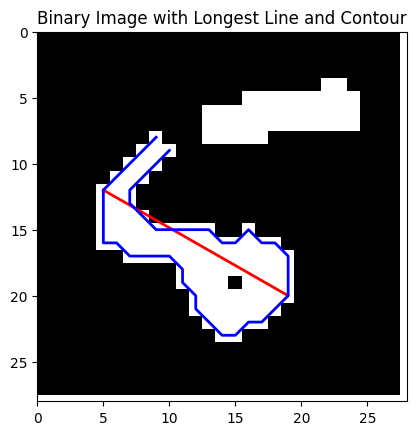

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9915


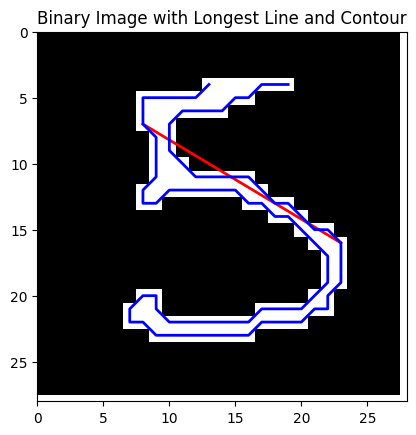

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


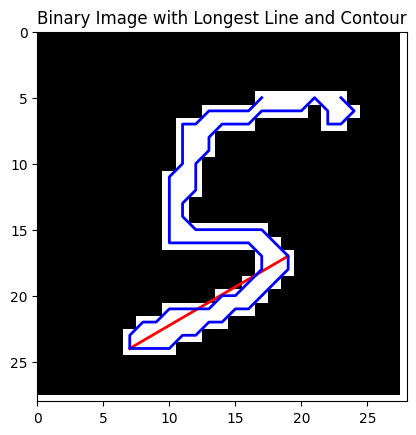

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9934


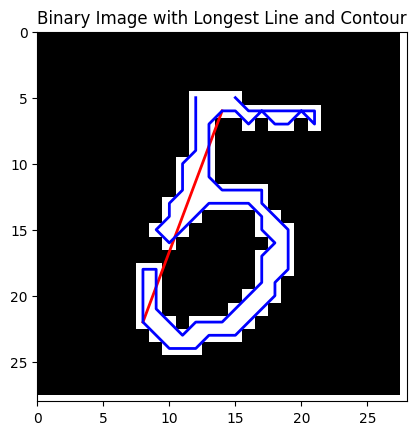

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


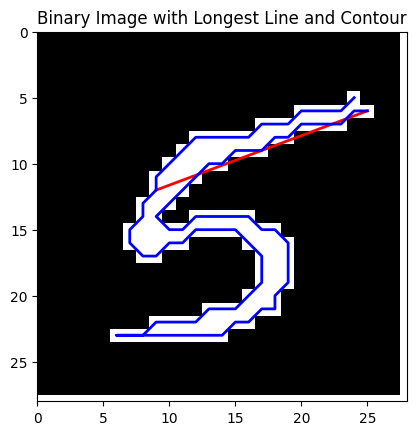

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9882


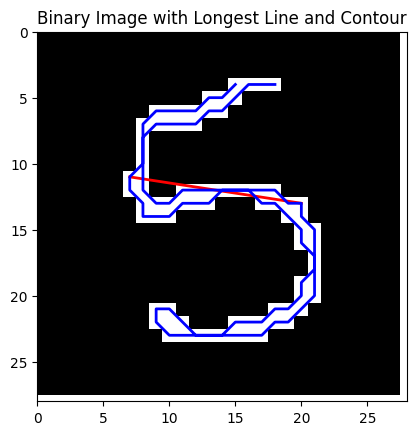

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9887


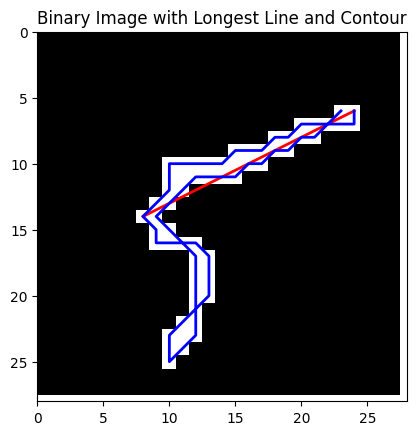

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


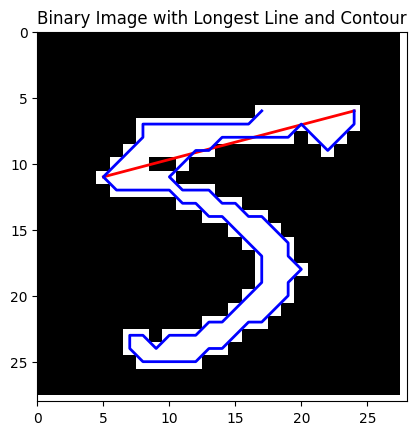

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


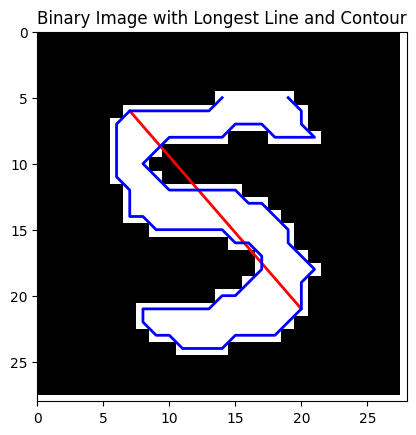

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


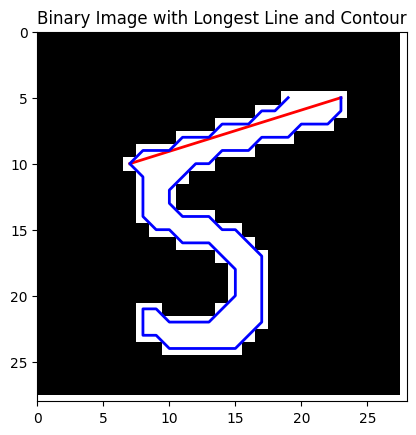

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


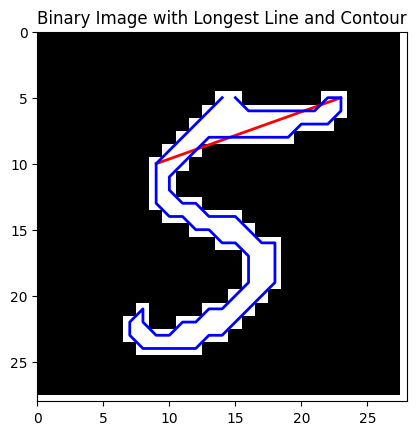

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


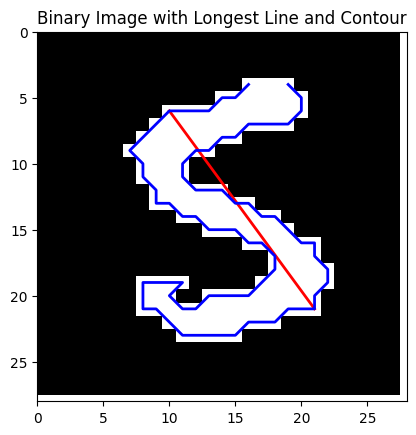

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


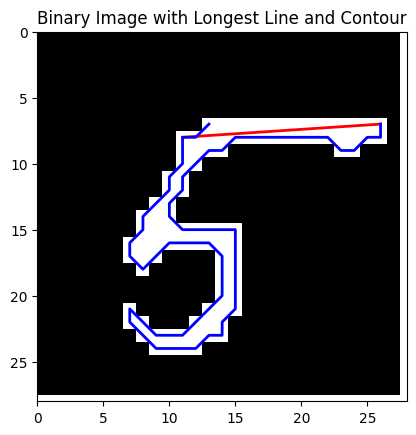

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


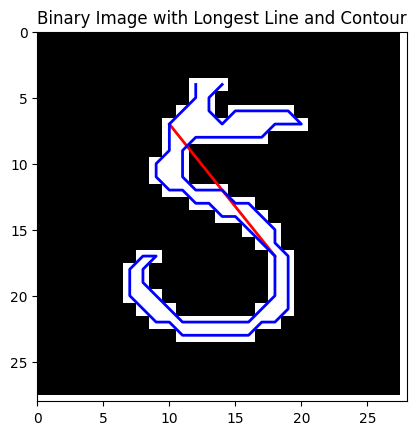

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


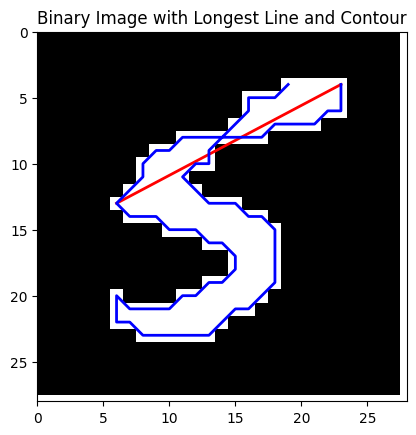

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


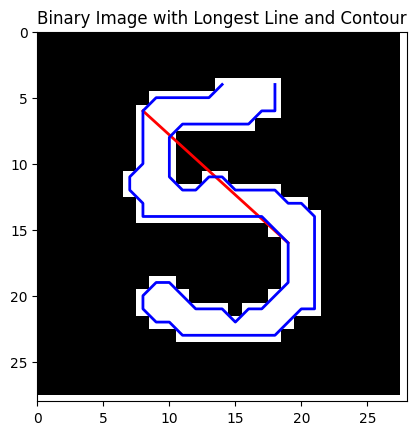

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9959


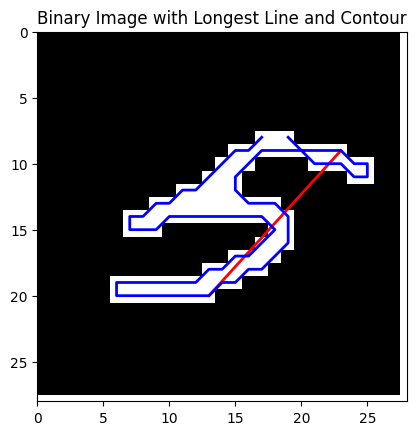

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9940


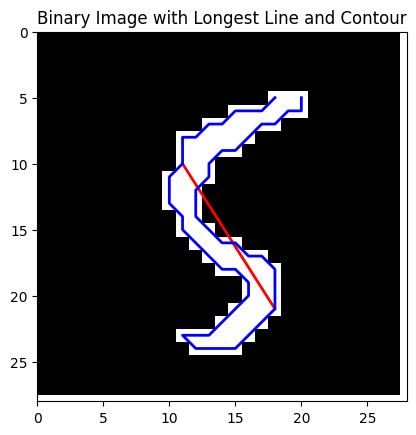

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9944


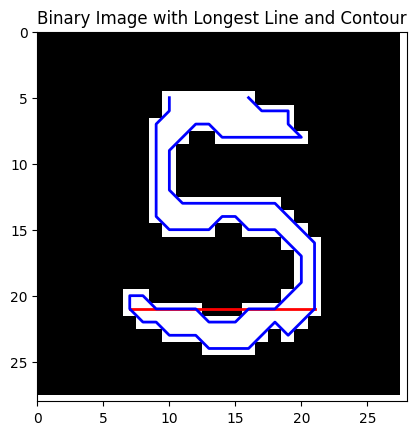

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3407666934.py:54: RuntimeWarning: divide by zero encountered in int_scalars
  k=1/(y1-y0)*(x1-x0)
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9536


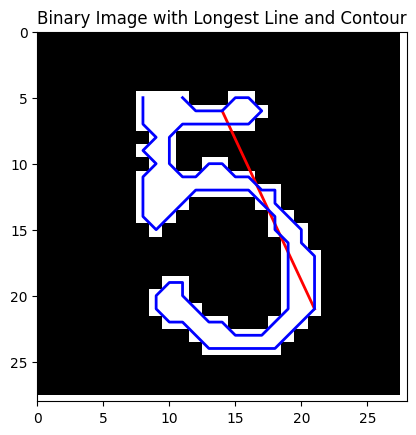

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9580


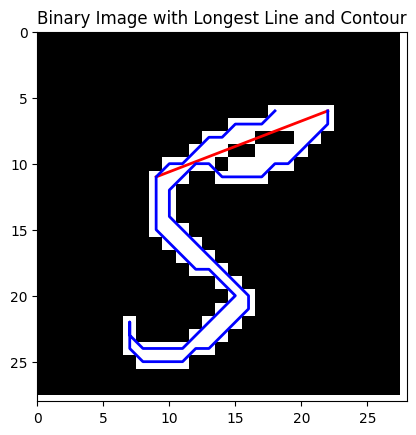

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


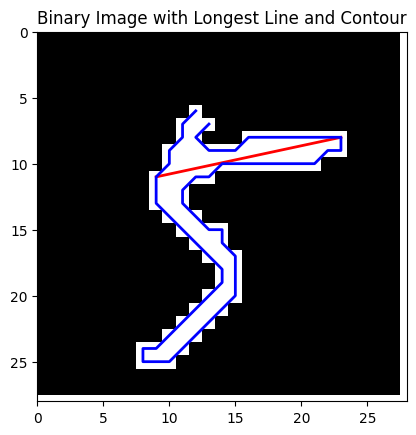

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


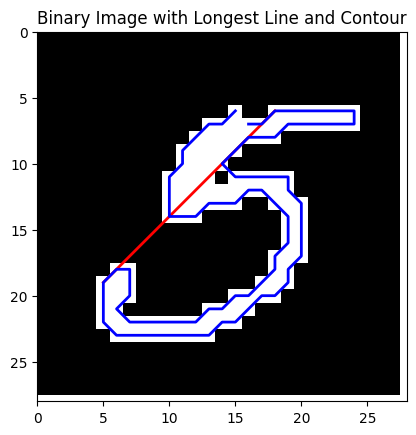

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


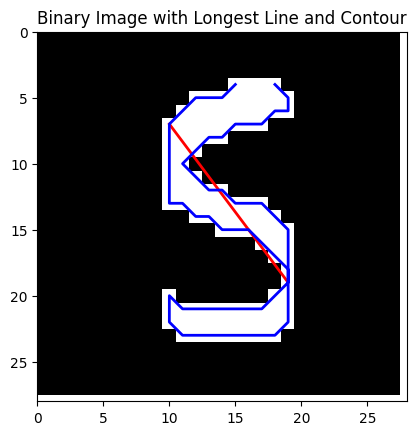

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


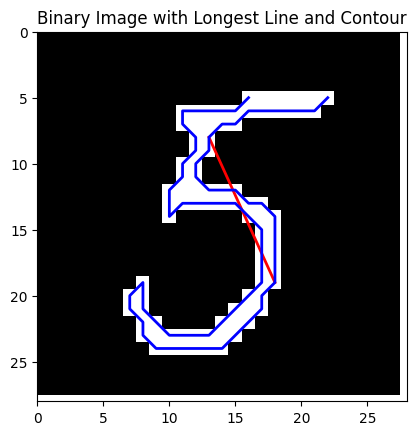

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


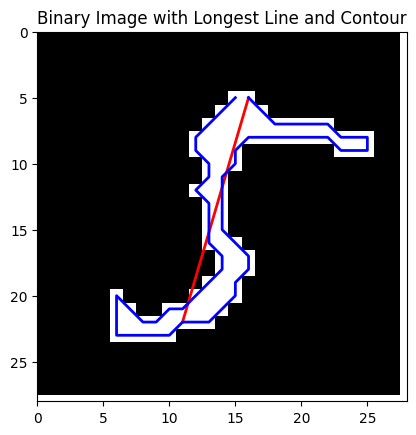

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


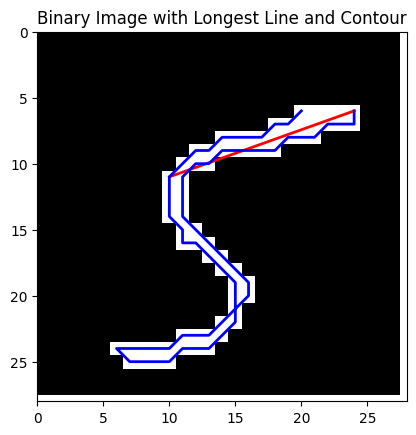

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9959


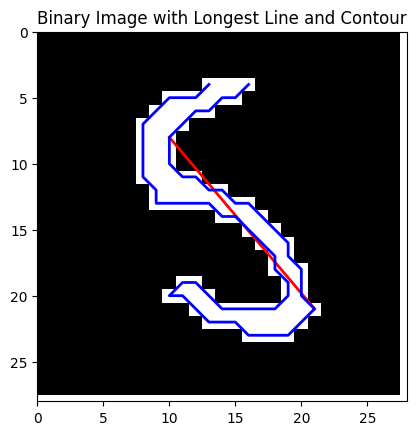

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9923


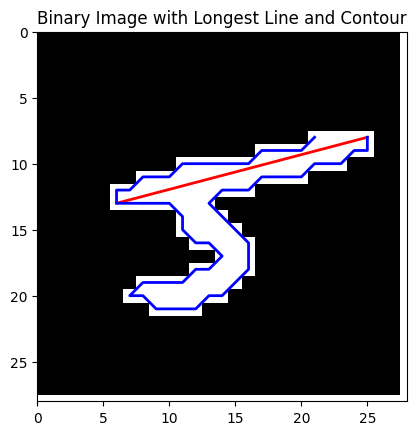

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


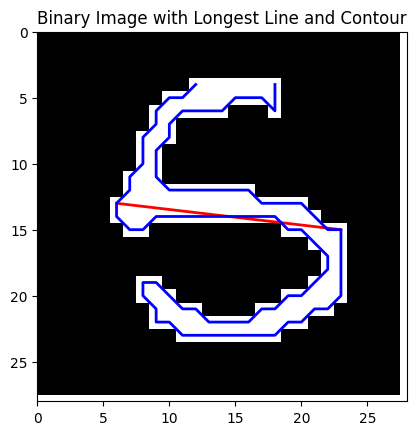

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


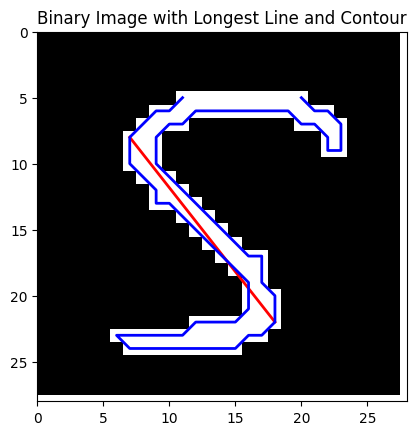

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9672


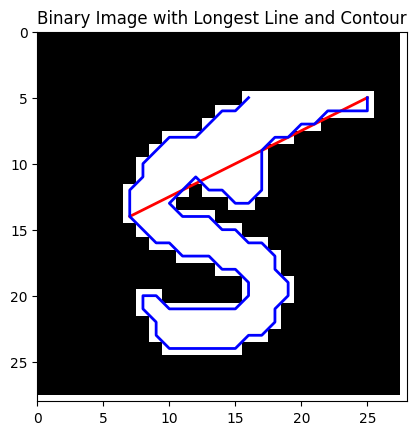

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


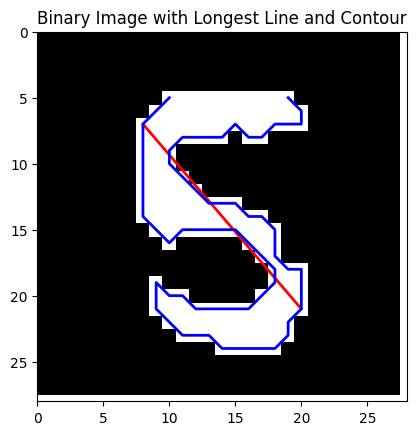

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


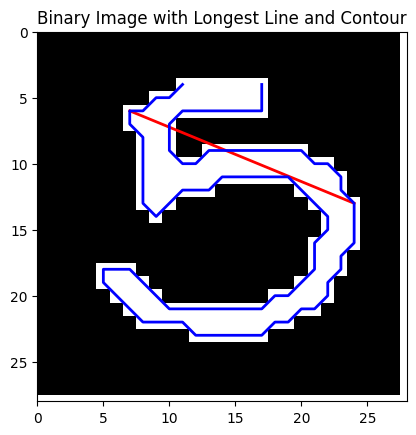

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


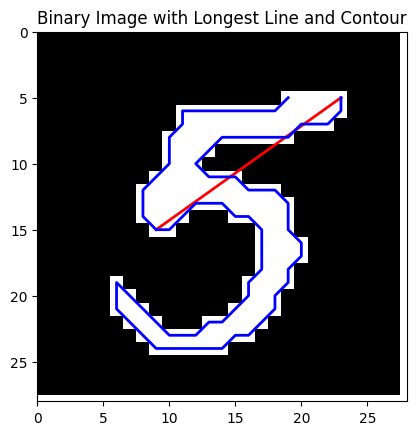

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


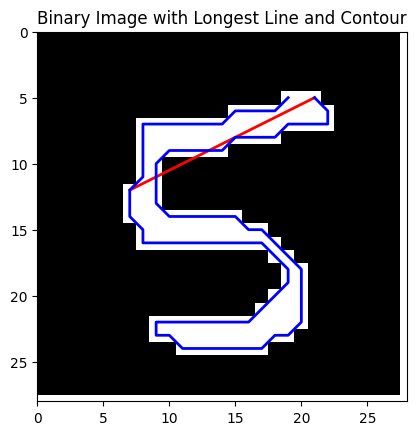

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


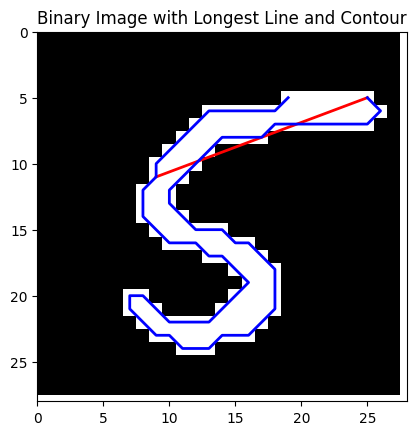

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9964


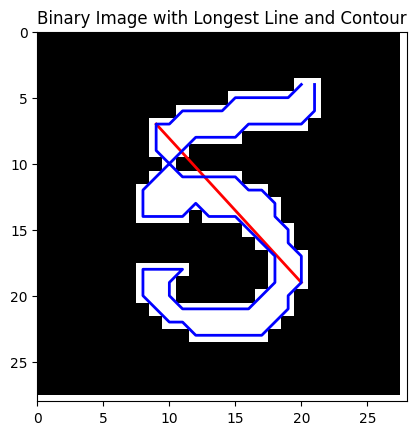

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9903


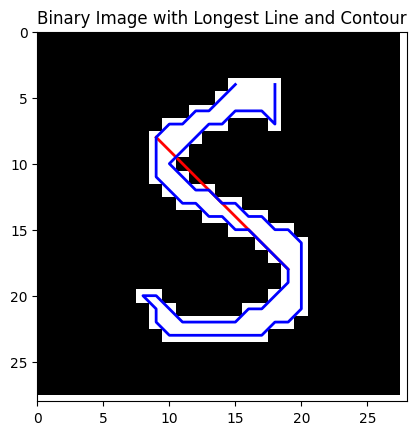

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9951


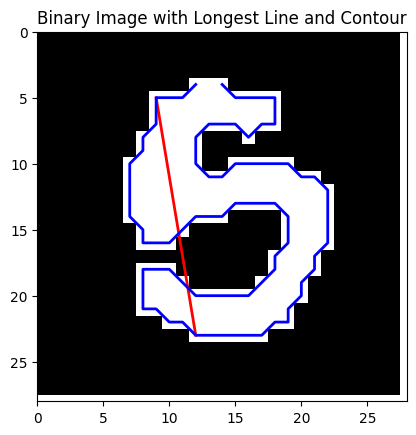

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


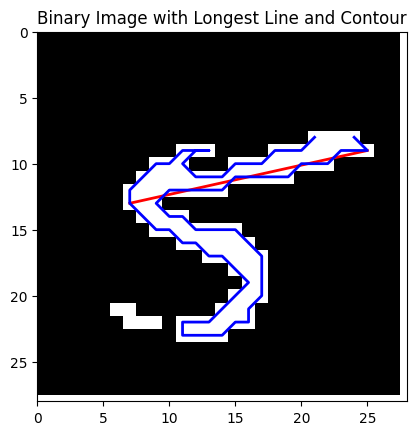

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9904


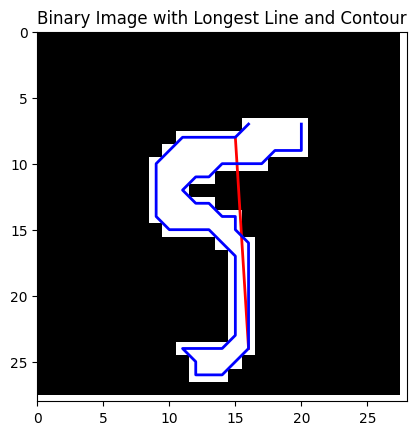

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9965


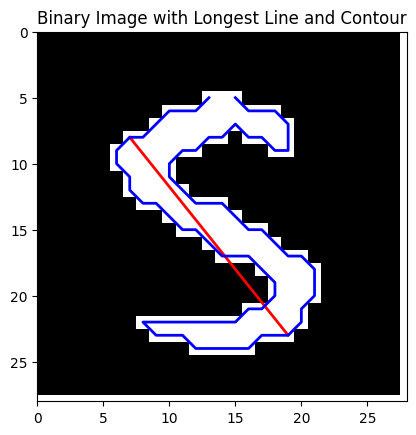

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9977


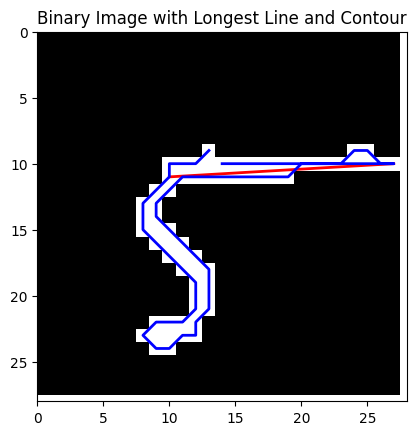

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9350


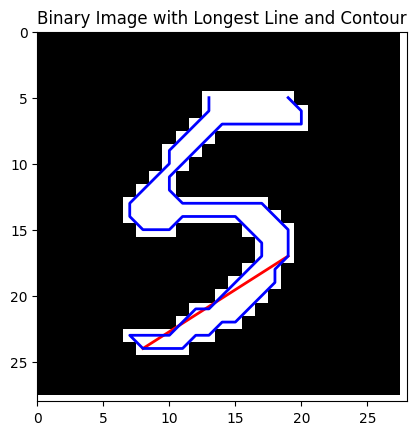

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9870


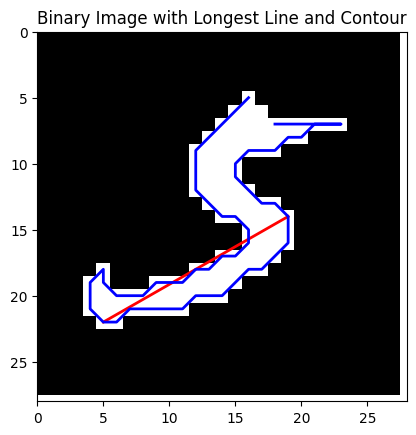

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9873


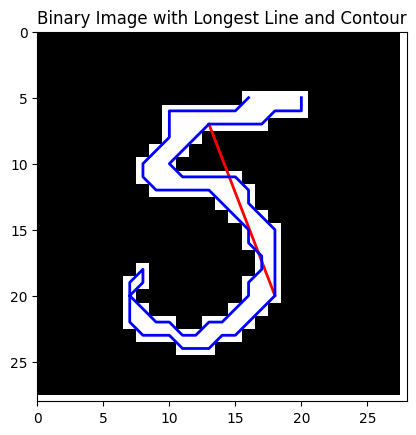

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


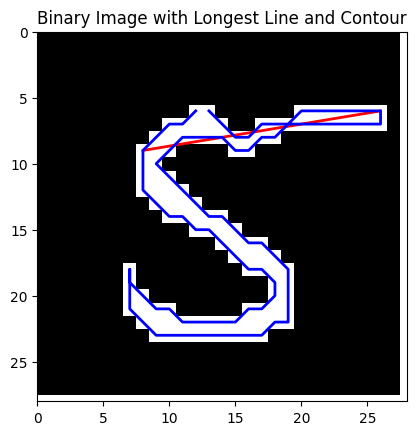

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


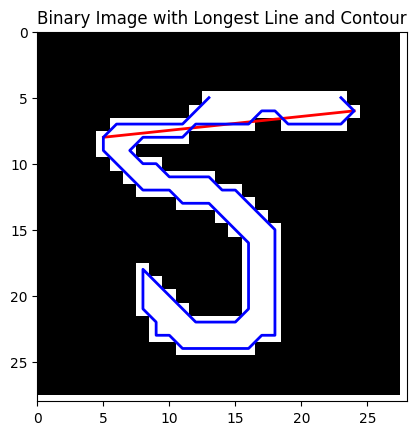

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


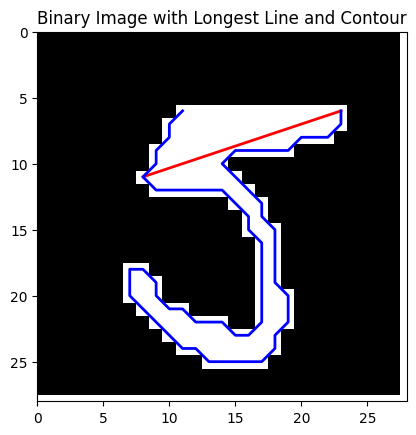

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


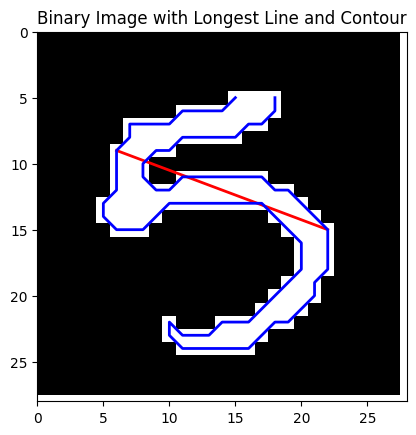

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


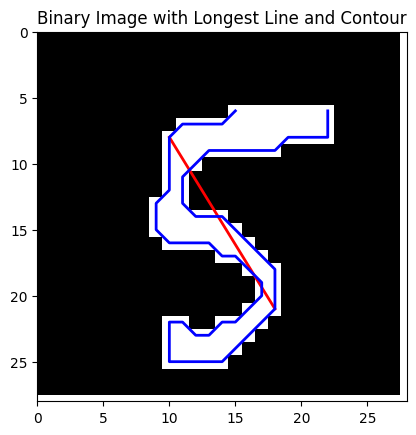

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


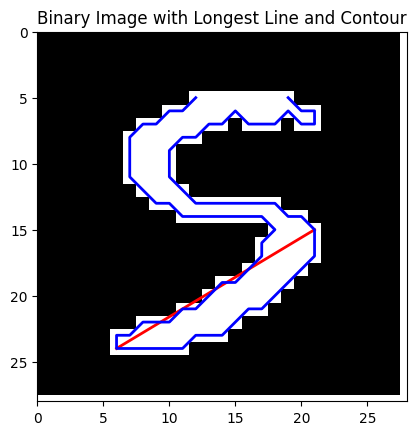

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9981


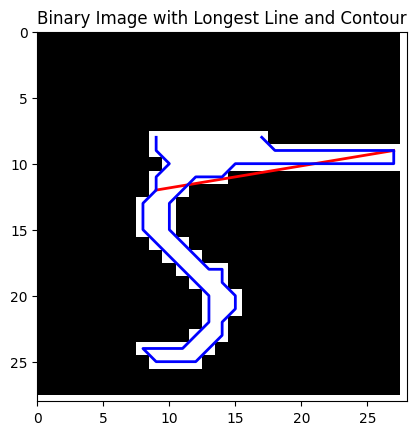

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


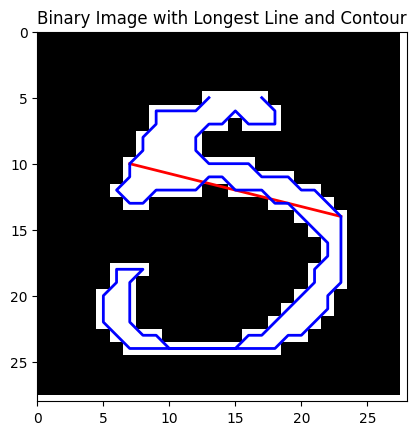

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9447


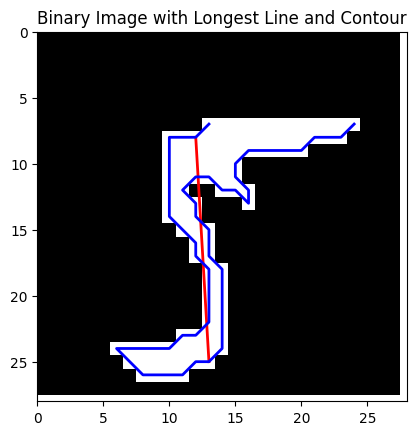

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9986


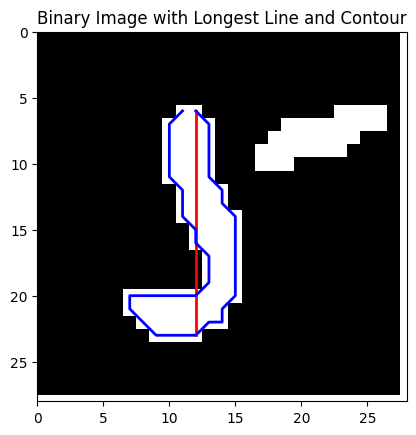

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


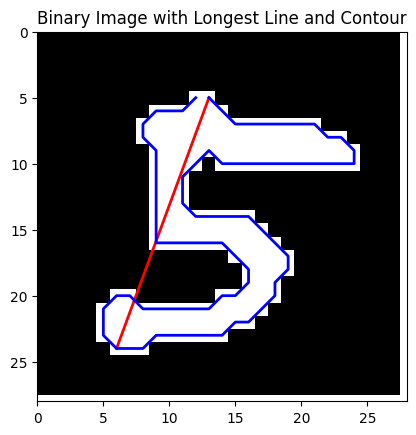

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


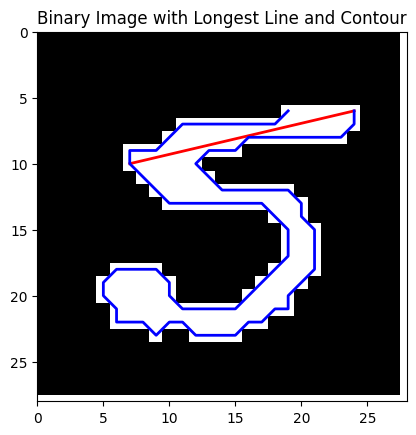

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9957


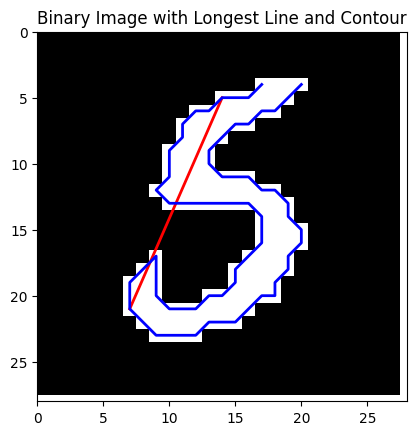

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


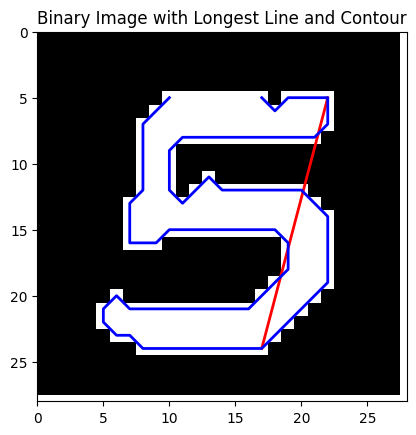

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


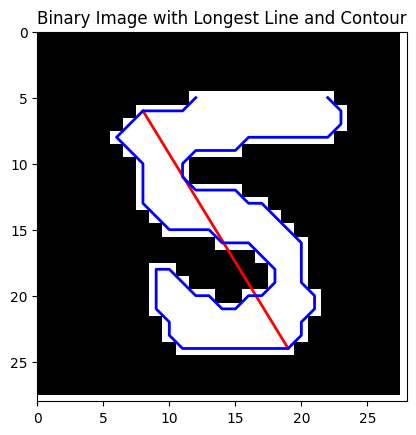

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


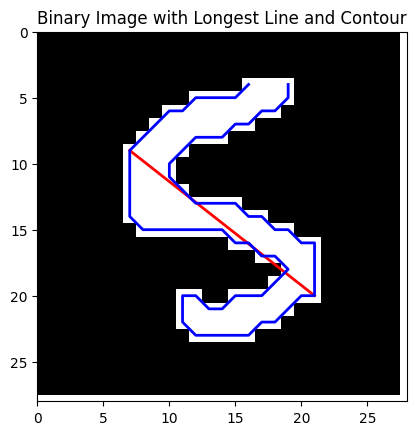

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


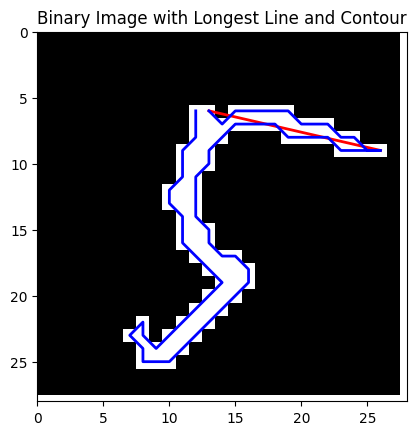

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9964


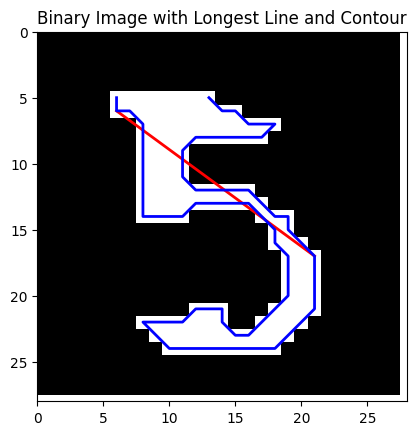

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


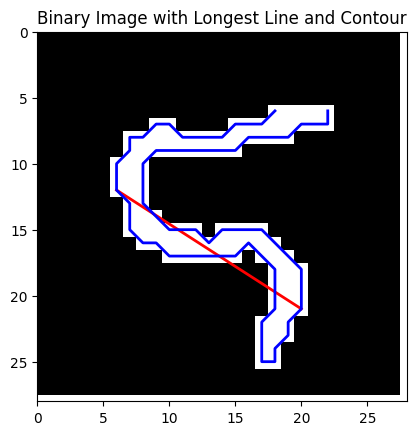

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9224


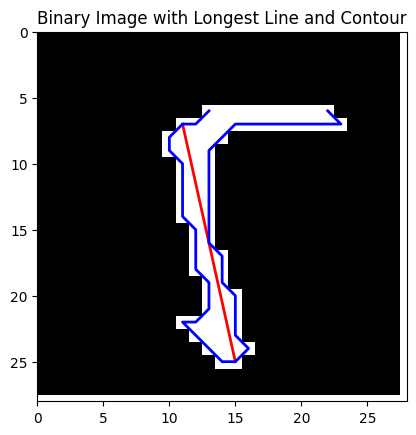

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


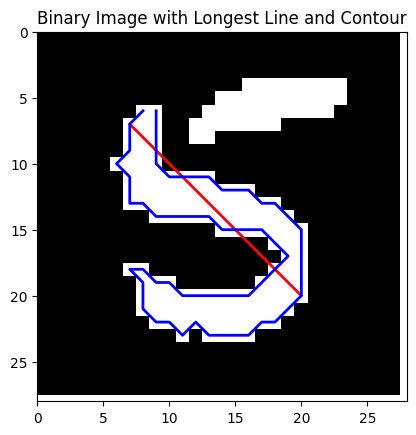

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


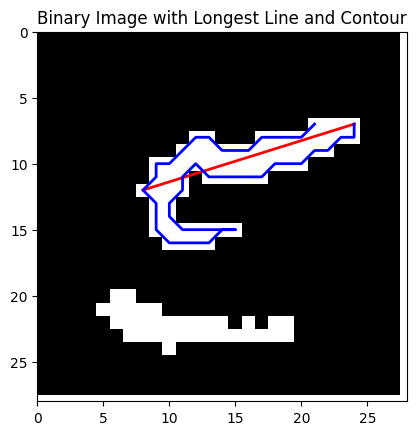

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9796


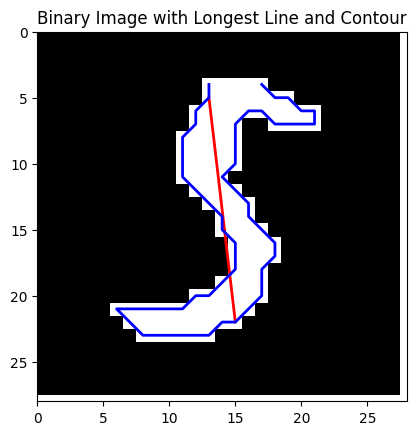

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


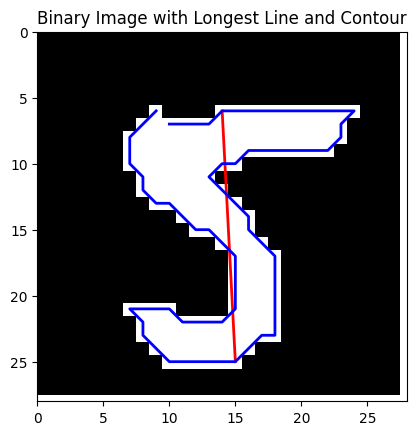

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


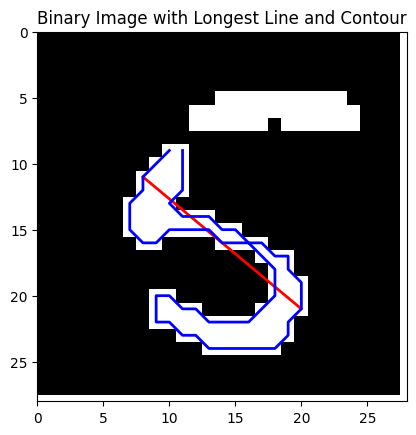

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


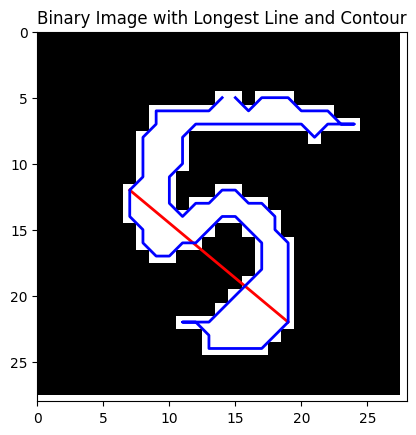

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


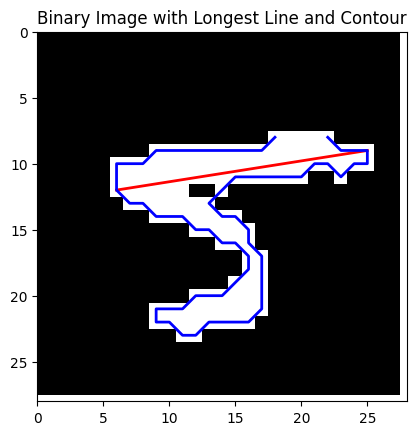

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9913


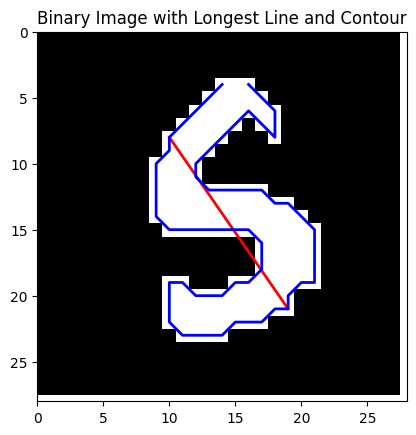

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9965


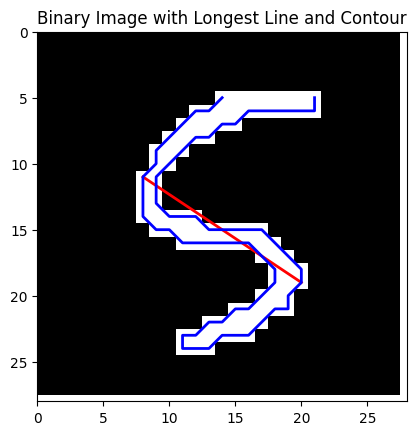

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


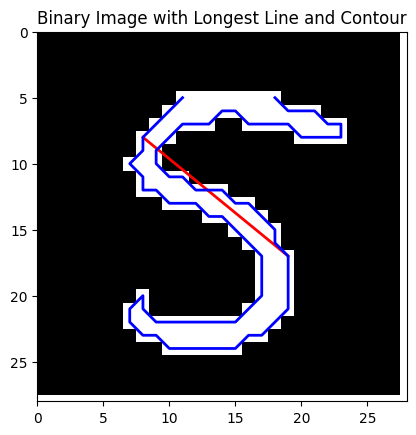

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9341


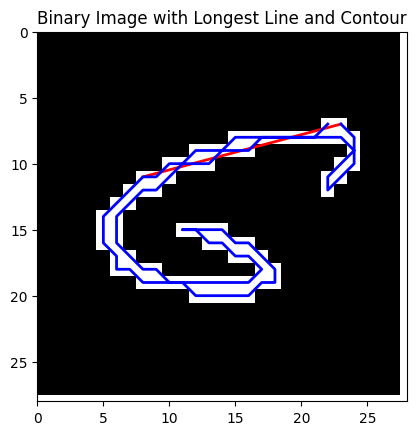

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9796


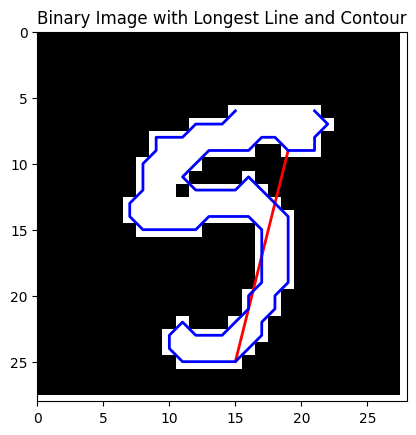

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


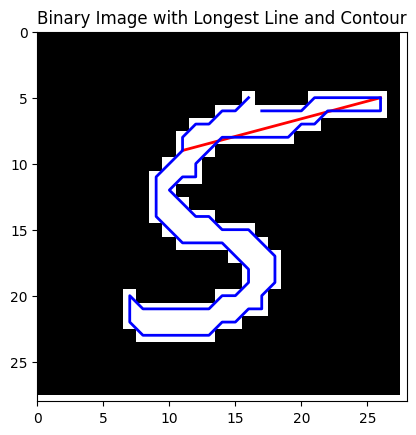

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9852


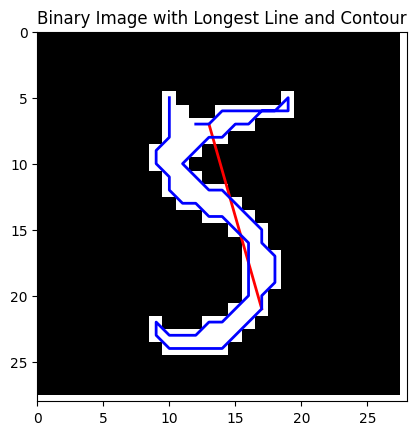

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


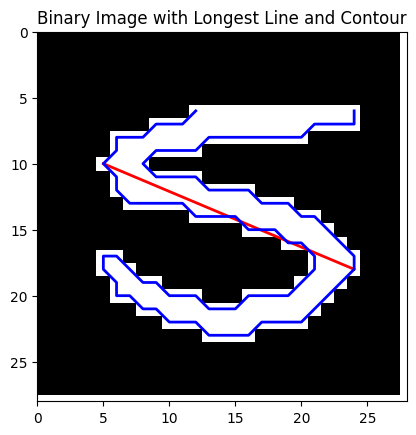

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


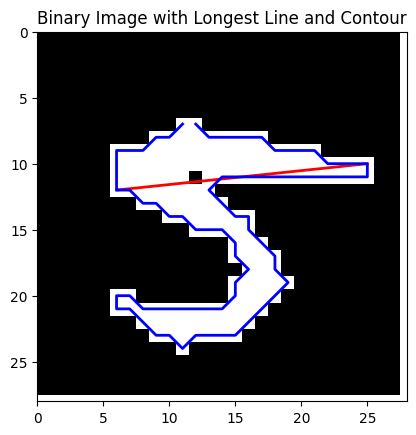

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9217


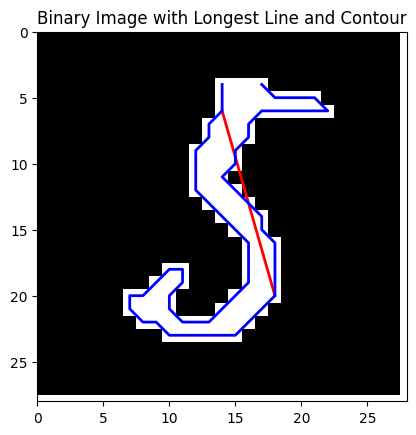

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


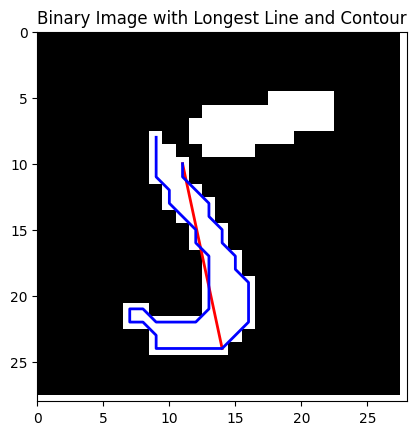

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9858


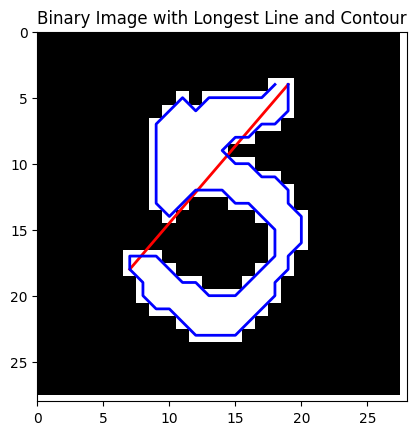

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


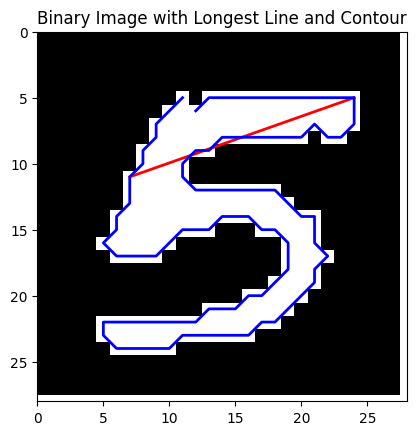

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


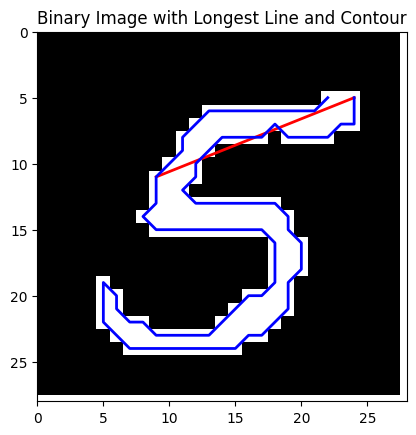

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9904


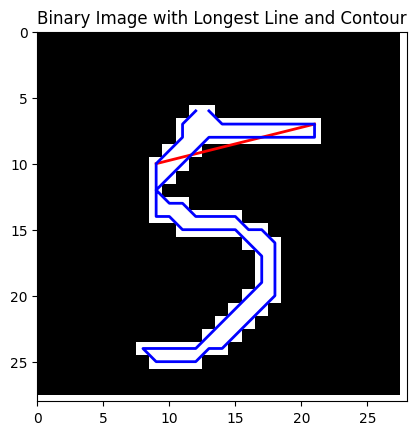

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


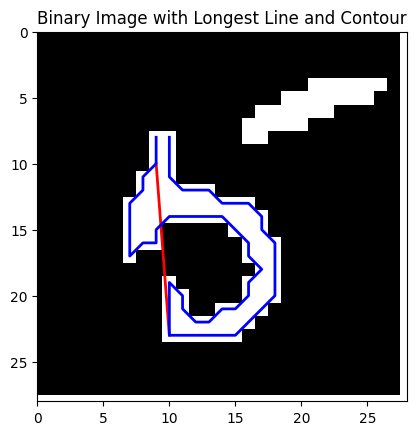

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


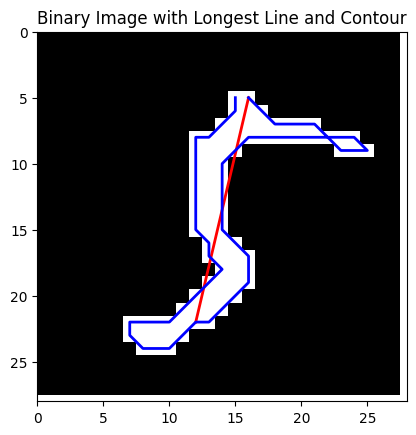

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9972


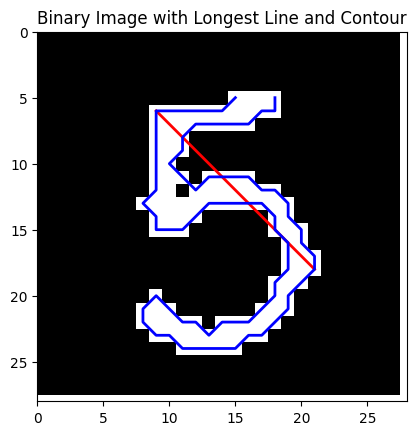

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9936


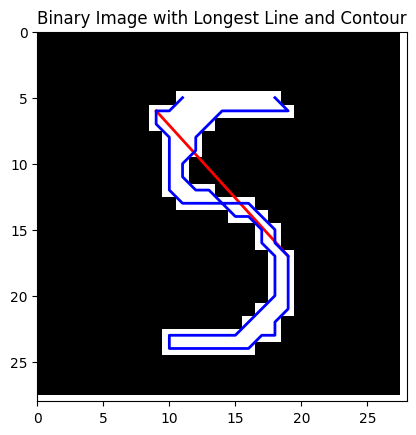

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


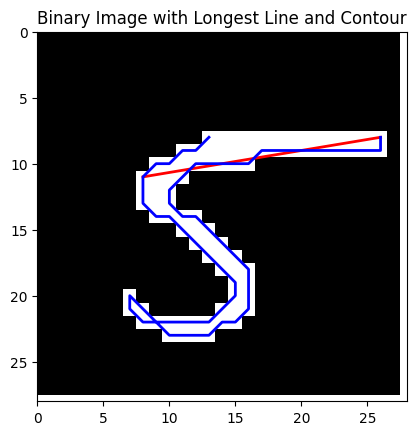

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9968


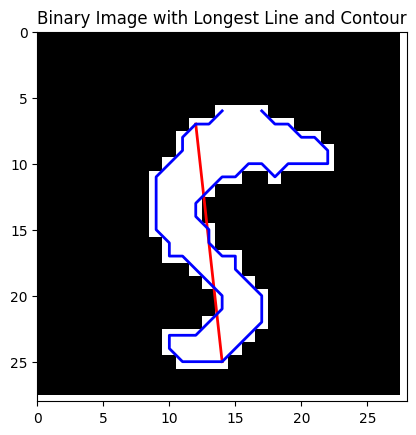

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


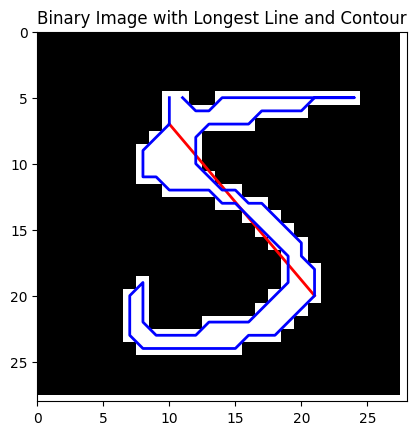

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


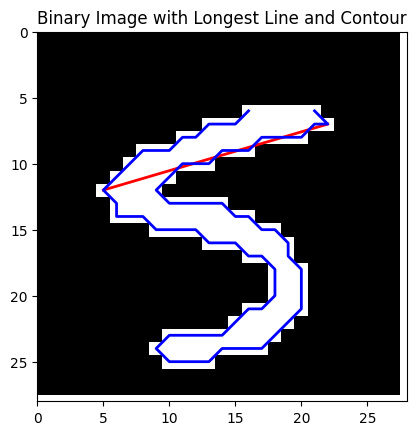

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


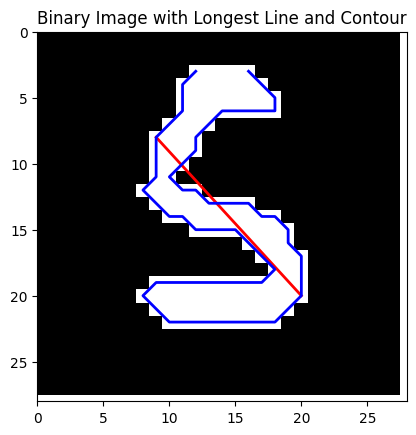

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


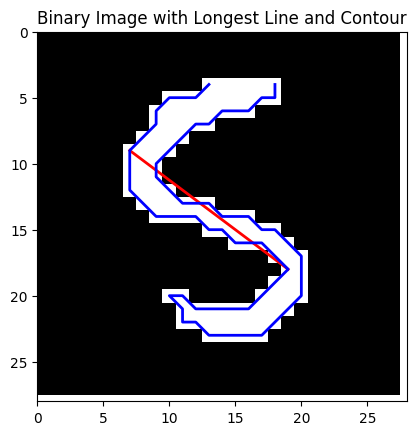

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9332


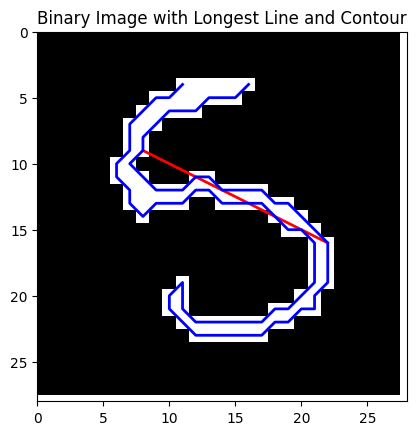

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.992     74     0.173       False             7.090   
1       0.991     94     0.136       False             7.649   
2       1.000     79     0.125       False             6.844   
3       0.993     81     0.126       False             6.369   
4       0.999     85     0.139       False             6.402   
..        ...    ...       ...         ...               ...   
95      0.999     88     0.153       False             7.618   
96      1.000     81     0.171       False             6.619   
97      0.999     71     0.167       False             6.450   
98      0.999     72     0.136       False             6.759   
99      0.933     87     0.121       False             7.245   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               5.806  1.750 -16.000      39     97               16.125   
1               6.105  1.667  -3.667      82     25               17.493   
2  

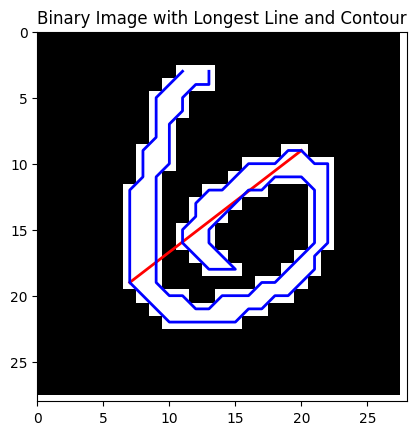

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9961


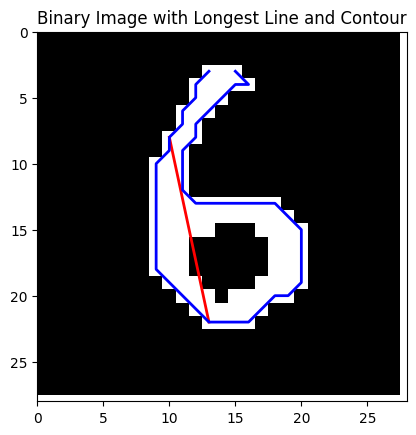

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9977


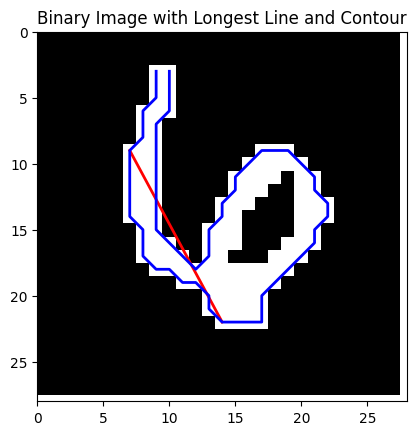

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


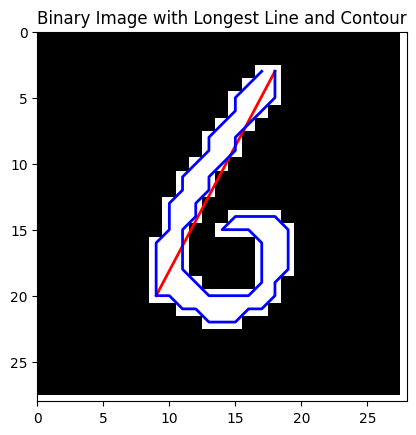

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


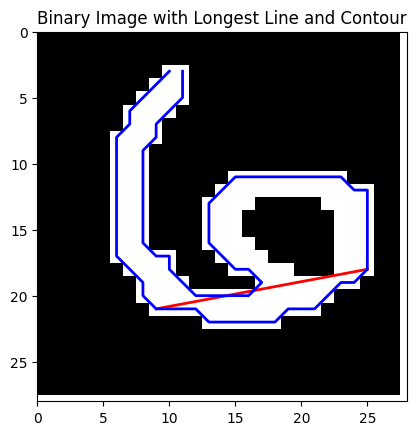

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9331


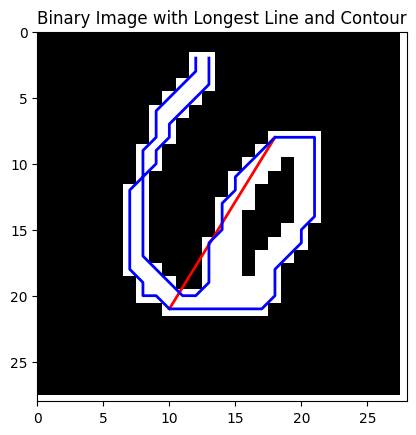

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


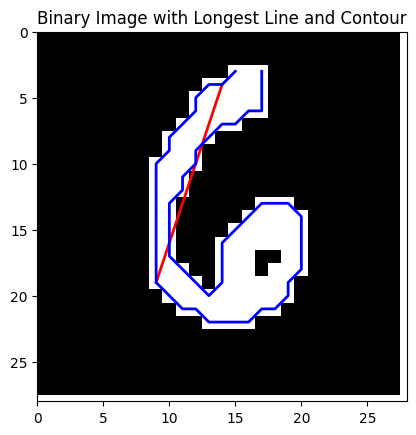

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


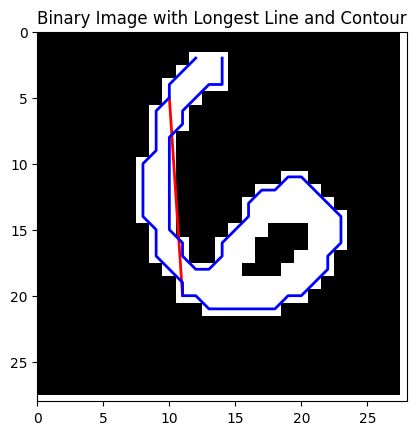

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


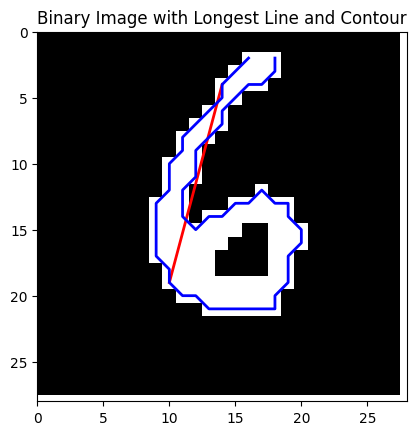

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9935


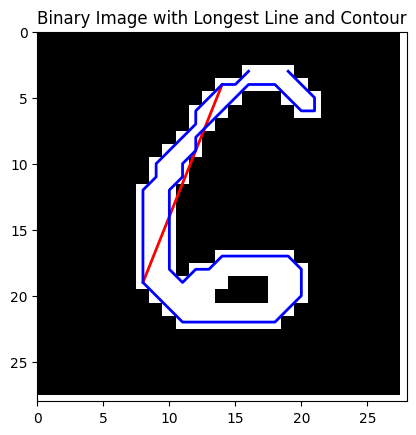

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


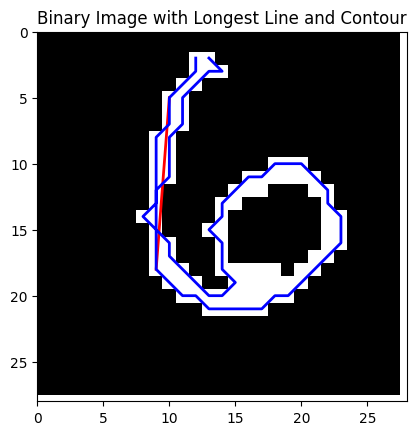

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


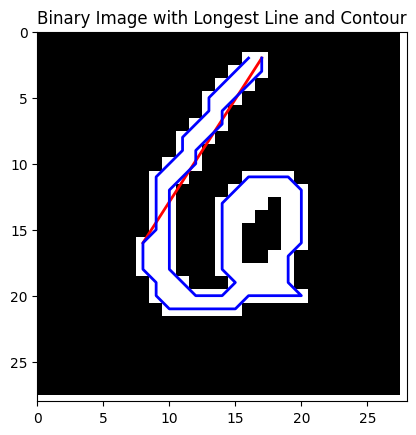

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


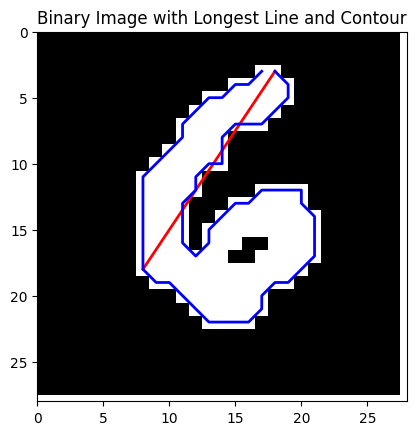

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


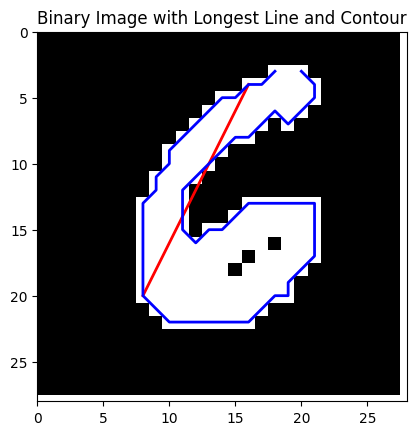

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


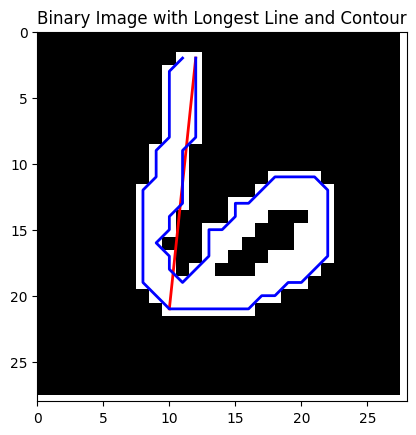

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9989


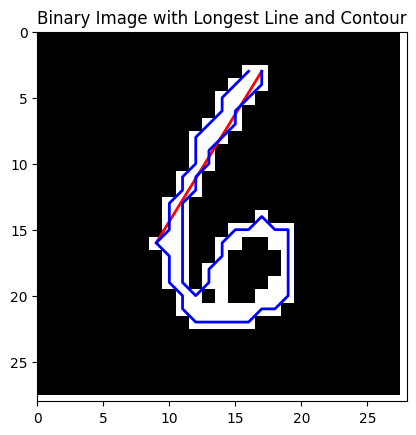

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


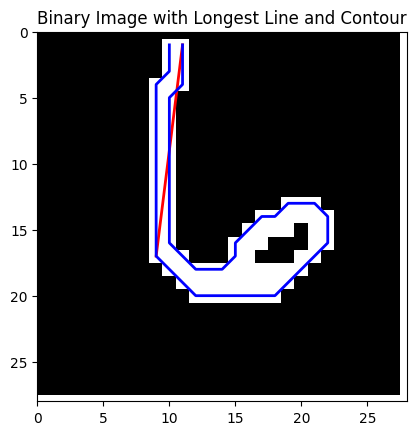

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


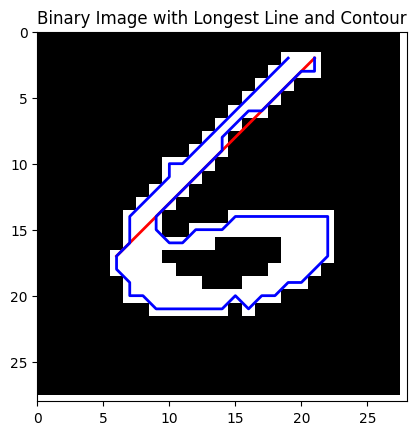

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


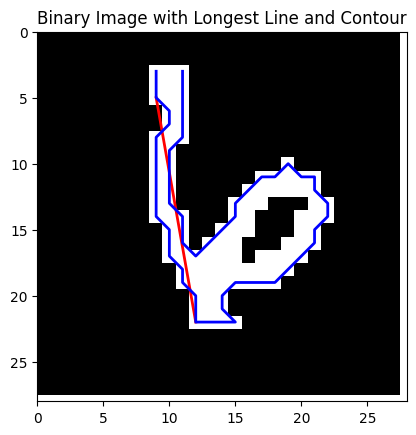

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


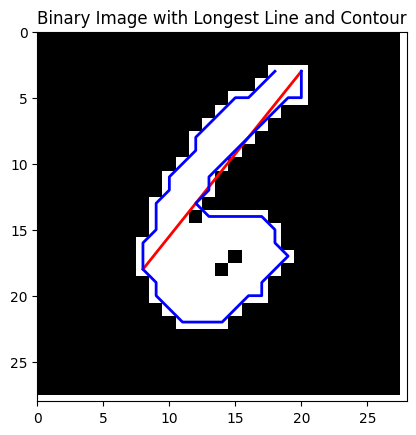

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


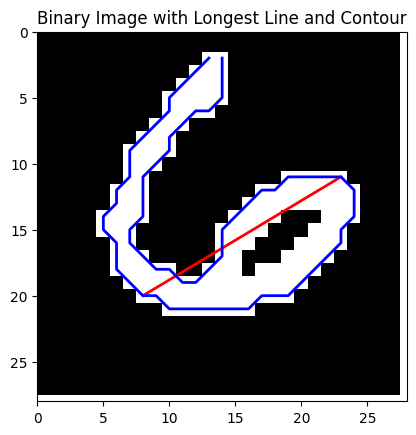

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9934


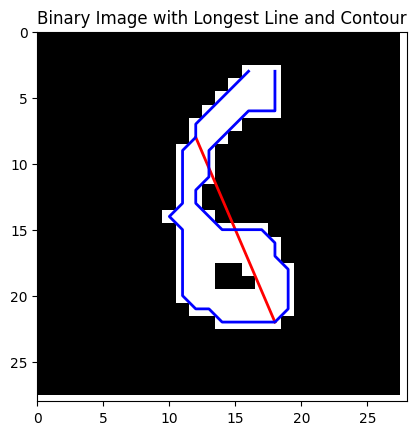

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


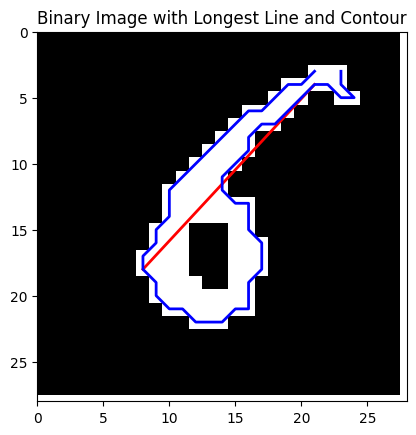

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9486


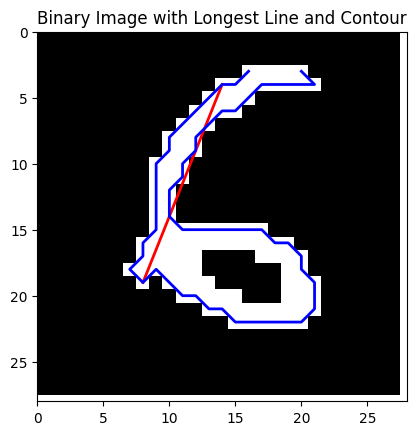

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9576


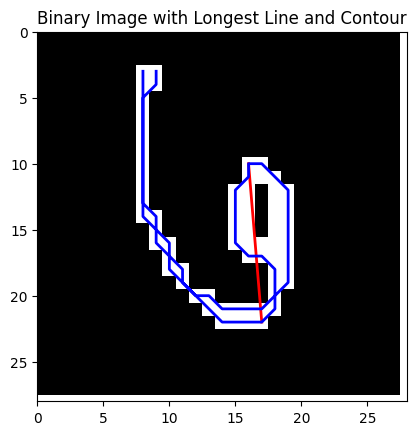

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9944


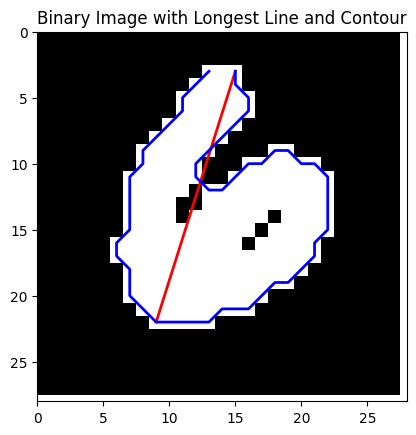

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


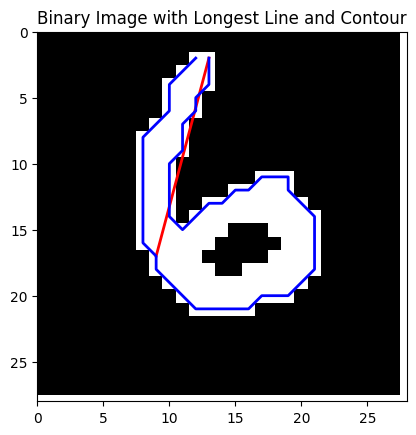

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9951


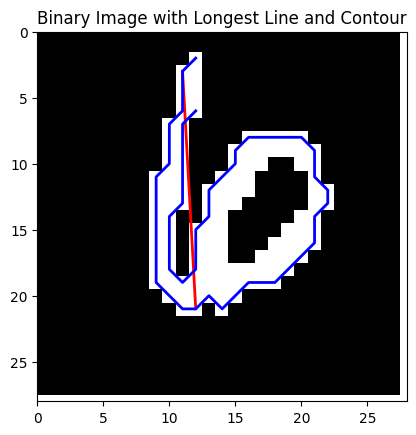

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9893


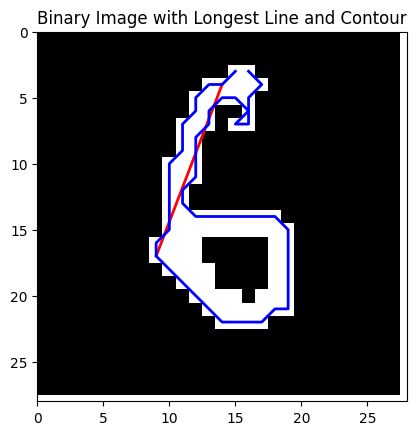

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


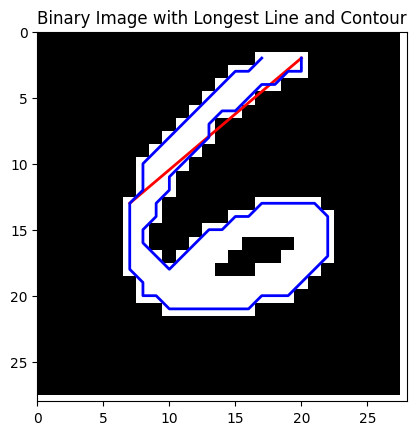

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9680


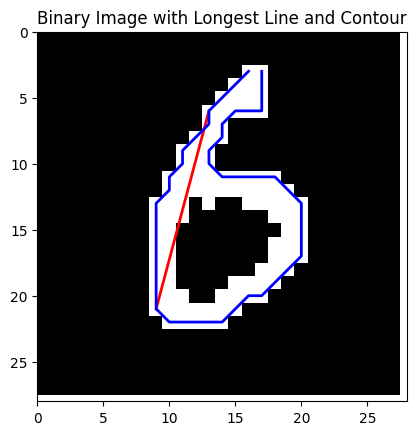

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


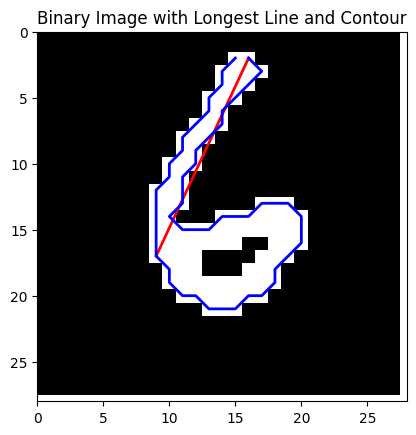

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9944


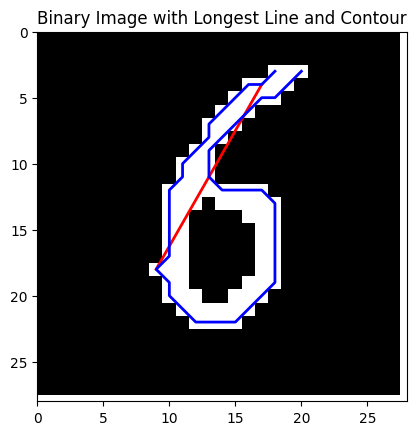

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9734


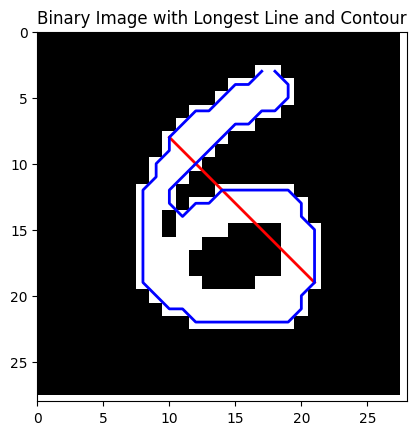

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9759


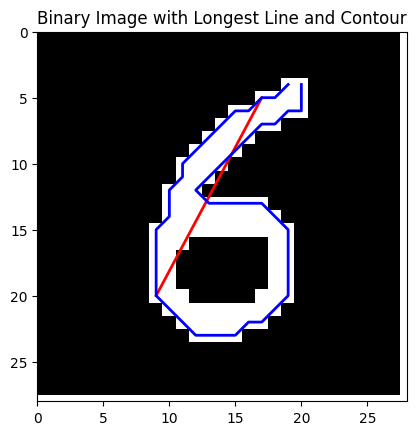

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


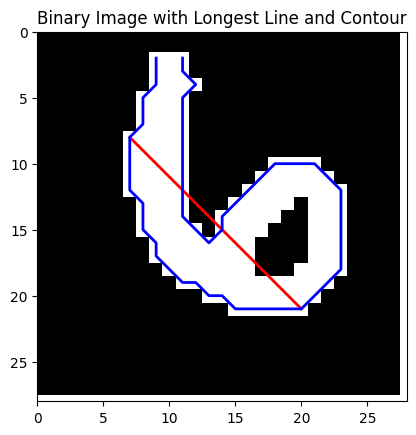

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9744


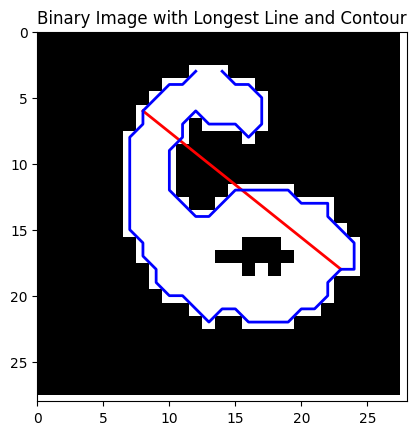

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


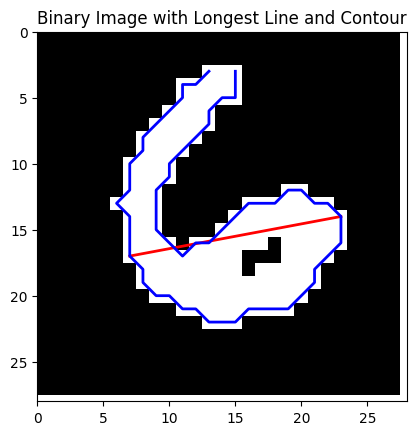

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


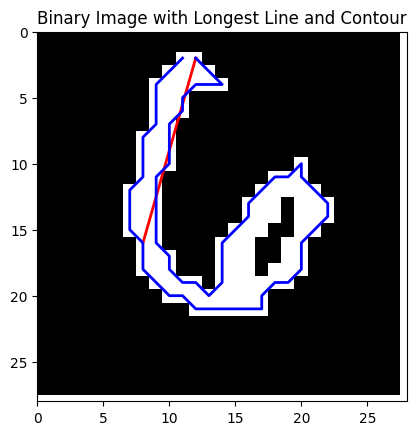

Prediction probability for digit 9: 0.9858


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


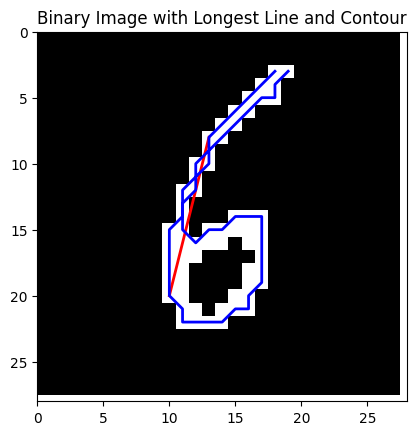

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9893


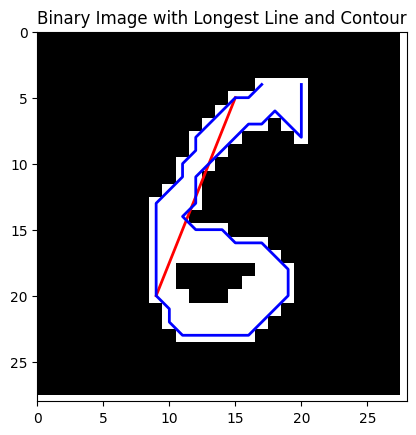

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


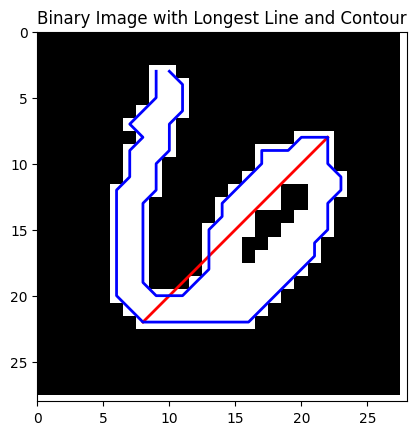

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


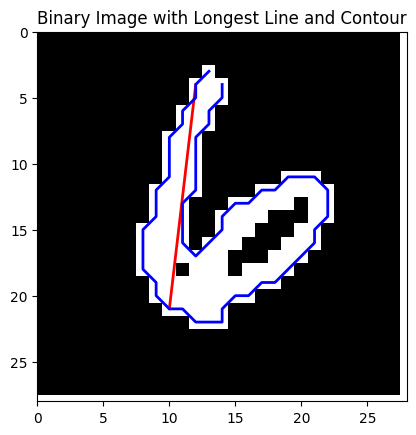

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


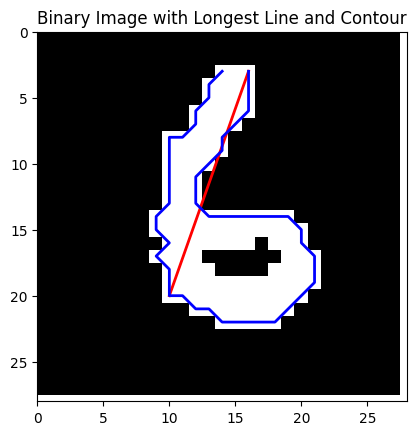

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


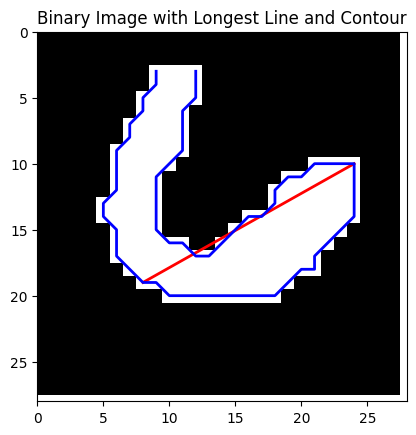

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9866


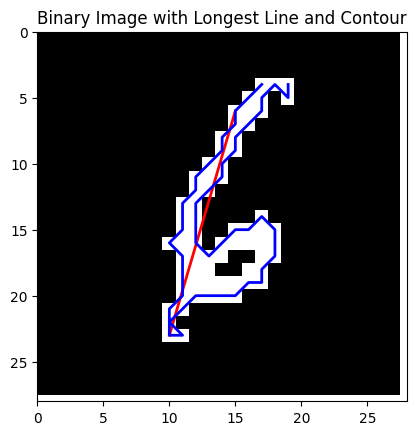

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9259


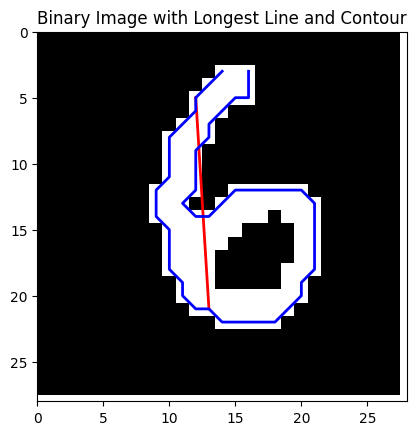

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


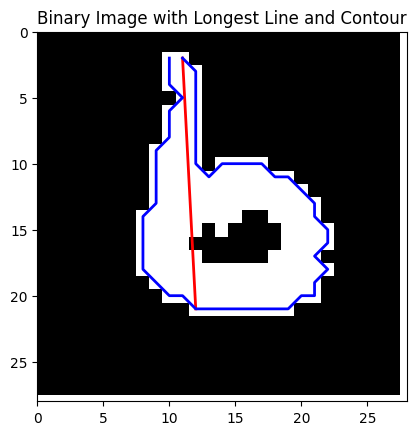

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


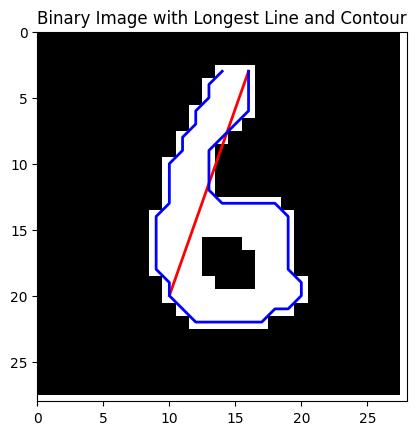

Prediction probability for digit 9: 0.9979


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


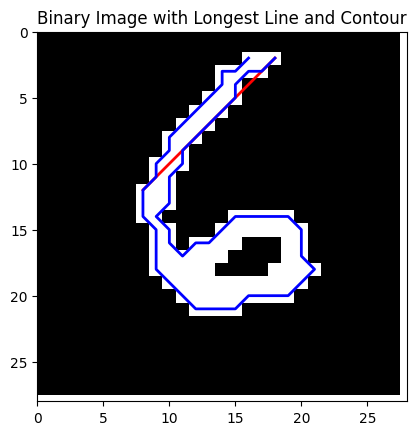

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


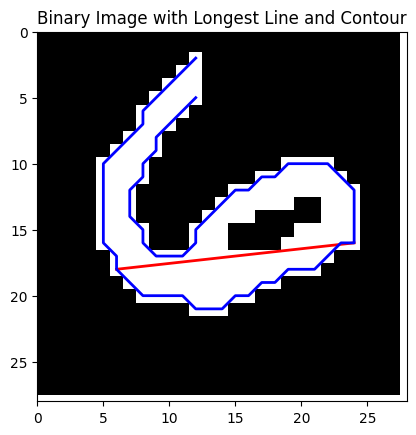

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


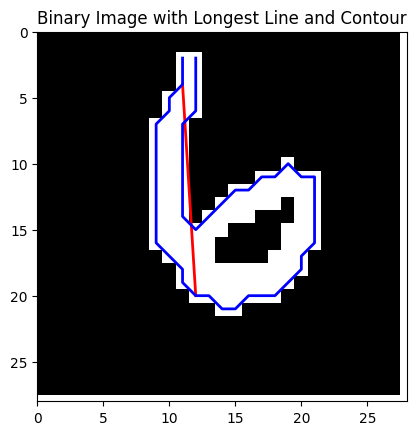

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


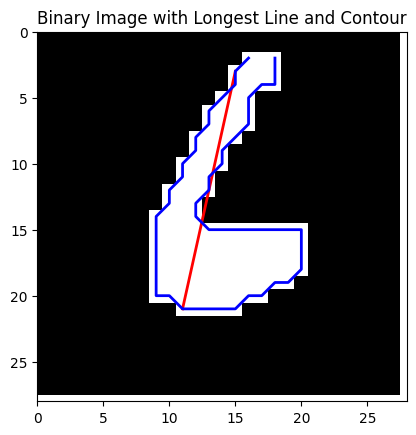

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9731


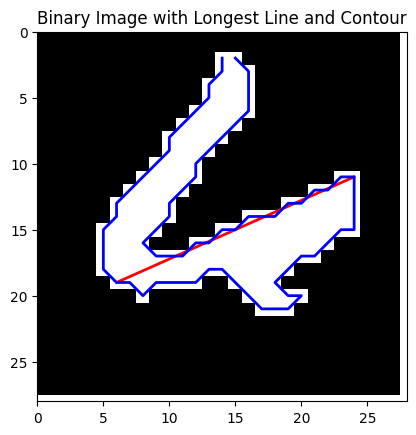

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9843


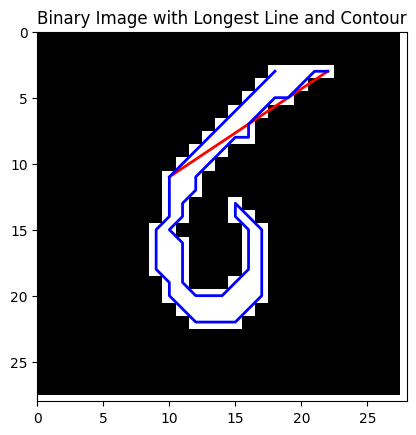

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


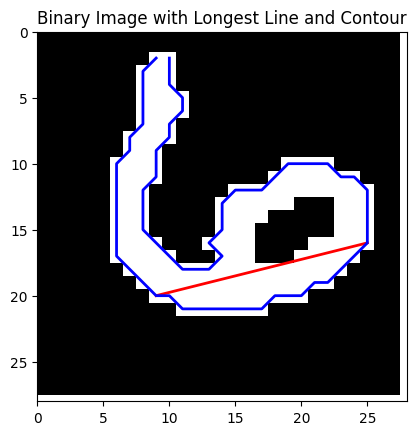

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


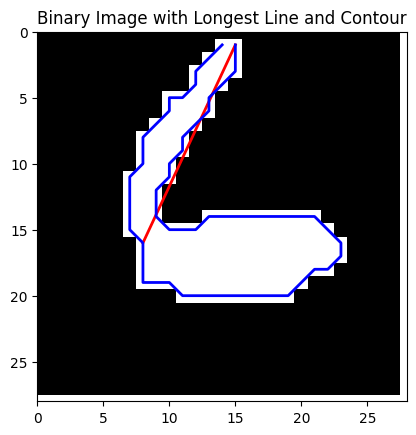

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


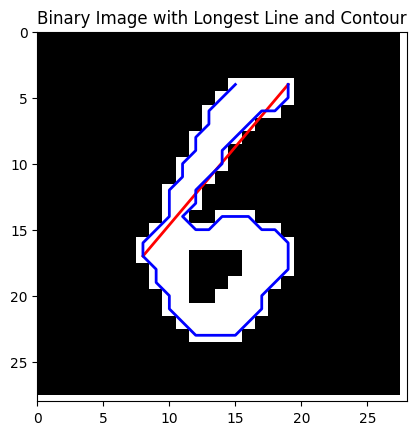

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


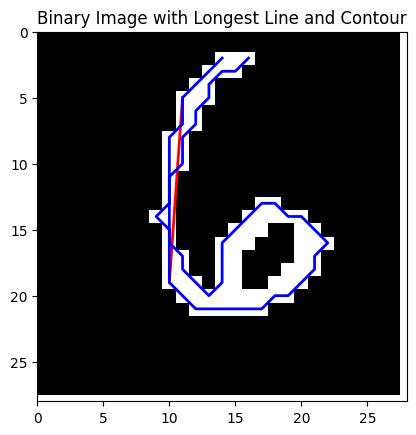

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9986


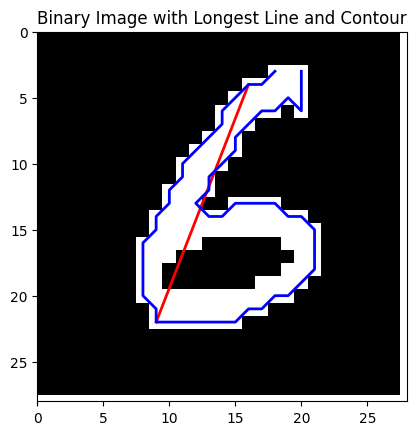

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


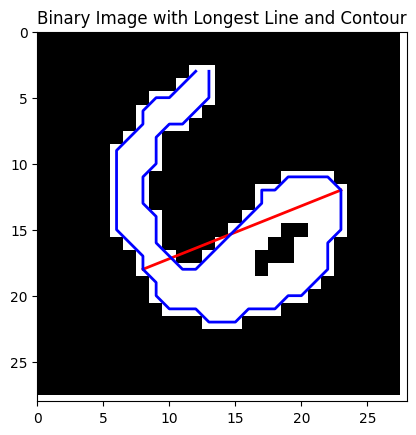

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9963


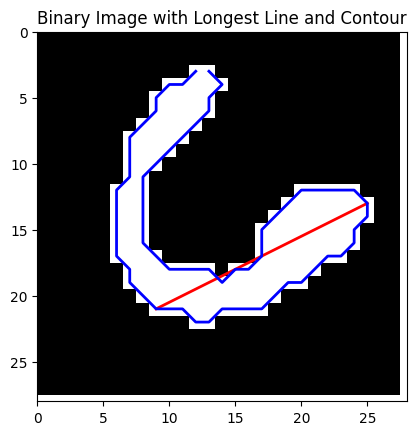

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


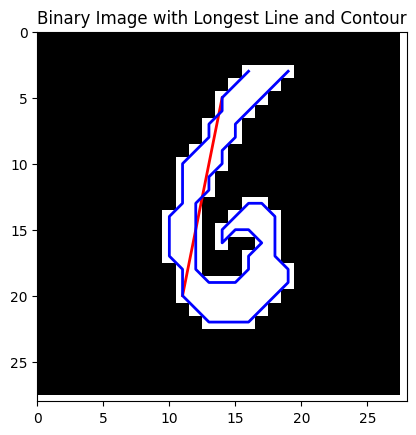

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9981


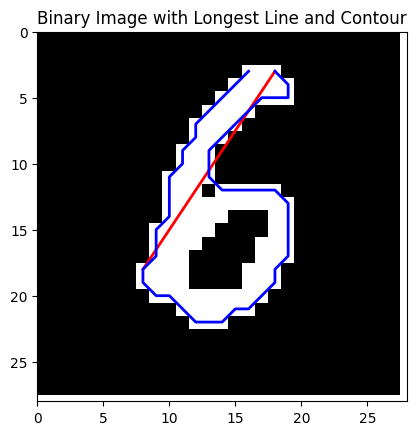

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


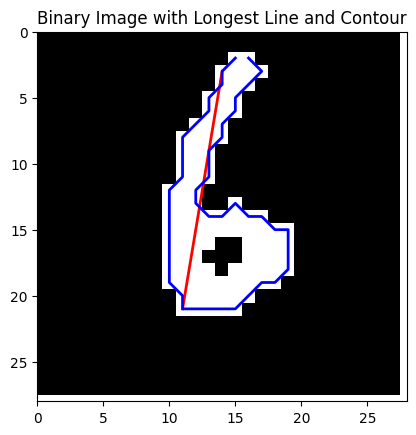

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9905


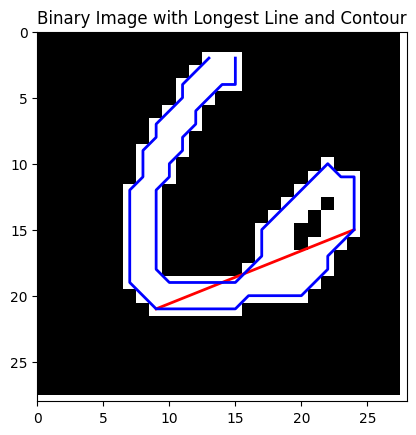

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


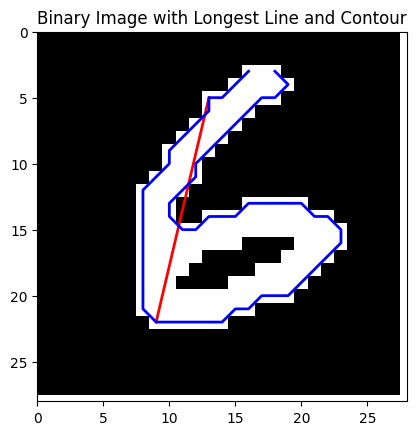

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9874


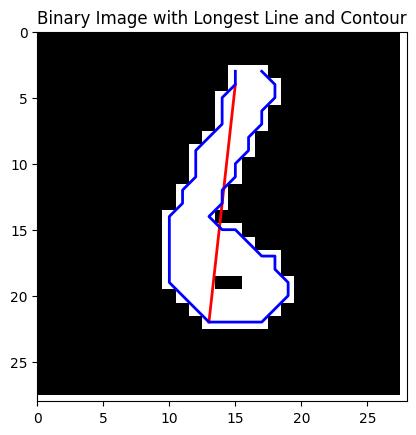

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


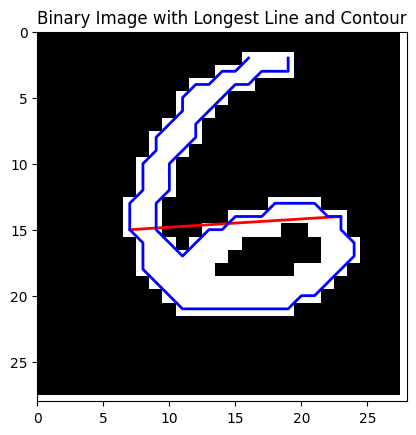

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


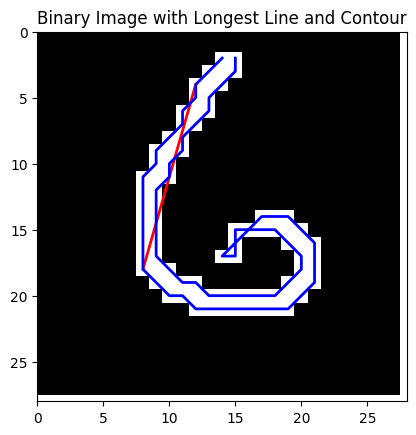

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9935


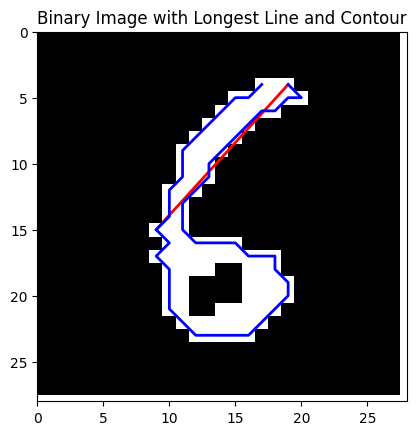

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9588


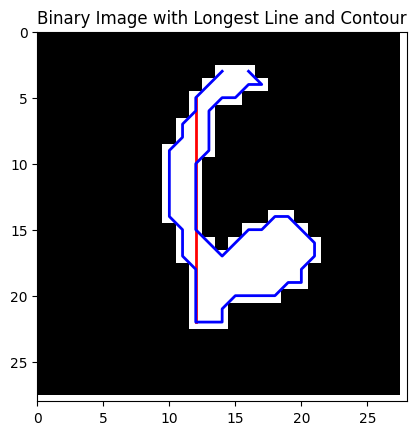

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


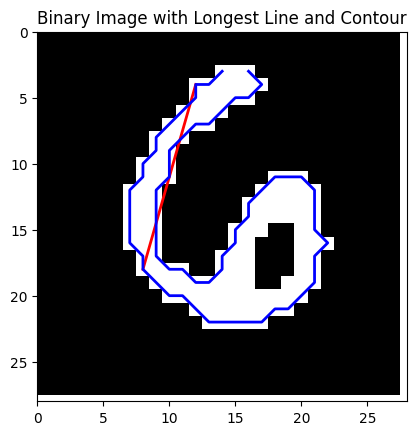

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


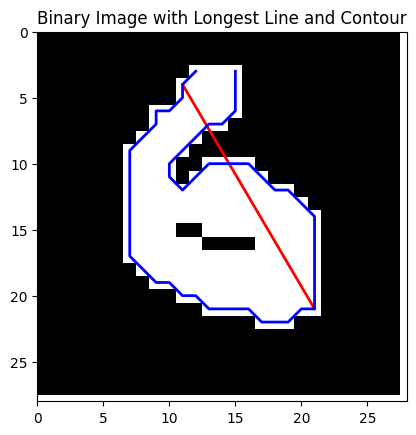

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


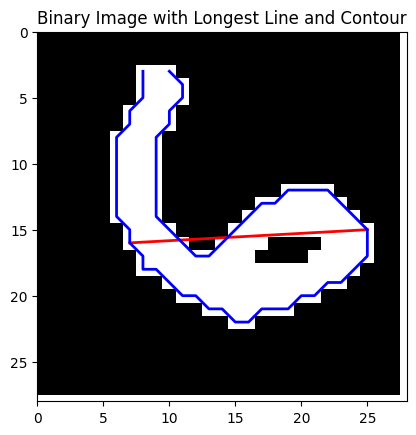

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


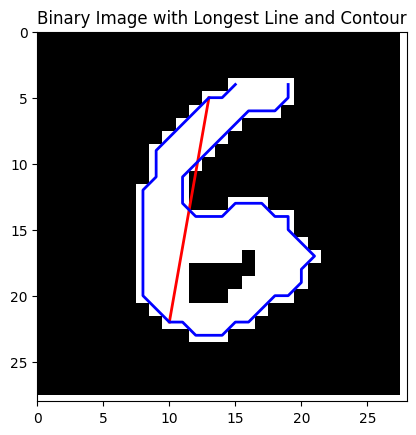

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


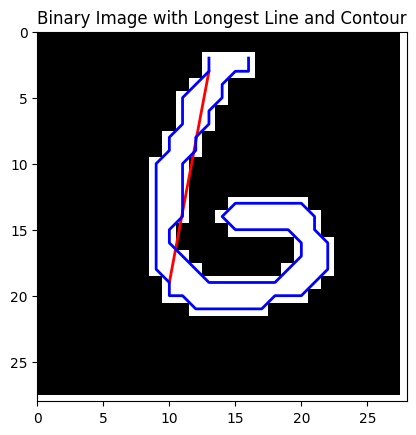

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


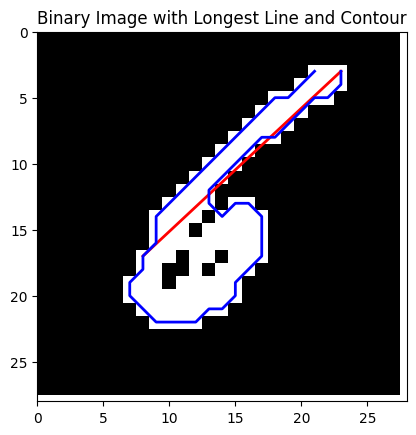

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9636


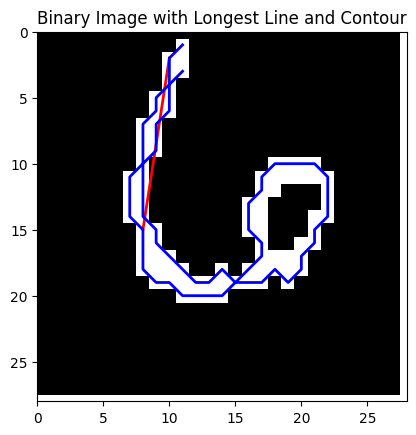

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


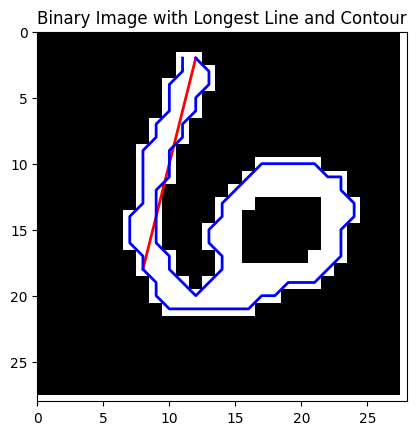

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


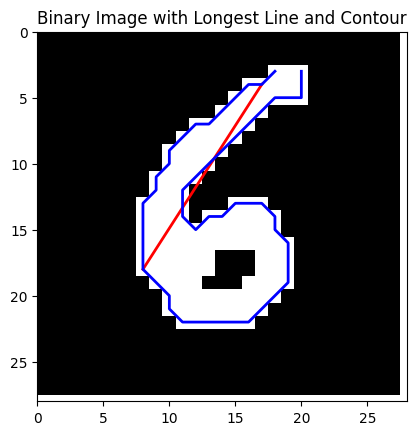

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9980


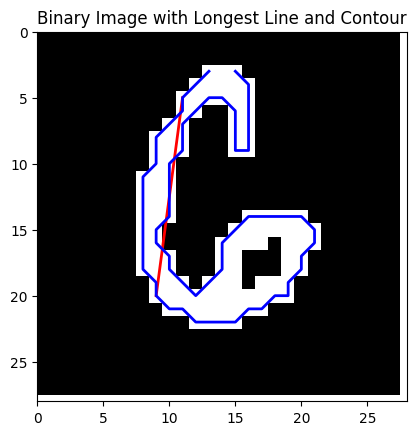

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


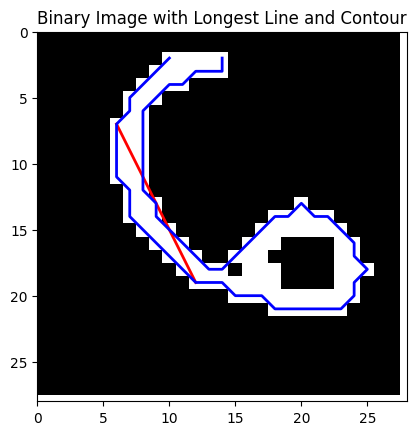

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


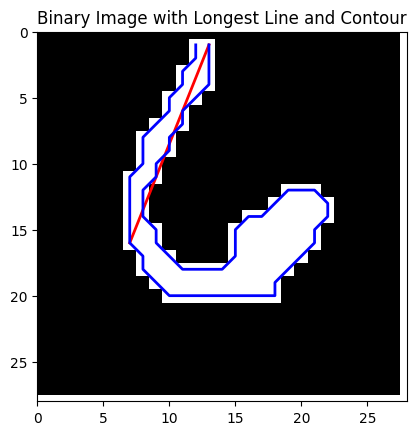

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


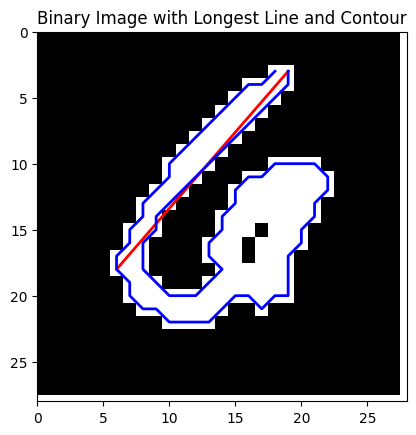

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9883


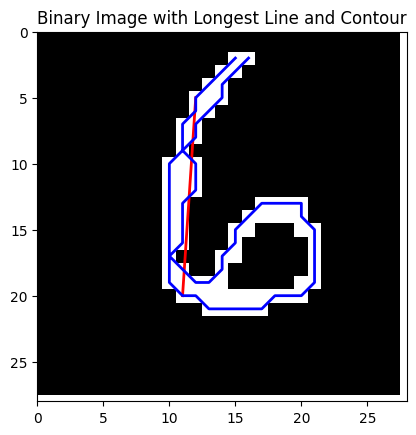

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9939


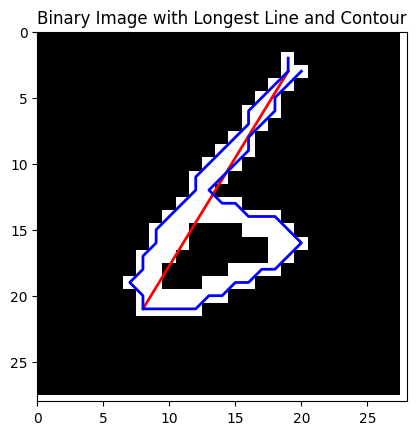

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


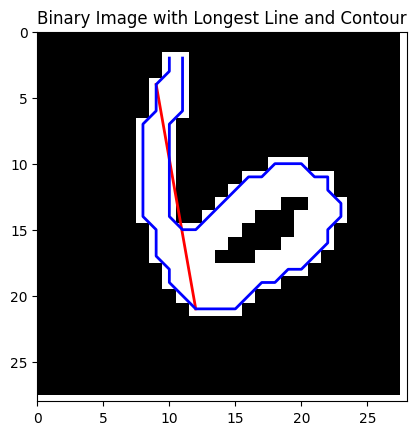

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9910


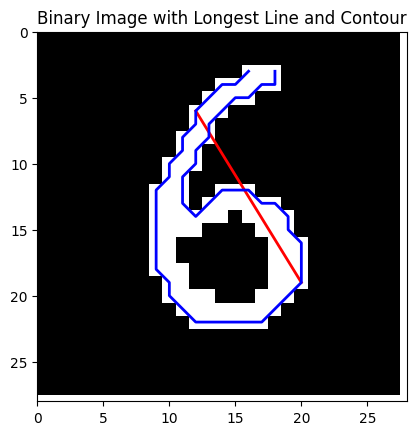

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


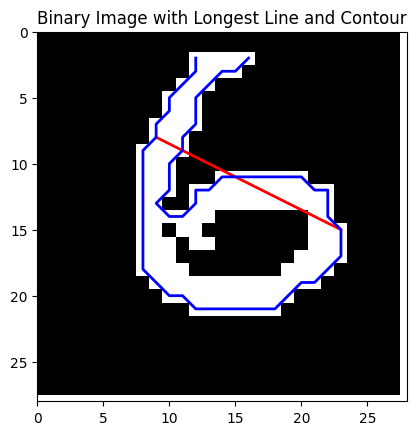

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9960


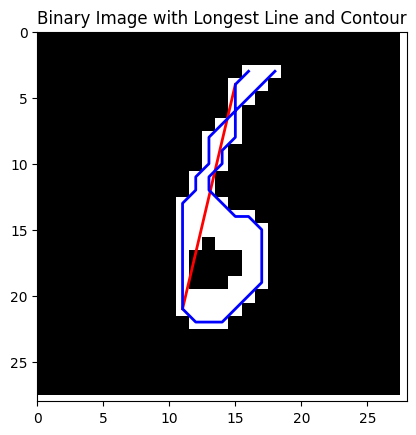

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9912


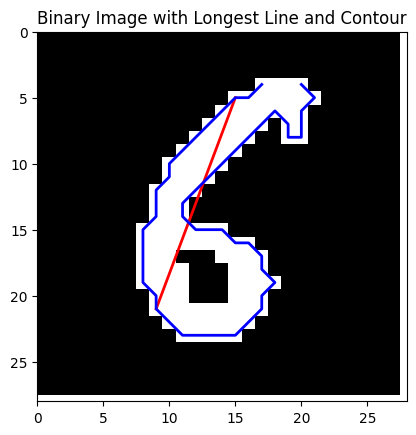

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


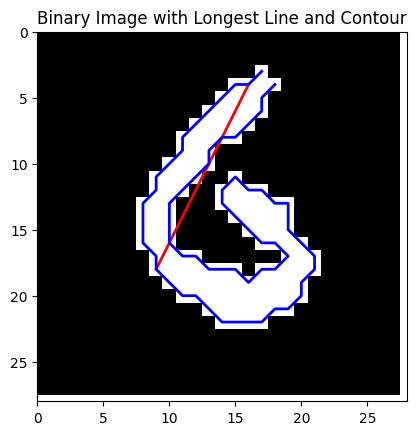

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


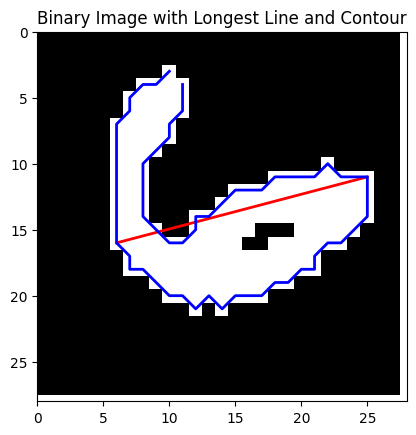

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


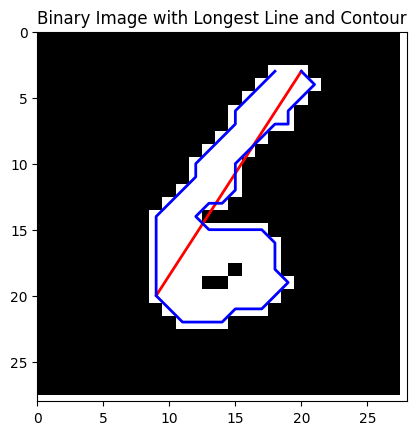

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


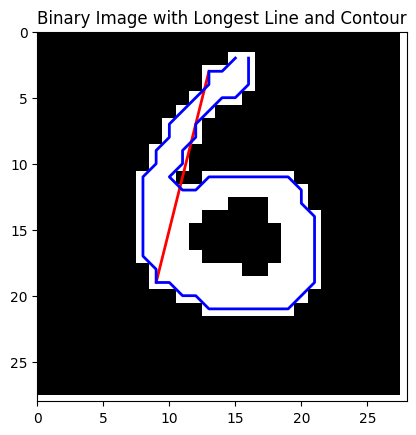

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9888


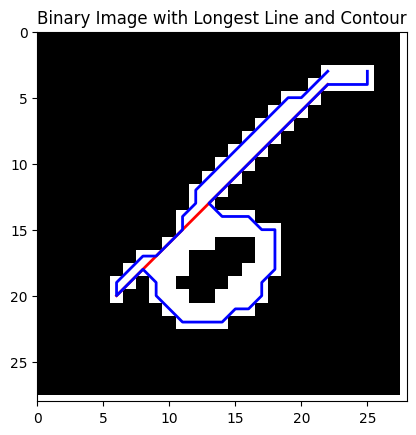

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9914


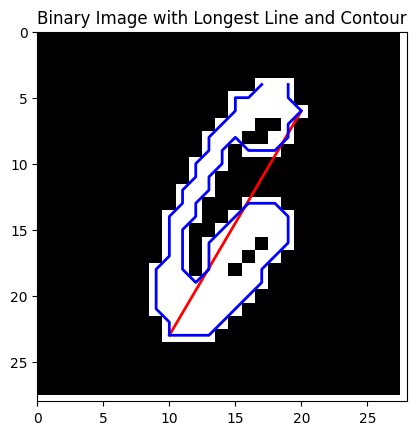

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


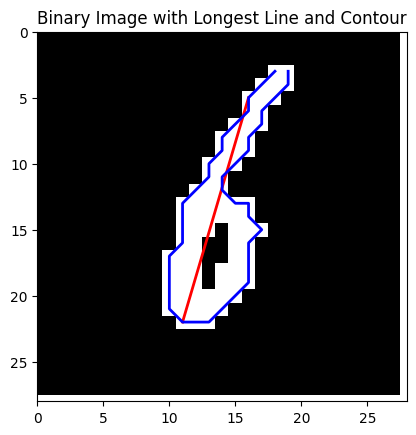

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


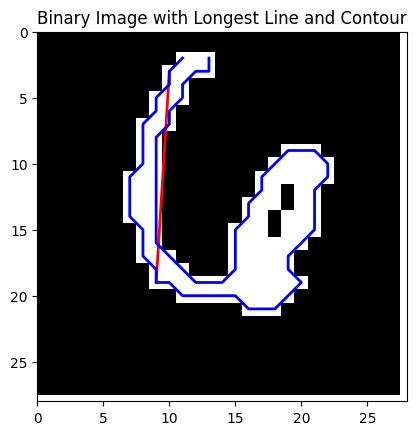

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.999    101     0.171       False             6.421   
1       0.996     69     0.131       False             5.736   
2       0.998     82     0.152       False             5.986   
3       0.998     64     0.117       False             5.699   
4       1.000    104     0.207       False             7.170   
..        ...    ...       ...         ...               ...   
95      1.000     78     0.171       False             6.050   
96      0.989     73     0.121       False             6.302   
97      0.991     74     0.143       False             5.662   
98      0.997     54     0.102       False             5.111   
99      0.995     82     0.152       False             6.498   

    variance_distance      k        b right_1 left_1  longest_line_length  \
0               5.804 -1.300   31.700      69     65               16.401   
1               6.015  0.214    8.286      24     79               14.318   


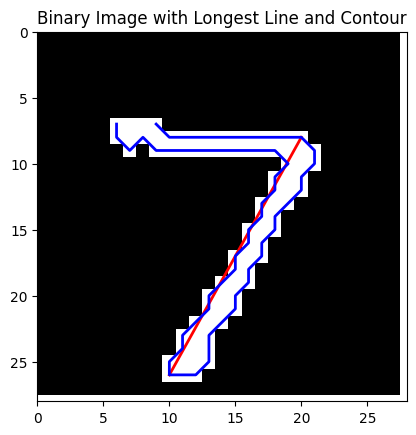

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


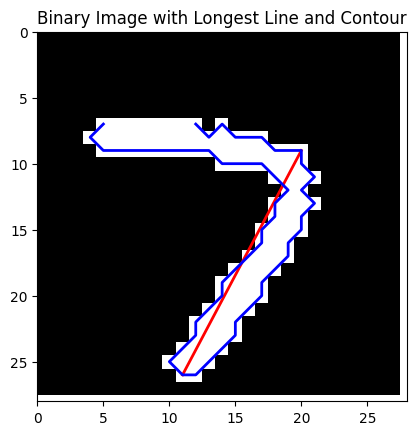

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


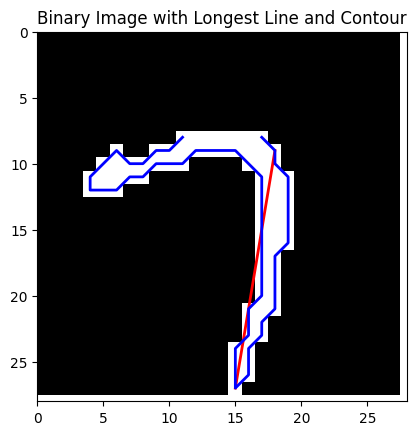

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


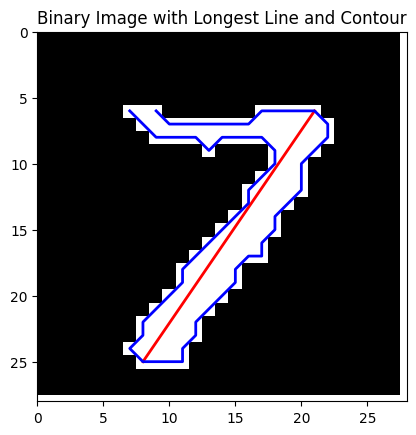

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


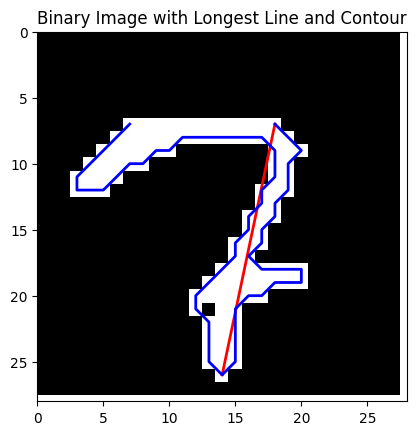

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


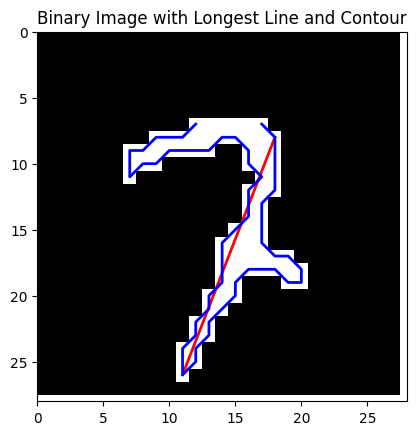

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


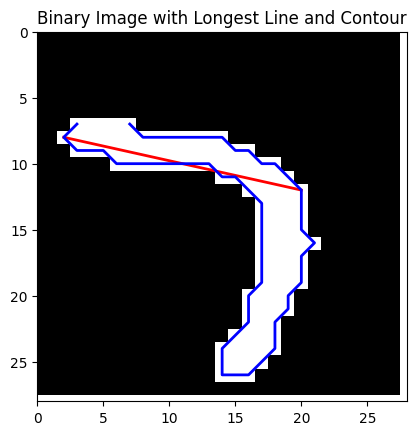

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


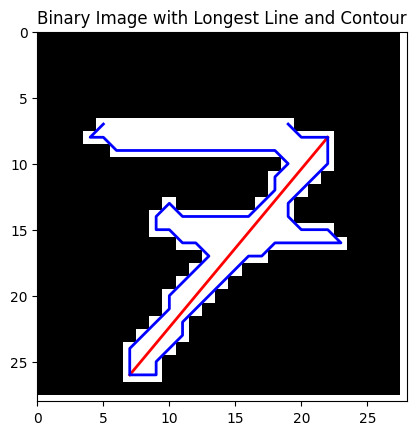

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


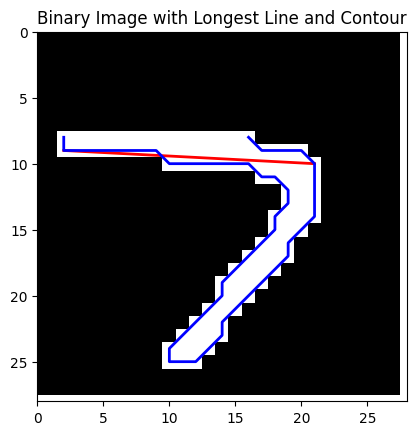

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


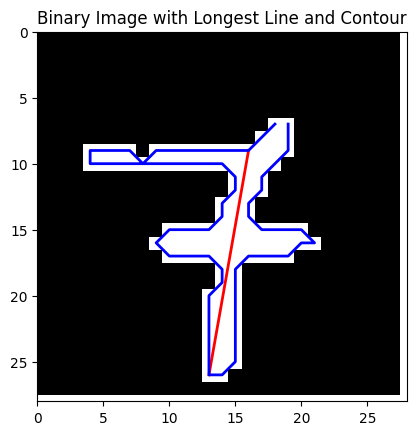

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


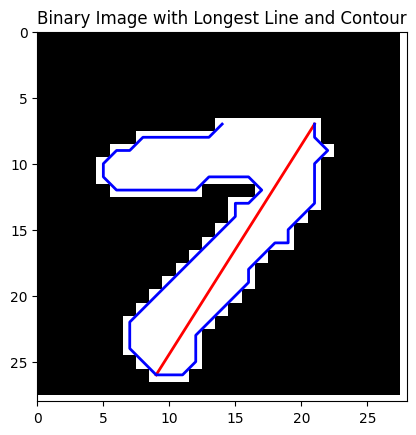

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9824


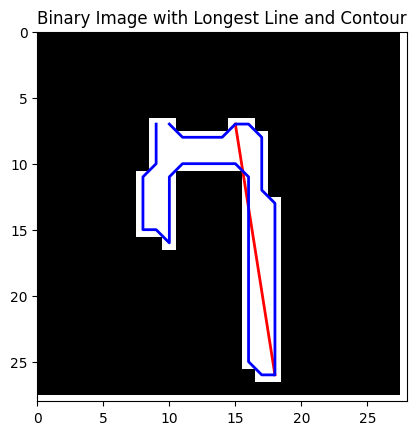

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


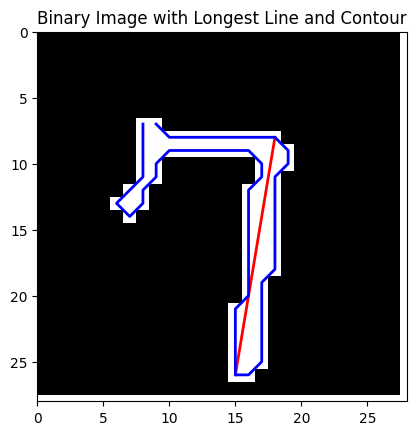

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


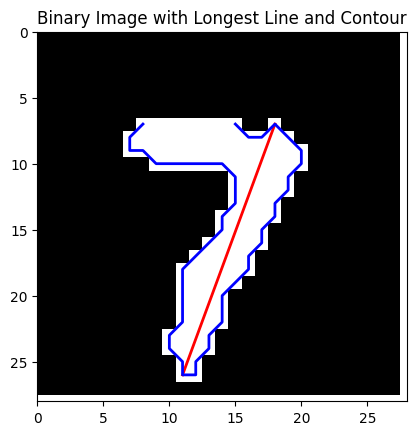

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


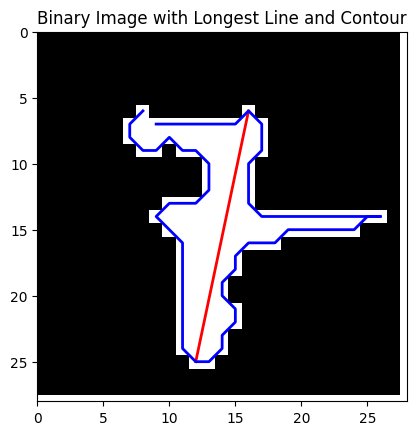

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


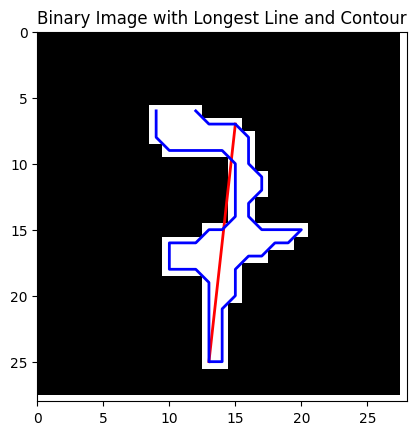

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


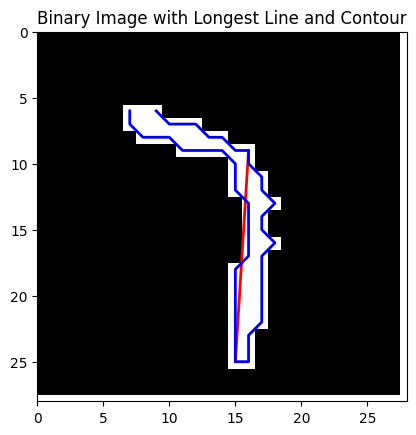

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9768


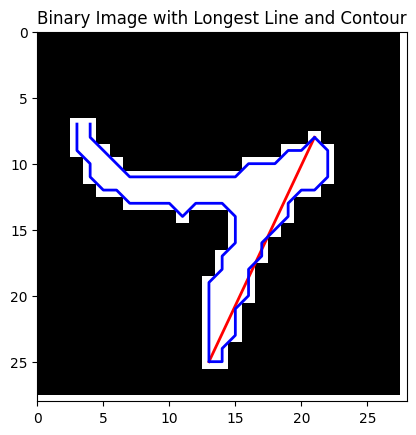

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


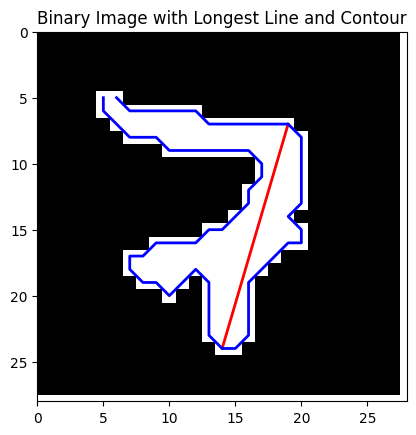

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


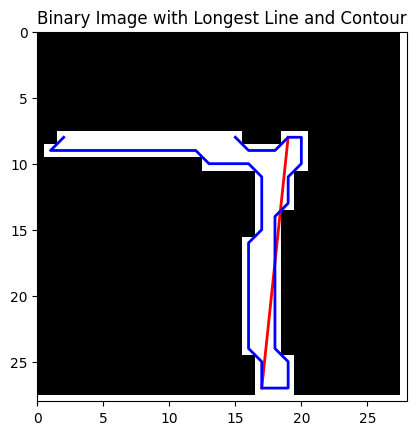

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


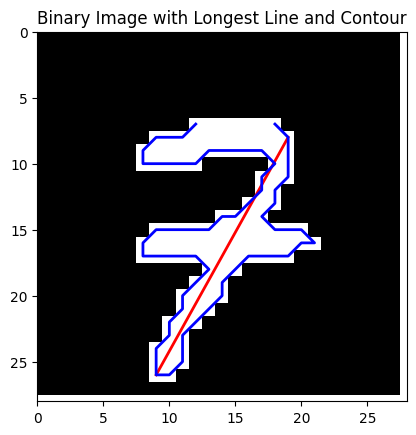

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


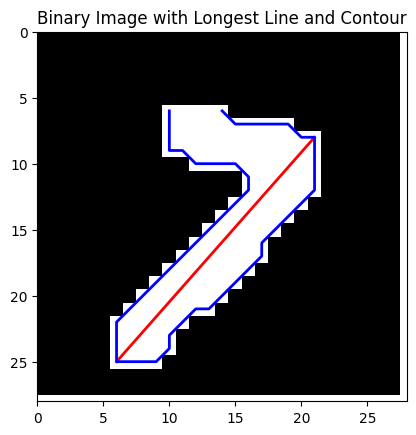

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


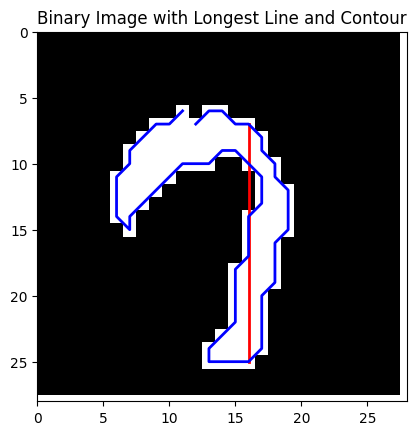

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


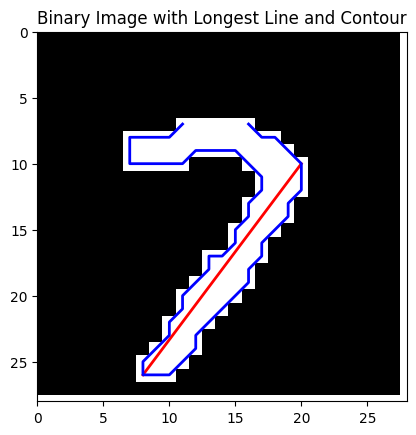

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9966


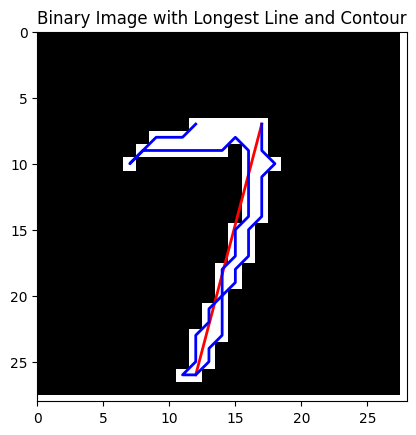

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9901


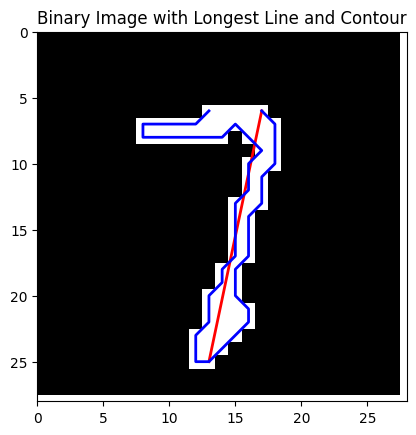

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


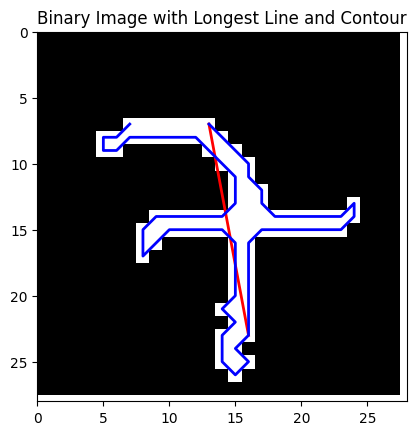

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


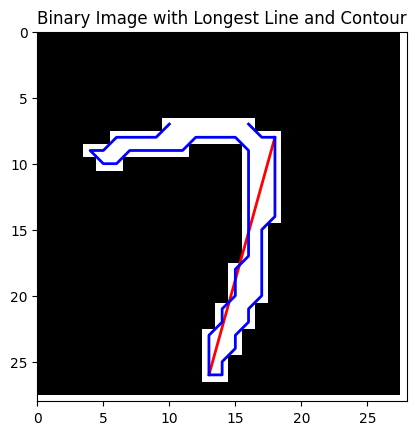

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9917


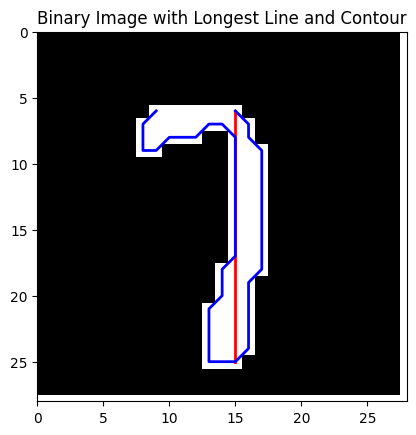

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


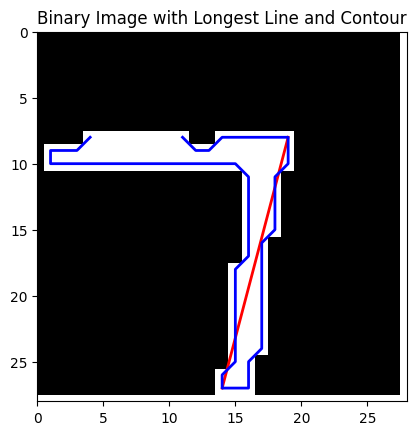

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


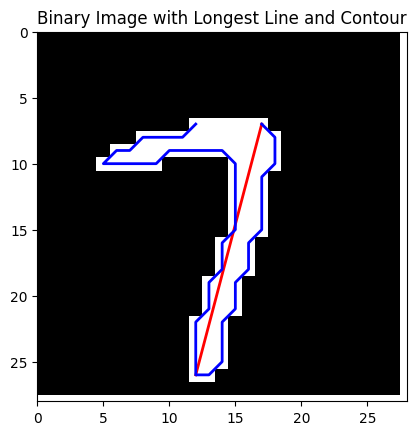

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9038


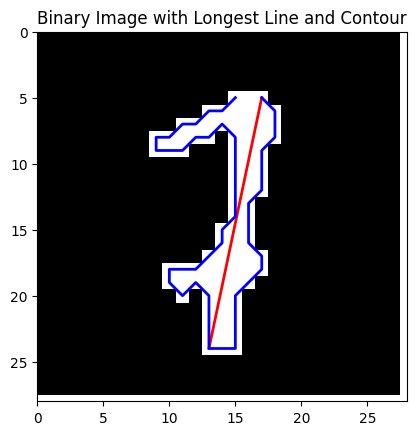

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9964


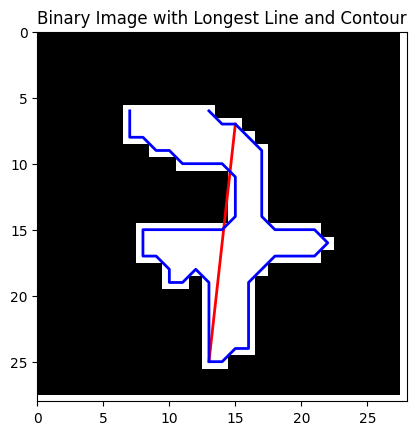

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9887


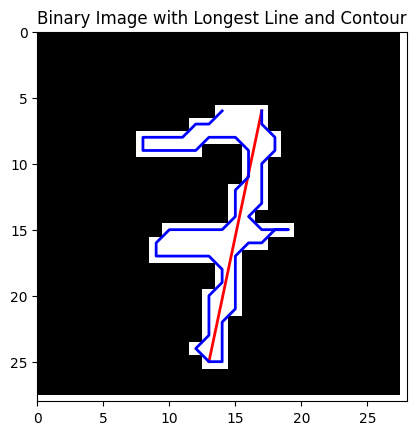

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9582


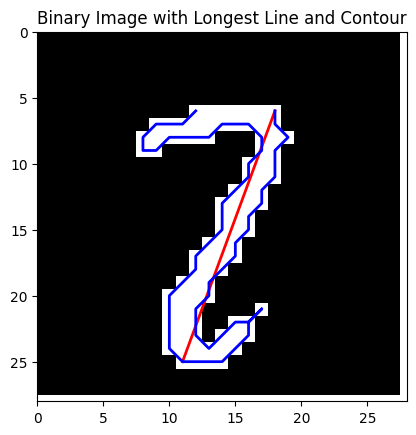

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


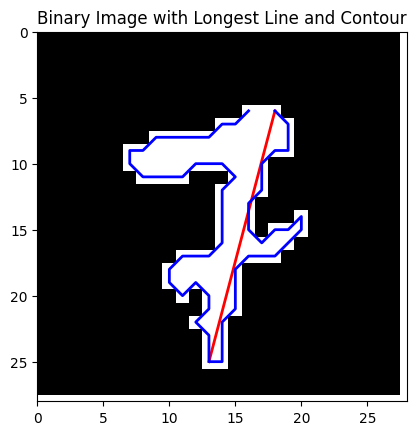

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


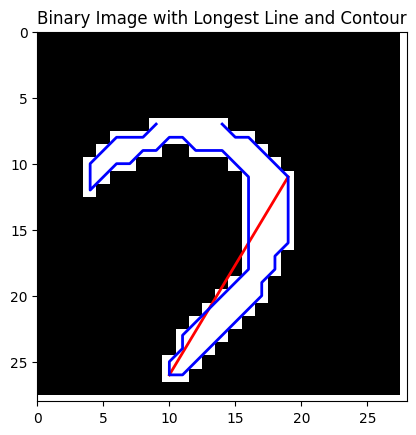

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9550


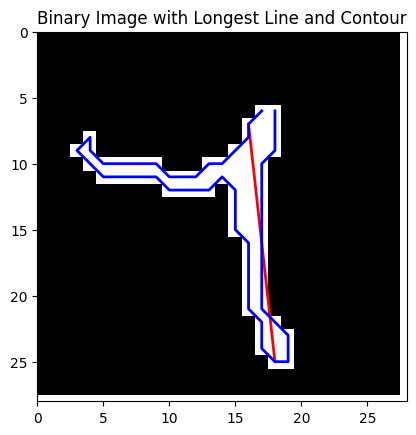

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


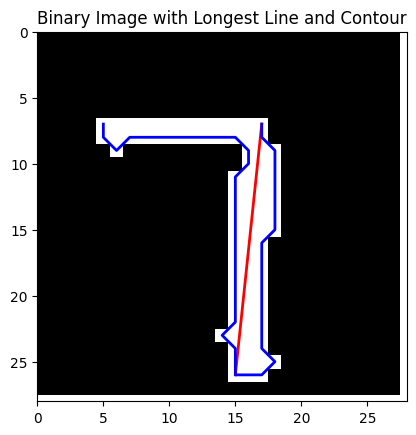

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9032


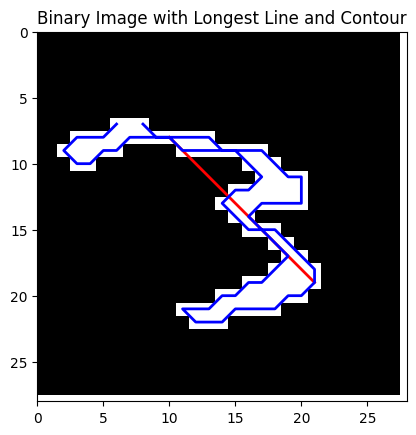

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


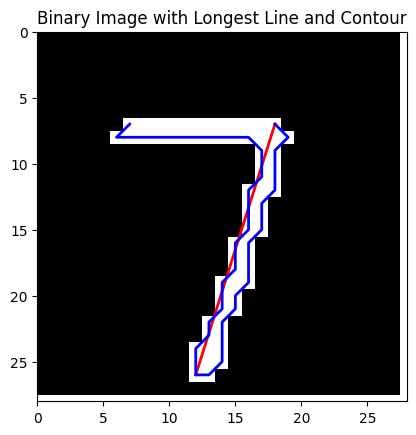

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


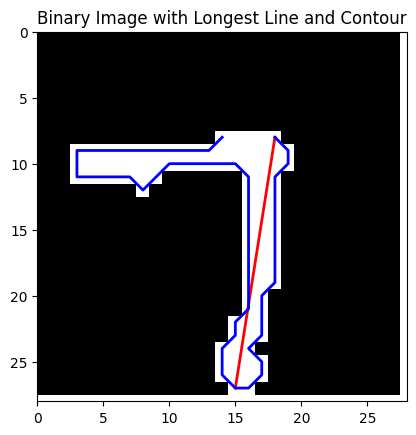

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9888


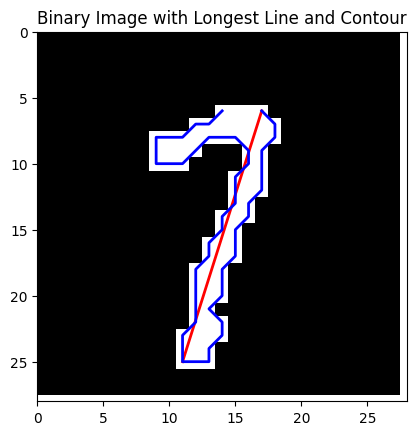

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


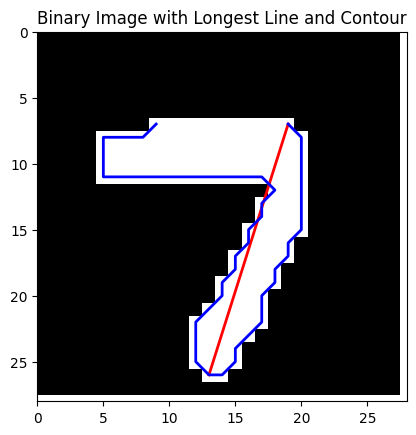

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


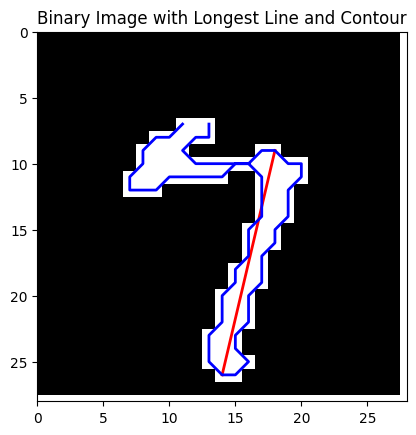

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


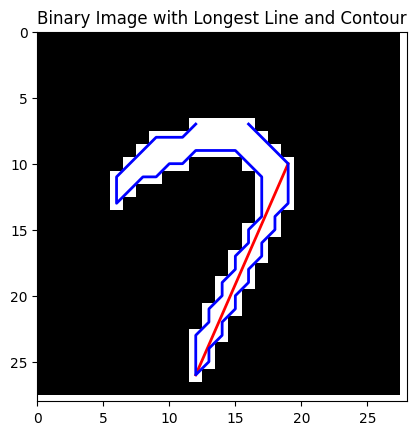

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9990


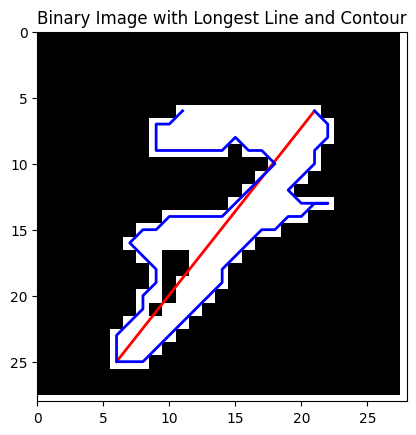

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


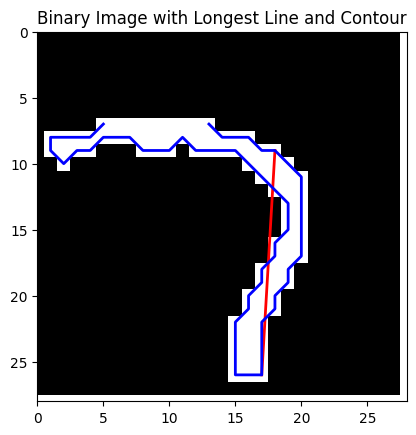

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


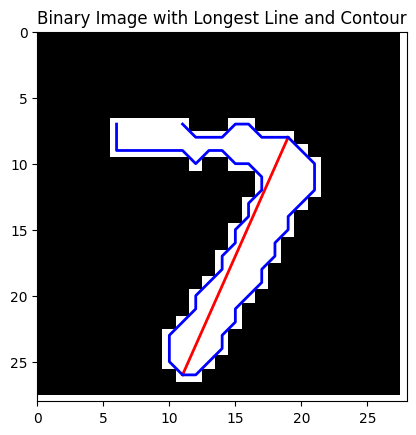

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9965


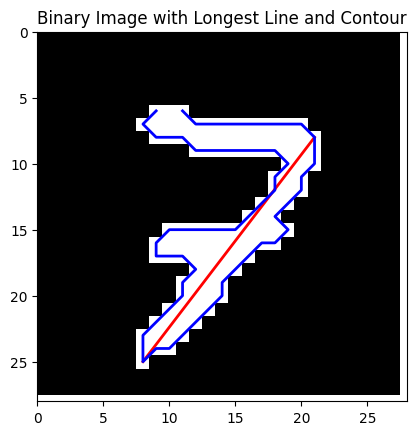

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9784


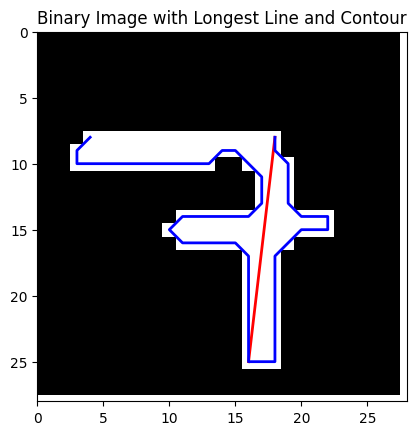

Prediction probability for digit 9: 0.9947


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


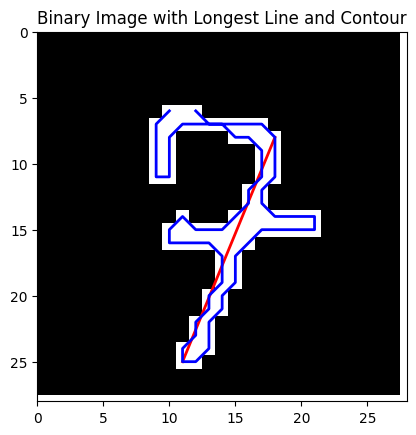

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


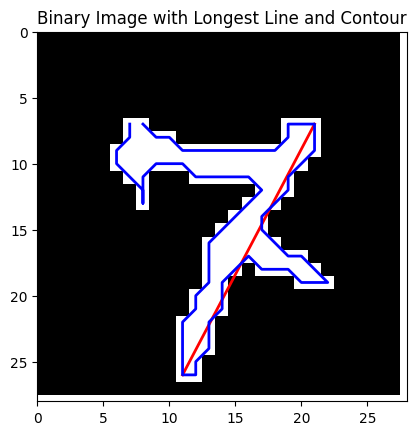

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9942


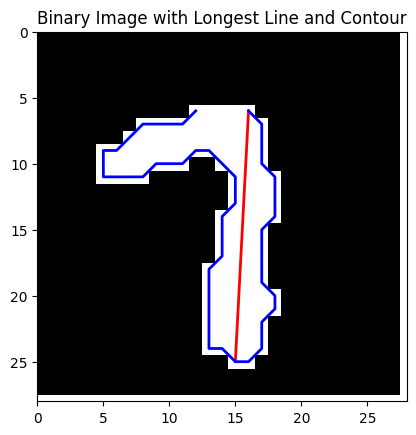

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


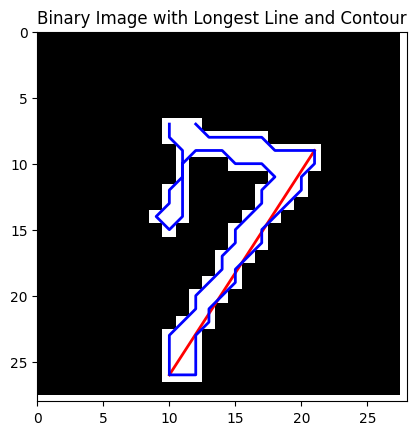

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


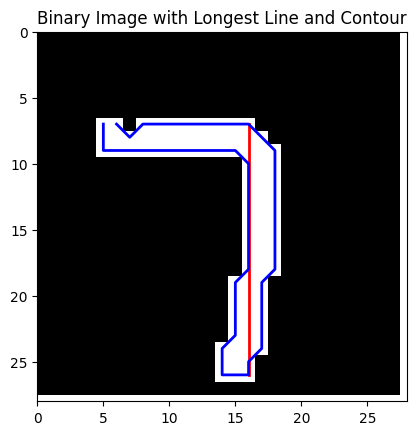

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9966


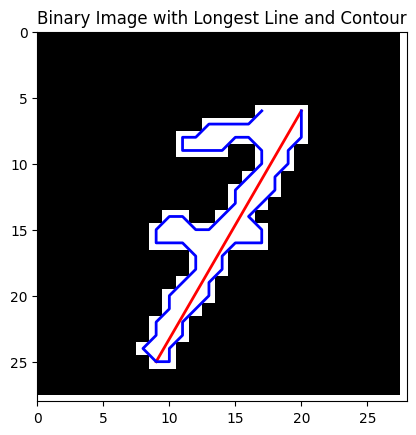

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


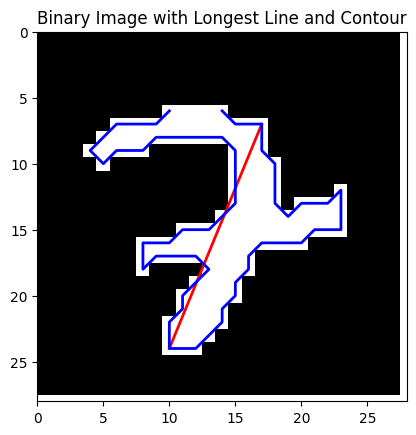

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


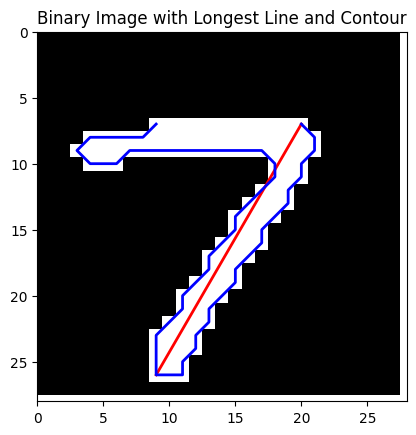

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


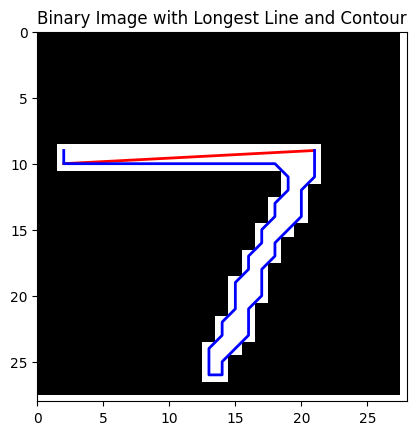

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9982


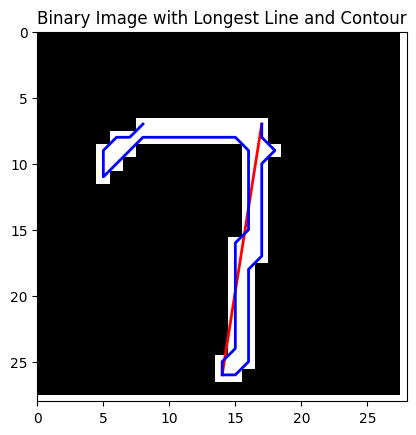

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


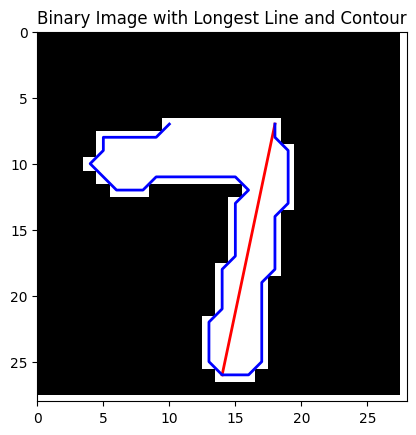

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9979


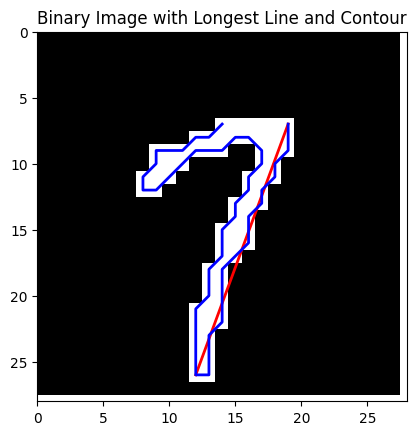

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


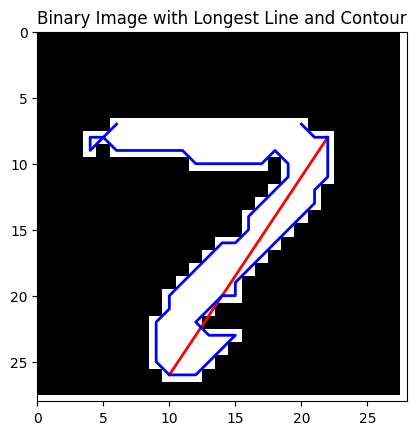

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9957


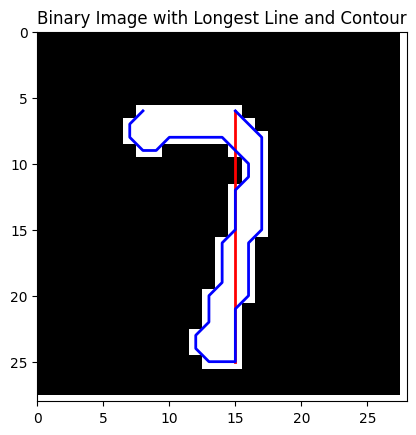

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


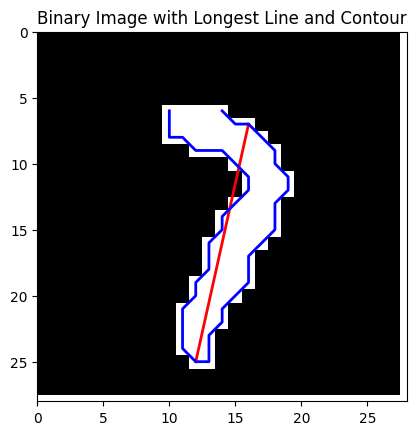

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


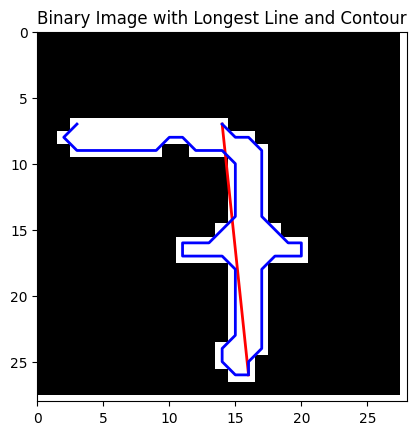

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


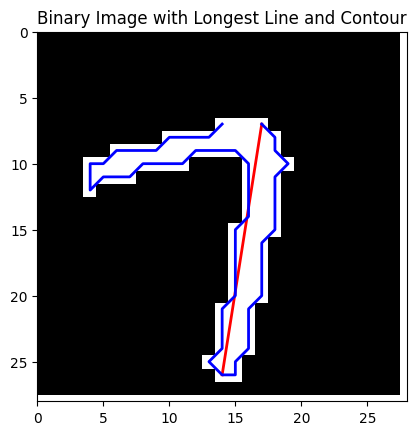

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9702


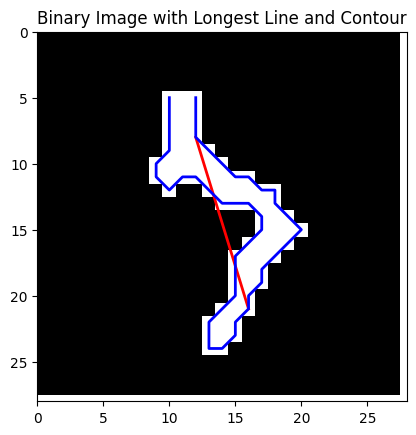

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9974


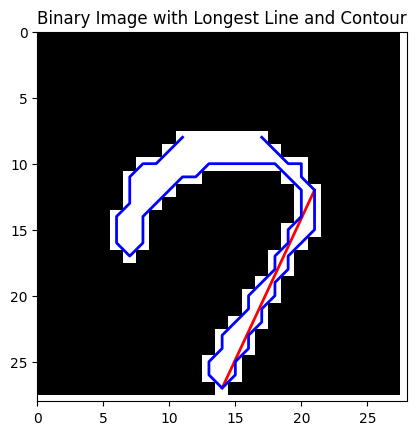

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


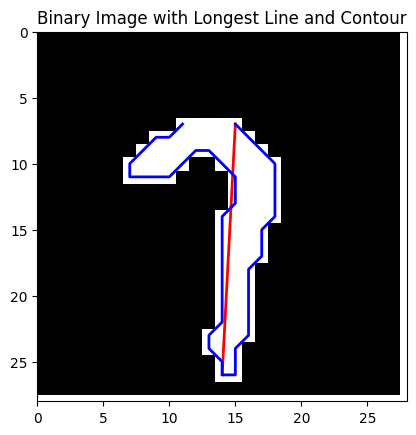

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


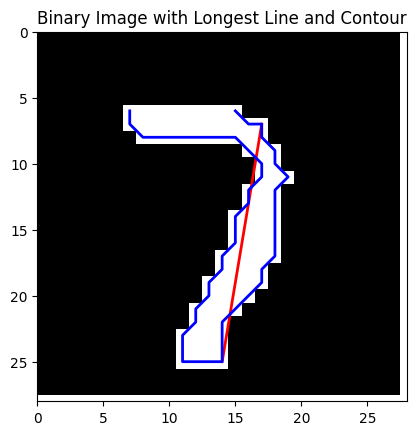

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


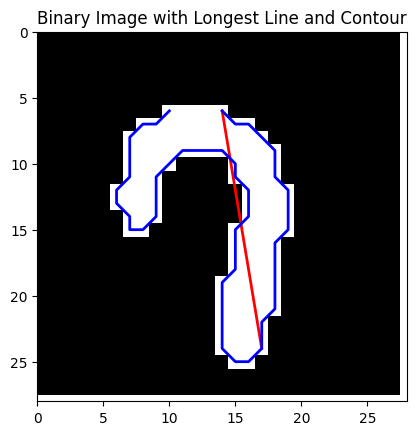

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


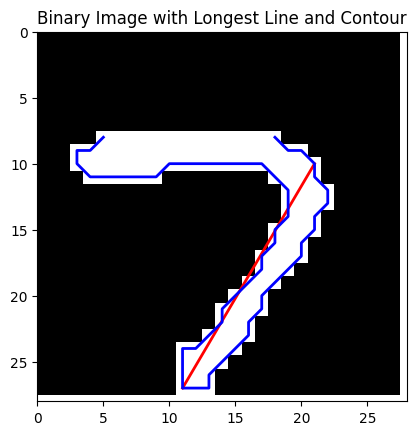

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


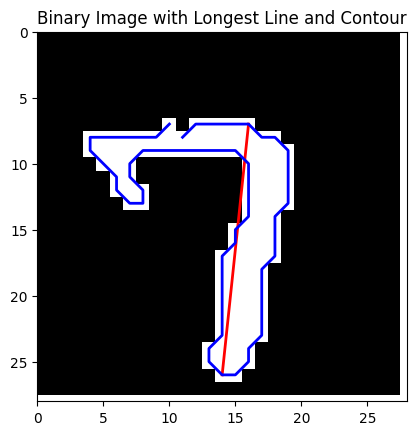

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


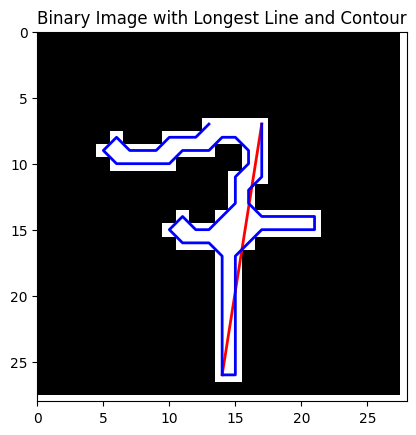

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


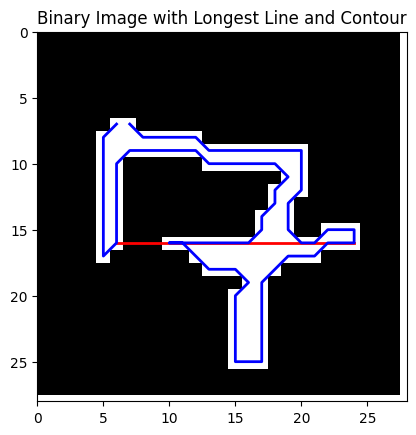

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3407666934.py:54: RuntimeWarning: divide by zero encountered in int_scalars
  k=1/(y1-y0)*(x1-x0)
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9505


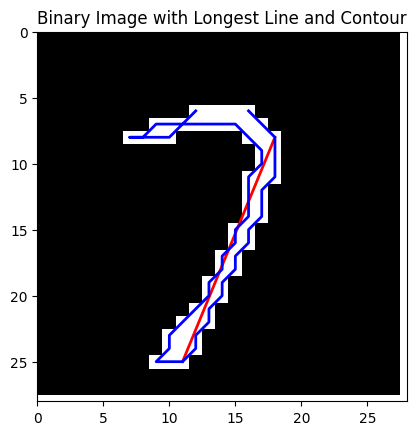

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


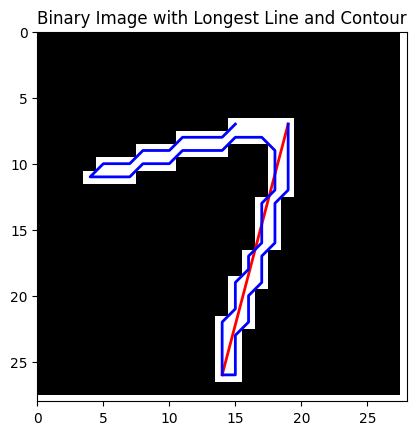

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


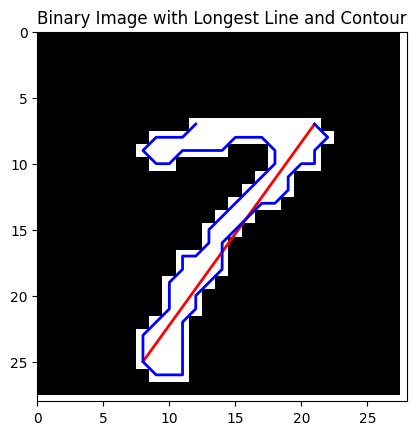

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


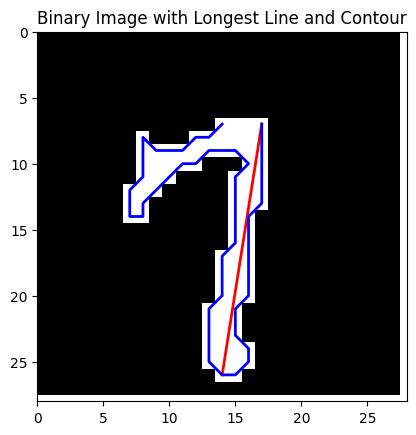

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


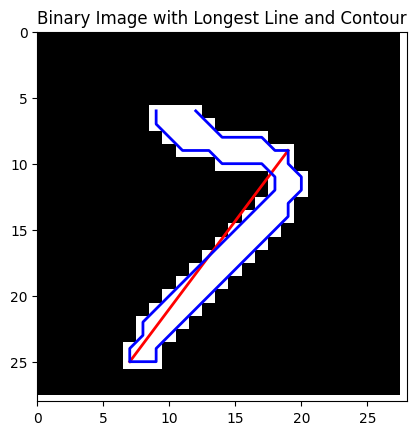

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9799


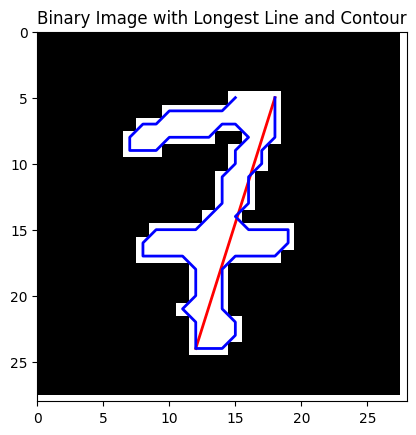

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9775


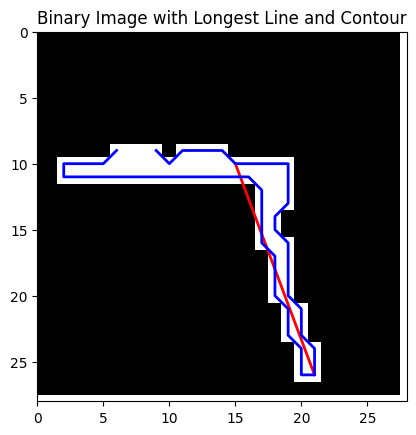

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


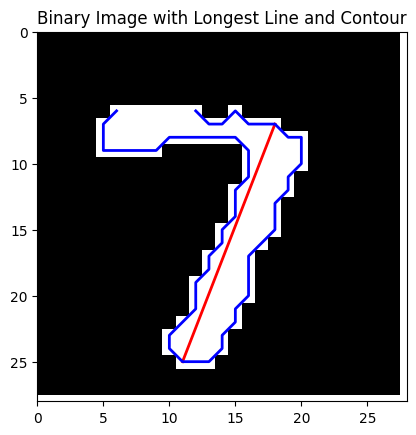

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


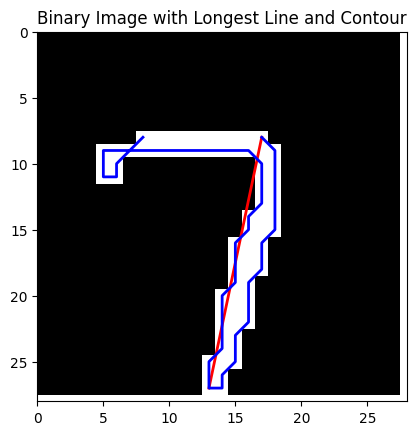

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


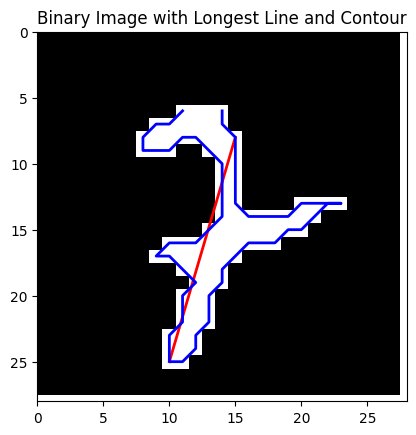

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


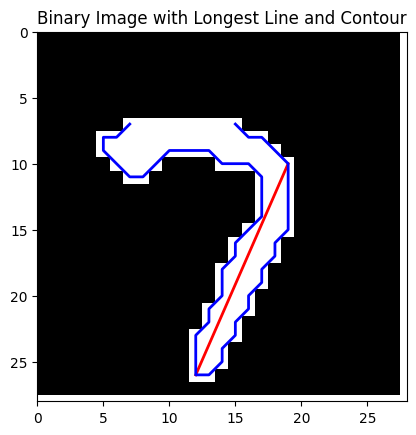

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9940


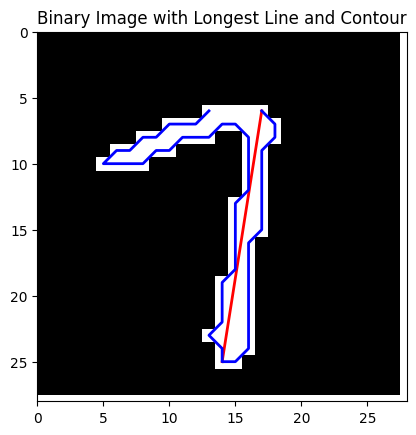

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9952


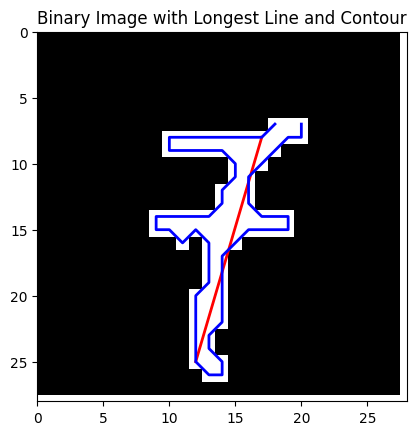

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


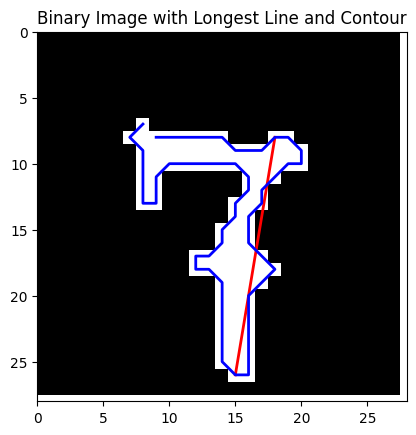

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


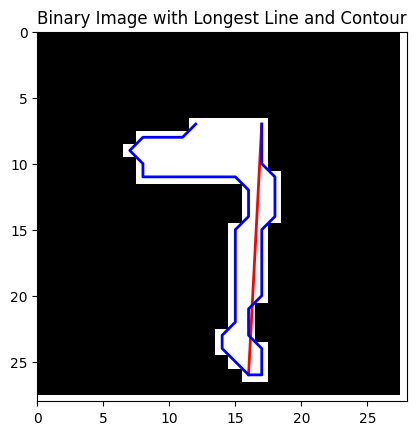

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9834


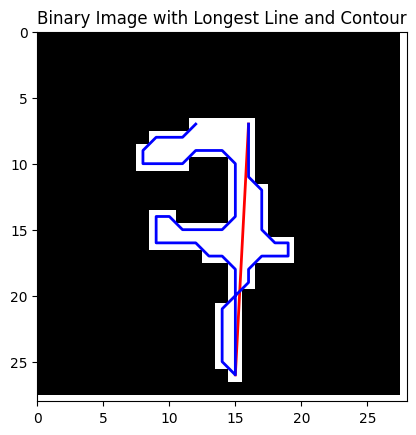

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9895


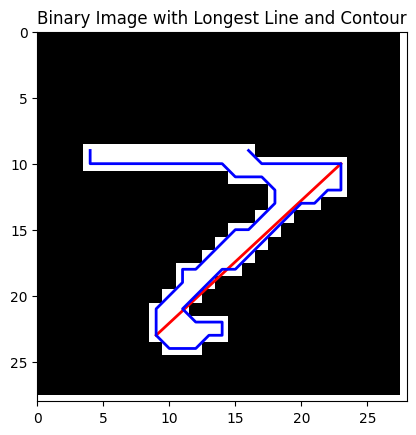

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


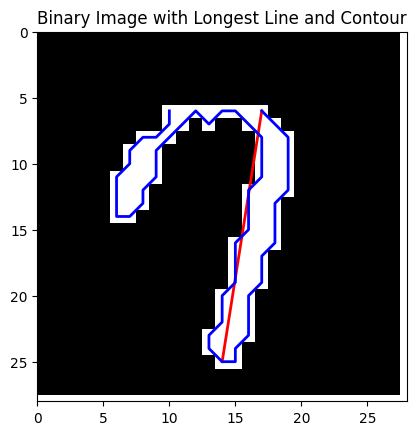

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


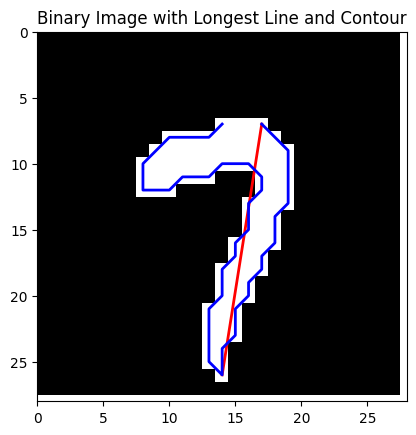

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9992


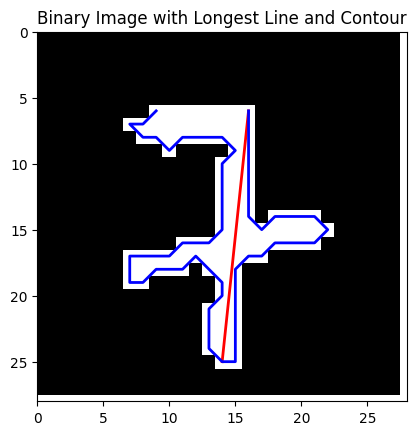

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9285


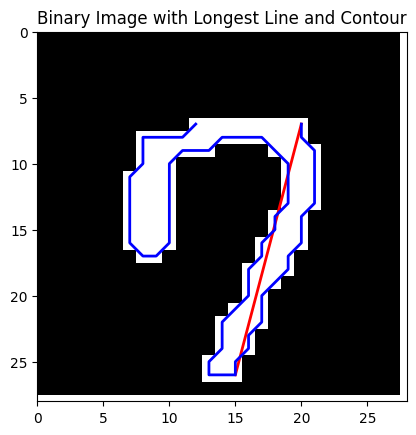

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


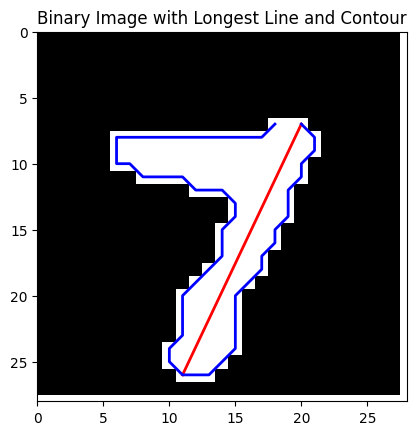

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


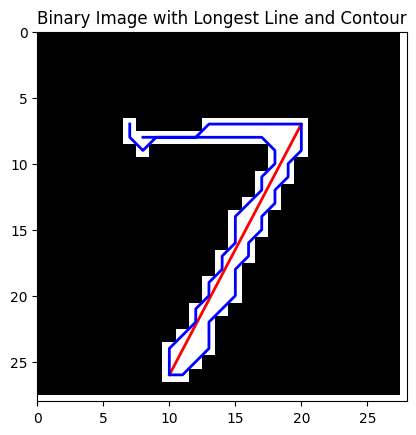

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       1.000     64     0.105       False             6.898   
1       1.000     63     0.133       False             7.026   
2       1.000     62     0.097       False             6.695   
3       1.000     64     0.149       False             6.702   
4       0.999     75     0.131       False             7.101   
..        ...    ...       ...         ...               ...   
95      1.000     54     0.117       False             5.589   
96      0.999     74     0.138       False             5.771   
97      0.929     75     0.145       False             6.802   
98      1.000     59     0.177       False             6.144   
99      0.999     58     0.093       False             6.511   

    variance_distance      k       b right_1 left_1  longest_line_length  \
0               6.419 -0.556  24.444      34     48               20.591   
1               5.174 -0.529  24.765      43     61               19.235   
2  

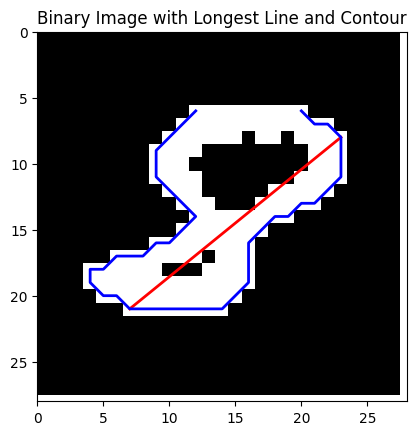

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9948


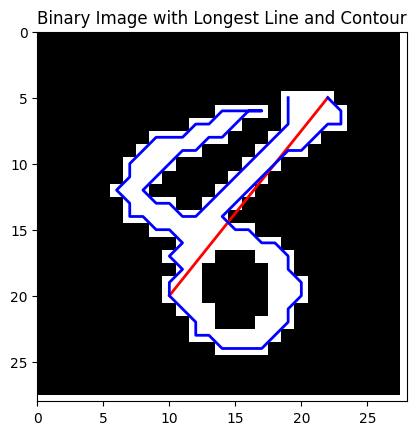

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


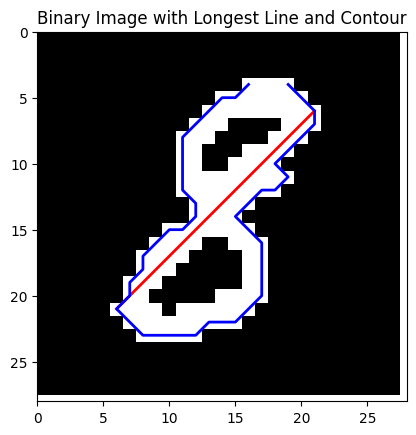

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


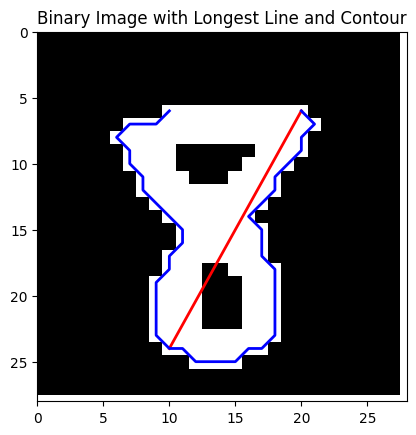

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


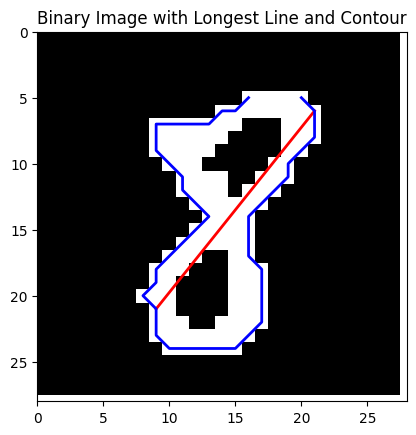

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


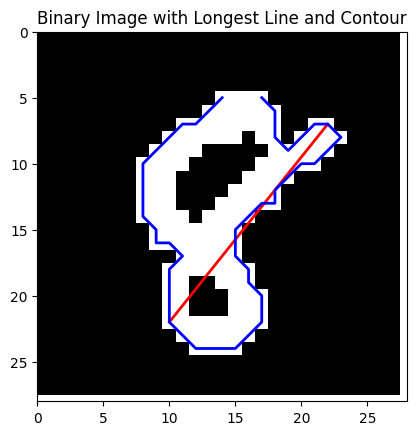

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


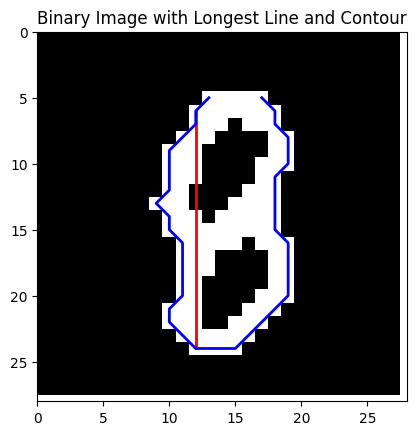

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9968


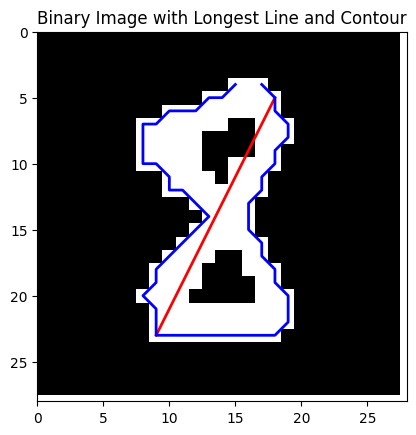

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


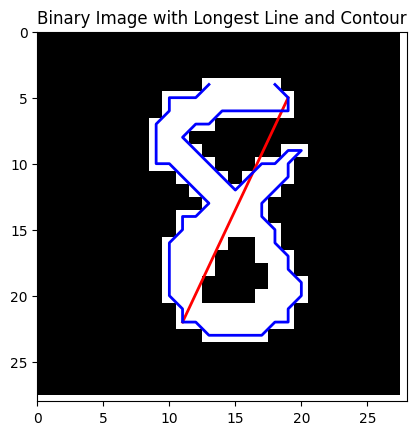

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9932


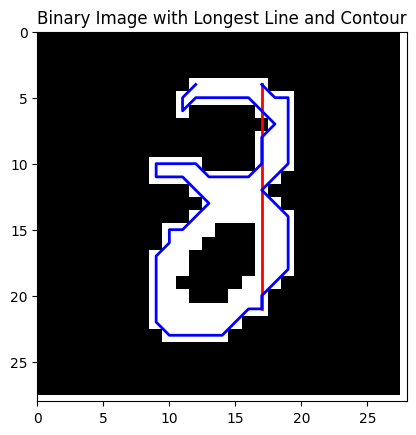

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


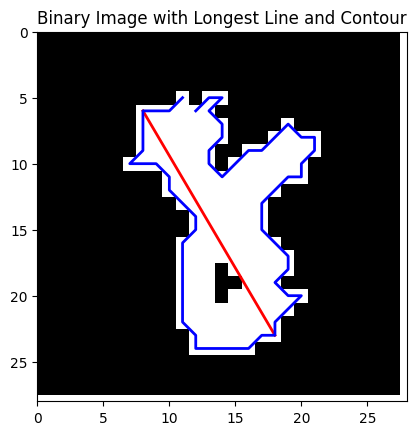

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9961


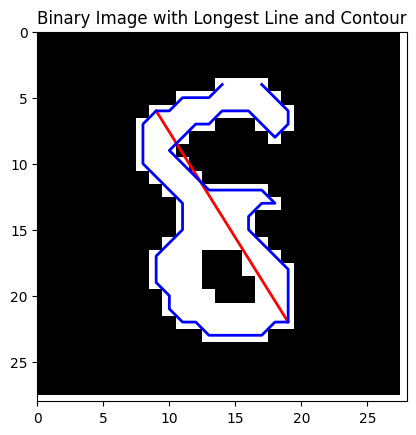

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9246


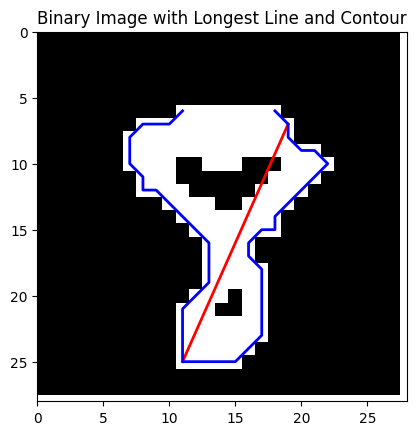

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


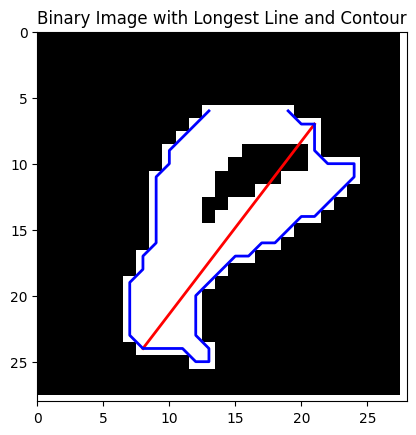

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9924


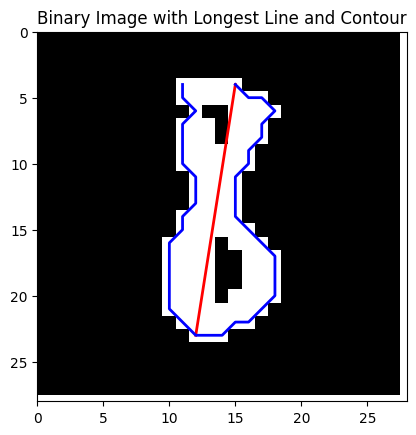

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


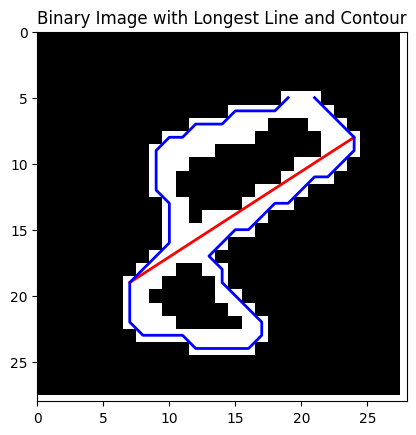

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9954


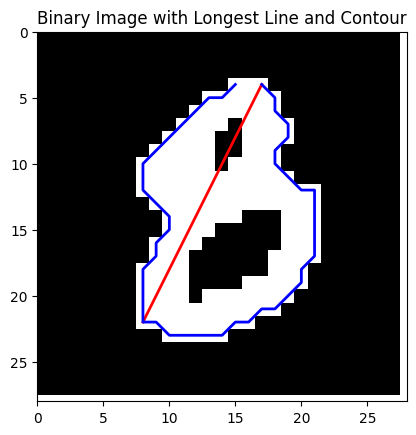

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


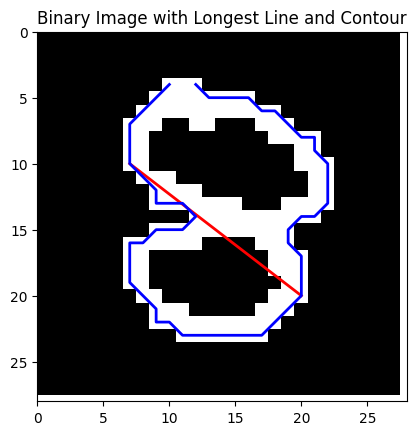

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


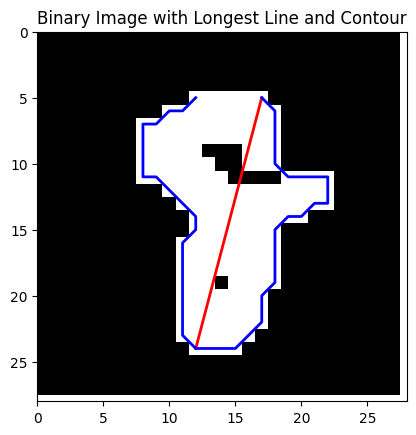

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


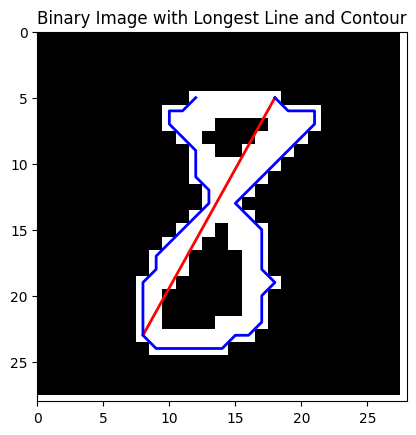

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


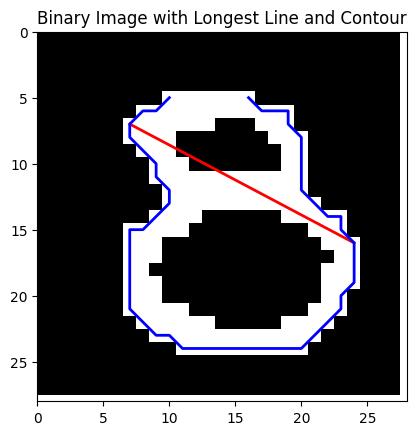

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9950


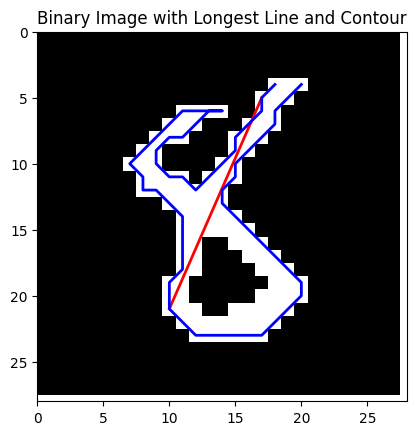

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


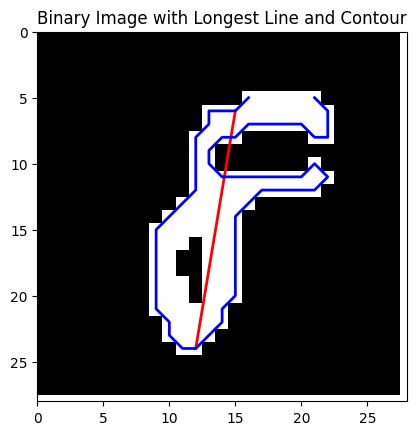

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


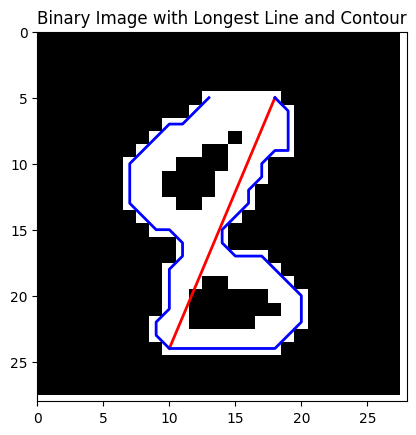

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


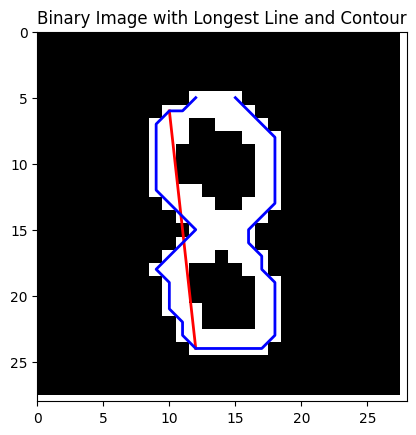

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9802


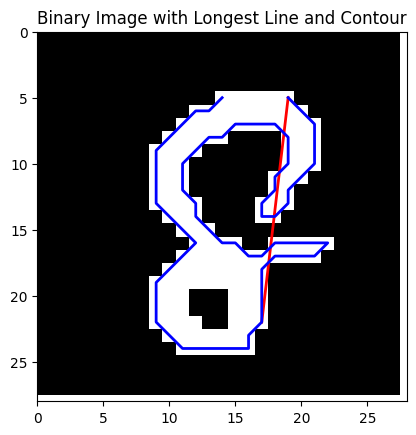

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


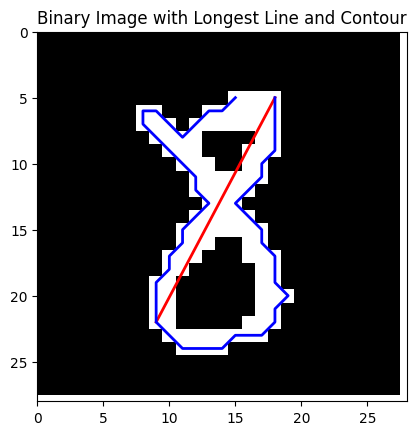

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


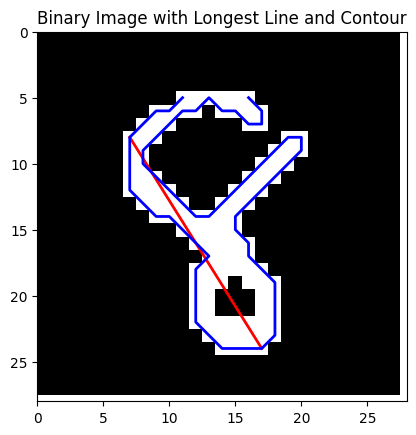

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9840


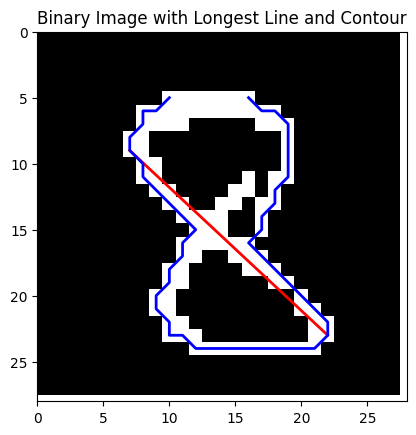

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9946


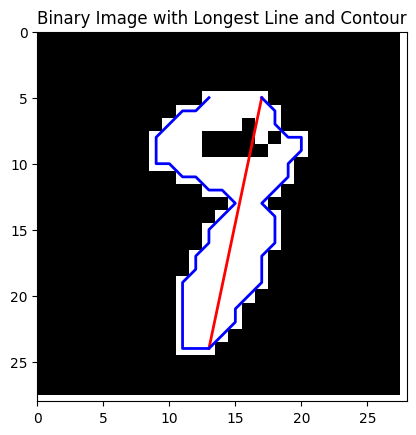

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


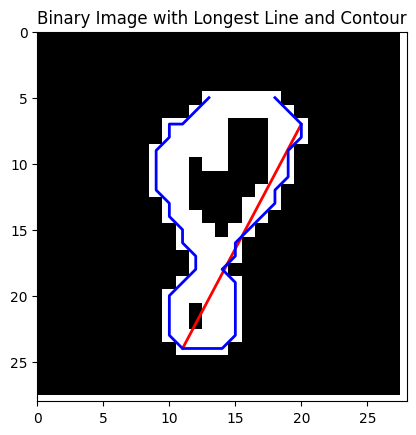

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


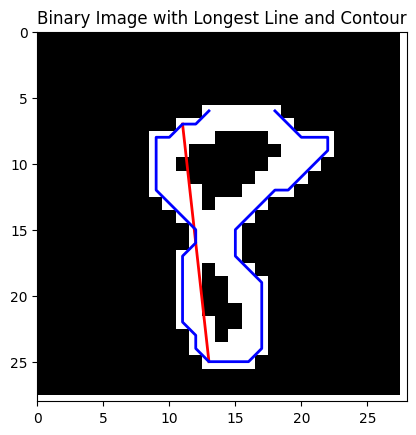

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


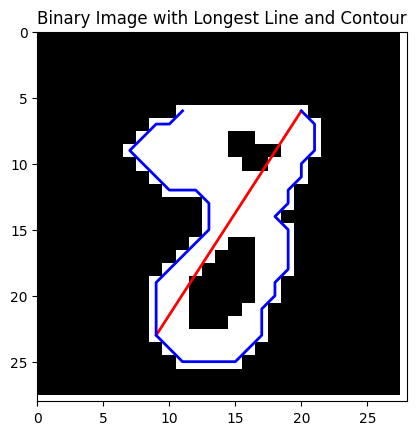

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


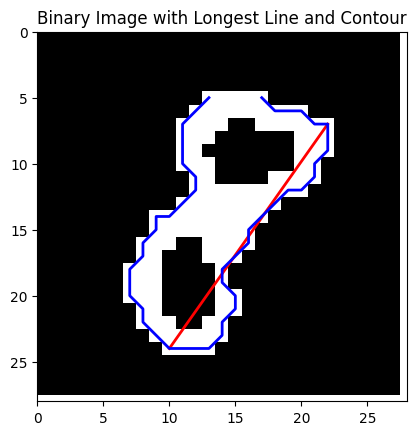

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9985


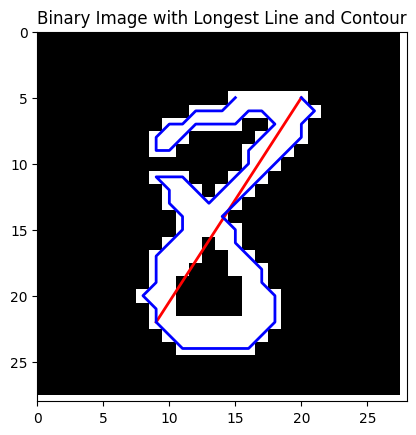

Prediction probability for digit 9: 0.9999


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


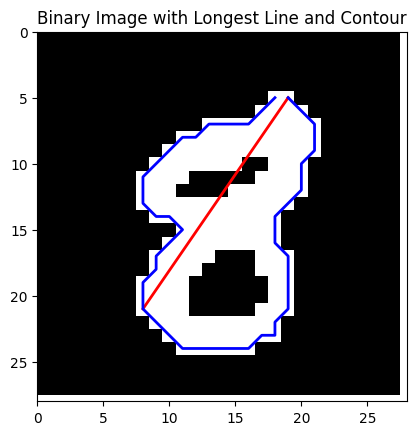

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


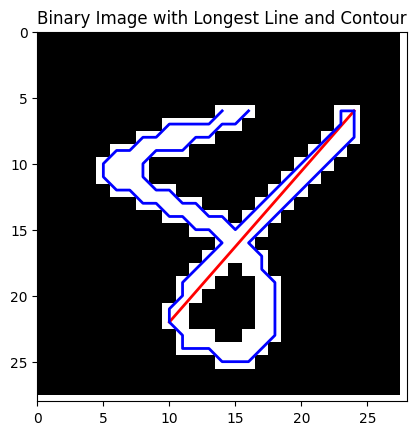

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9084


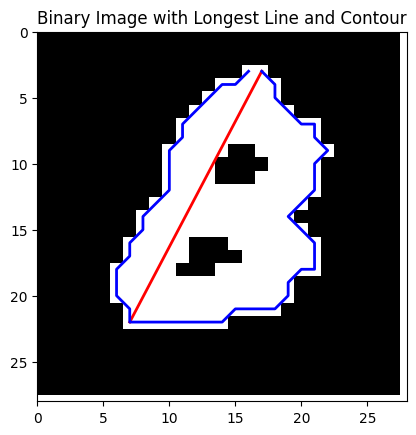

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


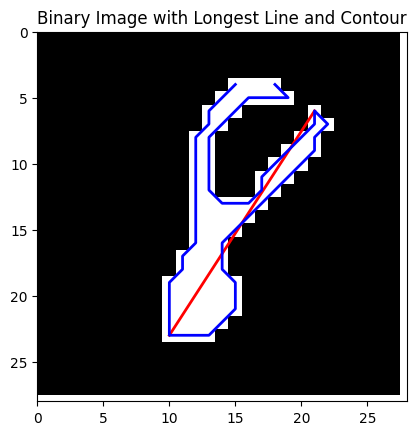

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


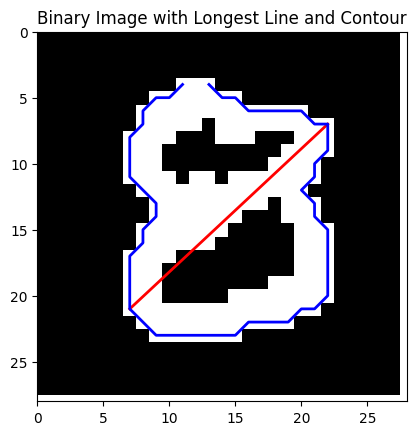

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9878


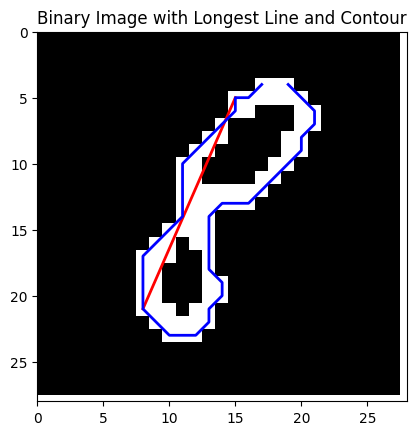

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9656


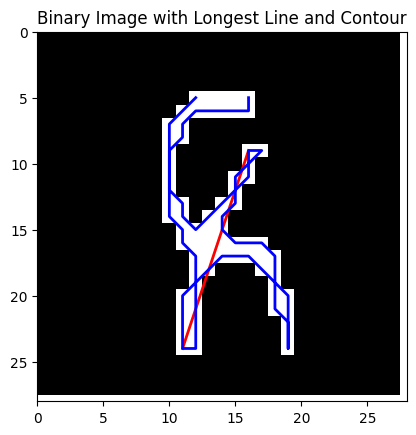

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


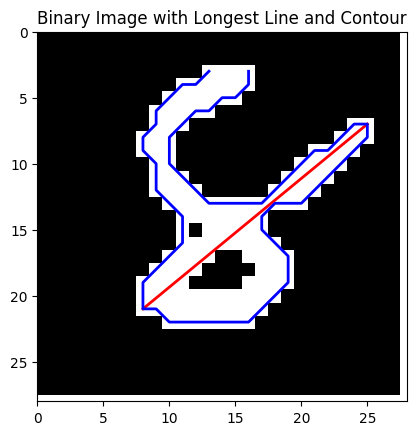

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


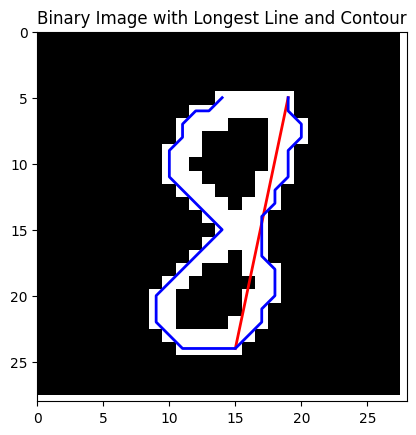

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9991


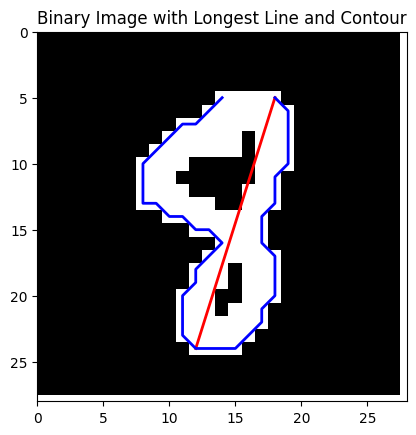

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


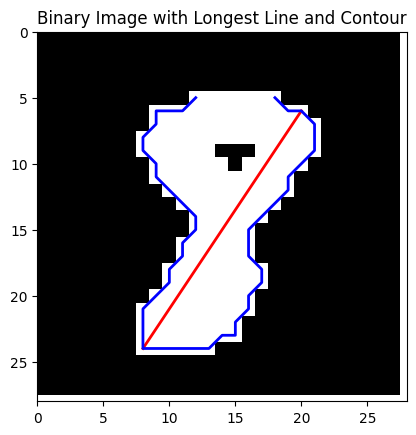

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9367


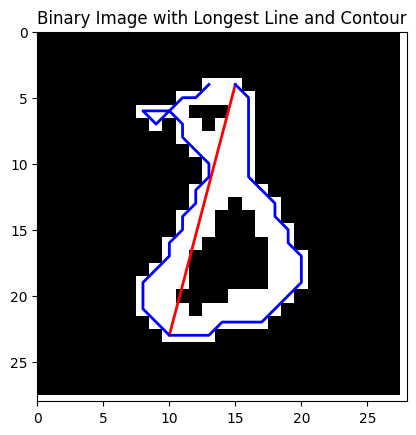

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


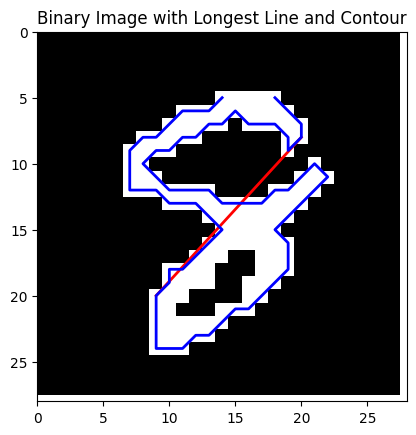

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9993


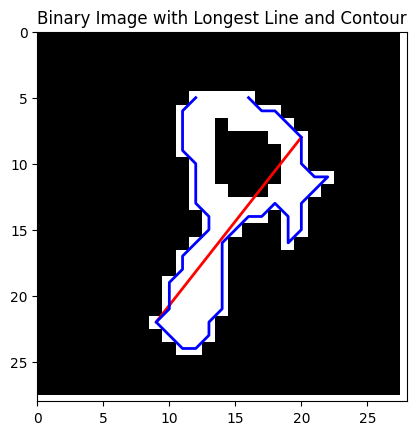

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9914


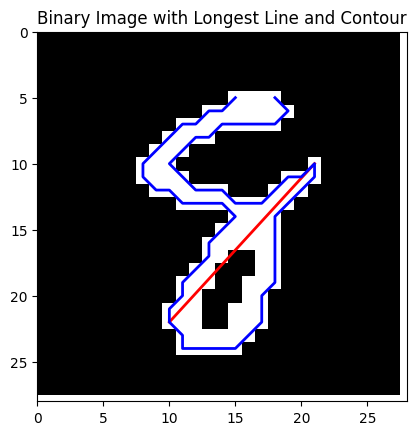

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


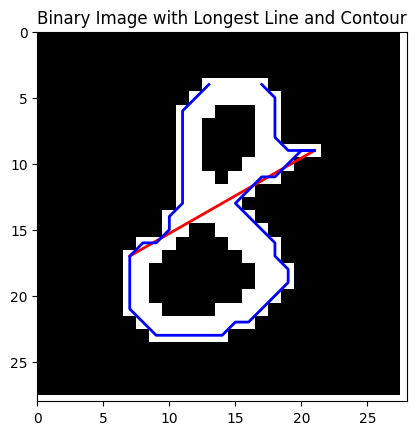

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


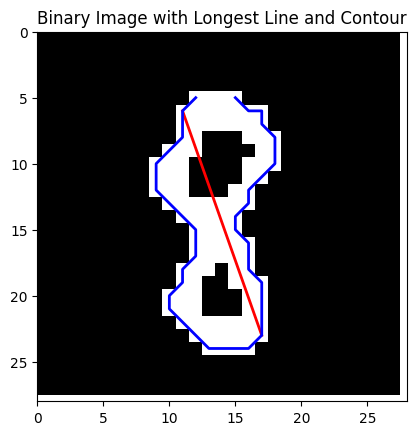

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9892


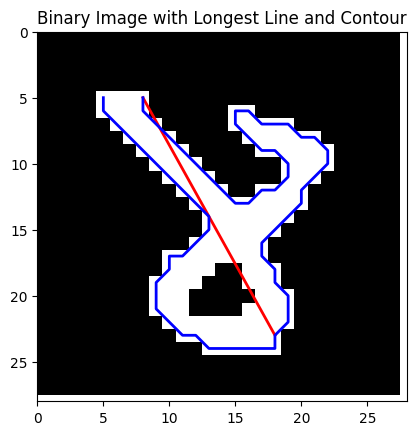

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9961


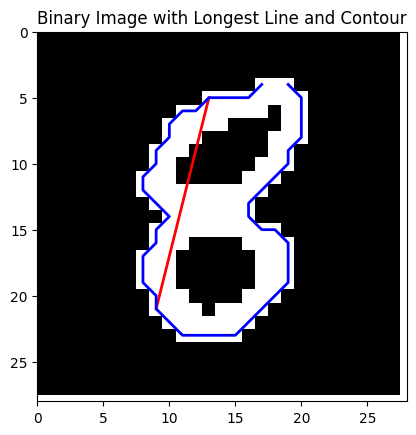

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9970


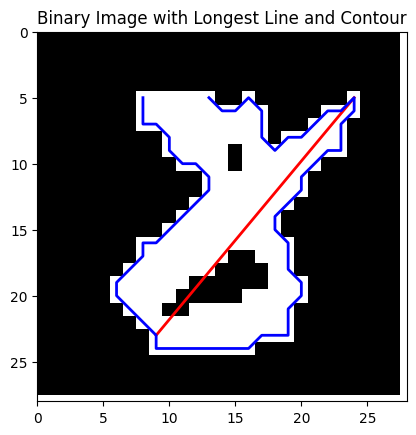

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9987


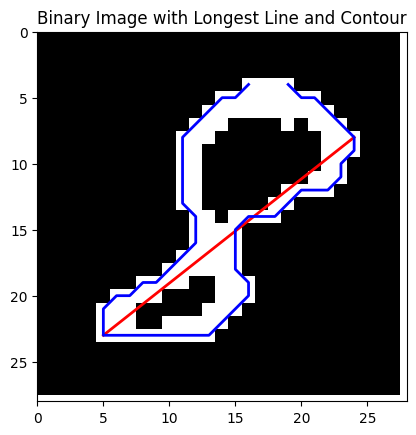

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9929


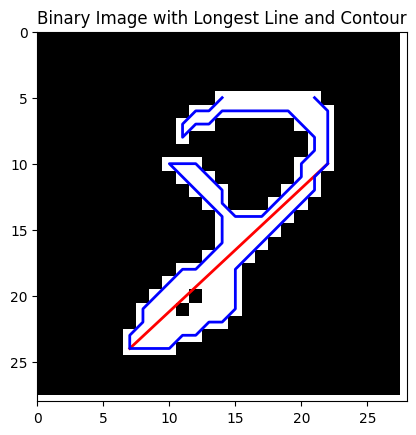

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


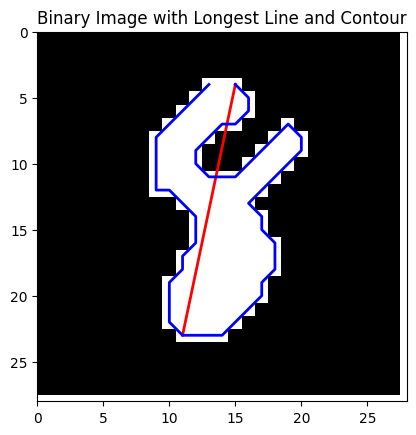

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


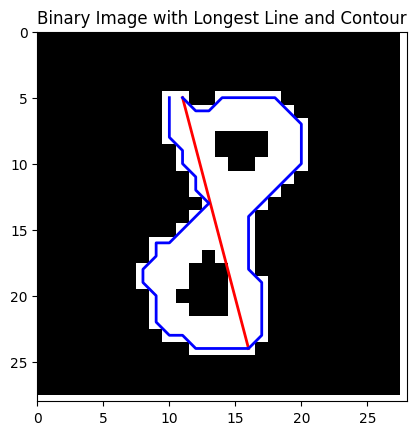

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9317


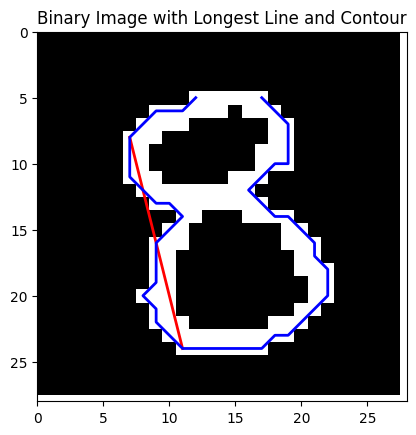

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


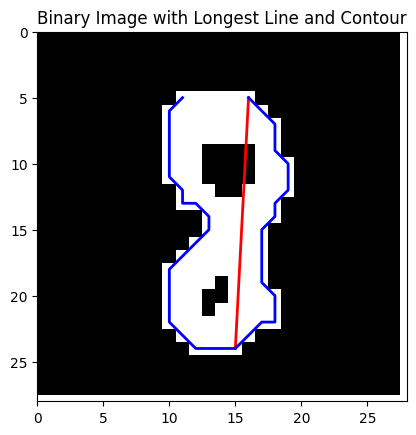

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


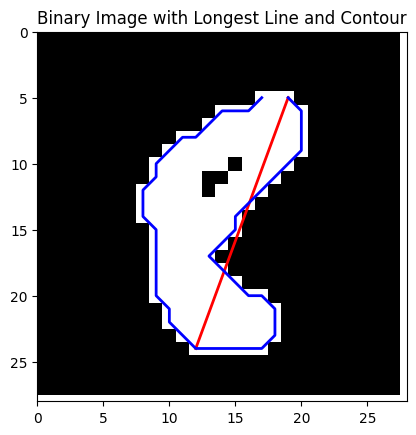

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9763


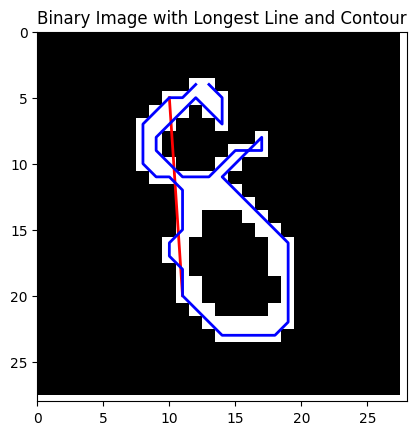

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


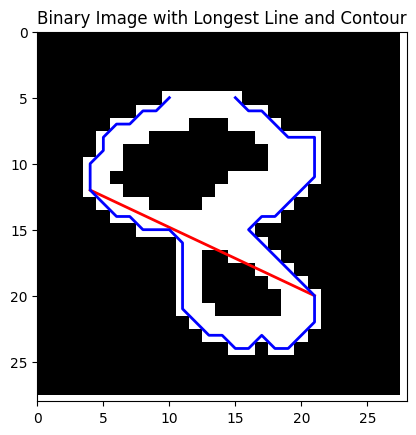

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


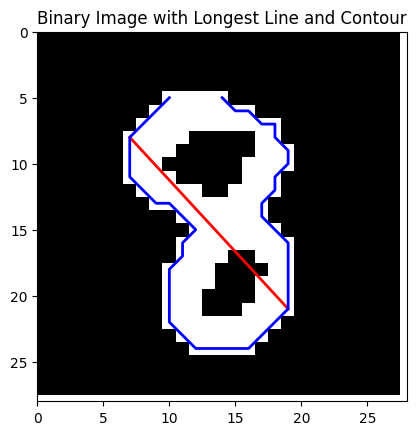

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9796


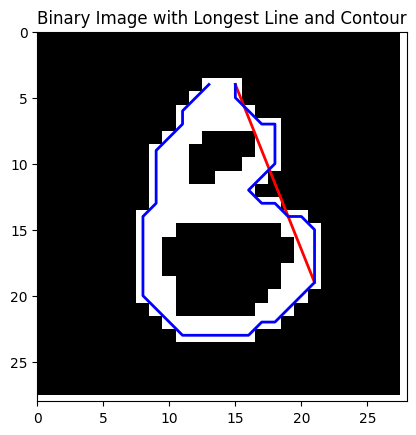

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


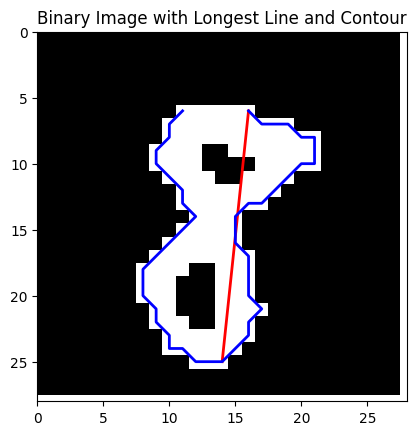

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9978


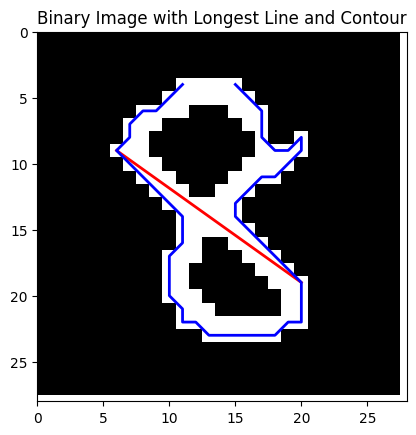

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9984


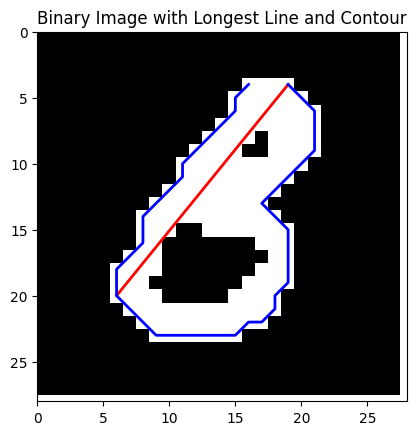

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


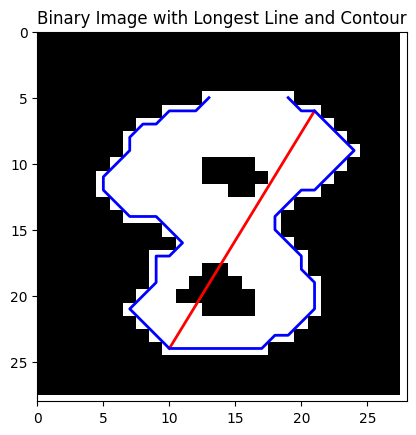

Prediction probability for digit 9: 0.9995


C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


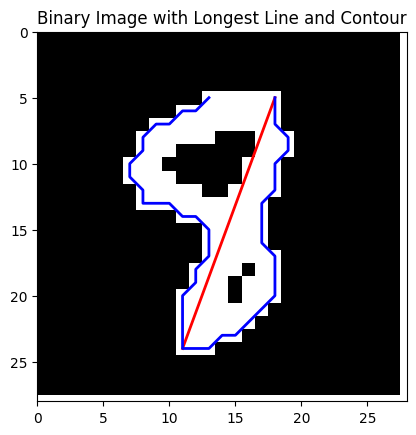

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9930


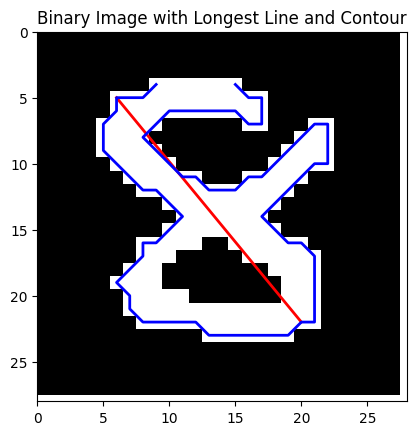

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9932


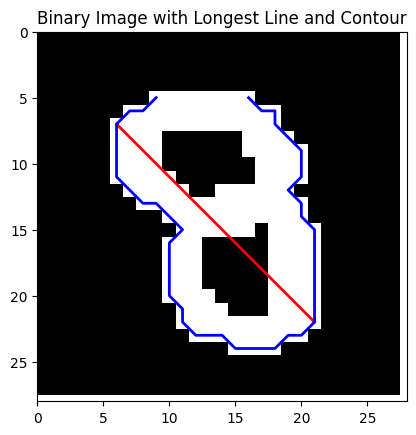

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9975


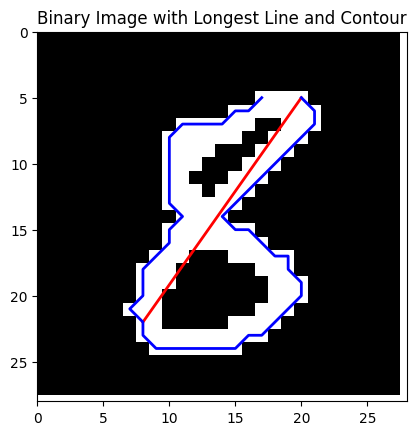

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


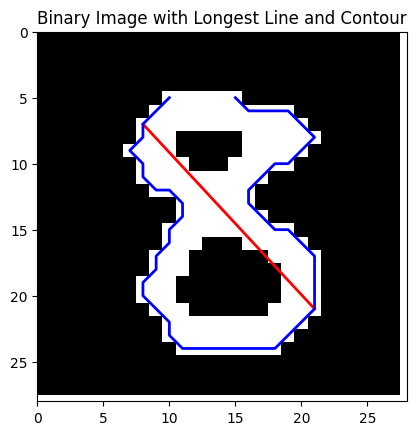

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


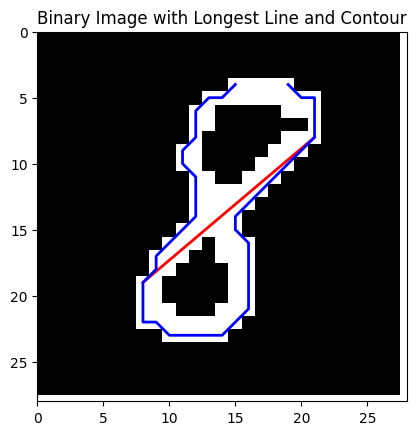

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9976


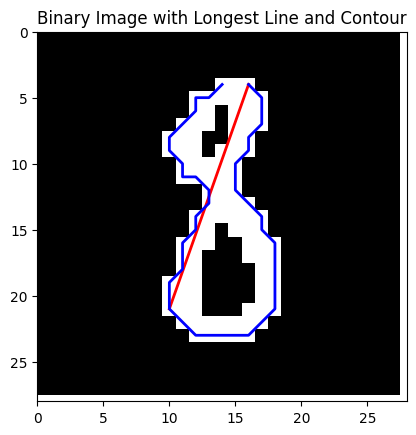

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9998


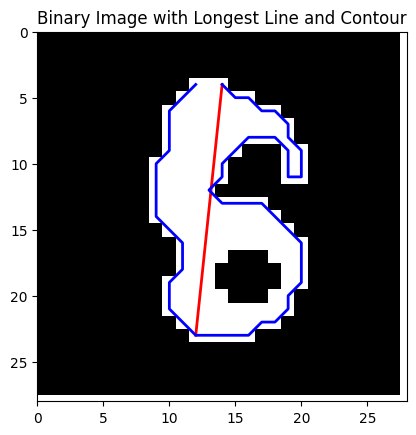

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


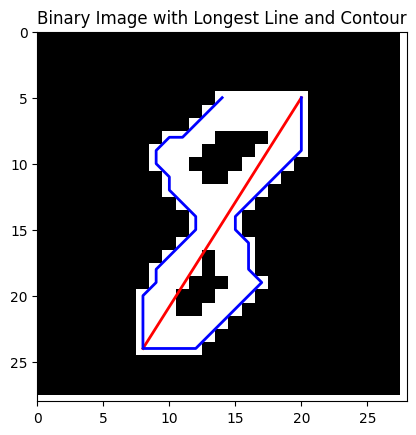

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 1.0000


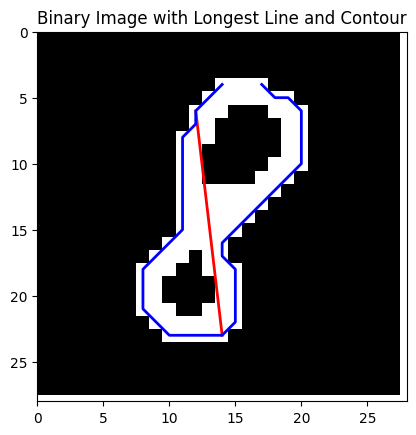

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


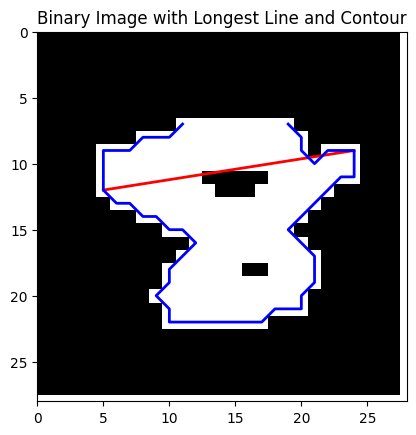

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9995


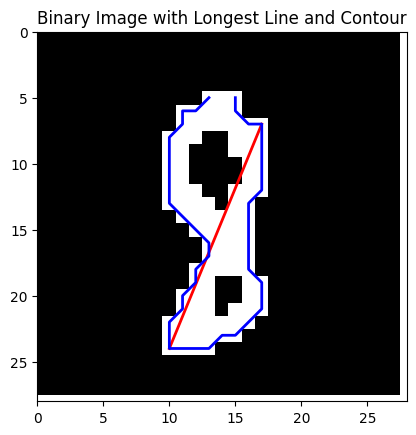

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


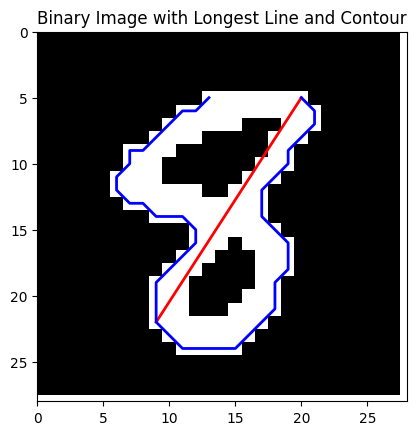

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9980


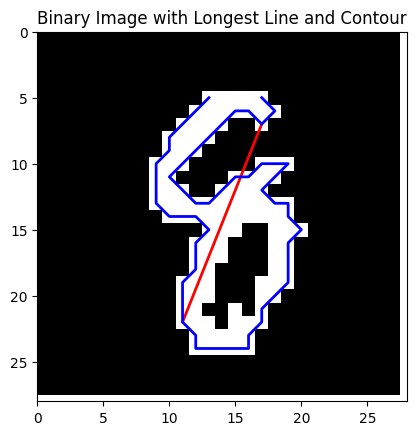

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9994


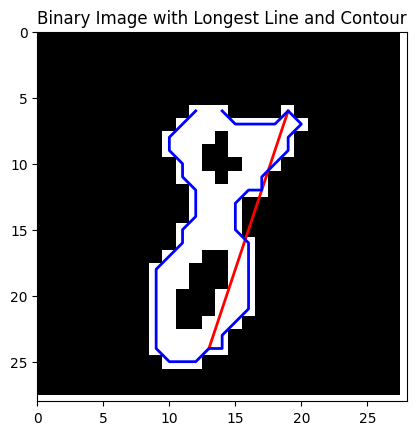

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


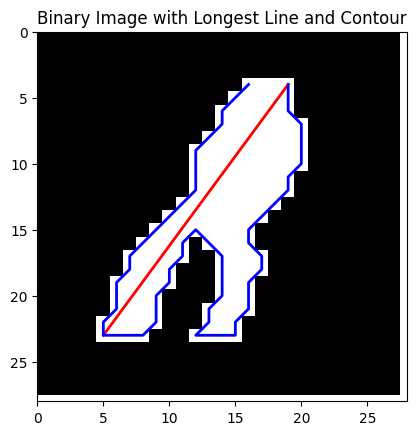

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9983


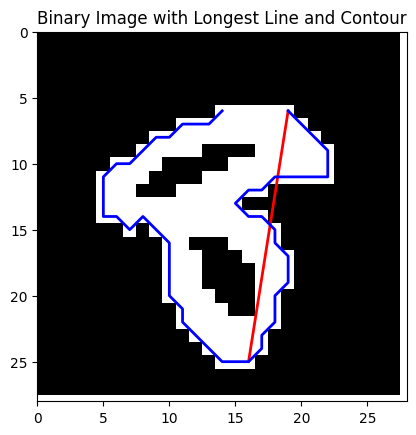

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9875


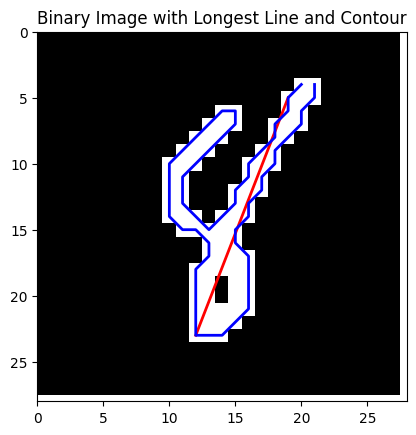

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9955


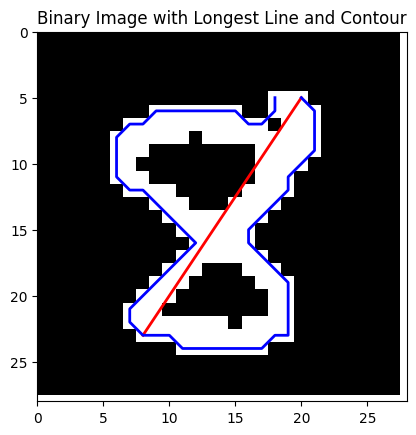

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9972


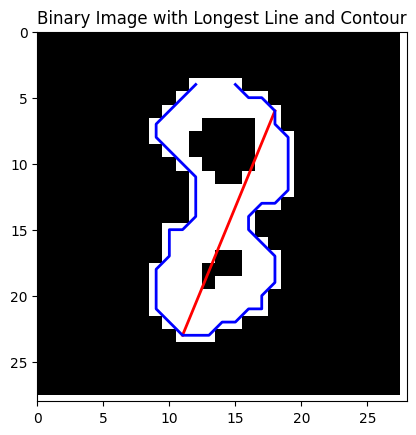

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9642


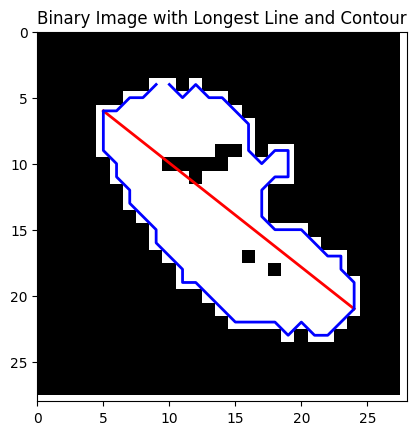

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9996


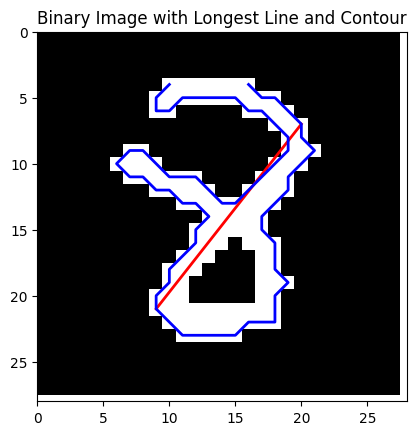

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9997


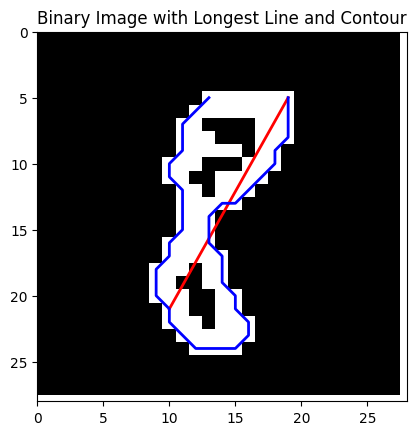

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9889


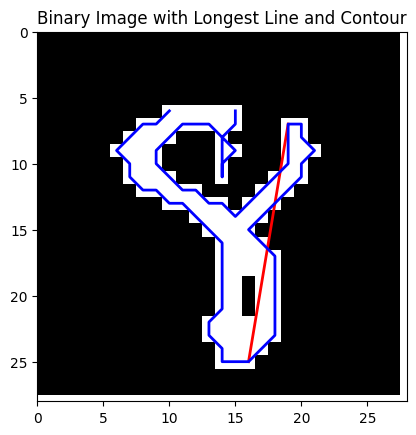

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


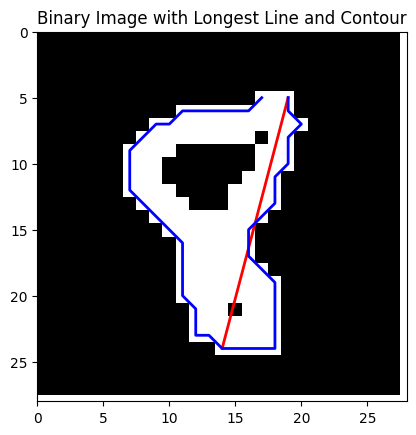

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9999


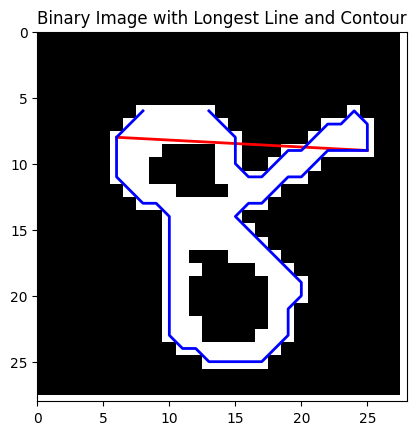

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9277


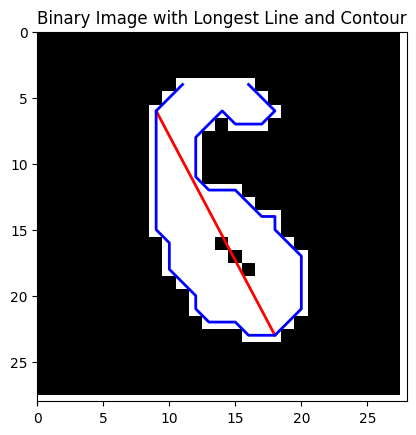

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9988


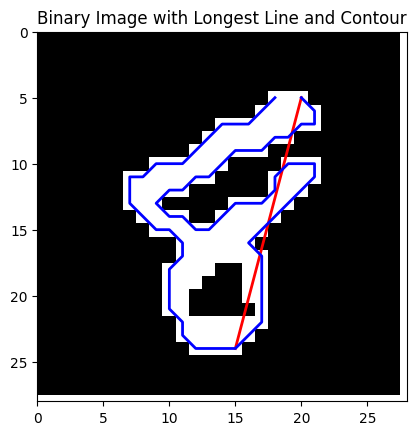

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9308


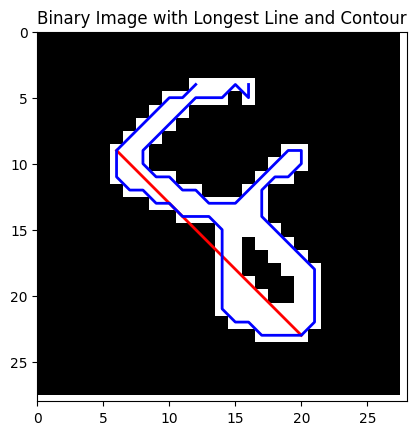

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


Prediction probability for digit 9: 0.9836


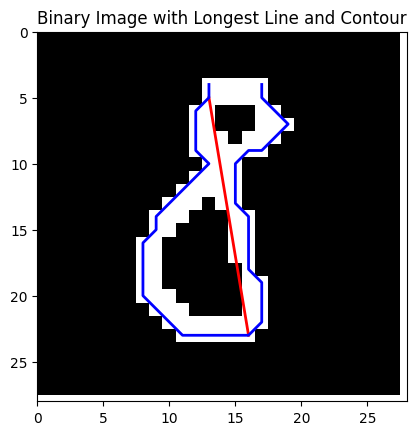

C:\Users\zimin\AppData\Local\Temp\ipykernel_29744\3303529266.py:35: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.Series(result, index=df.columns), ignore_index=True)


    pred_prob circum  num_size closed_loop  average_distance  \
0       0.987     85     0.185       False             6.265   
1       0.995     95     0.172       False             6.429   
2       1.000     83     0.166       False             6.183   
3       1.000     85     0.218       False             6.261   
4       1.000     85     0.162       False             6.202   
..        ...    ...       ...         ...               ...   
95      1.000    106     0.198       False             6.764   
96      0.928     62     0.191       False             5.835   
97      0.999     85     0.167       False             5.841   
98      0.931     81     0.144       False             6.321   
99      0.984     80     0.122       False             6.151   

    variance_distance       k        b right_1 left_1  longest_line_length  \
0               6.432  -1.231   32.846      57     88               20.616   
1               7.056  -0.800   26.000      51     84               19.209 

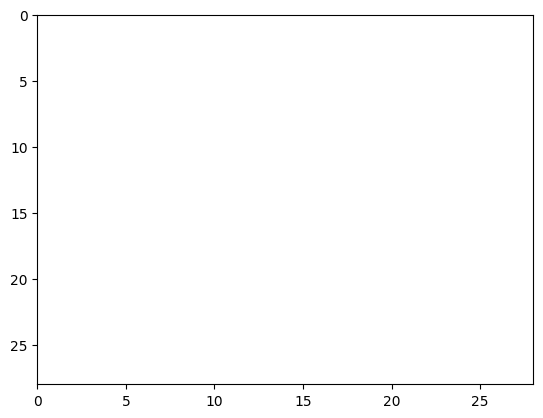

In [14]:
import pandas as pd
import numpy as np

for index_num in range(9):
    # Create an empty DataFrame
    df = pd.DataFrame(columns=["pred_prob", "circum", "num_size", "closed_loop", "average_distance", "variance_distance",
                               "k", "b","right_1","left_1", "longest_line_length", "is_nine"])

    # Define the ranges for pred_prob
    # ranges = [(0,0.1),(0.1, 0.2), (0.2,0.3), (0.3, 0.4),(0.4,0.5), (0.5, 0.6),(0.6,0.7),(0.7,0.8),(0.8,0.9),(0.9,1)]

    ranges = [(0.9,1)]

    num_images_per_range = 100

    # Find the indices of test images within each pred_prob range
    selected_indices = []
    for start, end in ranges:
        range_indices = [i for i, label in enumerate(y_test) if (start < predictions[i][index_num] < end)]
        selected_indices.extend(range_indices[:num_images_per_range])

    #
    for i, index in enumerate(selected_indices, start=1):
        prediction = predictions[index]
        image = x_test[index].reshape(28, 28)
        pred_prob = prediction[index_num]
        print(f'Prediction probability for digit 9: {pred_prob:.4f}')
        label = y_test[index]
        binary_image = image

        # Call the concise_feature_extraction function and store the result
        result = concise_feature_extraction(binary_image, pred_prob, (label[index_num] == 1))

        # Append the result to the DataFrame
        df = df.append(pd.Series(result, index=df.columns), ignore_index=True)

        # Save the image to the current folder
        # image_filename = f"{i}.png"
        # plt.imsave(image_filename, binary_image, cmap='gray')

    # Print the resulting DataFrame
    print(df)
    df.to_csv(str(index_num)+"_data.csv")


In [19]:
df.to_csv("0.3-0.7-158.csv")

In [3]:

import pandas as pd
import numpy as np

# Create an empty DataFrame
df = pd.DataFrame(columns=["pred_prob", "circum", "num_size", "closed_loop", "average_distance", "variance_distance",
                           "k", "right_1/left_1", "longest_line_length", "is_nine"])

# Find the indices of test images with digit "1"
digit_ones_indices = [i for i, label in enumerate(y_test) if (label[9] == 1 and 0.8<predictions[i][9] < 1) or
                      (label[9] == 0 and 0.8<predictions[i][9] < 1)]
for idx, index in enumerate(digit_ones_indices):
    prediction = predictions[index]
    image = x_test[index].reshape(28, 28)
    pred_prob = prediction[9]
    print(f'Prediction probability for digit 9: {pred_prob:.4f}')
    label = y_test[index]
    binary_image = image
    
    # Call the concise_feature_extraction function and store the result
    result = concise_feature_extraction(binary_image, pred_prob, (label[9] == 1))
    
    # Append the result to the DataFrame
    df = df.append(pd.Series(result, index=df.columns), ignore_index=True)
    
    # Save the corresponding digit image
    image_filename = f"{idx + 1}.png"  # Naming the image based on its position
    image_path = os.path.join("images_folder", image_filename)  # Adjust "images_folder" to your desired folder
    plt.imsave(image_path, binary_image, cmap="gray")  # Save the image as grayscale
    
# Print the resulting DataFrame
print(df)

Prediction probability for digit 9: 0.9815


NameError: name 'has_closed_loop' is not defined

Prediction probability for digit 9: 0.9815


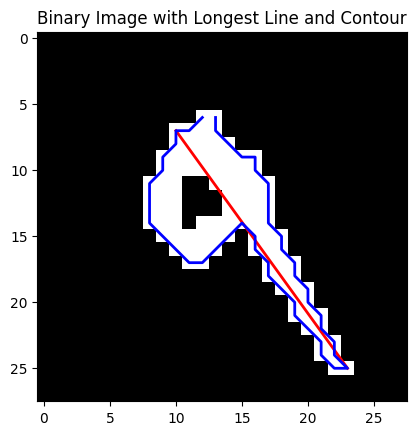

ValueError: Length of values (12) does not match length of index (10)

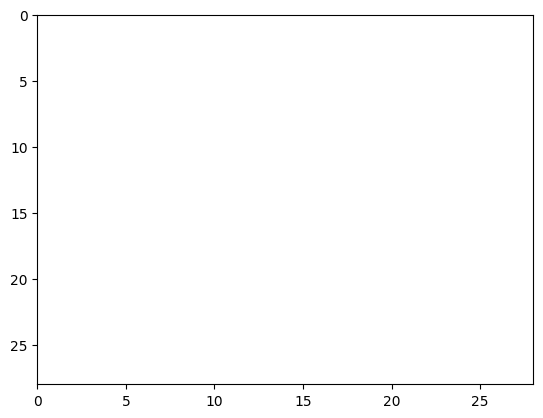

In [15]:
import pandas as pd
import numpy as np

# Create an empty DataFrame
df = pd.DataFrame(columns=["pred_prob", "circum", "num_size", "closed_loop", "average_distance", "variance_distance",
                           "k", "right_1/left_1", "longest_line_length", "is_nine"])

# Find the indices of test images with digit "1"
digit_ones_indices = [i for i, label in enumerate(y_test) if (label[9] == 1 and 0.8<predictions[i][9] < 1) or
                      (label[9] == 0 and 0.8<predictions[i][9] < 1)]
# digit_ones_indices = [i for i, label in enumerate(y_test) if (label[9] == 0 and  predictions[i][9]>0.2)]
# Output the probability predictions and images for digit "1"
for index in digit_ones_indices:
    prediction = predictions[index]
    image = x_test[index].reshape(28, 28)
    pred_prob = prediction[9]
    print(f'Prediction probability for digit 9: {pred_prob:.4f}')
    label = y_test[index]
    binary_image = image
    
    # Call the concise_feature_extraction function and store the result
    result = concise_feature_extraction(binary_image, pred_prob, (label[9] == 1))
    
    # Append the result to the DataFrame
    df = df.append(pd.Series(result, index=df.columns), ignore_index=True)

# Print the resulting DataFrame
print(df)


In [40]:
df.to_csv('df9.csv')

In [10]:
# Load the binary image file (MNIST mask)
image_path = 'test5.png'
binary_image = Image.open(image_path).convert('L')
print(batch_feature_extraction(binary_image,0))

TypeError: '<=' not supported between instances of 'Image' and 'float'

In [28]:
## Black Pixels



698 86 784


In [28]:
print(binary_image)

<PIL.Image.Image image mode=L size=28x28 at 0x1FC24621430>


In [12]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.datasets import mnist
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
import matplotlib.pyplot as plt 

# Load the MNIST dataset
(x_train, y_train), (x_test, y_test) = mnist.load_data()


# Choose the ratio you want between training set and test set
desired_test_ratio = 0.2  # For example, 20% for the test set

# Calculate the number of samples to move to the test set
num_samples_to_move = int(x_train.shape[0] * desired_test_ratio)

# Move samples from training set to test set
x_test = np.concatenate((x_test, x_train[:num_samples_to_move]), axis=0)
y_test = np.concatenate((y_test, y_train[:num_samples_to_move]), axis=0)

# Update the training set by removing the selected samples and labels
x_train = x_train[num_samples_to_move:]
y_train = y_train[num_samples_to_move:]




# Preprocess the data
x_train = x_train.reshape(-1, 784) / 255.0
x_test = x_test.reshape(-1, 784) / 255.0

# Convert the labels to one-hot encoded vectors
y_train = tf.keras.utils.to_categorical(y_train, num_classes=10)
y_test = tf.keras.utils.to_categorical(y_test, num_classes=10)

# Build the neural network model
model = Sequential()
model.add(Dense(64, activation='relu', input_shape=(784,)))
# model.add(Dense(64, activation='relu'))
model.add(Dense(10, activation='softmax'))

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=5, batch_size=32, verbose=1)

# Evaluate the model on the test set
loss, accuracy = model.evaluate(x_test, y_test, verbose=0)
print(f'Test loss: {loss:.4f}')
print(f'Test accuracy: {accuracy:.4f}')

# Make predictions on the test set
predictions = model.predict(x_test)



Epoch 1/5
1500/1500 [==============================] - 5s 2ms/step - loss: 0.3264 - accuracy: 0.9081
Epoch 2/5
1500/1500 [==============================] - 4s 2ms/step - loss: 0.1598 - accuracy: 0.9535
Epoch 3/5
1500/1500 [==============================] - 3s 2ms/step - loss: 0.1170 - accuracy: 0.9651
Epoch 4/5
1500/1500 [==============================] - 3s 2ms/step - loss: 0.0920 - accuracy: 0.9730
Epoch 5/5
1500/1500 [==============================] - 3s 2ms/step - loss: 0.0744 - accuracy: 0.9771
Test loss: 0.1056
Test accuracy: 0.9682
688/688 [==============================] - 1s 1ms/step


In [7]:
import pandas as pd
pd.DataFrame(predictions).to_csv("prediction.csv")

In [ ]:
import numpy as np
# Find the indices of test images with digit "1"
digit_ones_indices = [i for i, label in enumerate(y_test)]
print(digit_ones_indices)

solution = [];
# Output the probability predictions and images for digit "1"
for index in digit_ones_indices:
    prediction = predictions[index]
    image = x_test[index].reshape(28, 28)
    pred_prob = prediction[9]
    print(f'Prediction probability for digit 9: {pred_prob:.4f}')
    
    # plt.imshow(image, cmap='gray')
    # plt.axis('off')
    # plt.show()


[151, 813, 882, 1107, 1192, 1232, 1247, 1553, 1709, 1901, 1952, 2129, 2293, 2387, 2414, 2582, 2648, 2720, 2939, 3005, 3060, 3503, 3869, 4000, 4078, 4163, 4224, 4294, 4369, 4425, 4761, 4823, 4874, 6071, 6166, 6172, 6173, 6560, 6571, 6608, 6740, 6817, 7459, 7991, 9587, 9642, 9692, 9808, 9891]
Prediction probability for digit 9: 0.6690
Size of the number 0.18622448979591838
Has closed loop: False


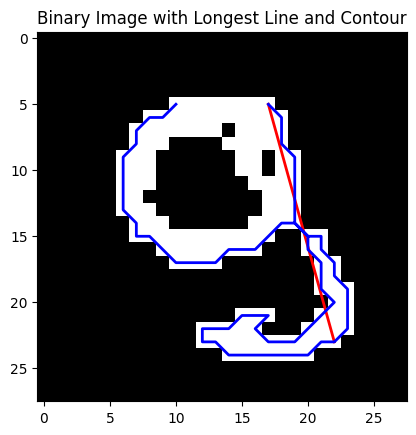

----------------Circumference-------------
Circumference: 108
----------------Aggregations---------------
Centroid: (13.89041095890411, 14.582191780821917)
Aggregation: 7.204100766293749
Variance of Distance to Centroid: 6.811618957117336
----------------Dominant Line---------------
k/b of dominant line 0.2777777777777778 15.61111111111111
----------------symmetry---------------
Number of '1' in the left part: 29
Number of '0' in the left part: 199
Number of '1' in the right part: 117
Number of '0' in the right part: 439
----------------Longest Line Length---------------
Endpoint 1: (17, 5)
Endpoint 2: (22, 23)
Length: 18.681541692269406


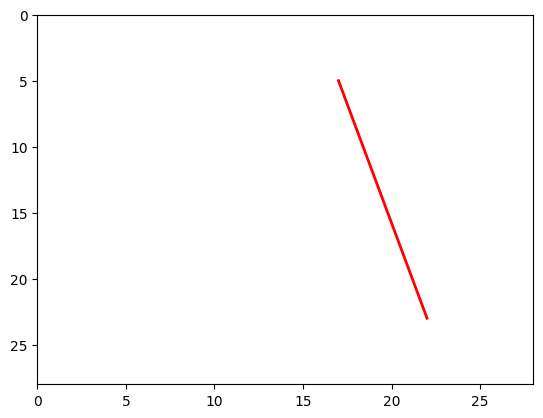

(108, 0.186, False, 7.204, 6.812, 0.278, 4.034, 18.682)
Prediction probability for digit 9: 0.5331
Size of the number 0.17091836734693877
Has closed loop: False


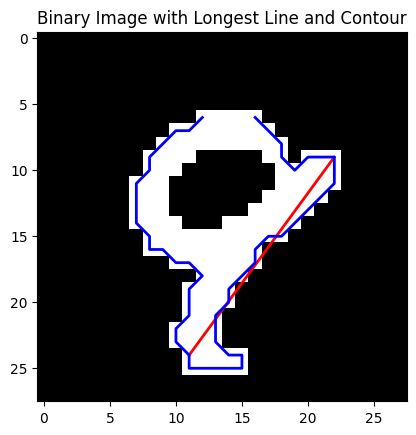

----------------Circumference-------------
Circumference: 76
----------------Aggregations---------------
Centroid: (14.171641791044776, 13.582089552238806)
Aggregation: 6.086146734423819
Variance of Distance to Centroid: 5.80694668625141
----------------Dominant Line---------------
k/b of dominant line -0.7333333333333333 28.6
----------------symmetry---------------
Number of '1' in the left part: 107
Number of '0' in the left part: 430
Number of '1' in the right part: 27
Number of '0' in the right part: 220
----------------Longest Line Length---------------
Endpoint 1: (22, 9)
Endpoint 2: (11, 24)
Length: 18.601075237738275


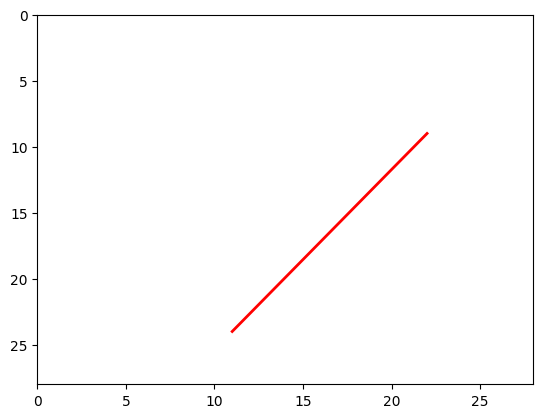

(76, 0.171, False, 6.086, 5.807, -0.733, 0.252, 18.601)
Prediction probability for digit 9: 0.6312
Size of the number 0.09311224489795919
Has closed loop: False


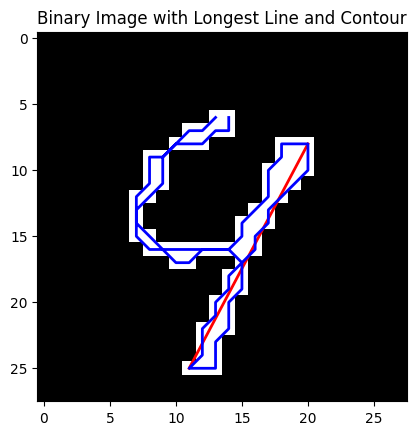

----------------Circumference-------------
Circumference: 66
----------------Aggregations---------------
Centroid: (14.205479452054794, 13.356164383561644)
Aggregation: 6.0182952646660395
Variance of Distance to Centroid: 5.213786959991132
----------------Dominant Line---------------
k/b of dominant line -0.5294117647058824 24.235294117647058
----------------symmetry---------------
Number of '1' in the left part: 53
Number of '0' in the left part: 439
Number of '1' in the right part: 20
Number of '0' in the right part: 272
----------------Longest Line Length---------------
Endpoint 1: (20, 8)
Endpoint 2: (11, 25)
Length: 19.235384061671343


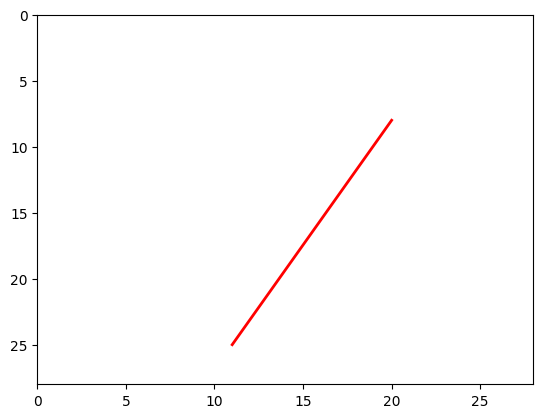

(66, 0.093, False, 6.018, 5.214, -0.529, 0.377, 19.235)
Prediction probability for digit 9: 0.6142
Size of the number 0.20280612244897958
Has closed loop: False


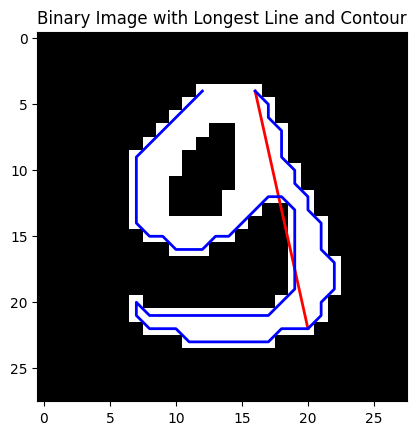

----------------Circumference-------------
Circumference: 96
----------------Aggregations---------------
Centroid: (13.767295597484276, 14.320754716981131)
Aggregation: 6.779318697574926
Variance of Distance to Centroid: 5.519023195081341
----------------Dominant Line---------------
k/b of dominant line 0.2222222222222222 15.11111111111111
----------------symmetry---------------
Number of '1' in the left part: 40
Number of '0' in the left part: 224
Number of '1' in the right part: 119
Number of '0' in the right part: 401
----------------Longest Line Length---------------
Endpoint 1: (16, 4)
Endpoint 2: (20, 22)
Length: 18.439088914585774


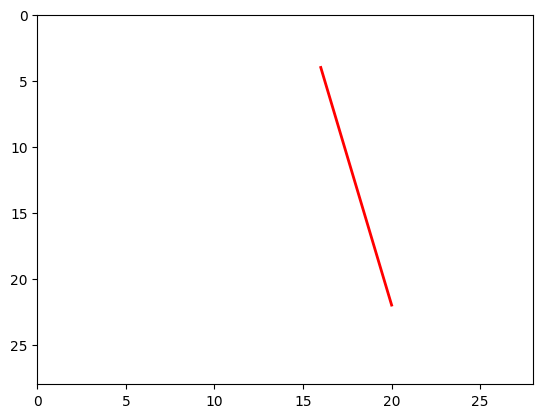

(96, 0.203, False, 6.779, 5.519, 0.222, 2.975, 18.439)
Prediction probability for digit 9: 0.3973
Size of the number 0.07908163265306123
Has closed loop: False


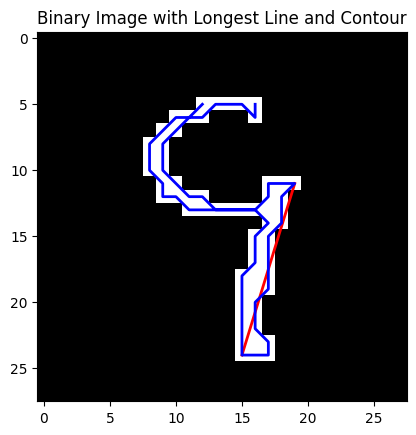

----------------Circumference-------------
Circumference: 58
----------------Aggregations---------------
Centroid: (13.709677419354838, 14.096774193548388)
Aggregation: 5.9170759820963506
Variance of Distance to Centroid: 6.7977851831807135
----------------Dominant Line---------------
k/b of dominant line -0.3076923076923077 22.384615384615387
----------------symmetry---------------
Number of '1' in the left part: 44
Number of '0' in the left part: 482
Number of '1' in the right part: 18
Number of '0' in the right part: 240
----------------Longest Line Length---------------
Endpoint 1: (19, 11)
Endpoint 2: (15, 24)
Length: 13.601470508735444


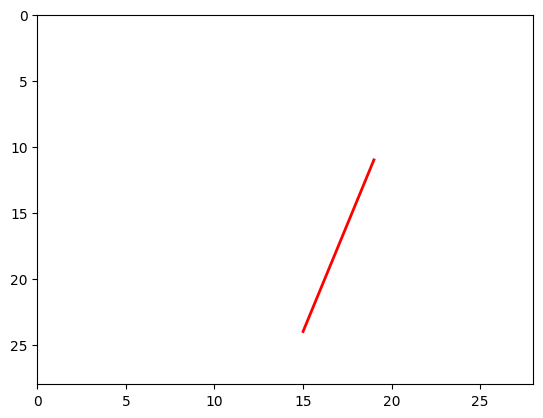

(58, 0.079, False, 5.917, 6.798, -0.308, 0.409, 13.601)
Prediction probability for digit 9: 0.0112
Size of the number 0.125
Has closed loop: False


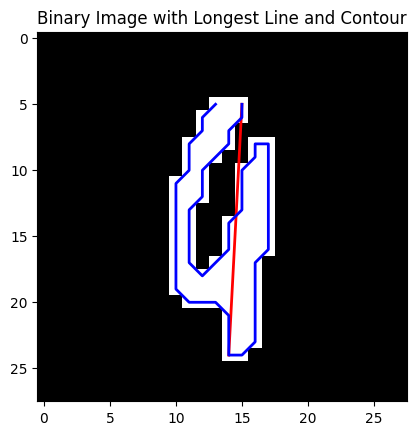

----------------Circumference-------------
Circumference: 64
----------------Aggregations---------------
Centroid: (14.316326530612244, 13.714285714285714)
Aggregation: 5.0570529504390915
Variance of Distance to Centroid: 4.764928492690182
----------------Dominant Line---------------
k/b of dominant line -0.05263157894736842 15.263157894736842
----------------symmetry---------------
Number of '1' in the left part: 49
Number of '0' in the left part: 374
Number of '1' in the right part: 49
Number of '0' in the right part: 312
----------------Longest Line Length---------------
Endpoint 1: (15, 5)
Endpoint 2: (14, 24)
Length: 19.026297590440446


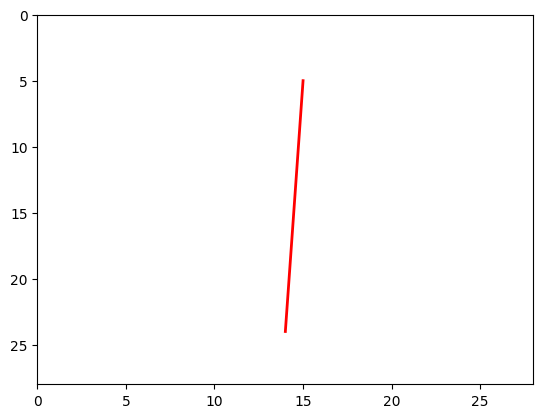

(64, 0.125, False, 5.057, 4.765, -0.053, 1.0, 19.026)
Prediction probability for digit 9: 0.0031
Size of the number 0.17729591836734693
Has closed loop: False


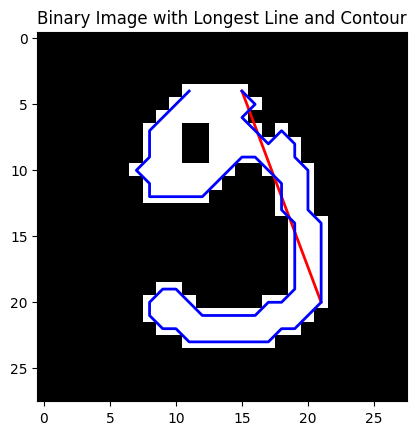

----------------Circumference-------------
Circumference: 83
----------------Aggregations---------------
Centroid: (13.43884892086331, 14.453237410071942)
Aggregation: 7.132960810572048
Variance of Distance to Centroid: 3.4422820100433937
----------------Dominant Line---------------
k/b of dominant line 0.375 13.5
----------------symmetry---------------
Number of '1' in the left part: 37
Number of '0' in the left part: 212
Number of '1' in the right part: 102
Number of '0' in the right part: 433
----------------Longest Line Length---------------
Endpoint 1: (15, 4)
Endpoint 2: (21, 20)
Length: 17.08800749063506


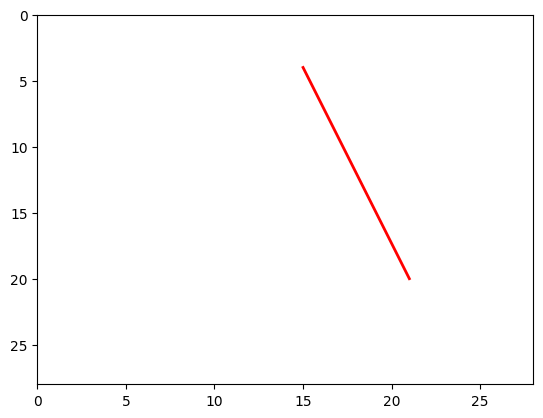

(83, 0.177, False, 7.133, 3.442, 0.375, 2.757, 17.088)
Prediction probability for digit 9: 0.5632
Size of the number 0.19387755102040816
Has closed loop: False


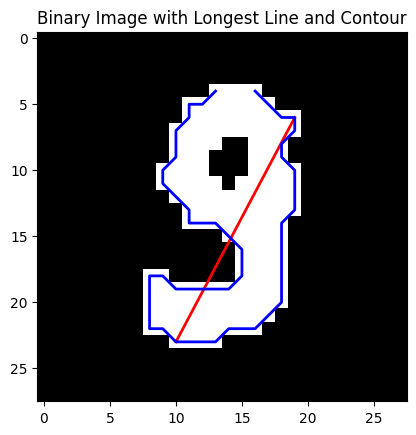

----------------Circumference-------------
Circumference: 69
----------------Aggregations---------------
Centroid: (13.605263157894736, 13.980263157894736)
Aggregation: 5.9356506345542215
Variance of Distance to Centroid: 6.000002721801384
----------------Dominant Line---------------
k/b of dominant line -0.5294117647058824 22.176470588235293
----------------symmetry---------------
Number of '1' in the left part: 83
Number of '0' in the left part: 351
Number of '1' in the right part: 69
Number of '0' in the right part: 281
----------------Longest Line Length---------------
Endpoint 1: (19, 6)
Endpoint 2: (10, 23)
Length: 19.235384061671343


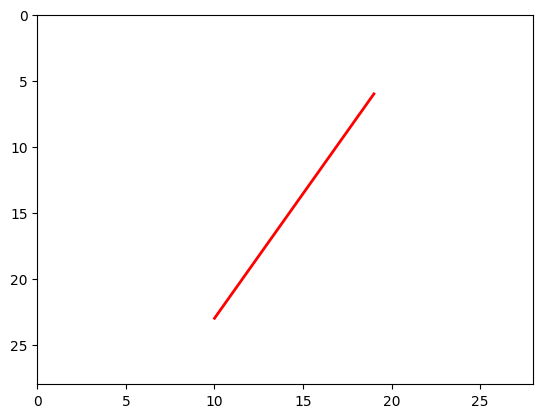

(69, 0.194, False, 5.936, 6.0, -0.529, 0.831, 19.235)
Prediction probability for digit 9: 0.4246
Size of the number 0.07653061224489796
Has closed loop: False


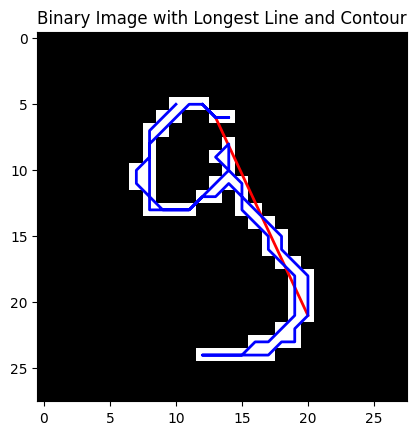

----------------Circumference-------------
Circumference: 60
----------------Aggregations---------------
Centroid: (14.45, 14.1)
Aggregation: 6.7600487769332
Variance of Distance to Centroid: 6.80590720015062
----------------Dominant Line---------------
k/b of dominant line 0.4666666666666667 10.2
----------------symmetry---------------
Number of '1' in the left part: 16
Number of '0' in the left part: 292
Number of '1' in the right part: 44
Number of '0' in the right part: 432
----------------Longest Line Length---------------
Endpoint 1: (13, 6)
Endpoint 2: (20, 21)
Length: 16.55294535724685


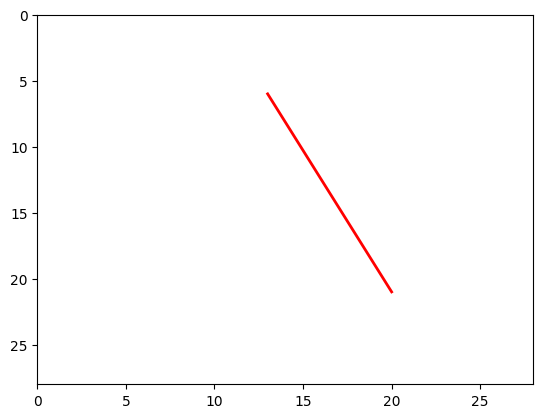

(60, 0.077, False, 6.76, 6.806, 0.467, 2.75, 16.553)
Prediction probability for digit 9: 0.0341
Size of the number 0.08418367346938775
Has closed loop: False


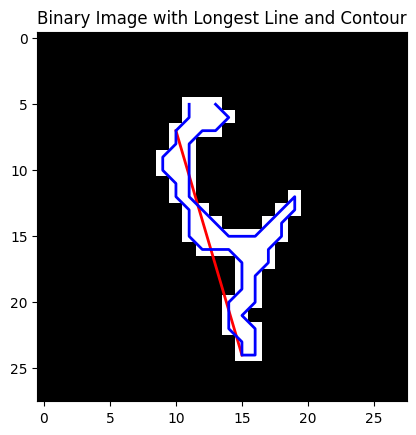

----------------Circumference-------------
Circumference: 52
----------------Aggregations---------------
Centroid: (13.984848484848484, 13.621212121212121)
Aggregation: 5.305160235798622
Variance of Distance to Centroid: 6.317625653033709
----------------Dominant Line---------------
k/b of dominant line 0.29411764705882354 7.9411764705882355
----------------symmetry---------------
Number of '1' in the left part: 43
Number of '0' in the left part: 393
Number of '1' in the right part: 23
Number of '0' in the right part: 325
----------------Longest Line Length---------------
Endpoint 1: (15, 24)
Endpoint 2: (10, 7)
Length: 17.72004514666935


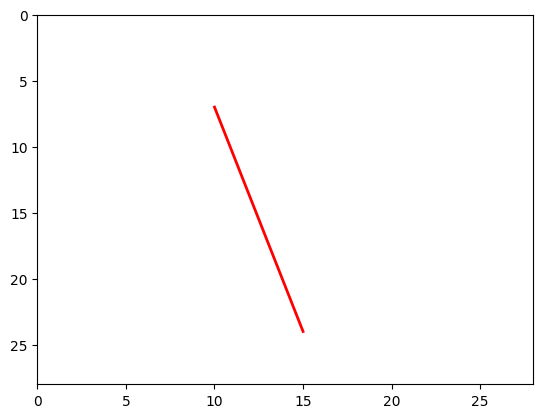

(52, 0.084, False, 5.305, 6.318, 0.294, 0.535, 17.72)
Prediction probability for digit 9: 0.1401
Size of the number 0.11479591836734694
Has closed loop: False


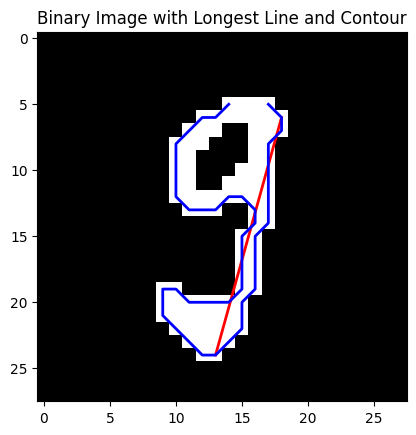

----------------Circumference-------------
Circumference: 68
----------------Aggregations---------------
Centroid: (13.911111111111111, 13.644444444444444)
Aggregation: 5.986982064803806
Variance of Distance to Centroid: 5.59950254584101
----------------Dominant Line---------------
k/b of dominant line -0.2777777777777778 19.666666666666668
----------------symmetry---------------
Number of '1' in the left part: 54
Number of '0' in the left part: 407
Number of '1' in the right part: 36
Number of '0' in the right part: 287
----------------Longest Line Length---------------
Endpoint 1: (18, 6)
Endpoint 2: (13, 24)
Length: 18.681541692269406


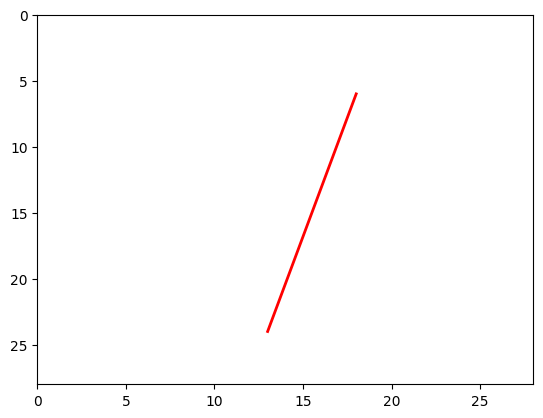

(68, 0.115, False, 5.987, 5.6, -0.278, 0.667, 18.682)
Prediction probability for digit 9: 0.1361
Size of the number 0.16964285714285715
Has closed loop: False


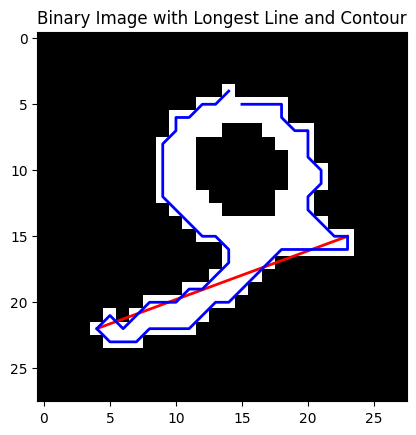

----------------Circumference-------------
Circumference: 84
----------------Aggregations---------------
Centroid: (13.563909774436091, 14.105263157894736)
Aggregation: 6.394796555350925
Variance of Distance to Centroid: 7.356449817978466
----------------Dominant Line---------------
k/b of dominant line -2.714285714285714 63.71428571428571
----------------symmetry---------------
Number of '1' in the left part: 111
Number of '0' in the left part: 420
Number of '1' in the right part: 22
Number of '0' in the right part: 231
----------------Longest Line Length---------------
Endpoint 1: (23, 15)
Endpoint 2: (4, 22)
Length: 20.248456731316587


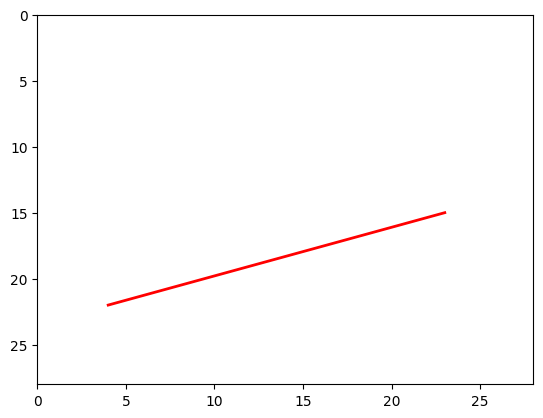

(84, 0.17, False, 6.395, 7.356, -2.714, 0.198, 20.248)
Prediction probability for digit 9: 0.0000
Size of the number 0.24872448979591838
Has closed loop: False


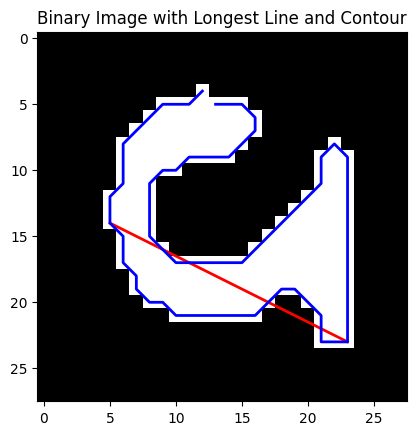

----------------Circumference-------------
Circumference: 83
----------------Aggregations---------------
Centroid: (14.153846153846153, 14.384615384615385)
Aggregation: 7.342906929259206
Variance of Distance to Centroid: 3.9460176309984876
----------------Dominant Line---------------
k/b of dominant line 2.0 -23.0
----------------symmetry---------------
Number of '1' in the left part: 140
Number of '0' in the left part: 378
Number of '1' in the right part: 55
Number of '0' in the right part: 211
----------------Longest Line Length---------------
Endpoint 1: (23, 23)
Endpoint 2: (5, 14)
Length: 20.12461179749811


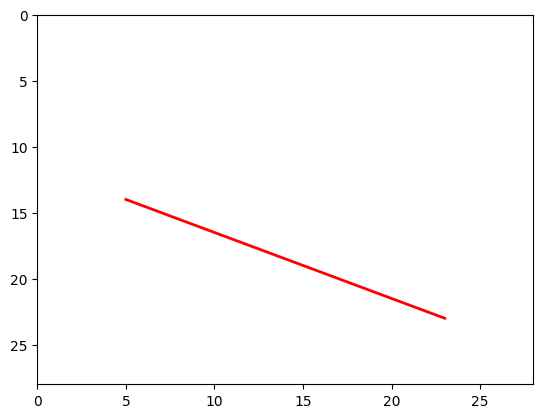

(83, 0.249, False, 7.343, 3.946, 2.0, 0.393, 20.125)
Prediction probability for digit 9: 0.1995
Size of the number 0.09693877551020408
Has closed loop: False


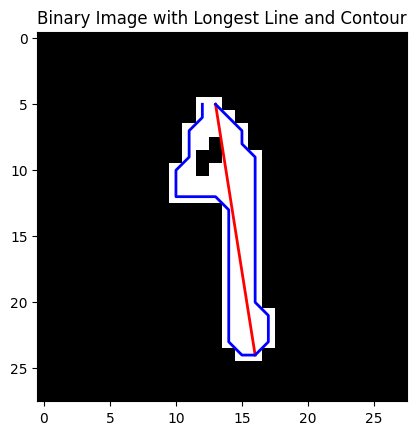

----------------Circumference-------------
Circumference: 50
----------------Aggregations---------------
Centroid: (13.947368421052632, 14.144736842105264)
Aggregation: 5.1590560841351705
Variance of Distance to Centroid: 6.55778990523542
----------------Dominant Line---------------
k/b of dominant line 0.15789473684210525 12.210526315789474
----------------symmetry---------------
Number of '1' in the left part: 32
Number of '0' in the left part: 335
Number of '1' in the right part: 44
Number of '0' in the right part: 373
----------------Longest Line Length---------------
Endpoint 1: (13, 5)
Endpoint 2: (16, 24)
Length: 19.235384061671343


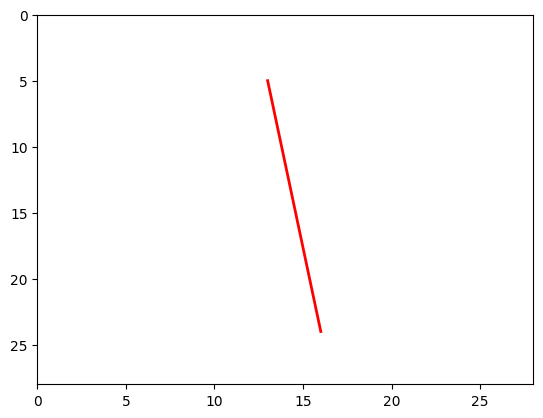

(50, 0.097, False, 5.159, 6.558, 0.158, 1.375, 19.235)
Prediction probability for digit 9: 0.3617
Size of the number 0.11734693877551021
Has closed loop: False


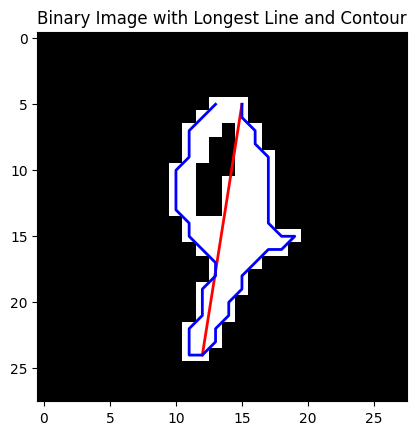

----------------Circumference-------------
Circumference: 60
----------------Aggregations---------------
Centroid: (13.76086956521739, 13.815217391304348)
Aggregation: 4.842514085871713
Variance of Distance to Centroid: 5.947859785600971
----------------Dominant Line---------------
k/b of dominant line -0.15789473684210525 15.789473684210526
----------------symmetry---------------
Number of '1' in the left part: 45
Number of '0' in the left part: 350
Number of '1' in the right part: 47
Number of '0' in the right part: 342
----------------Longest Line Length---------------
Endpoint 1: (15, 5)
Endpoint 2: (12, 24)
Length: 19.235384061671343


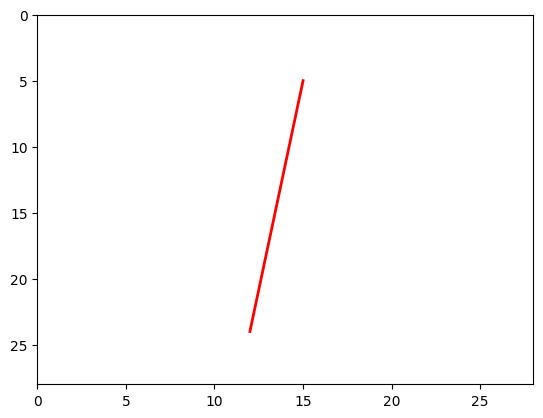

(60, 0.117, False, 4.843, 5.948, -0.158, 1.044, 19.235)
Prediction probability for digit 9: 0.6521
Size of the number 0.12372448979591837
Has closed loop: False


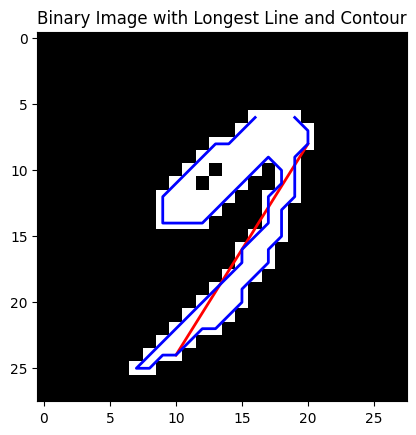

----------------Circumference-------------
Circumference: 64
----------------Aggregations---------------
Centroid: (13.711340206185566, 14.24742268041237)
Aggregation: 5.709834445250438
Variance of Distance to Centroid: 6.593454334051209
----------------Dominant Line---------------
k/b of dominant line -0.625 25.0
----------------symmetry---------------
Number of '1' in the left part: 61
Number of '0' in the left part: 415
Number of '1' in the right part: 36
Number of '0' in the right part: 272
----------------Longest Line Length---------------
Endpoint 1: (20, 8)
Endpoint 2: (10, 24)
Length: 18.867962264113206


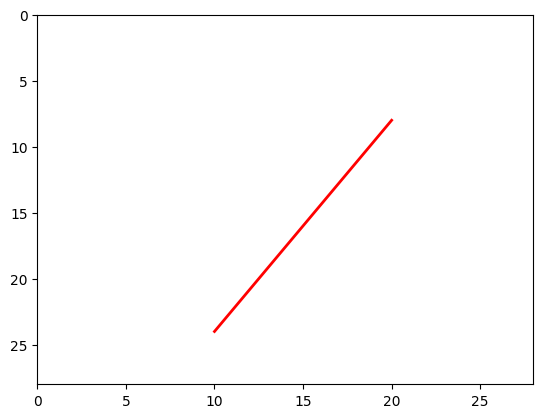

(64, 0.124, False, 5.71, 6.593, -0.625, 0.59, 18.868)
Prediction probability for digit 9: 0.0998
Size of the number 0.16454081632653061
Has closed loop: False


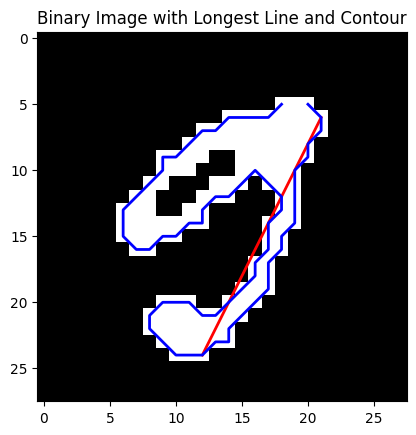

----------------Circumference-------------
Circumference: 85
----------------Aggregations---------------
Centroid: (13.44186046511628, 13.689922480620154)
Aggregation: 6.521362253777519
Variance of Distance to Centroid: 5.002151042704859
----------------Dominant Line---------------
k/b of dominant line -0.5 24.0
----------------symmetry---------------
Number of '1' in the left part: 89
Number of '0' in the left part: 401
Number of '1' in the right part: 40
Number of '0' in the right part: 254
----------------Longest Line Length---------------
Endpoint 1: (21, 6)
Endpoint 2: (12, 24)
Length: 20.12461179749811


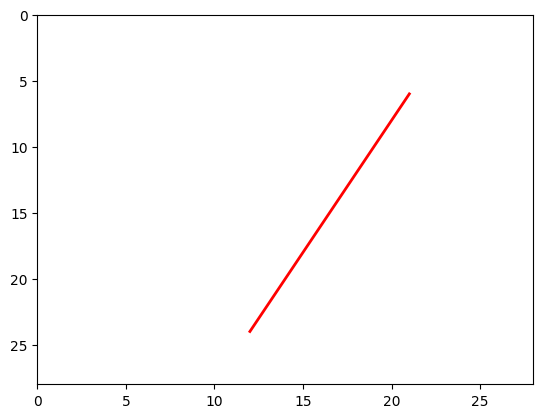

(85, 0.165, False, 6.521, 5.002, -0.5, 0.449, 20.125)
Prediction probability for digit 9: 0.5937
Size of the number 0.13520408163265307
Has closed loop: False


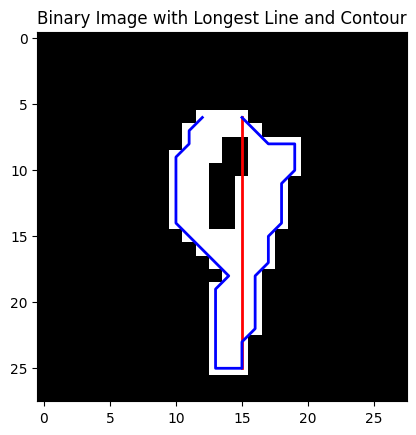

----------------Circumference-------------
Circumference: 63
----------------Aggregations---------------
Centroid: (14.132075471698114, 14.330188679245284)
Aggregation: 5.224970292044058
Variance of Distance to Centroid: 5.884537707847982
----------------Dominant Line---------------
k/b of dominant line 0.0 15.0
----------------symmetry---------------
Number of '1' in the left part: 39
Number of '0' in the left part: 297
Number of '1' in the right part: 67
Number of '0' in the right part: 381
----------------Longest Line Length---------------
Endpoint 1: (15, 6)
Endpoint 2: (15, 25)
Length: 19.0


C:\Users\zimin\AppData\Local\Temp\ipykernel_26968\4038064313.py:11: RuntimeWarning: divide by zero encountered in double_scalars
  if x < (y-b)/k:  # Left part
C:\Users\zimin\AppData\Local\Temp\ipykernel_26968\4038064313.py:11: RuntimeWarning: invalid value encountered in double_scalars
  if x < (y-b)/k:  # Left part


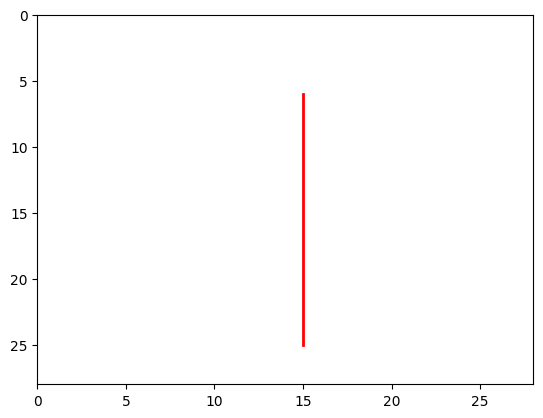

(63, 0.135, False, 5.225, 5.885, 0.0, 1.718, 19.0)
Prediction probability for digit 9: 0.0069
Size of the number 0.1568877551020408
Has closed loop: False


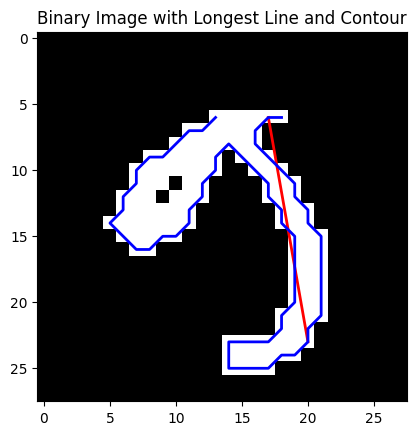

----------------Circumference-------------
Circumference: 76
----------------Aggregations---------------
Centroid: (14.1869918699187, 14.284552845528456)
Aggregation: 6.966707776575272
Variance of Distance to Centroid: 3.7718107021338803
----------------Dominant Line---------------
k/b of dominant line 0.1764705882352941 15.941176470588236
----------------symmetry---------------
Number of '1' in the left part: 27
Number of '0' in the left part: 229
Number of '1' in the right part: 96
Number of '0' in the right part: 432
----------------Longest Line Length---------------
Endpoint 1: (17, 6)
Endpoint 2: (20, 23)
Length: 17.26267650163207


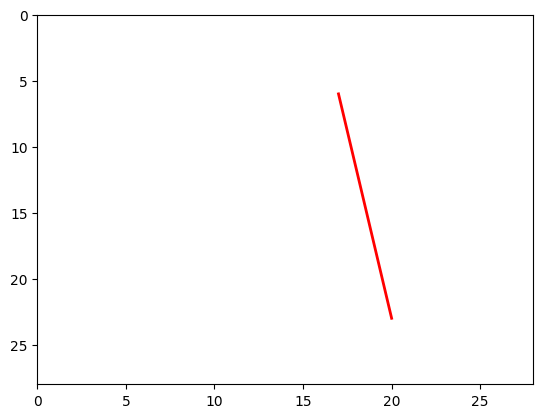

(76, 0.157, False, 6.967, 3.772, 0.176, 3.556, 17.263)
Prediction probability for digit 9: 0.5108
Size of the number 0.08928571428571429
Has closed loop: False


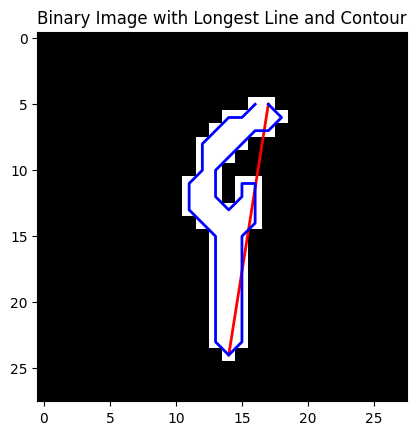

----------------Circumference-------------
Circumference: 46
----------------Aggregations---------------
Centroid: (13.628571428571428, 14.042857142857143)
Aggregation: 4.868557060594901
Variance of Distance to Centroid: 7.057356229364193
----------------Dominant Line---------------
k/b of dominant line -0.15789473684210525 17.789473684210527
----------------symmetry---------------
Number of '1' in the left part: 45
Number of '0' in the left part: 408
Number of '1' in the right part: 25
Number of '0' in the right part: 306
----------------Longest Line Length---------------
Endpoint 1: (17, 5)
Endpoint 2: (14, 24)
Length: 19.235384061671343


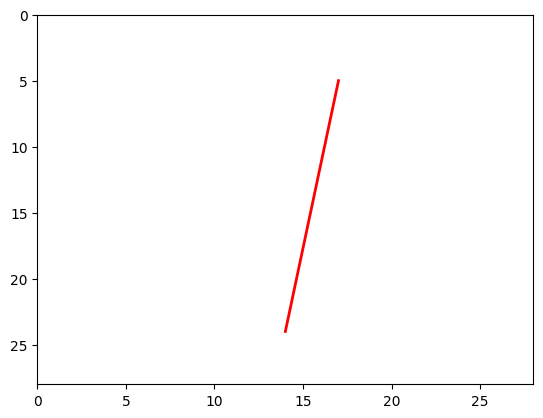

(46, 0.089, False, 4.869, 7.057, -0.158, 0.556, 19.235)
Prediction probability for digit 9: 0.1308
Size of the number 0.0548469387755102
Has closed loop: False


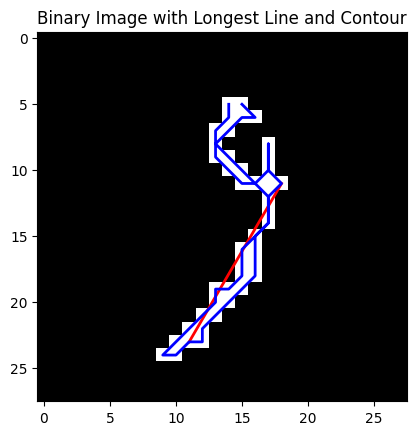

----------------Circumference-------------
Circumference: 42
----------------Aggregations---------------
Centroid: (14.30232558139535, 14.325581395348838)
Aggregation: 5.89341649785318
Variance of Distance to Centroid: 6.163261236482577
----------------Dominant Line---------------
k/b of dominant line -0.5833333333333333 24.416666666666664
----------------symmetry---------------
Number of '1' in the left part: 23
Number of '0' in the left part: 453
Number of '1' in the right part: 20
Number of '0' in the right part: 288
----------------Longest Line Length---------------
Endpoint 1: (18, 11)
Endpoint 2: (11, 23)
Length: 13.892443989449804


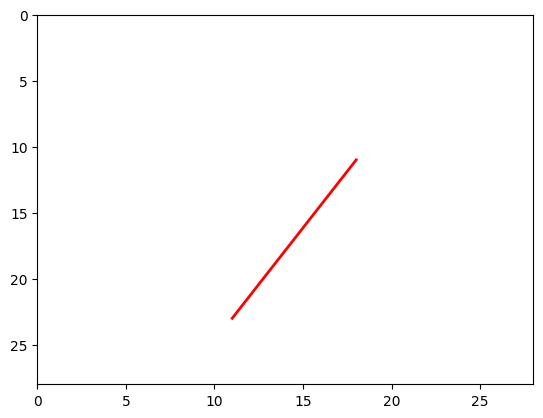

(42, 0.055, False, 5.893, 6.163, -0.583, 0.87, 13.892)
Prediction probability for digit 9: 0.1013
Size of the number 0.09948979591836735
Has closed loop: False


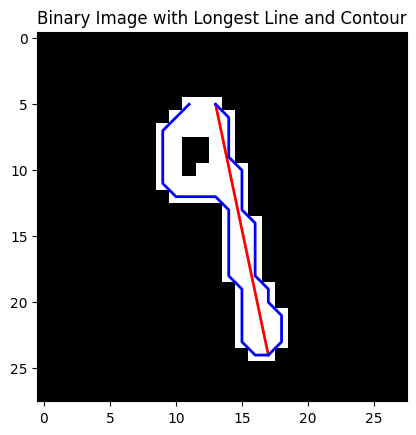

----------------Circumference-------------
Circumference: 53
----------------Aggregations---------------
Centroid: (13.576923076923077, 13.717948717948717)
Aggregation: 5.571241811091076
Variance of Distance to Centroid: 7.279640750726687
----------------Dominant Line---------------
k/b of dominant line 0.21052631578947367 11.947368421052632
----------------symmetry---------------
Number of '1' in the left part: 30
Number of '0' in the left part: 325
Number of '1' in the right part: 48
Number of '0' in the right part: 381
----------------Longest Line Length---------------
Endpoint 1: (13, 5)
Endpoint 2: (17, 24)
Length: 19.4164878389476


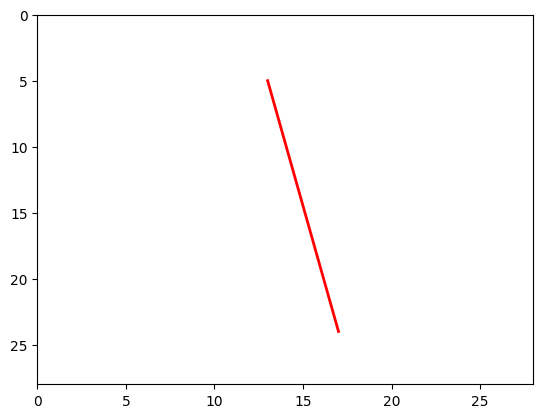

(53, 0.099, False, 5.571, 7.28, 0.211, 1.6, 19.416)
Prediction probability for digit 9: 0.1382
Size of the number 0.19005102040816327
Has closed loop: False


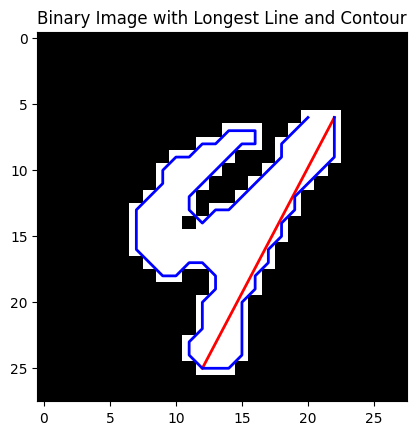

----------------Circumference-------------
Circumference: 68
----------------Aggregations---------------
Centroid: (14.268456375838927, 14.053691275167786)
Aggregation: 5.650314377264152
Variance of Distance to Centroid: 6.589599886169938
----------------Dominant Line---------------
k/b of dominant line -0.5263157894736842 25.157894736842106
----------------symmetry---------------
Number of '1' in the left part: 115
Number of '0' in the left part: 406
Number of '1' in the right part: 34
Number of '0' in the right part: 229
----------------Longest Line Length---------------
Endpoint 1: (22, 6)
Endpoint 2: (12, 25)
Length: 21.470910553583888


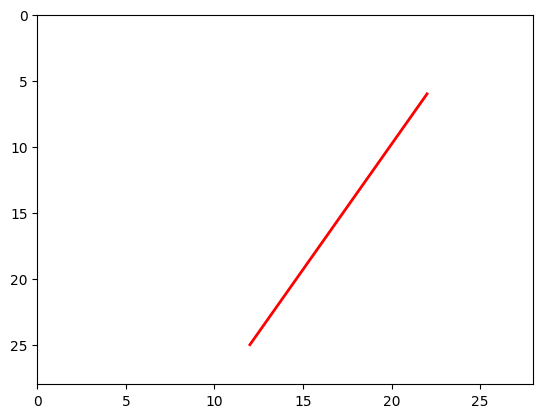

(68, 0.19, False, 5.65, 6.59, -0.526, 0.296, 21.471)
Prediction probability for digit 9: 0.5442
Size of the number 0.15433673469387754
Has closed loop: False


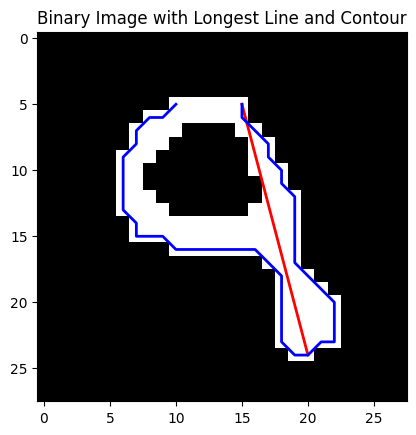

----------------Circumference-------------
Circumference: 78
----------------Aggregations---------------
Centroid: (13.809917355371901, 14.388429752066116)
Aggregation: 6.499164465488614
Variance of Distance to Centroid: 8.13583563752552
----------------Dominant Line---------------
k/b of dominant line 0.2631578947368421 13.68421052631579
----------------symmetry---------------
Number of '1' in the left part: 25
Number of '0' in the left part: 263
Number of '1' in the right part: 96
Number of '0' in the right part: 400
----------------Longest Line Length---------------
Endpoint 1: (15, 5)
Endpoint 2: (20, 24)
Length: 19.6468827043885


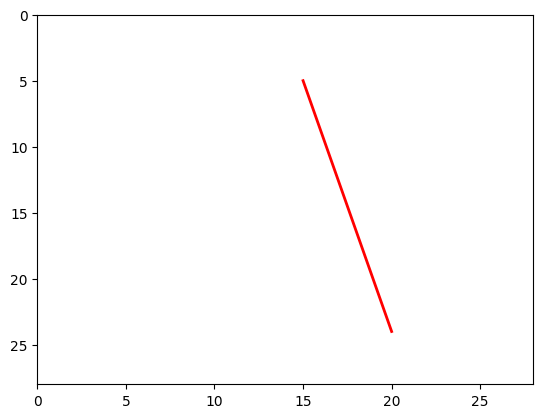

(78, 0.154, False, 6.499, 8.136, 0.263, 3.84, 19.647)
Prediction probability for digit 9: 0.0197
Size of the number 0.22193877551020408
Has closed loop: False


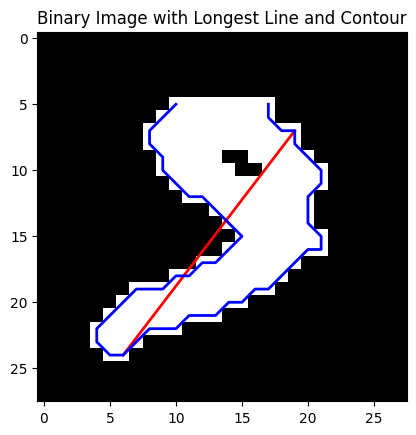

----------------Circumference-------------
Circumference: 67
----------------Aggregations---------------
Centroid: (13.511494252873563, 13.597701149425287)
Aggregation: 6.30031427504211
Variance of Distance to Centroid: 6.922799184861661
----------------Dominant Line---------------
k/b of dominant line -0.7647058823529411 24.352941176470587
----------------symmetry---------------
Number of '1' in the left part: 75
Number of '0' in the left part: 331
Number of '1' in the right part: 99
Number of '0' in the right part: 279
----------------Longest Line Length---------------
Endpoint 1: (19, 7)
Endpoint 2: (6, 24)
Length: 21.400934559032695


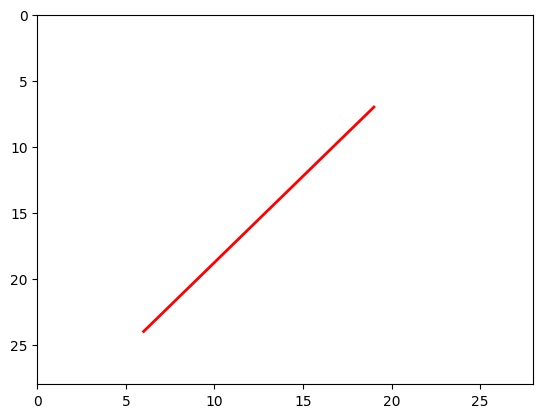

(67, 0.222, False, 6.3, 6.923, -0.765, 1.32, 21.401)
Prediction probability for digit 9: 0.0881
Size of the number 0.1326530612244898
Has closed loop: False


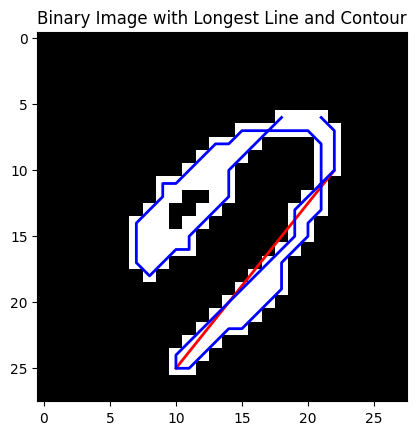

----------------Circumference-------------
Circumference: 80
----------------Aggregations---------------
Centroid: (14.163461538461538, 14.384615384615385)
Aggregation: 6.439239650823416
Variance of Distance to Centroid: 4.621159435239848
----------------Dominant Line---------------
k/b of dominant line -0.8 30.0
----------------symmetry---------------
Number of '1' in the left part: 70
Number of '0' in the left part: 474
Number of '1' in the right part: 34
Number of '0' in the right part: 206
----------------Longest Line Length---------------
Endpoint 1: (22, 10)
Endpoint 2: (10, 25)
Length: 19.209372712298546


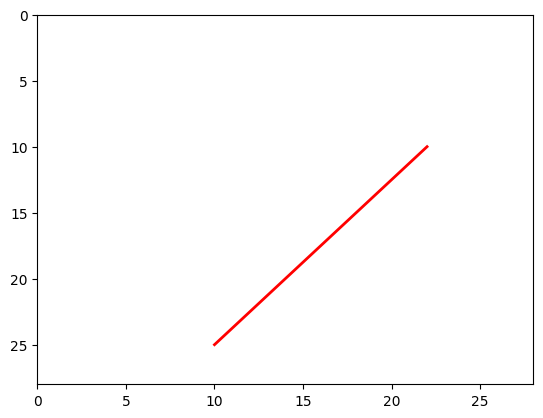

(80, 0.133, False, 6.439, 4.621, -0.8, 0.486, 19.209)
Prediction probability for digit 9: 0.2487
Size of the number 0.08545918367346939
Has closed loop: False


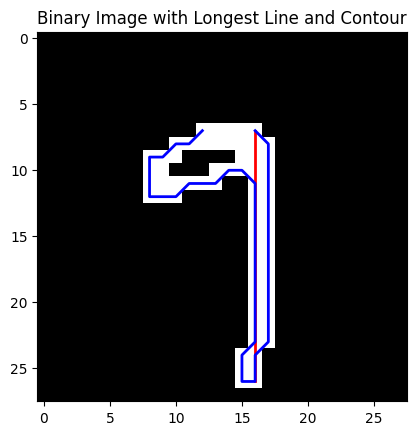

----------------Circumference-------------
Circumference: 62
----------------Aggregations---------------
Centroid: (13.686567164179104, 14.283582089552239)
Aggregation: 5.895628419814853
Variance of Distance to Centroid: 6.286787188400802
----------------Dominant Line---------------
k/b of dominant line 0.0 16.0
----------------symmetry---------------
Number of '1' in the left part: 20
Number of '0' in the left part: 288
Number of '1' in the right part: 47
Number of '0' in the right part: 429
----------------Longest Line Length---------------
Endpoint 1: (16, 7)
Endpoint 2: (16, 26)
Length: 19.0


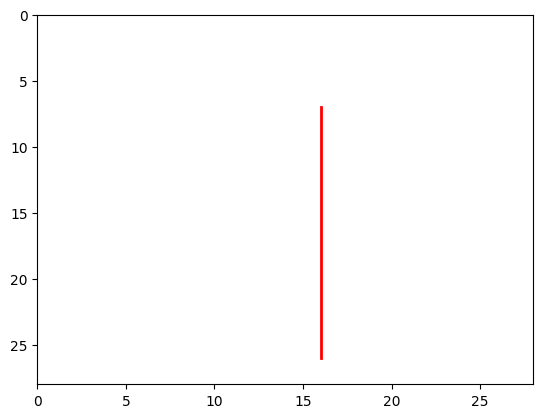

(62, 0.085, False, 5.896, 6.287, 0.0, 2.35, 19.0)
Prediction probability for digit 9: 0.5910
Size of the number 0.18112244897959184
Has closed loop: False


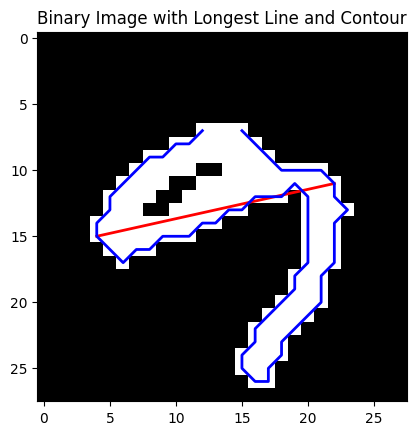

----------------Circumference-------------
Circumference: 80
----------------Aggregations---------------
Centroid: (14.084507042253522, 14.26056338028169)
Aggregation: 6.677096898544339
Variance of Distance to Centroid: 5.418807080847696
----------------Dominant Line---------------
k/b of dominant line -4.5 71.5
----------------symmetry---------------
Number of '1' in the left part: 60
Number of '0' in the left part: 313
Number of '1' in the right part: 82
Number of '0' in the right part: 329
----------------Longest Line Length---------------
Endpoint 1: (22, 11)
Endpoint 2: (4, 15)
Length: 18.439088914585774


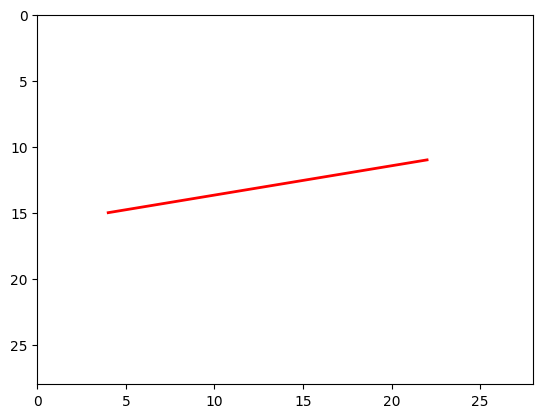

(80, 0.181, False, 6.677, 5.419, -4.5, 1.367, 18.439)
Prediction probability for digit 9: 0.5743
Size of the number 0.07908163265306123
Has closed loop: False


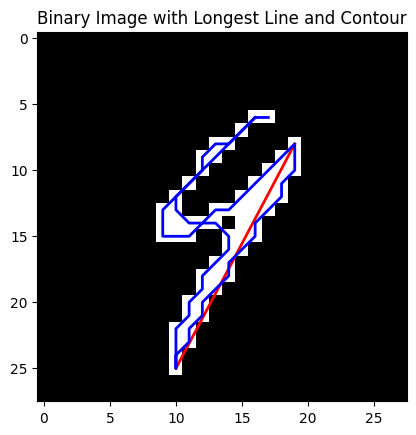

----------------Circumference-------------
Circumference: 53
----------------Aggregations---------------
Centroid: (14.209677419354838, 13.596774193548388)
Aggregation: 4.811074444162045
Variance of Distance to Centroid: 6.2921683118775835
----------------Dominant Line---------------
k/b of dominant line -0.5294117647058824 23.235294117647058
----------------symmetry---------------
Number of '1' in the left part: 42
Number of '0' in the left part: 422
Number of '1' in the right part: 20
Number of '0' in the right part: 300
----------------Longest Line Length---------------
Endpoint 1: (19, 8)
Endpoint 2: (10, 25)
Length: 19.235384061671343


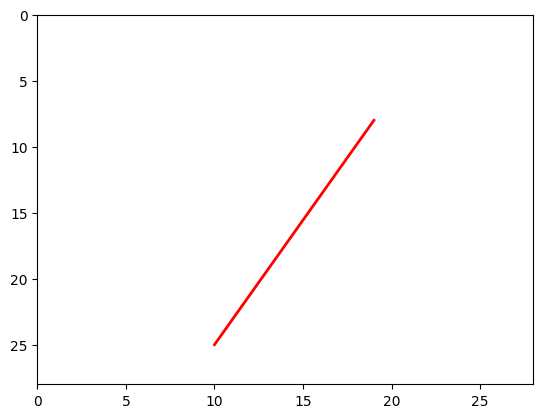

(53, 0.079, False, 4.811, 6.292, -0.529, 0.476, 19.235)
Prediction probability for digit 9: 0.5351
Size of the number 0.1875
Has closed loop: False


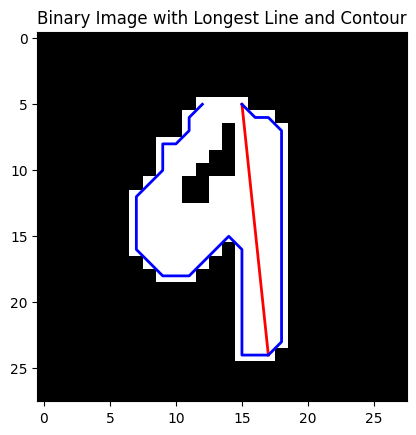

----------------Circumference-------------
Circumference: 69
----------------Aggregations---------------
Centroid: (13.571428571428571, 13.619047619047619)
Aggregation: 5.378489182197521
Variance of Distance to Centroid: 5.362103550090819
----------------Dominant Line---------------
k/b of dominant line 0.10526315789473684 14.473684210526315
----------------symmetry---------------
Number of '1' in the left part: 46
Number of '0' in the left part: 280
Number of '1' in the right part: 101
Number of '0' in the right part: 357
----------------Longest Line Length---------------
Endpoint 1: (15, 5)
Endpoint 2: (17, 24)
Length: 19.1049731745428


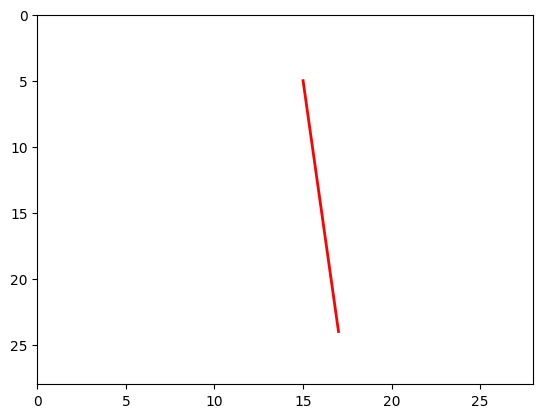

(69, 0.188, False, 5.378, 5.362, 0.105, 2.196, 19.105)
Prediction probability for digit 9: 0.4264
Size of the number 0.10586734693877552
Has closed loop: False


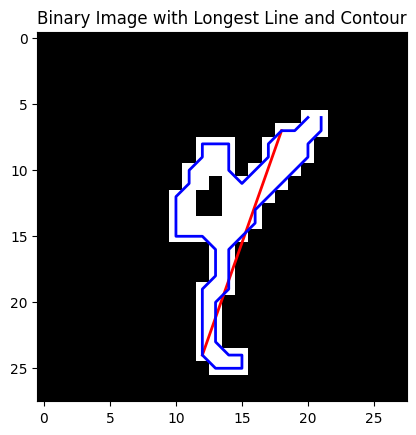

----------------Circumference-------------
Circumference: 62
----------------Aggregations---------------
Centroid: (13.771084337349398, 14.44578313253012)
Aggregation: 5.28167366555147
Variance of Distance to Centroid: 8.093762164186648
----------------Dominant Line---------------
k/b of dominant line -0.3529411764705882 20.470588235294116
----------------symmetry---------------
Number of '1' in the left part: 59
Number of '0' in the left part: 394
Number of '1' in the right part: 24
Number of '0' in the right part: 307
----------------Longest Line Length---------------
Endpoint 1: (12, 24)
Endpoint 2: (18, 7)
Length: 18.027756377319946


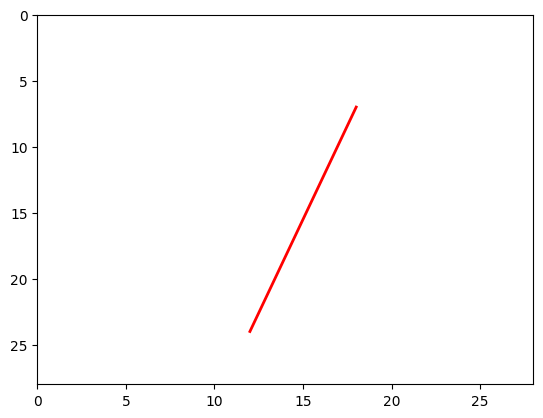

(62, 0.106, False, 5.282, 8.094, -0.353, 0.407, 18.028)
Prediction probability for digit 9: 0.0708
Size of the number 0.11224489795918367
Has closed loop: False


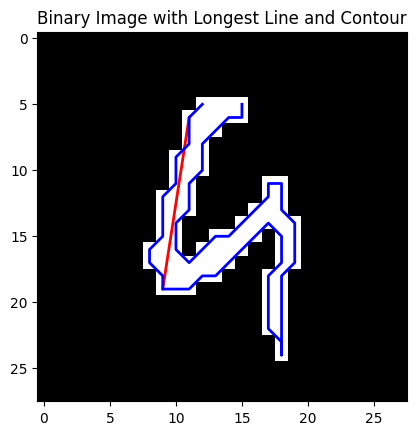

----------------Circumference-------------
Circumference: 68
----------------Aggregations---------------
Centroid: (14.034090909090908, 13.545454545454545)
Aggregation: 5.306738811734731
Variance of Distance to Centroid: 4.596658514606765
----------------Dominant Line---------------
k/b of dominant line -0.15384615384615385 11.923076923076923
----------------symmetry---------------
Number of '1' in the left part: 20
Number of '0' in the left part: 269
Number of '1' in the right part: 68
Number of '0' in the right part: 427
----------------Longest Line Length---------------
Endpoint 1: (9, 19)
Endpoint 2: (11, 6)
Length: 13.152946437965905


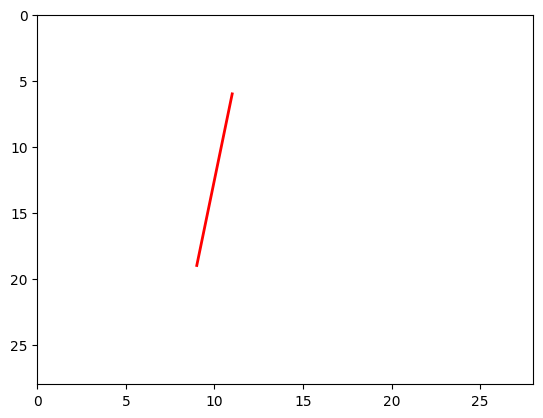

(68, 0.112, False, 5.307, 4.597, -0.154, 3.4, 13.153)
Prediction probability for digit 9: 0.6221
Size of the number 0.16964285714285715
Has closed loop: False


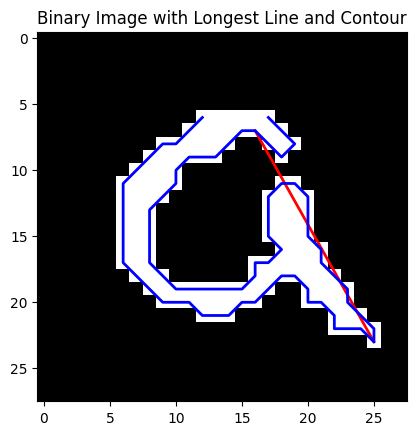

----------------Circumference-------------
Circumference: 85
----------------Aggregations---------------
Centroid: (14.451127819548873, 14.428571428571429)
Aggregation: 6.924174125033484
Variance of Distance to Centroid: 4.037043959889702
----------------Dominant Line---------------
k/b of dominant line 0.5625 12.0625
----------------symmetry---------------
Number of '1' in the left part: 21
Number of '0' in the left part: 197
Number of '1' in the right part: 112
Number of '0' in the right part: 454
----------------Longest Line Length---------------
Endpoint 1: (16, 7)
Endpoint 2: (25, 23)
Length: 18.35755975068582


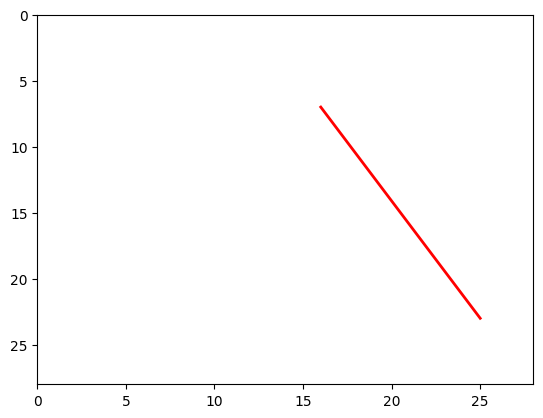

(85, 0.17, False, 6.924, 4.037, 0.562, 5.333, 18.358)
Prediction probability for digit 9: 0.5681
Size of the number 0.2372448979591837
Has closed loop: False


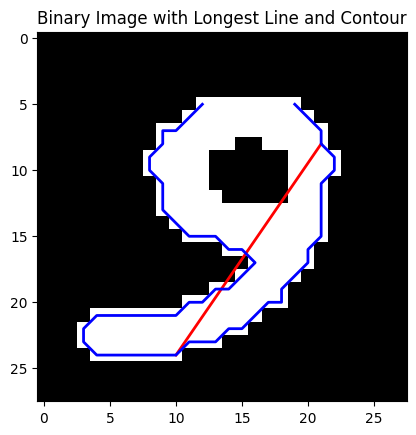

----------------Circumference-------------
Circumference: 86
----------------Aggregations---------------
Centroid: (14.333333333333334, 13.779569892473118)
Aggregation: 6.897516147017512
Variance of Distance to Centroid: 8.560269382948448
----------------Dominant Line---------------
k/b of dominant line -0.6875 26.5
----------------symmetry---------------
Number of '1' in the left part: 114
Number of '0' in the left part: 381
Number of '1' in the right part: 72
Number of '0' in the right part: 217
----------------Longest Line Length---------------
Endpoint 1: (21, 8)
Endpoint 2: (10, 24)
Length: 19.4164878389476


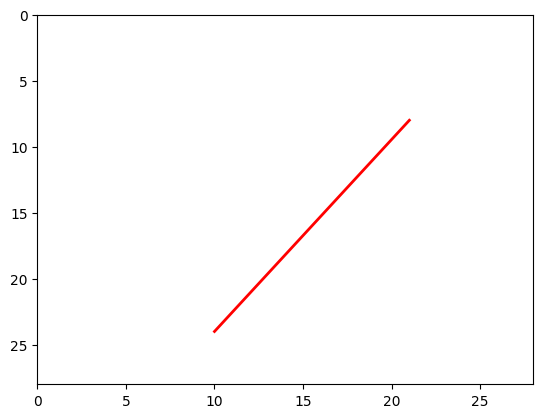

(86, 0.237, False, 6.898, 8.56, -0.688, 0.632, 19.416)
Prediction probability for digit 9: 0.0576
Size of the number 0.2308673469387755
Has closed loop: False


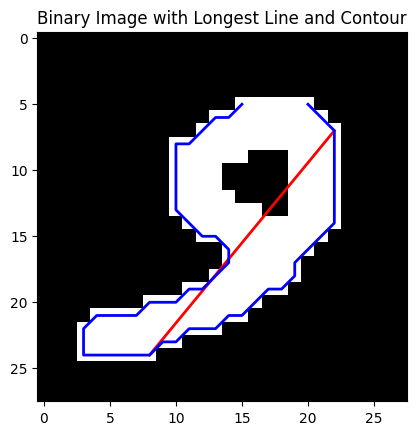

----------------Circumference-------------
Circumference: 79
----------------Aggregations---------------
Centroid: (14.287292817679559, 14.281767955801104)
Aggregation: 6.760591558665076
Variance of Distance to Centroid: 9.795454858314285
----------------Dominant Line---------------
k/b of dominant line -0.8235294117647058 27.764705882352942
----------------symmetry---------------
Number of '1' in the left part: 103
Number of '0' in the left part: 378
Number of '1' in the right part: 78
Number of '0' in the right part: 225
----------------Longest Line Length---------------
Endpoint 1: (22, 7)
Endpoint 2: (8, 24)
Length: 22.02271554554524


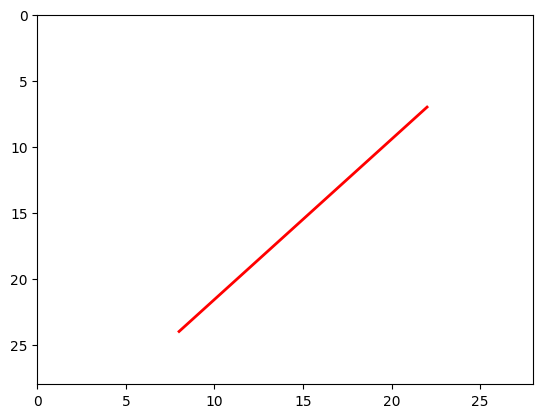

(79, 0.231, False, 6.761, 9.795, -0.824, 0.757, 22.023)
Prediction probability for digit 9: 0.6208
Size of the number 0.28188775510204084
Has closed loop: False


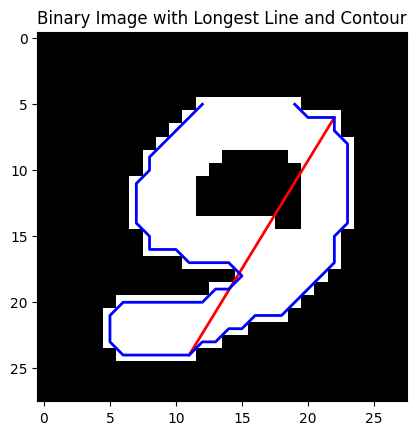

----------------Circumference-------------
Circumference: 92
----------------Aggregations---------------
Centroid: (14.298642533936652, 14.339366515837105)
Aggregation: 6.972287242721086
Variance of Distance to Centroid: 6.553894333823188
----------------Dominant Line---------------
k/b of dominant line -0.611111111111111 25.666666666666664
----------------symmetry---------------
Number of '1' in the left part: 132
Number of '0' in the left part: 369
Number of '1' in the right part: 89
Number of '0' in the right part: 194
----------------Longest Line Length---------------
Endpoint 1: (22, 6)
Endpoint 2: (11, 24)
Length: 21.095023109728988


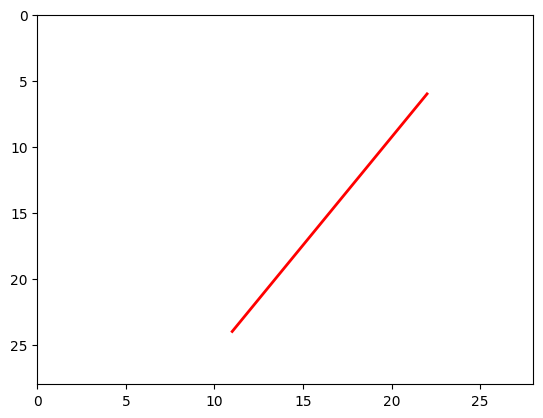

(92, 0.282, False, 6.972, 6.554, -0.611, 0.674, 21.095)
Prediction probability for digit 9: 0.4823
Size of the number 0.25255102040816324
Has closed loop: False


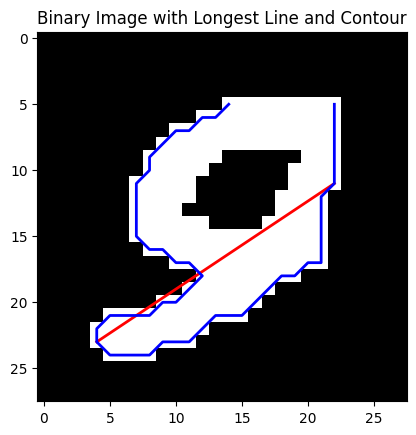

----------------Circumference-------------
Circumference: 86
----------------Aggregations---------------
Centroid: (13.883838383838384, 13.813131313131313)
Aggregation: 6.841429512187107
Variance of Distance to Centroid: 6.762590418735593
----------------Dominant Line---------------
k/b of dominant line -1.5 38.5
----------------symmetry---------------
Number of '1' in the left part: 127
Number of '0' in the left part: 349
Number of '1' in the right part: 71
Number of '0' in the right part: 237
----------------Longest Line Length---------------
Endpoint 1: (22, 11)
Endpoint 2: (4, 23)
Length: 21.633307652783937


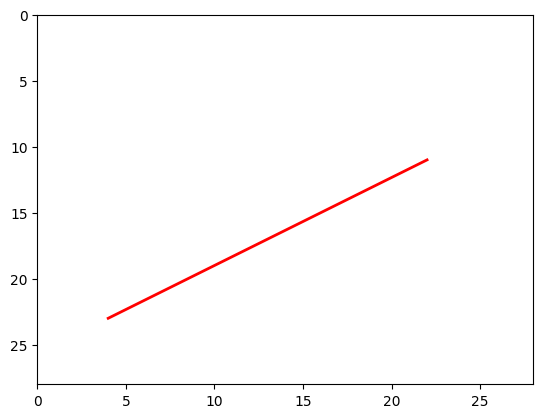

(86, 0.253, False, 6.841, 6.763, -1.5, 0.559, 21.633)
Prediction probability for digit 9: 0.1873
Size of the number 0.13010204081632654
Has closed loop: False


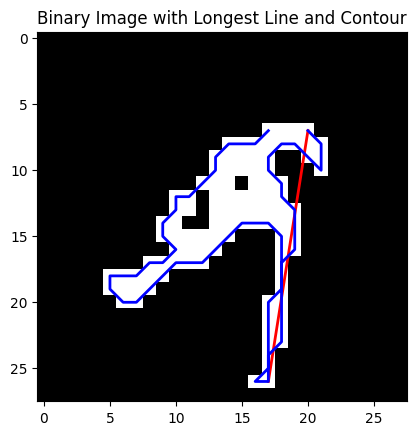

----------------Circumference-------------
Circumference: 76
----------------Aggregations---------------
Centroid: (14.254901960784315, 14.392156862745098)
Aggregation: 5.536170815220521
Variance of Distance to Centroid: 7.2693055920515635
----------------Dominant Line---------------
k/b of dominant line -0.15789473684210525 21.105263157894736
----------------symmetry---------------
Number of '1' in the left part: 88
Number of '0' in the left part: 456
Number of '1' in the right part: 14
Number of '0' in the right part: 226
----------------Longest Line Length---------------
Endpoint 1: (20, 7)
Endpoint 2: (17, 26)
Length: 19.235384061671343


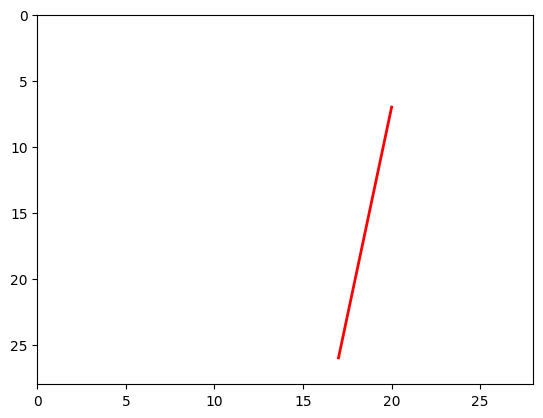

(76, 0.13, False, 5.536, 7.269, -0.158, 0.159, 19.235)
Prediction probability for digit 9: 0.5797
Size of the number 0.06377551020408163
Has closed loop: False


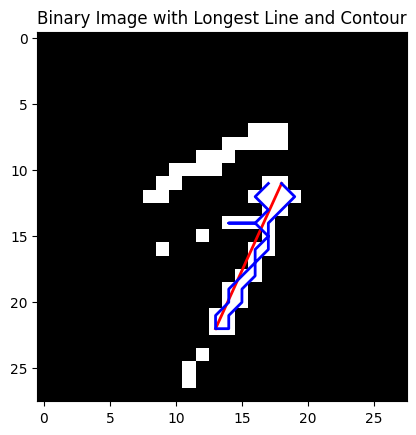

----------------Circumference-------------
Circumference: 48
----------------Aggregations---------------
Centroid: (13.92, 14.36)
Aggregation: 5.295943988965247
Variance of Distance to Centroid: 5.736977265742866
----------------Dominant Line---------------
k/b of dominant line -0.4545454545454546 23.0
----------------symmetry---------------
Number of '1' in the left part: 34
Number of '0' in the left part: 451
Number of '1' in the right part: 16
Number of '0' in the right part: 283
----------------Longest Line Length---------------
Endpoint 1: (18, 11)
Endpoint 2: (13, 22)
Length: 12.083045973594572


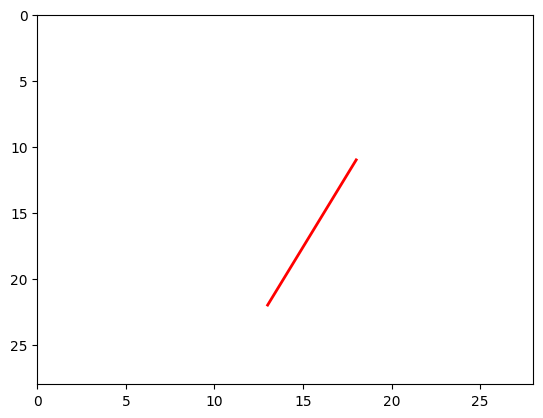

(48, 0.064, False, 5.296, 5.737, -0.455, 0.471, 12.083)
Prediction probability for digit 9: 0.1702
Size of the number 0.10076530612244898
Has closed loop: False


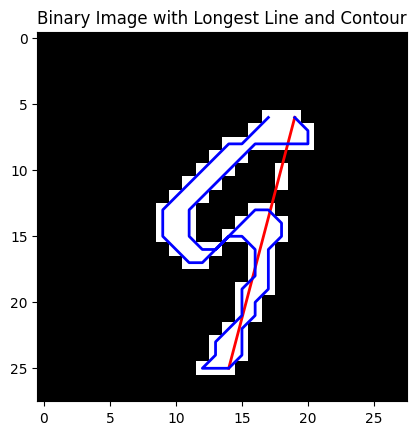

----------------Circumference-------------
Circumference: 61
----------------Aggregations---------------
Centroid: (14.405063291139241, 14.531645569620252)
Aggregation: 5.478782846266928
Variance of Distance to Centroid: 6.396974735596729
----------------Dominant Line---------------
k/b of dominant line -0.2631578947368421 20.57894736842105
----------------symmetry---------------
Number of '1' in the left part: 57
Number of '0' in the left part: 433
Number of '1' in the right part: 22
Number of '0' in the right part: 272
----------------Longest Line Length---------------
Endpoint 1: (19, 6)
Endpoint 2: (14, 25)
Length: 19.6468827043885


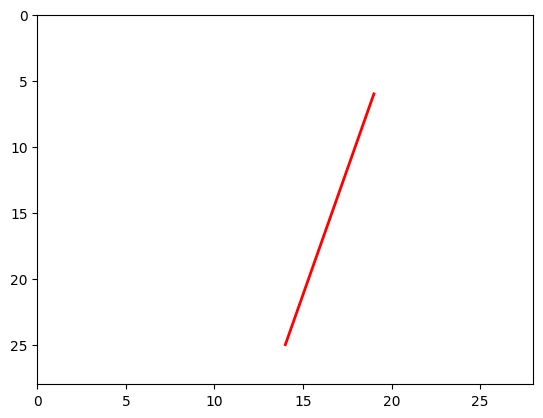

(61, 0.101, False, 5.479, 6.397, -0.263, 0.386, 19.647)
Prediction probability for digit 9: 0.3377
Size of the number 0.2461734693877551
Has closed loop: False


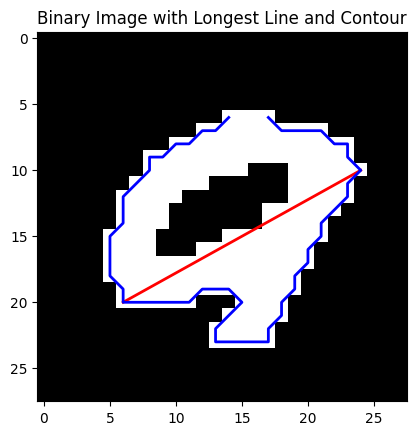

----------------Circumference-------------
Circumference: 84
----------------Aggregations---------------
Centroid: (14.05699481865285, 14.217616580310882)
Aggregation: 6.500945599249271
Variance of Distance to Centroid: 3.9513496348852724
----------------Dominant Line---------------
k/b of dominant line -1.8 42.0
----------------symmetry---------------
Number of '1' in the left part: 102
Number of '0' in the left part: 354
Number of '1' in the right part: 91
Number of '0' in the right part: 237
----------------Longest Line Length---------------
Endpoint 1: (24, 10)
Endpoint 2: (6, 20)
Length: 20.591260281974


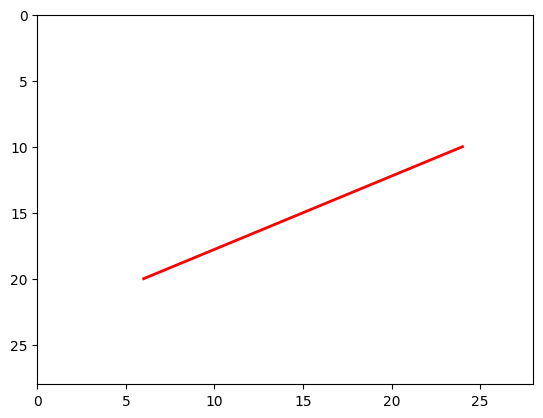

(84, 0.246, False, 6.501, 3.951, -1.8, 0.892, 20.591)
Prediction probability for digit 9: 0.6116
Size of the number 0.11607142857142858
Has closed loop: False


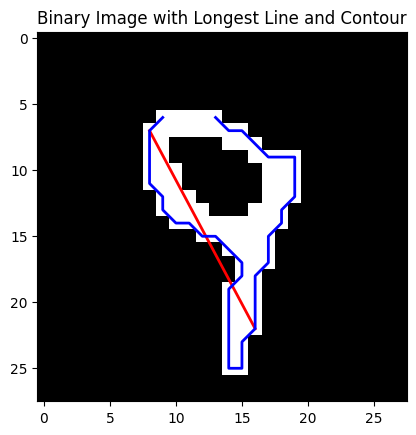

----------------Circumference-------------
Circumference: 68
----------------Aggregations---------------
Centroid: (13.472527472527473, 13.802197802197803)
Aggregation: 5.506282117874254
Variance of Distance to Centroid: 5.956910855091178
----------------Dominant Line---------------
k/b of dominant line 0.5333333333333333 4.2666666666666675
----------------symmetry---------------
Number of '1' in the left part: 57
Number of '0' in the left part: 391
Number of '1' in the right part: 34
Number of '0' in the right part: 302
----------------Longest Line Length---------------
Endpoint 1: (16, 22)
Endpoint 2: (8, 7)
Length: 17.0


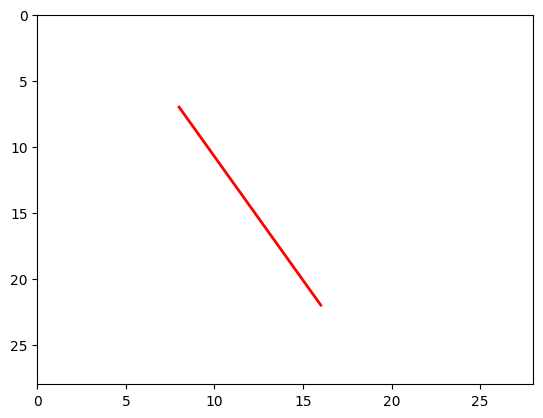

(68, 0.116, False, 5.506, 5.957, 0.533, 0.596, 17.0)
Prediction probability for digit 9: 0.6296
Size of the number 0.11096938775510204
Has closed loop: False


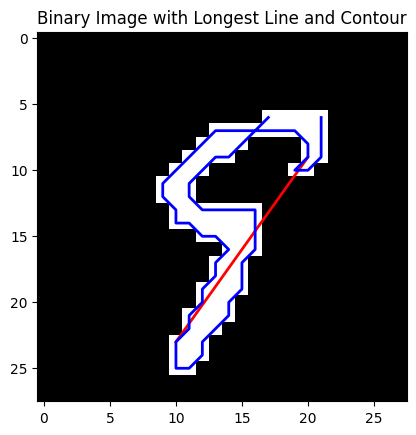

----------------Circumference-------------
Circumference: 62
----------------Aggregations---------------
Centroid: (13.885057471264368, 13.942528735632184)
Aggregation: 5.722519373916564
Variance of Distance to Centroid: 8.535107858722052
----------------Dominant Line---------------
k/b of dominant line -0.7142857142857142 26.428571428571427
----------------symmetry---------------
Number of '1' in the left part: 57
Number of '0' in the left part: 425
Number of '1' in the right part: 30
Number of '0' in the right part: 272
----------------Longest Line Length---------------
Endpoint 1: (20, 9)
Endpoint 2: (10, 23)
Length: 17.204650534085253


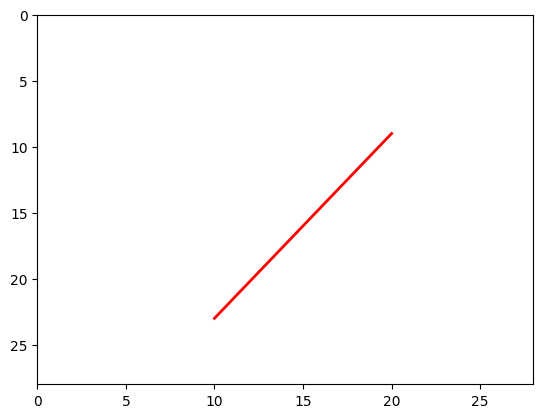

(62, 0.111, False, 5.723, 8.535, -0.714, 0.526, 17.205)
Prediction probability for digit 9: 0.6453
Size of the number 0.17219387755102042
Has closed loop: False


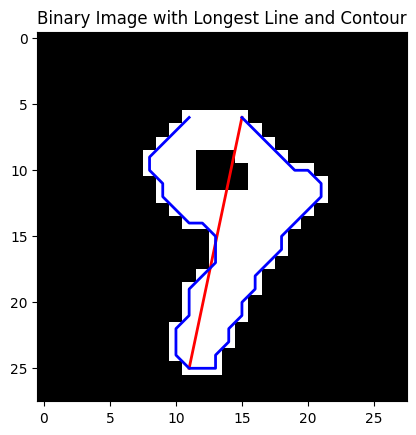

----------------Circumference-------------
Circumference: 59
----------------Aggregations---------------
Centroid: (14.170370370370371, 13.962962962962964)
Aggregation: 5.50119933532
Variance of Distance to Centroid: 6.136037697491796
----------------Dominant Line---------------
k/b of dominant line -0.21052631578947367 16.263157894736842
----------------symmetry---------------
Number of '1' in the left part: 65
Number of '0' in the left part: 326
Number of '1' in the right part: 70
Number of '0' in the right part: 323
----------------Longest Line Length---------------
Endpoint 1: (15, 6)
Endpoint 2: (11, 25)
Length: 19.4164878389476


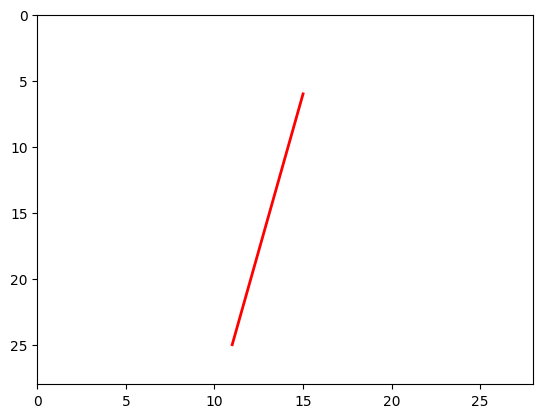

(59, 0.172, False, 5.501, 6.136, -0.211, 1.077, 19.416)
Prediction probability for digit 9: 0.0016
Size of the number 0.1441326530612245
Has closed loop: False


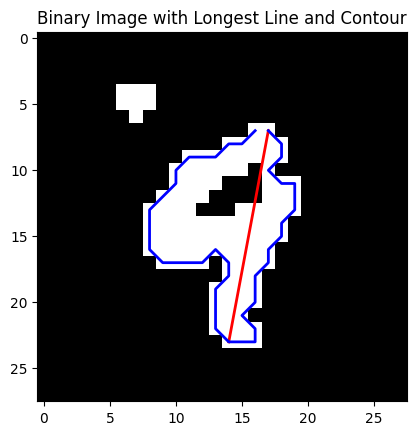

----------------Circumference-------------
Circumference: 63
----------------Aggregations---------------
Centroid: (13.734513274336283, 13.36283185840708)
Aggregation: 5.053199392233613
Variance of Distance to Centroid: 5.864815654855495
----------------Dominant Line---------------
k/b of dominant line -0.1875 18.3125
----------------symmetry---------------
Number of '1' in the left part: 78
Number of '0' in the left part: 377
Number of '1' in the right part: 35
Number of '0' in the right part: 294
----------------Longest Line Length---------------
Endpoint 1: (17, 7)
Endpoint 2: (14, 23)
Length: 16.278820596099706


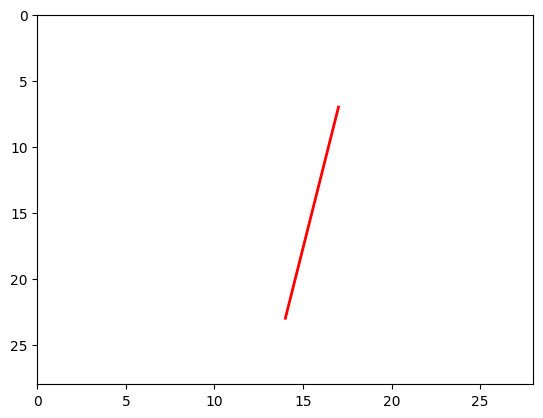

(63, 0.144, False, 5.053, 5.865, -0.188, 0.449, 16.279)
Prediction probability for digit 9: 0.6797
Size of the number 0.12755102040816327
Has closed loop: False


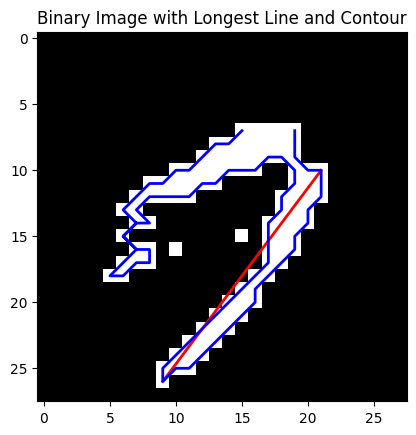

----------------Circumference-------------
Circumference: 75
----------------Aggregations---------------
Centroid: (14.16, 13.96)
Aggregation: 6.411652960790883
Variance of Distance to Centroid: 4.223506310381513
----------------Dominant Line---------------
k/b of dominant line -0.75 28.5
----------------symmetry---------------
Number of '1' in the left part: 69
Number of '0' in the left part: 455
Number of '1' in the right part: 31
Number of '0' in the right part: 229
----------------Longest Line Length---------------
Endpoint 1: (21, 10)
Endpoint 2: (9, 26)
Length: 20.0


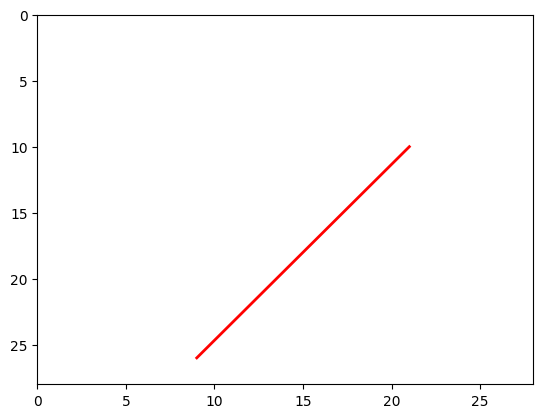

(75, 0.128, False, 6.412, 4.224, -0.75, 0.449, 20.0)
Prediction probability for digit 9: 0.5345
Size of the number 0.10076530612244898
Has closed loop: False


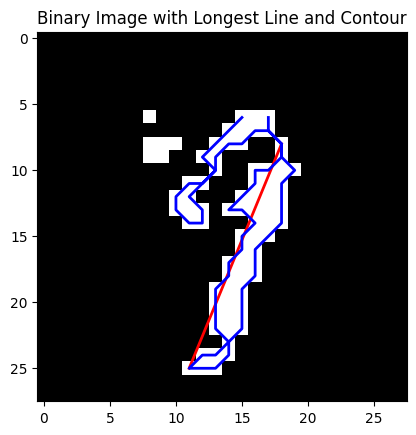

----------------Circumference-------------
Circumference: 63
----------------Aggregations---------------
Centroid: (13.949367088607595, 14.20253164556962)
Aggregation: 5.461959496050358
Variance of Distance to Centroid: 6.6803777296485585
----------------Dominant Line---------------
k/b of dominant line -0.4117647058823529 21.294117647058822
----------------symmetry---------------
Number of '1' in the left part: 49
Number of '0' in the left part: 405
Number of '1' in the right part: 30
Number of '0' in the right part: 300
----------------Longest Line Length---------------
Endpoint 1: (18, 8)
Endpoint 2: (11, 25)
Length: 18.384776310850235


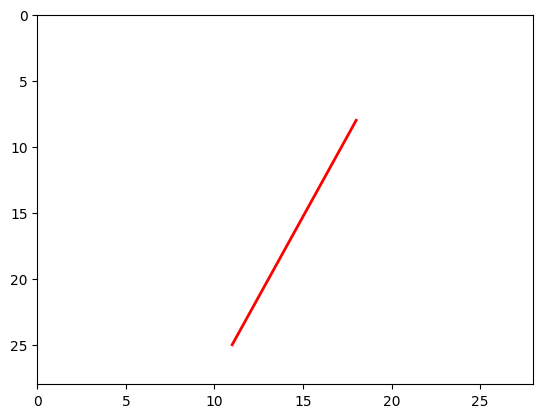

(63, 0.101, False, 5.462, 6.68, -0.412, 0.612, 18.385)
Prediction probability for digit 9: 0.3862
Size of the number 0.13010204081632654
Has closed loop: False


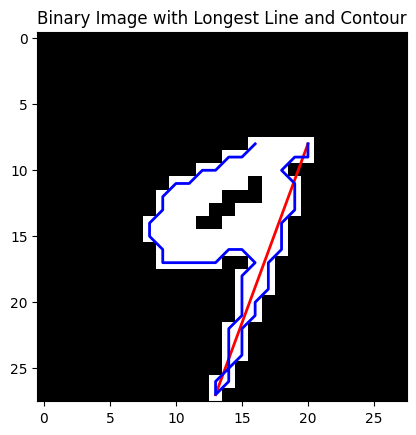

----------------Circumference-------------
Circumference: 65
----------------Aggregations---------------
Centroid: (14.607843137254902, 14.333333333333334)
Aggregation: 4.846729310032358
Variance of Distance to Centroid: 5.51882668308565
----------------Dominant Line---------------
k/b of dominant line -0.3684210526315789 22.94736842105263
----------------symmetry---------------
Number of '1' in the left part: 81
Number of '0' in the left part: 435
Number of '1' in the right part: 21
Number of '0' in the right part: 247
----------------Longest Line Length---------------
Endpoint 1: (20, 8)
Endpoint 2: (13, 27)
Length: 20.248456731316587


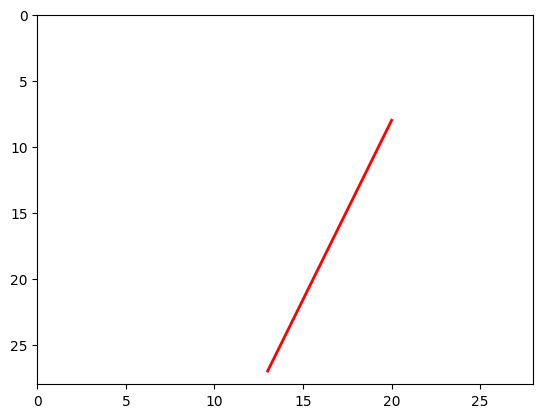

(65, 0.13, False, 4.847, 5.519, -0.368, 0.259, 20.248)
Prediction probability for digit 9: 0.4746
Size of the number 0.10841836734693877
Has closed loop: False


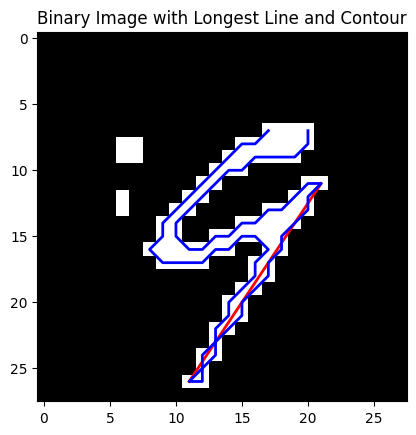

----------------Circumference-------------
Circumference: 75
----------------Aggregations---------------
Centroid: (14.129411764705882, 14.188235294117646)
Aggregation: 5.597088268963477
Variance of Distance to Centroid: 6.514540625694416
----------------Dominant Line---------------
k/b of dominant line -0.6666666666666666 28.333333333333332
----------------symmetry---------------
Number of '1' in the left part: 68
Number of '0' in the left part: 482
Number of '1' in the right part: 17
Number of '0' in the right part: 217
----------------Longest Line Length---------------
Endpoint 1: (21, 11)
Endpoint 2: (11, 26)
Length: 18.027756377319946


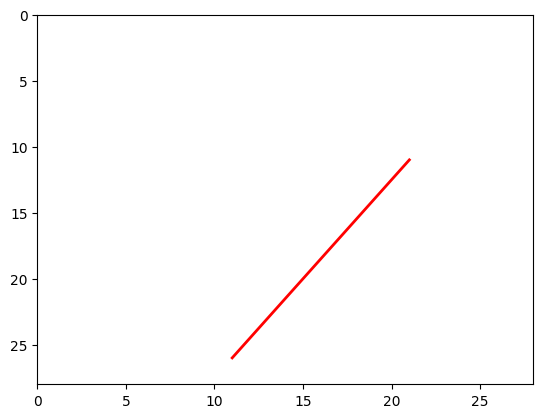

(75, 0.108, False, 5.597, 6.515, -0.667, 0.25, 18.028)


In [14]:
import numpy as np
# Find the indices of test images with digit "1"
digit_ones_indices = [i for i, label in enumerate(y_test) if (label[9] == 1 and  predictions[i][9]<0.7)]
print(digit_ones_indices)
# Output the probability predictions and images for digit "1"
for index in digit_ones_indices:
    prediction = predictions[index]
    image = x_test[index].reshape(28, 28)
    pred_prob = prediction[9]
    print(f'Prediction probability for digit 9: {pred_prob:.4f}')
    # plt.imshow(image, cmap='gray')
    # plt.axis('off')
    # plt.show()
    binary_image = image
    print(batch_feature_extraction(binary_image,pred_prob))
